<a href="https://colab.research.google.com/github/JJET25/ML-Movie-Rating-Prediction/blob/main/Equipo2_Preprocesamiento2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Importar base de datos**

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
ls 'drive/MyDrive/MCD/BaseDatos_Limpieza.xlsx'

drive/MyDrive/MCD/BaseDatos_Limpieza.xlsx


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import random
import seaborn as sns

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import  confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, roc_curve, roc_auc_score, RocCurveDisplay
import sklearn.datasets
from sklearn.model_selection import train_test_split as split

In [ ]:
df = pd.read_excel('drive/MyDrive/MCD/BaseDatos_Limpieza.xlsx')


In [ ]:
df

,Unnamed: 0,Nombre,Genero,Subgenero,Año,Clasificacion,Animacion,Duracion,Criticos,Audiencia,Miguel,Emilio,Jesus,Leo,Nayibe,Genero Numerico,Subgenero Numerico,Clasificacion Numerico,Animacion Numerico
0,0,Alien: Romulus,Ciencia Ficción,Acción,2024,R,no,119,8.0,7.4,7,3,9,9,2,0,0.0,0,0
1,1,Deadpool & Wolverine,Ciencia Ficción,Acción,2024,R,no,128,7.8,7.2,7,4,8,9,2,0,0.0,0,0
2,3,Inside out 2,Familia,Aventura,2024,PG,si,97,9.0,7.4,6,3,7,4,8,1,1.0,1,1
3,4,Bad Boys: Ride or Die,Comedia,Crimen,2024,R,no,115,6.5,6.4,6,2,8,9,2,12,12.0,0,0
4,6,Furiosa: A Mad Max Saga,Ciencia Ficción,Acción,2024,R,no,149,9.0,7.6,6,4,8,9,2,0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
140,195,Saving Private Ryan,Historia,Guerra,1998,R,no,169,9.4,8.4,8,6,6,9,1,4,7.0,0,0
141,196,American History X,Drama,Drama,1998,PG,no,119,8.4,8.2,8,8,5,5,7,3,4.0,1,0
142,197,Mulan,Familia,Aventura,1998,PG,si,88,8.6,8.2,8,6,3,4,8,1,1.0,1,1
143,198,The Truman Show,Comedia,Drama,1998,PG,no,103,9.4,8.4,8,6,4,4,7,12,4.0,1,0


# **Analisis Univariado**



```
# This is formatted as code
```



*   **Genero y Subgenero**



Las variables género y subgénero son variables categóricas y consideramos que estas dos variables son las más importantes para elegir una película ya que demuestra más o menos qué tipo de historia tendrá. Por ejemplo, si alguien se asusta muy fácilmente probablemente no querrá ir a ver una película de terror. Hay 13 diferentes géneros y subgéneros que aplican para las películas en nuestra base de datos.

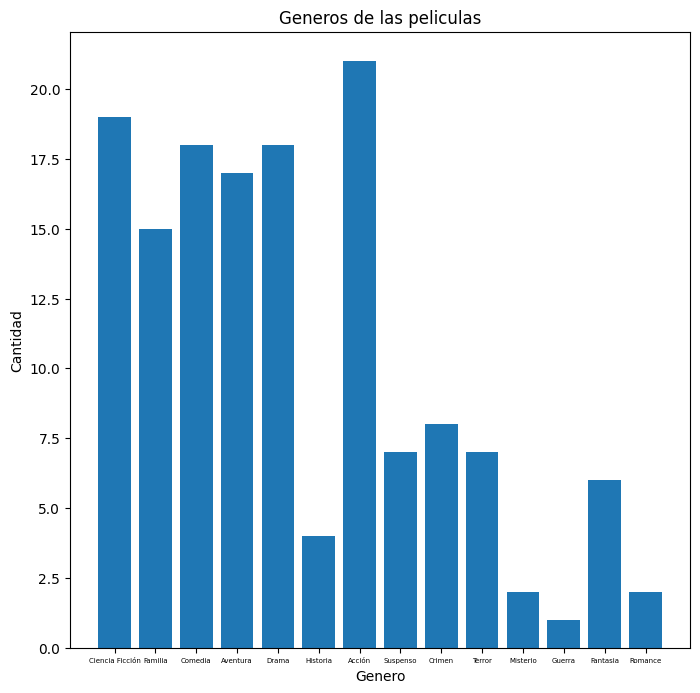

In [ ]:
Columna = df['Genero']
x=Columna.value_counts(sort=False).index
y=Columna.value_counts(sort=False).values
plt.figure(figsize=(8,8))
plt.bar(x = x, height = y)
plt.xlabel('Genero')
plt.ylabel('Cantidad')
plt.title('Generos de las peliculas')
plt.xticks(fontsize=5)
plt.yticks(fontsize=10)
plt.show()

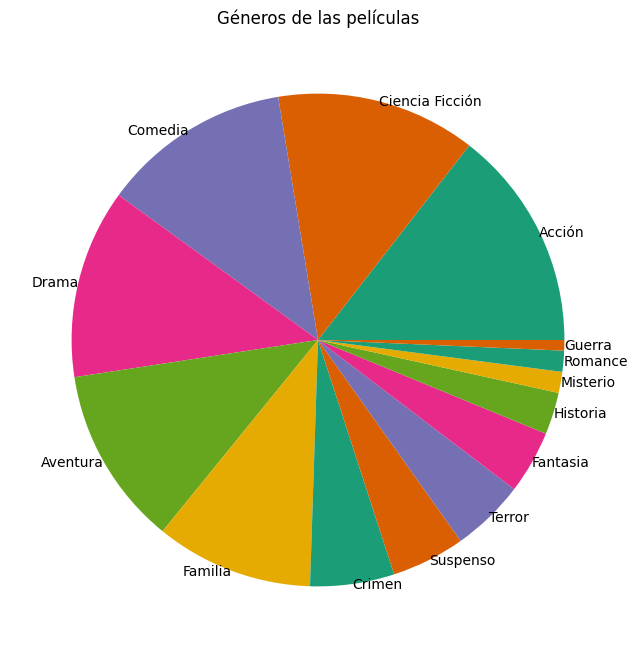

In [ ]:
Columna = df['Genero']
x=Columna.value_counts(sort=True).index
y=Columna.value_counts(sort=True).values
plt.figure(figsize=(8,8))
plt.pie(x = y, labels = x,
        labeldistance=1,
        colors = sns.palettes.mpl_palette('Dark2')  )
plt.title('Géneros de las películas')
plt.show()

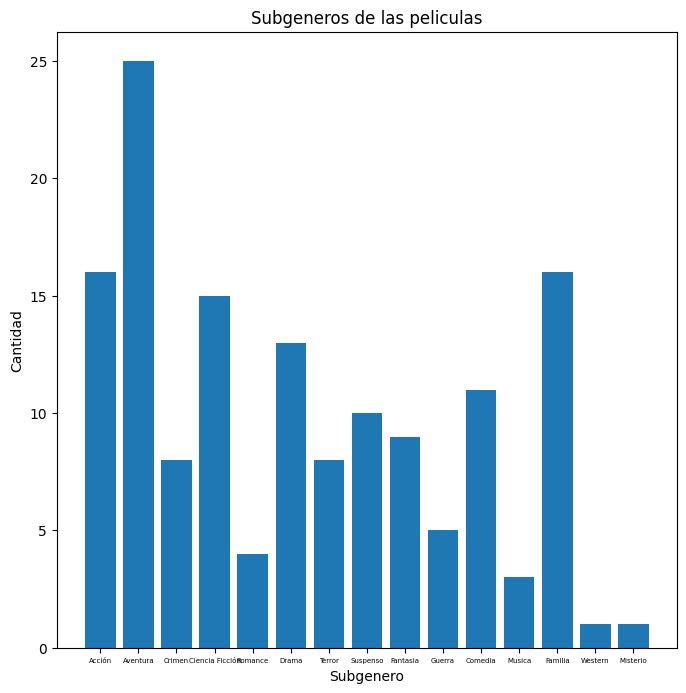

In [ ]:
Columna = df['Subgenero']
x=Columna.value_counts(sort=False).index
y=Columna.value_counts(sort=False).values
plt.figure(figsize=(8,8))
plt.bar(x = x, height = y)
plt.xlabel('Subgenero')
plt.ylabel('Cantidad')
plt.title('Subgeneros de las peliculas')
plt.xticks(fontsize=5)
plt.yticks(fontsize=10)
plt.show()

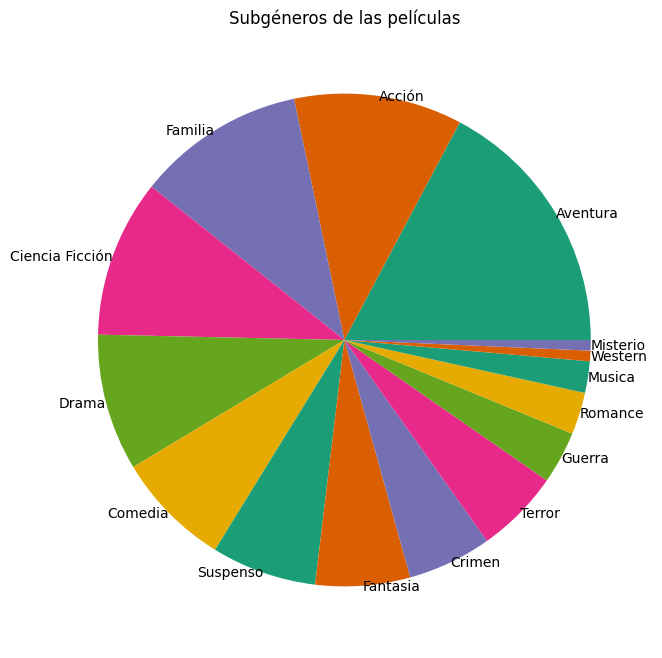

In [ ]:
Columna = df['Subgenero']
x=Columna.value_counts(sort=True).index
y=Columna.value_counts(sort=True).values
plt.figure(figsize=(8,8))
plt.pie(x = y, labels = x,
        labeldistance=1,
        colors = sns.palettes.mpl_palette('Dark2')  )
plt.title('Subgéneros de las películas')
plt.show()

* **Año**

El año (una variable numérica) en el que sale una película puede ser un factor importante para decidir si ver una película o no. Por ejemplo, una pelicula de los 50s sera en blanco y negro y con un humor muy diferente al moderno, al igual que sus efectos visuales seran muy diferentes debido a la tecnologia de la epoca. Aun así, hay mucha gente que prefiere ver películas más viejas ya que lo consideran una mejor época de cine, por un tema de nostalgia, etc.

La media de los años es:  2010.4689655172415
La desviación estándar de los años es:  12.196911706346565
El minimo de los años es:  1976
El maximo de los años es:  2024
Q1:  2005.0
Q2:  2015.0
Q3:  2018.0


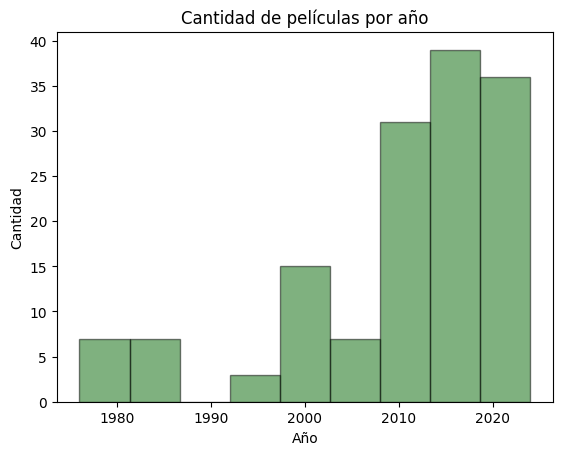

In [ ]:
print("La media de los años es: ", df['Año'].mean())
print("La desviación estándar de los años es: ", df['Año'].std())
print("El minimo de los años es: ", df['Año'].min())
print("El maximo de los años es: ", df['Año'].max())
print("Q1: ", df['Año'].quantile(q=0.25))
print("Q2: ", df['Año'].quantile(q=0.5))
print("Q3: ", df['Año'].quantile(q=0.75))
hist = plt.hist(df['Año'],
                bins=9,
                alpha = 0.5,
                color = 'darkgreen',
                edgecolor = 'black'
                )
plt.xlabel('Año')
plt.ylabel('Cantidad')
plt.title('Cantidad de películas por año')
plt.show()

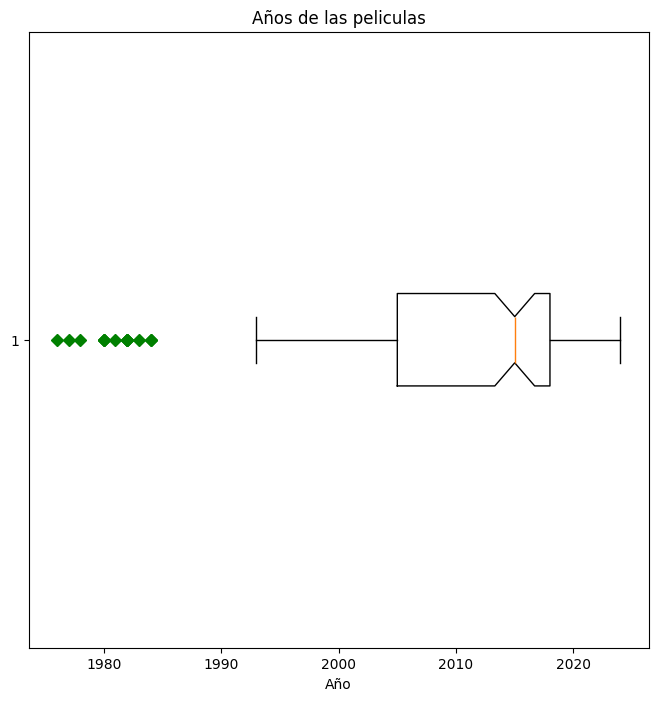

In [ ]:
Columnas = ['Año']
plt.figure(figsize=(8,8))
plt.boxplot(df['Año'],
            1,
            'gD',
            0
            )
plt.xlabel('Año')
plt.ylabel('')
plt.title('Años de las peliculas')
plt.show()

* **Clasificacion**

Esta es una variable categórica. La clasificación de una película es una variable sumamente importante para decidir sobre una película, hay películas con mucha sangre y violencia que no son aptos para menores de edad, mientras que hay otras películas hechas específicamente para niños. Esta clasificación determina para quien está hecha la película. Usamos el sistema estadounidense de clasificación de películas para simplificar la investigación. Sus diferentes categorías son:
G- Apto para todo público.
PG- Sugerencia de estar acompañado por un adulto.
PG-13- Fuerte sugerencia hacia padres.
R- Prohibida entrada a menores de edad sin estar acompañados de un adulto.


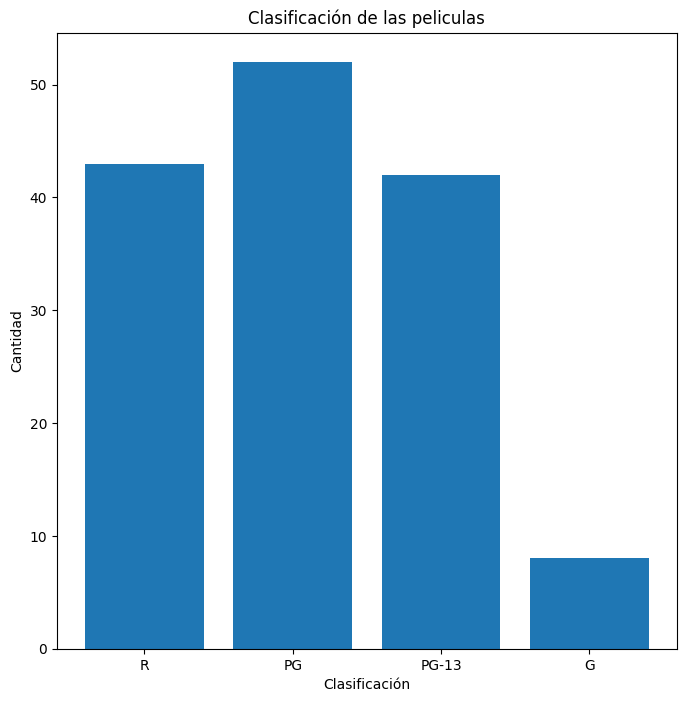

In [ ]:
Columna = df['Clasificacion']
x=Columna.value_counts(sort=False).index
y=Columna.value_counts(sort=False).values
plt.figure(figsize=(8,8))
plt.bar(x = x, height = y)
plt.xlabel('Clasificación')
plt.ylabel('Cantidad')
plt.title('Clasificación de las peliculas')
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.show()

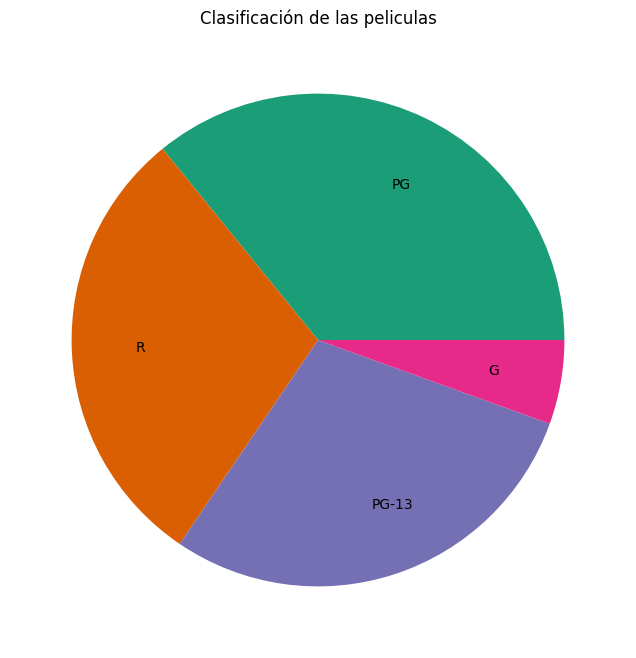

In [ ]:
Columna = df['Clasificacion']
x=Columna.value_counts(sort=True).index
y=Columna.value_counts(sort=True).values
plt.figure(figsize=(8,8))
plt.pie(x = y, labels = x,
        labeldistance=0.7,
        colors = sns.palettes.mpl_palette('Dark2')  )
plt.title('Clasificación de las peliculas')
plt.show()


* **Animacion**



Esta es una variable categórica, pero solo tiene dos posibles valores, “sí” o “no”. Consideramos que hay mucha gente que prefiere ver películas con actuación tradicional que películas animadas. En nuestra base de datos limpia, hay 35 películas animadas y 110 con actuación tradicional.

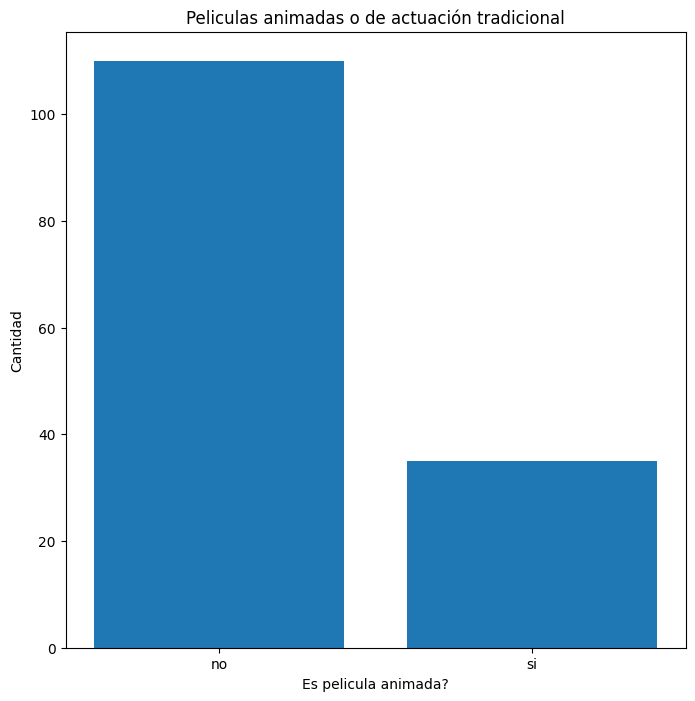

In [ ]:
Columna = df['Animacion']
x=Columna.value_counts(sort=False).index
y=Columna.value_counts(sort=False).values
plt.figure(figsize=(8,8))
plt.bar(x = x, height = y)
plt.xlabel('Es pelicula animada?')
plt.ylabel('Cantidad')
plt.title('Peliculas animadas o de actuación tradicional')
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.show()

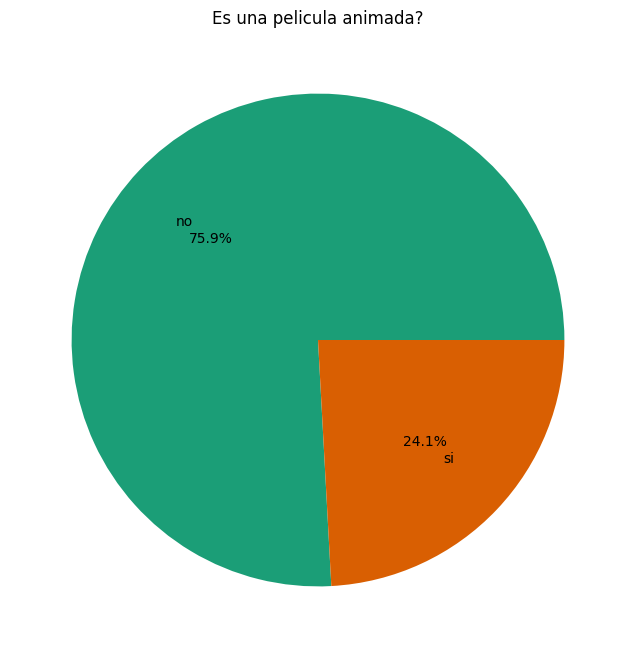

In [ ]:
Columna = df['Animacion']
x=Columna.value_counts(sort=True).index
y=Columna.value_counts(sort=True).values
plt.figure(figsize=(8,8))
plt.pie(x = y, labels = x,
        autopct='%1.1f%%',
        labeldistance=0.7,
        colors = sns.palettes.mpl_palette('Dark2')  )
plt.title('Es una pelicula animada?')
plt.show()

* **Duracion**



Esta variable es una variable numérica que consideramos que es una de las más importantes cuando quieres elegir una película, ya que hay mucha gente que no le gusta ver películas muy largas. El promedio de la duración de estas películas es de 124 minutos (2 horas 4 minutos).



La media de la duración es:  124.55862068965517
La desviación estándar de la duración es:  25.834106402967507
El minimo de la duración es:  78
El maximo de la duración es:  194
Q1:  104.0
Q2:  119.0
Q3:  142.0


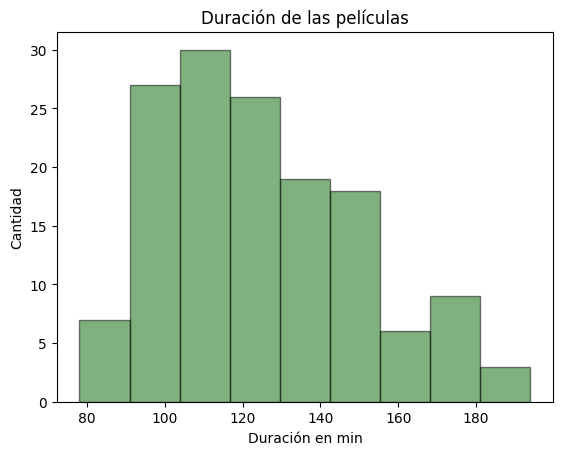

In [ ]:
print("La media de la duración es: ", df['Duracion'].mean())
print("La desviación estándar de la duración es: ", df['Duracion'].std())
print("El minimo de la duración es: ", df['Duracion'].min())
print("El maximo de la duración es: ", df['Duracion'].max())
print("Q1: ", df['Duracion'].quantile(q=0.25))
print("Q2: ", df['Duracion'].quantile(q=0.5))
print("Q3: ", df['Duracion'].quantile(q=0.75))
hist = plt.hist(df['Duracion'],
                bins=9,
                alpha = 0.5,
                color = 'darkgreen',
                edgecolor = 'black'
                )
plt.xlabel('Duración en min')
plt.ylabel('Cantidad')
plt.title('Duración de las películas')
plt.show()

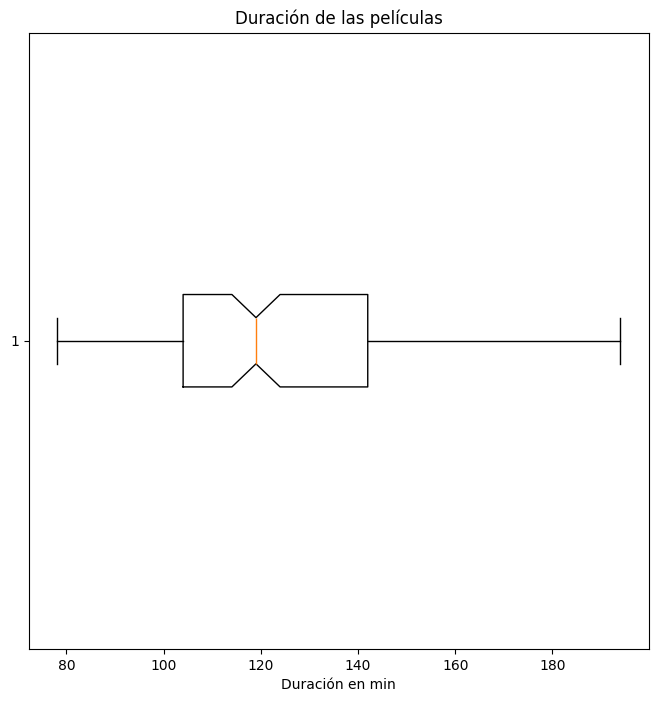

In [ ]:
Columnas = ['Duracion']
plt.figure(figsize=(8,8))
plt.boxplot(df['Duracion'],
            1,
            'gD',
            0
            )
plt.xlabel('Duración en min')
plt.ylabel('')
plt.title('Duración de las películas')
plt.show()

* **Criticos**

Esta es una variable numérica. Mucha gente revisa la calificación de los críticos hacia una película para ver si vale la pena verla o no y por esto decidimos incluirla a nuestra base de datos. En general se considera que los críticos normalmente tienen la razón al calificar una película, por ejemplo si una película tiene una calificación de críticos muy baja lo más probable es que no sea buena, pero igual hay mucha gente que no le hace casos a estas calificaciones y prefiere verla y luego ellos mismos decidir si valía la pena o no.

La media de la calificación de los críticos es:  8.517931034482759
La desviación estándar de la calificación de los críticos es:  1.0728770358711275
El minimo de la calificación de los críticos es:  5.3
El maximo de la calificación de los críticos es:  10.0
Q1:  8.0
Q2:  8.8
Q3:  9.3


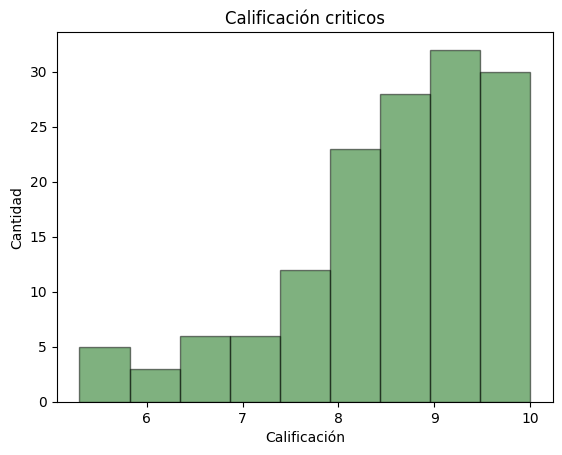

In [ ]:
print("La media de la calificación de los críticos es: ", df['Criticos'].mean())
print("La desviación estándar de la calificación de los críticos es: ", df['Criticos'].std())
print("El minimo de la calificación de los críticos es: ", df['Criticos'].min())
print("El maximo de la calificación de los críticos es: ", df['Criticos'].max())
print("Q1: ", df['Criticos'].quantile(q=0.25))
print("Q2: ", df['Criticos'].quantile(q=0.5))
print("Q3: ", df['Criticos'].quantile(q=0.75))
hist = plt.hist(df['Criticos'],
                bins=9,
                alpha = 0.5,
                color = 'darkgreen',
                edgecolor = 'black'
                )
plt.xlabel('Calificación')
plt.ylabel('Cantidad')
plt.title('Calificación criticos')
plt.show()

* **Audiencia**

Esta es una variable numérica. Alguna gente considera que la opinión de los críticos a veces es injusta o diferente a la del público general, por lo tanto decidimos incluir la variable de “audiencia” la cual da la calificación de la gente en general (según letterboxd). A veces se considera que esta calificación tiene más sentido ya que mucha más gente participa en darle una calificación, pero esta calificación tiende a ser menos profesional.

La media de la calificación de la audiencia es:  7.559999999999999
La desviación estándar de la calificación de la audiencia es:  0.7585073060513868
El minimo de la calificación de la audiencia es:  5.4
El maximo de la calificación de la audiencia es:  9.0
Q1:  7.2
Q2:  7.6
Q3:  8.2


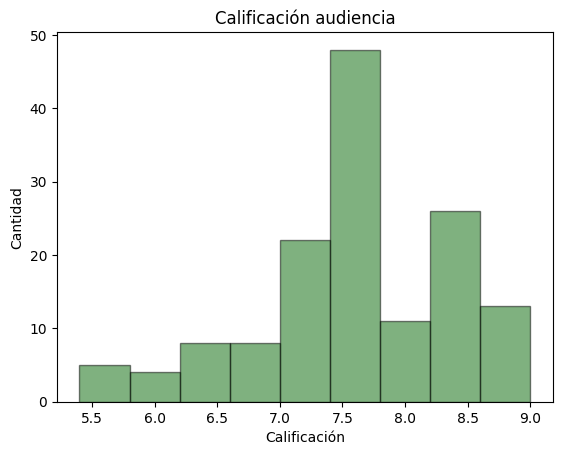

In [ ]:
print("La media de la calificación de la audiencia es: ", df['Audiencia'].mean())
print("La desviación estándar de la calificación de la audiencia es: ", df['Audiencia'].std())
print("El minimo de la calificación de la audiencia es: ", df['Audiencia'].min())
print("El maximo de la calificación de la audiencia es: ", df['Audiencia'].max())
print("Q1: ", df['Audiencia'].quantile(q=0.25))
print("Q2: ", df['Audiencia'].quantile(q=0.5))
print("Q3: ", df['Audiencia'].quantile(q=0.75))
hist = plt.hist(df['Audiencia'],
                bins=9,
                alpha = 0.5,
                color = 'darkgreen',
                edgecolor = 'black'
                )
plt.xlabel('Calificación')
plt.ylabel('Cantidad')
plt.title('Calificación audiencia')
plt.show()

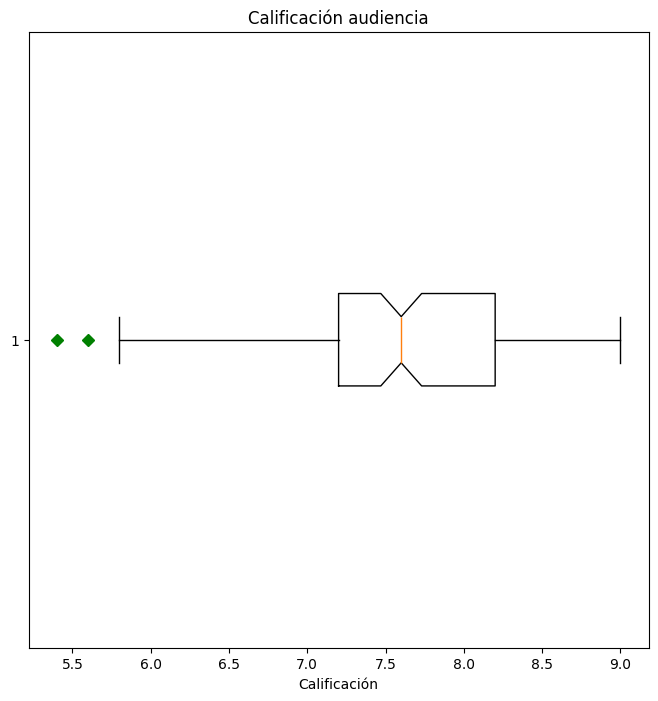

In [ ]:
Columnas = ['Audiencia']
plt.figure(figsize=(8,8))
plt.boxplot(df['Audiencia'],
            1,
            'gD',
            0
            )
plt.xlabel('Calificación')
plt.ylabel('')
plt.title('Calificación audiencia')
plt.show()

# **Analisis Multivariado**

## Miguel

### Genero

In [ ]:
#1
df.groupby("Genero")['Miguel'].mean()

,Miguel
Genero,
Acción,7.190476
Aventura,7.705882
Ciencia Ficción,7.526316
Comedia,7.666667
Crimen,7.500000
Drama,7.500000
Familia,7.466667
Fantasia,7.833333
Guerra,8.000000


In [ ]:
#2
df.groupby("Genero")['Miguel'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Genero,,,,,,,,
Acción,7.190476,6,8,0.679636,21,7.0,7.00,8.00
Aventura,7.705882,6,9,0.848875,17,8.0,7.00,8.00
Ciencia Ficción,7.526316,6,9,0.696692,19,8.0,7.00,8.00
Comedia,7.666667,6,9,0.970143,18,8.0,7.00,8.00
Crimen,7.500000,6,9,0.925820,8,7.5,7.00,8.00
Drama,7.500000,6,9,0.985184,18,7.5,7.00,8.00
Familia,7.466667,6,9,1.125463,15,8.0,6.50,8.00
Fantasia,7.833333,7,9,0.983192,6,7.5,7.00,8.75
Guerra,8.000000,8,8,NaN,1,8.0,8.00,8.00


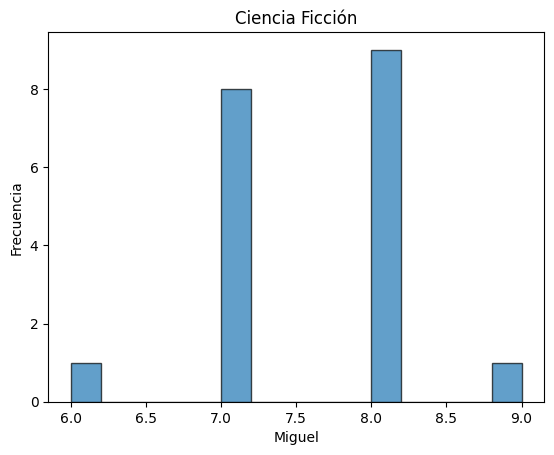

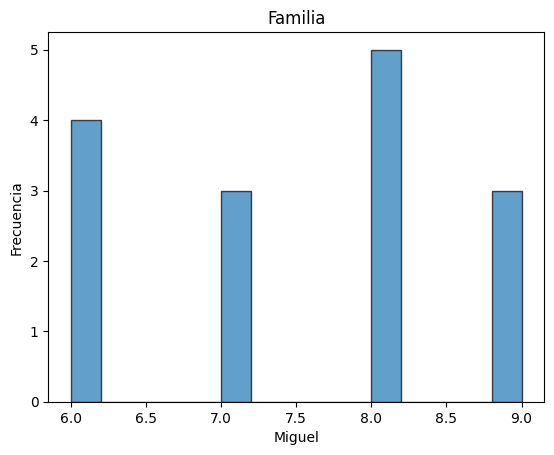

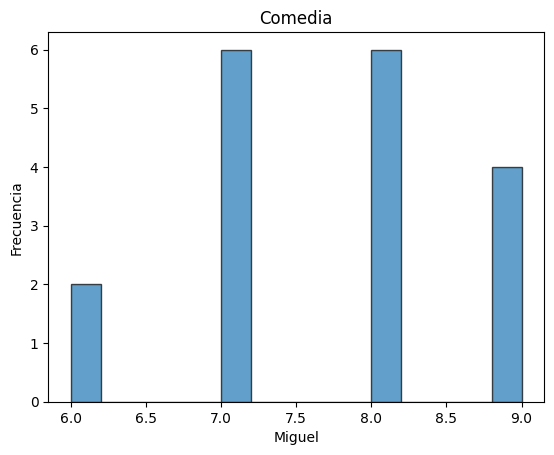

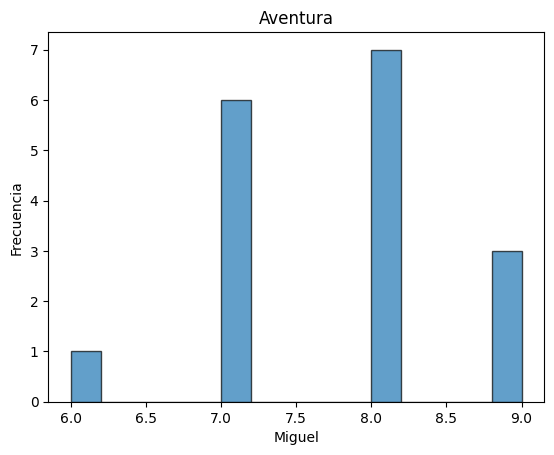

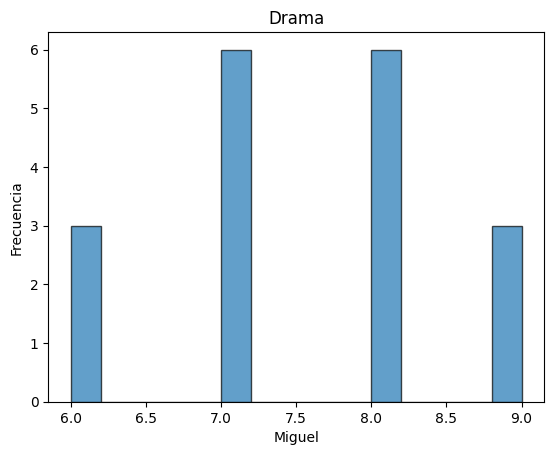

...

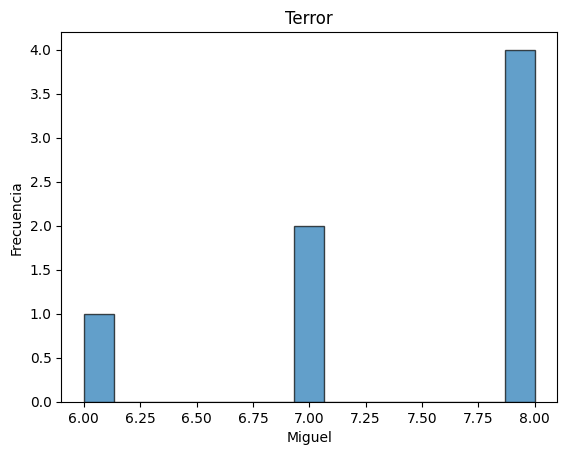

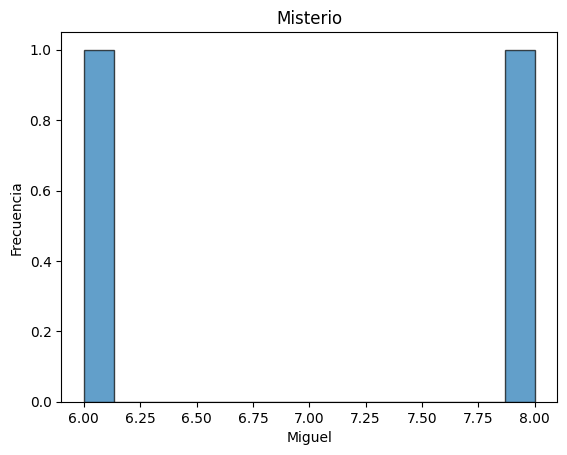

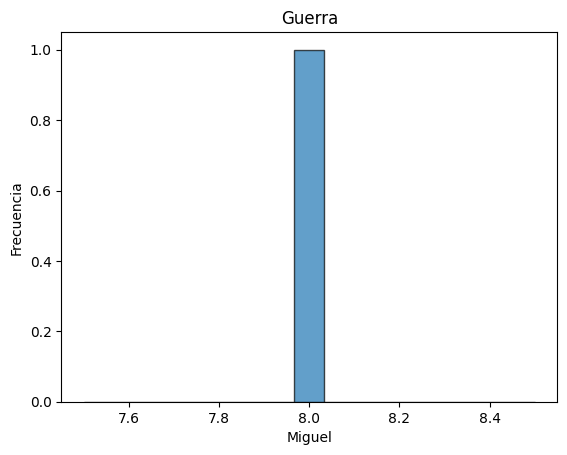

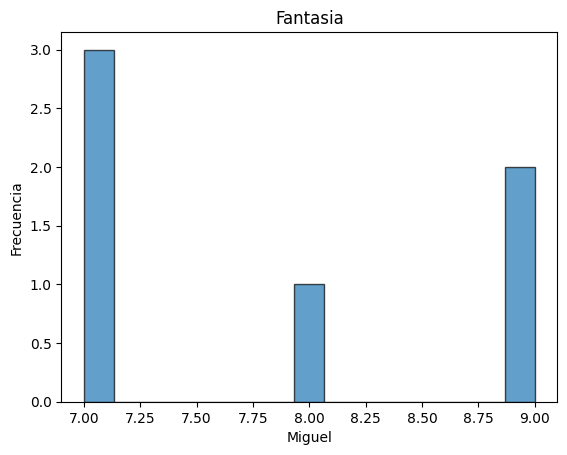

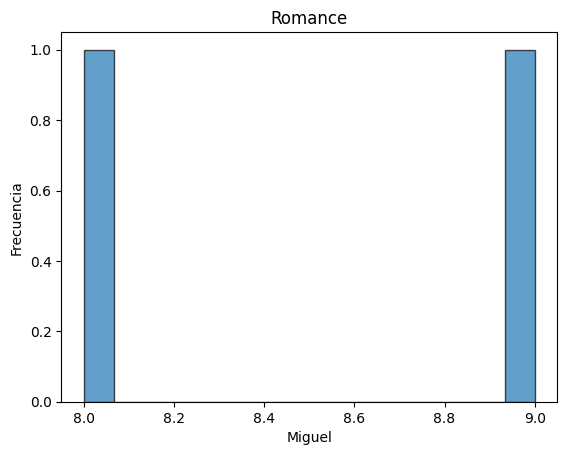

In [ ]:
#3
variable_categorica='Genero'
variable_numerica='Miguel'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

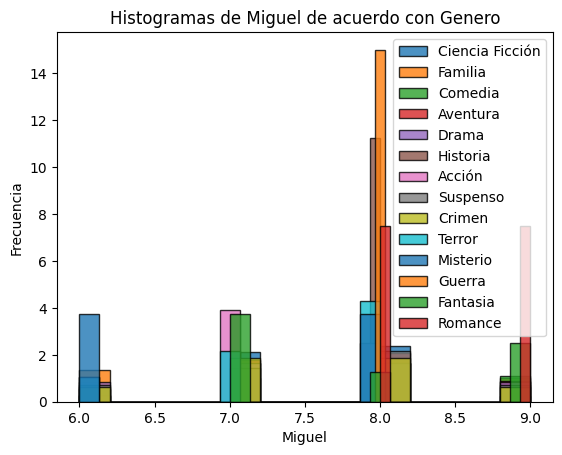

In [ ]:
#4
variable_categorica='Genero'
variable_numerica='Miguel'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

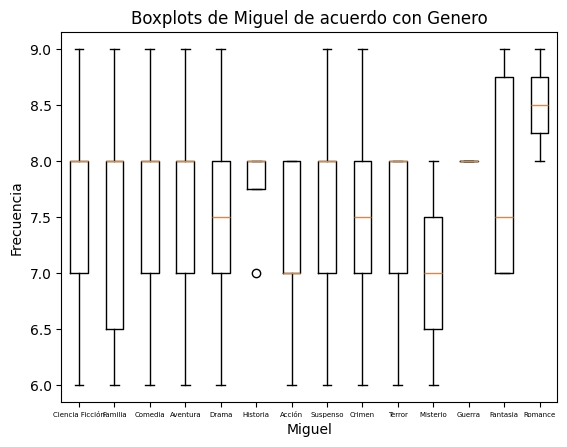

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Genero'
variable_numerica = 'Miguel'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

En el análisis de las calificaciones de "Miguel" por género, el histograma y el boxplot destacan que los géneros "Fantasía" y "Romance" reciben calificaciones altas y constantes, reflejando una clara preferencia por estos géneros. Además, el boxplot revela que mientras algunos géneros, como "Terror" y "Historia," muestran valores atípicos, indicando variabilidad en su percepción, otros como "Comedia" y "Suspenso" tienen una menor dispersión y calificaciones más bajas, sugiriendo un interés menor. En conjunto, las gráficas reflejan una inclinación marcada hacia ciertos géneros, mientras que otros muestran una apreciación más variable y menos favorable.


### **Sub genero**

In [ ]:
df.groupby("Subgenero")['Miguel'].mean()

,Miguel
Subgenero,
Acción,7.375000
Aventura,7.440000
Ciencia Ficción,7.733333
Comedia,7.727273
Crimen,7.625000
Drama,7.461538
Familia,7.875000
Fantasia,7.111111
Guerra,7.800000


In [ ]:
df.groupby("Subgenero")['Miguel'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Subgenero,,,,,,,,
Acción,7.375000,6,9,0.806226,16,7.0,7.00,8.00
Aventura,7.440000,6,9,1.003328,25,7.0,7.00,8.00
Ciencia Ficción,7.733333,6,9,0.798809,15,8.0,7.00,8.00
Comedia,7.727273,7,9,0.646670,11,8.0,7.00,8.00
Crimen,7.625000,6,9,0.916125,8,8.0,7.00,8.00
Drama,7.461538,6,9,0.776250,13,7.0,7.00,8.00
Familia,7.875000,7,9,0.806226,16,8.0,7.00,8.25
Fantasia,7.111111,6,9,0.927961,9,7.0,7.00,7.00
Guerra,7.800000,6,9,1.095445,5,8.0,8.00,8.00


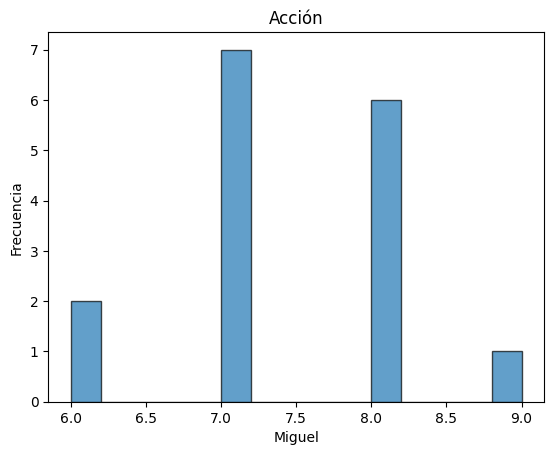

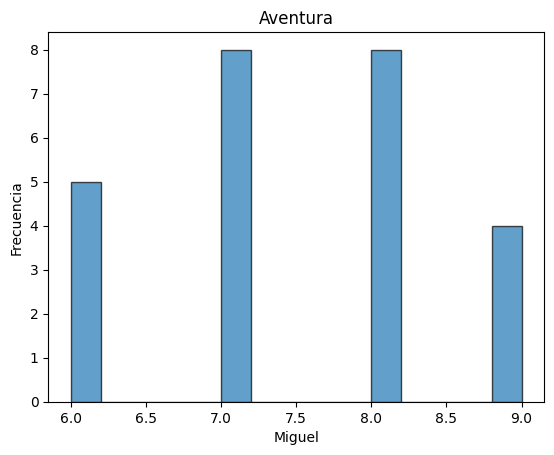

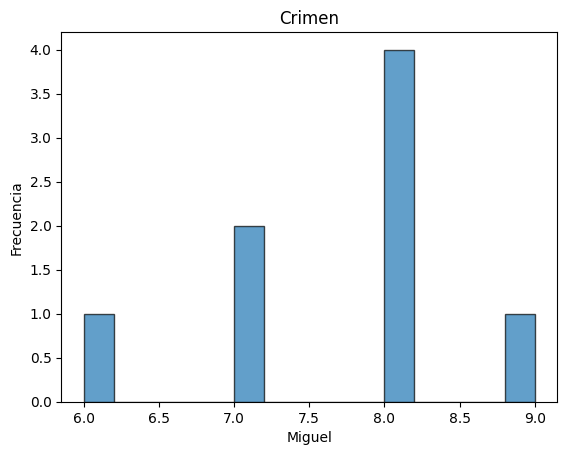

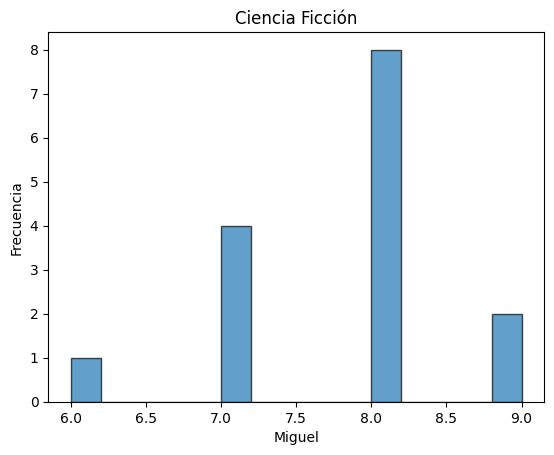

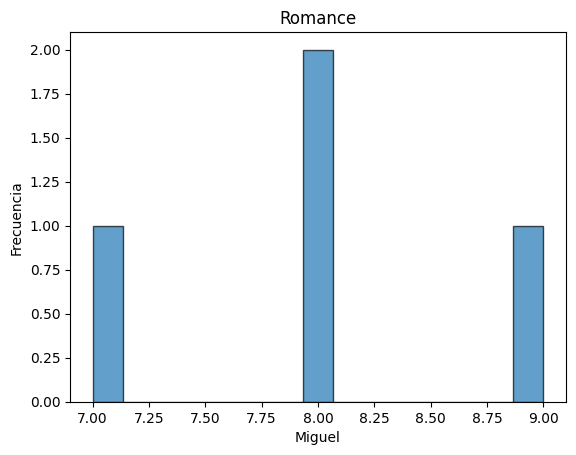

...

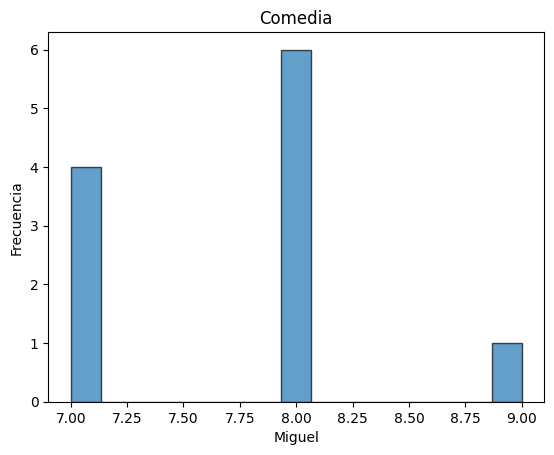

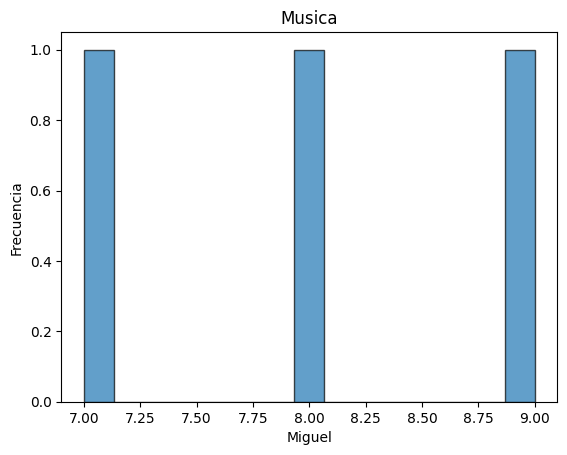

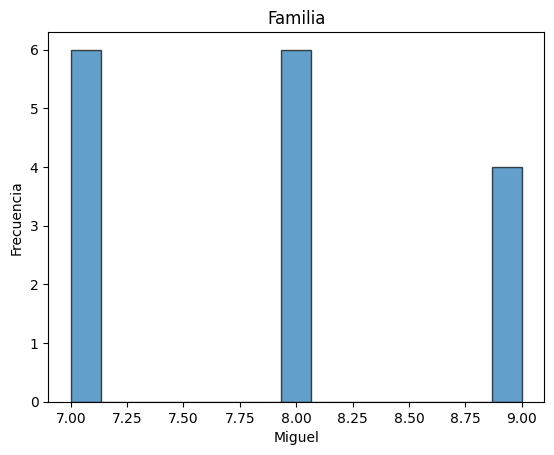

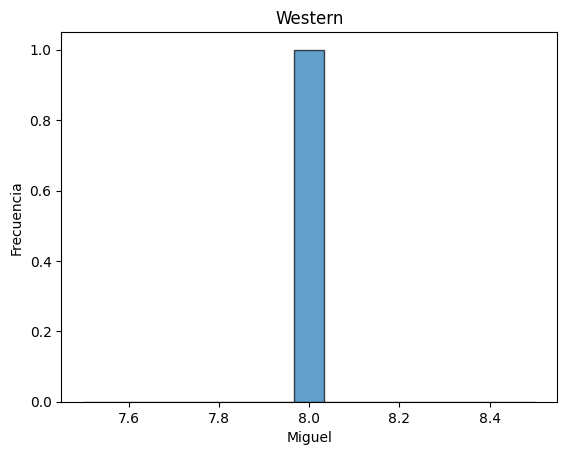

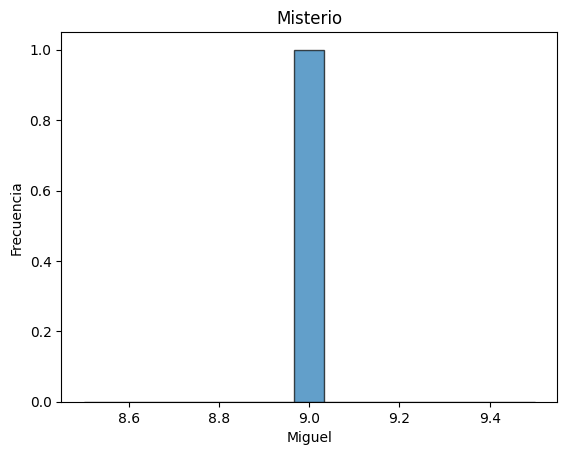

In [ ]:
variable_categorica='Subgenero'
variable_numerica='Miguel'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

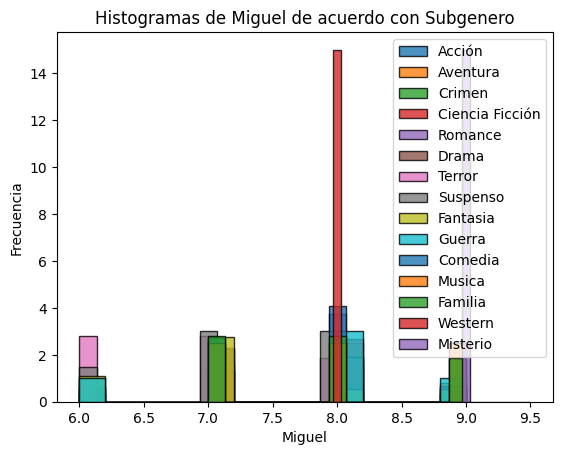

In [ ]:
variable_categorica='Subgenero'
variable_numerica='Miguel'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

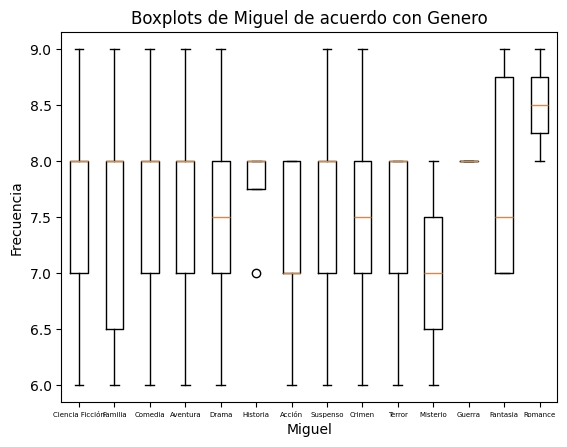

<Figure size 1000x1000 with 0 Axes>

In [ ]:
variable_categorica = 'Genero'
variable_numerica = 'Miguel'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Miguel muestra una preferencia clara por ciertos subgéneros, como "Romance", "Ciencia Ficción" y "Fantasía", en los cuales sus calificaciones son consistentemente altas y con baja dispersión, lo que indica una percepción positiva y estable hacia estos géneros. En contraste, sub géneros como "Terror" y "Misterio" presentan una mayor variabilidad en sus calificaciones, reflejando una percepción menos consistente. Además, géneros como "Historia" y "Guerra" muestran una dispersión amplia y algunos outliers, sugiriendo respuestas mixtas o menos predecibles de Miguel en estos casos. En la mayoría de los casos el patrón sugiere que mientras Miguel tiene una afinidad marcada hacia ciertos subgéneros, su percepción de otros varía considerablemente, influenciada quizás por la calidad o características específicas de cada película.


### **Año**

In [ ]:
df.groupby("Año")['Miguel'].mean()

,Miguel
Año,
1976,6.000000
1977,9.000000
1978,7.000000
1980,7.333333
1981,7.000000
1982,8.000000
1983,7.000000
1984,8.000000
1993,9.000000


In [ ]:
df.groupby("Año")['Miguel'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Año,,,,,,,,
1976,6.000000,6,6,NaN,1,6.0,6.00,6.00
1977,9.000000,9,9,NaN,1,9.0,9.00,9.00
1978,7.000000,7,7,NaN,1,7.0,7.00,7.00
1980,7.333333,6,8,1.154701,3,8.0,7.00,8.00
1981,7.000000,7,7,NaN,1,7.0,7.00,7.00
1982,8.000000,7,9,0.816497,4,8.0,7.75,8.25
1983,7.000000,7,7,NaN,1,7.0,7.00,7.00
1984,8.000000,8,8,0.000000,2,8.0,8.00,8.00
1993,9.000000,9,9,NaN,1,9.0,9.00,9.00


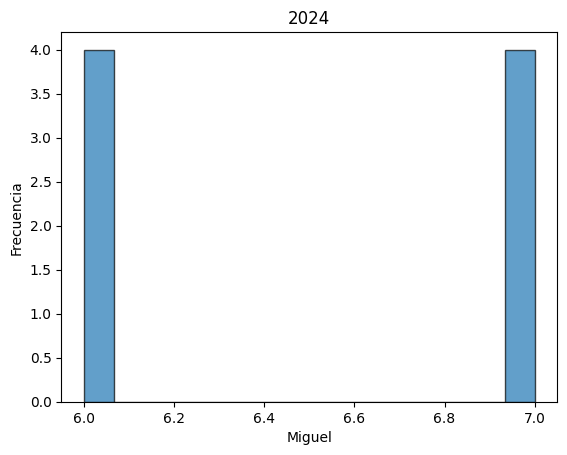

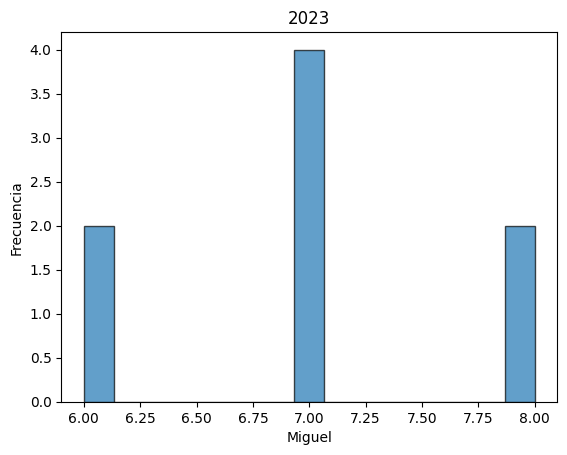

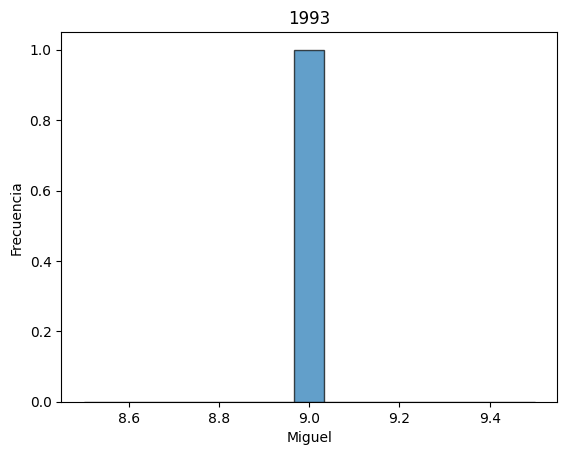

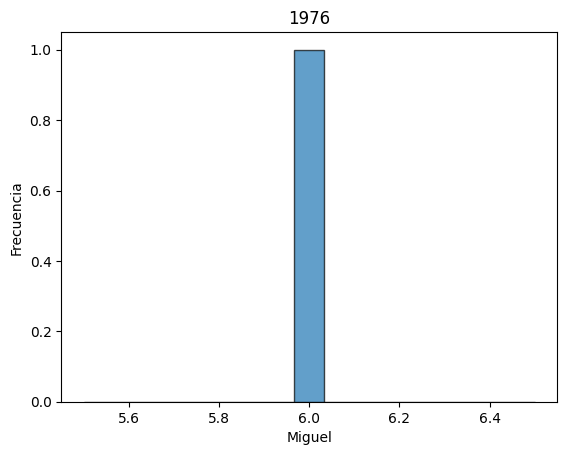

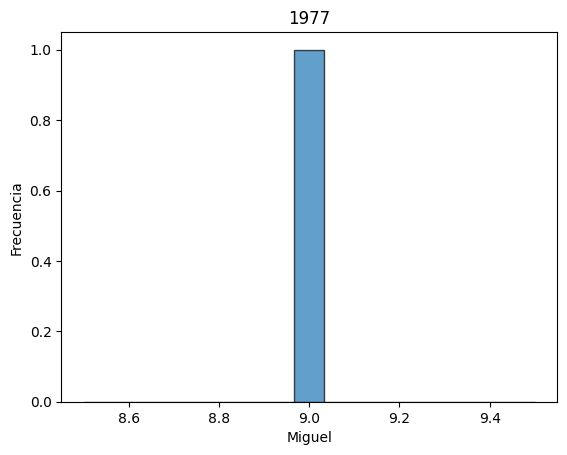

...

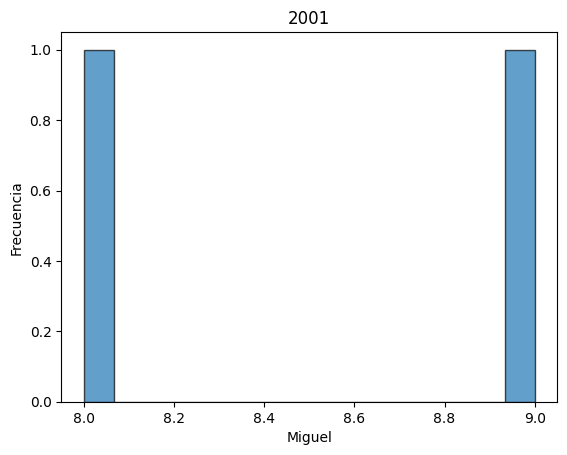

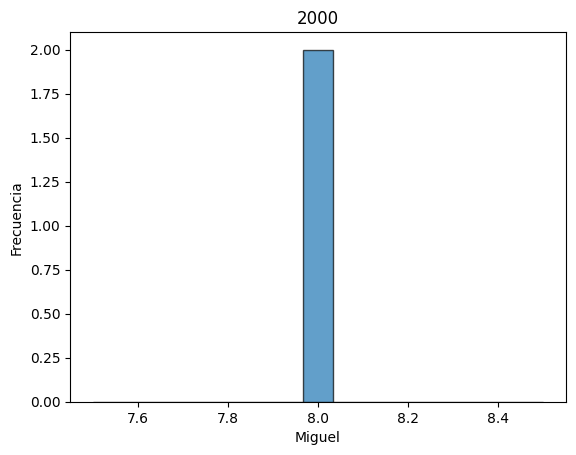

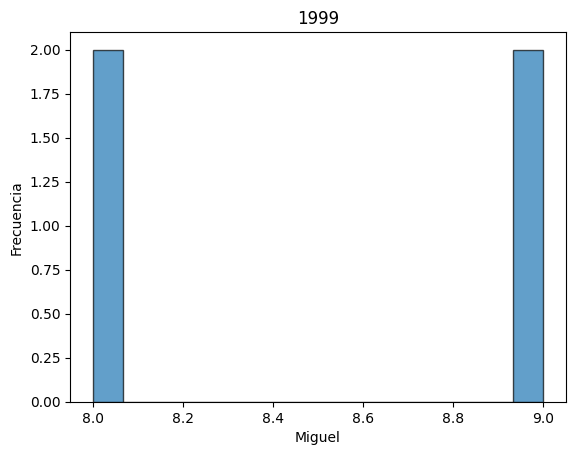

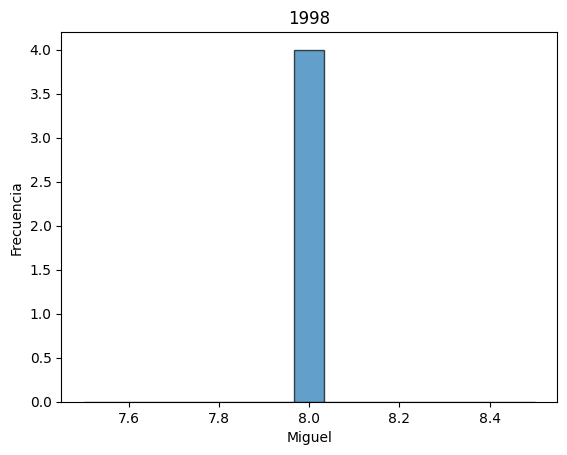

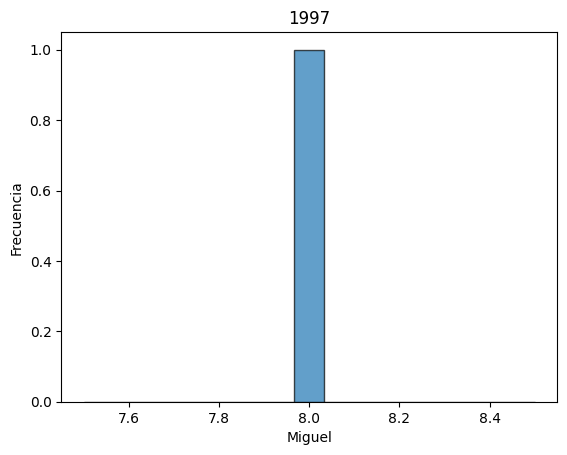

In [ ]:
variable_categorica='Año'
variable_numerica='Miguel'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

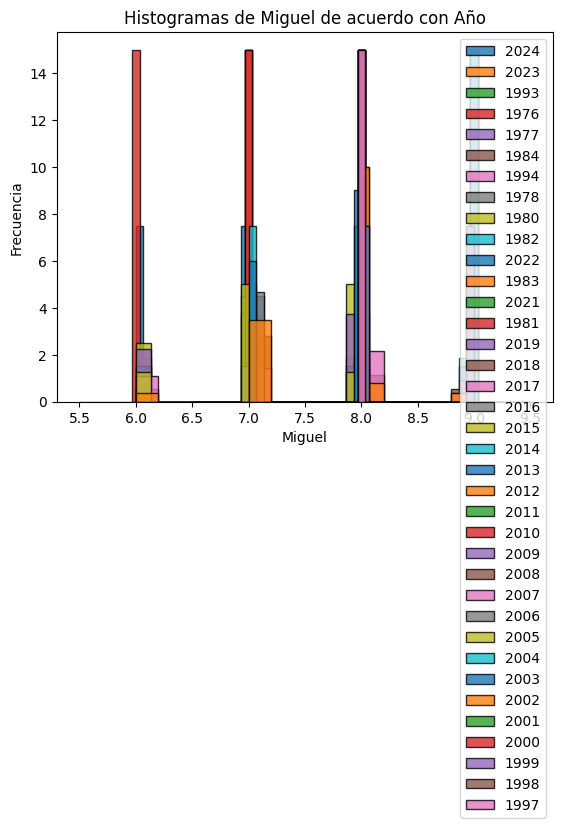

In [ ]:
variable_categorica='Año'
variable_numerica='Miguel'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

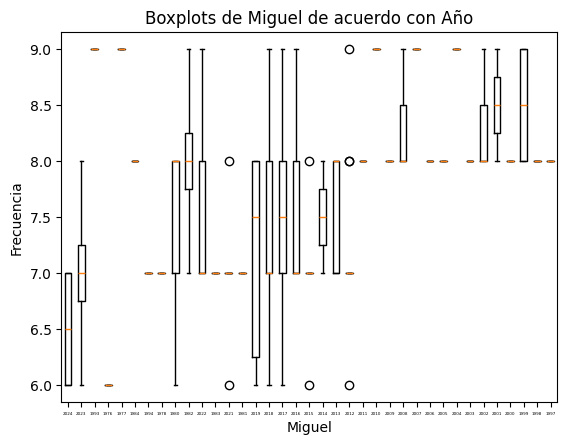

<Figure size 1000x1000 with 0 Axes>

In [ ]:
variable_categorica = 'Año'
variable_numerica = 'Miguel'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=3)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Miguel muestra una tendencia a calificar películas de diferentes décadas de manera variable, pero con una preferencia notable hacia películas de años recientes, que tienden a concentrarse alrededor de calificaciones de 7 y 8 en el histograma. Las películas más antiguas, particularmente aquellas de los años 70 y 80, tienen una mayor dispersión en las calificaciones, lo que sugiere una percepción menos consistente, mientras que películas de años recientes (e.g., 2020-2024) parecen recibir una puntuación más uniforme y positiva. En conjunto, esto indica que Miguel probablemente valora más las producciones recientes, otorgándoles calificaciones altas y constantes, mientras que las películas de décadas anteriores reflejan una mayor variabilidad en su percepción.


### **Clasificación**

In [ ]:
df.groupby("Clasificacion")['Miguel'].mean()

,Miguel
Clasificacion,
G,7.875000
PG,7.788462
PG-13,7.333333
R,7.348837


In [ ]:
df.groupby("Clasificacion")['Miguel'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Clasificacion,,,,,,,,
G,7.875000,6,9,0.991031,8,8.0,7.75,8.25
PG,7.788462,6,9,0.914728,52,8.0,7.00,8.00
PG-13,7.333333,6,9,0.786057,42,7.0,7.00,8.00
R,7.348837,6,9,0.813099,43,7.0,7.00,8.00


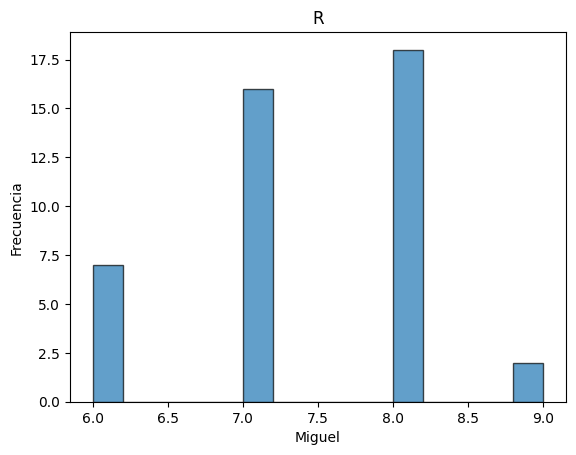

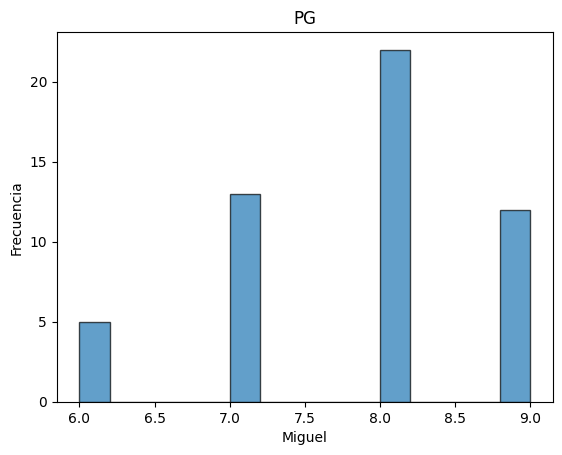

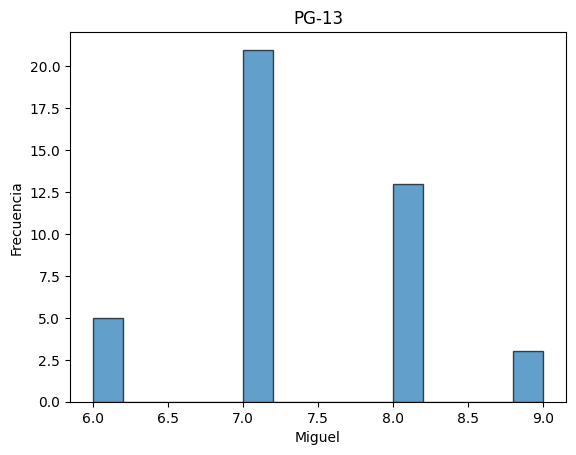

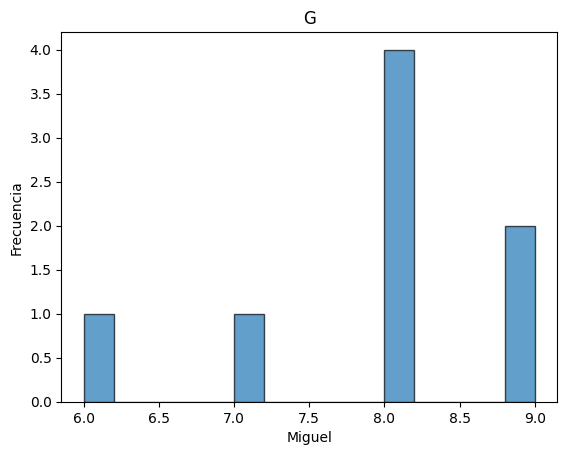

In [ ]:
variable_categorica='Clasificacion'
variable_numerica='Miguel'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

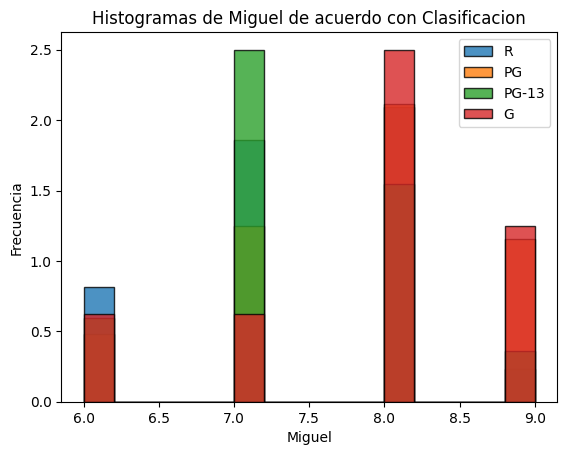

In [ ]:
#4
variable_categorica='Clasificacion'
variable_numerica='Miguel'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

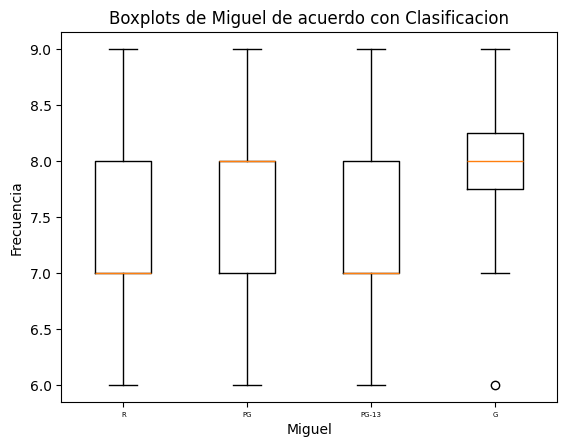

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Clasificacion'
variable_numerica = 'Miguel'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

El análisis de las calificaciones de Miguel, basado en el histograma y el boxplot, muestra una clara preferencia por películas clasificadas como PG-13 y G. Esto sugiere que Miguel tiende a disfrutar de contenido más orientado a un público joven. Además, sus calificaciones para películas PG y PG-13 son más consistentes. Esto se aprecia en la parte de los histogramas y en boxplot, ya que la clasificación G tiene una media mucho más alta en comparación a los otros 3 clasificadores.


### **Animación**

In [ ]:
#1
df.groupby("Animacion")['Miguel'].mean()

,Miguel
Animacion,
no,7.454545
si,7.771429


In [ ]:
#2
df.groupby("Animacion")['Miguel'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Animacion,,,,,,,,
no,7.454545,6,9,0.819894,110,7.0,7.0,8.0
si,7.771429,6,9,1.002518,35,8.0,7.0,8.5


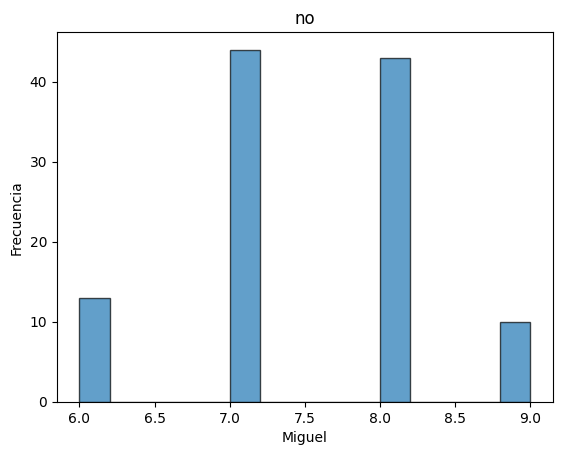

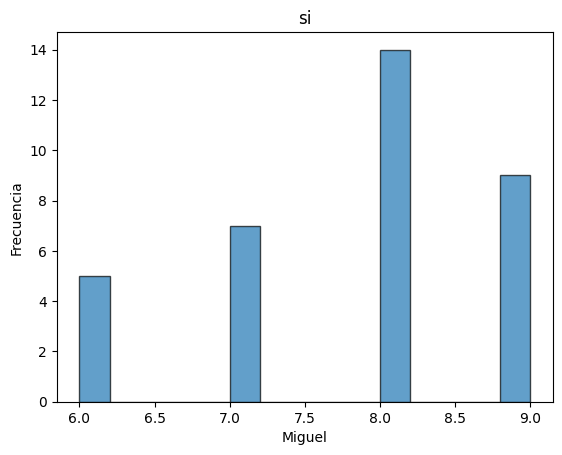

In [ ]:
#3
variable_categorica='Animacion'
variable_numerica='Miguel'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

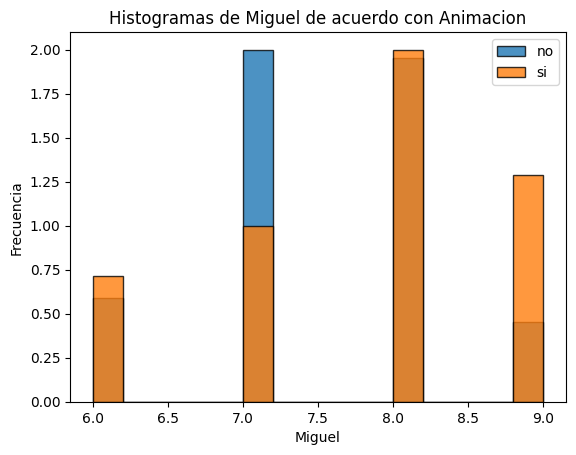

In [ ]:
#4
variable_categorica='Animacion'
variable_numerica='Miguel'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

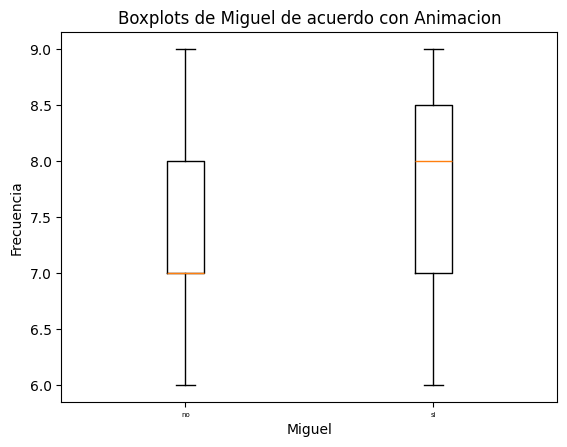

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Animacion'
variable_numerica = 'Miguel'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

El boxplot revela una ligera preferencia de Miguel por las películas animadas. La mediana de las calificaciones para las películas animadas es ligeramente superior, indicando una tendencia a valorarlas más. Sin embargo, la dispersión de las calificaciones es similar en ambos grupos, lo que sugiere una cierta consistencia en su criterio de evaluación, independientemente del tipo de película.


### **Duracion**

In [ ]:
#1
df.groupby("Duracion")['Miguel'].mean()

,Miguel
Duracion,
78,8.000000
83,7.000000
86,8.000000
88,8.000000
90,7.666667
...,...
180,8.000000
181,7.500000
189,9.000000


In [ ]:
#2
df.groupby("Duracion")['Miguel'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Duracion,,,,,,,,
78,8.000000,8,8,NaN,1,8.0,8.00,8.00
83,7.000000,7,7,NaN,1,7.0,7.00,7.00
86,8.000000,8,8,NaN,1,8.0,8.00,8.00
88,8.000000,8,8,NaN,1,8.0,8.00,8.00
90,7.666667,6,9,1.527525,3,8.0,7.00,8.50
...,...,...,...,...,...,...,...,...
180,8.000000,8,8,NaN,1,8.0,8.00,8.00
181,7.500000,7,8,0.707107,2,7.5,7.25,7.75
189,9.000000,9,9,NaN,1,9.0,9.00,9.00


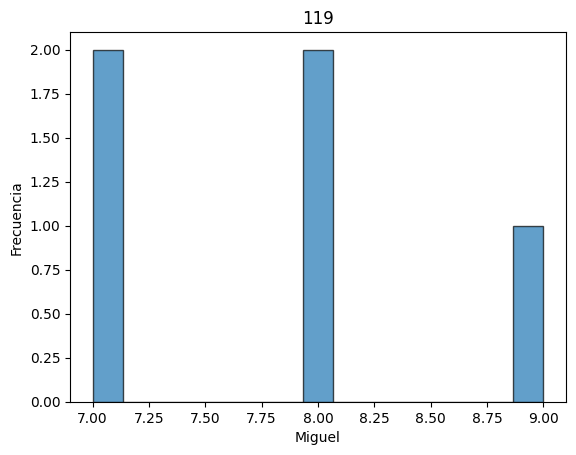

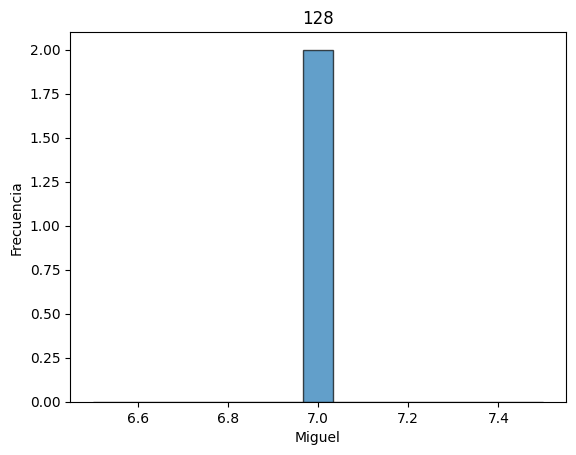

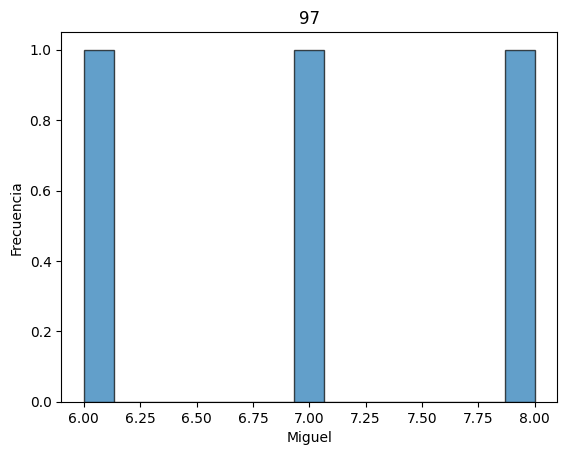

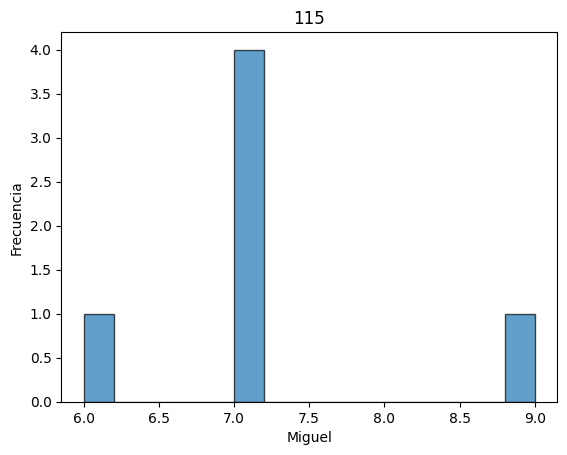

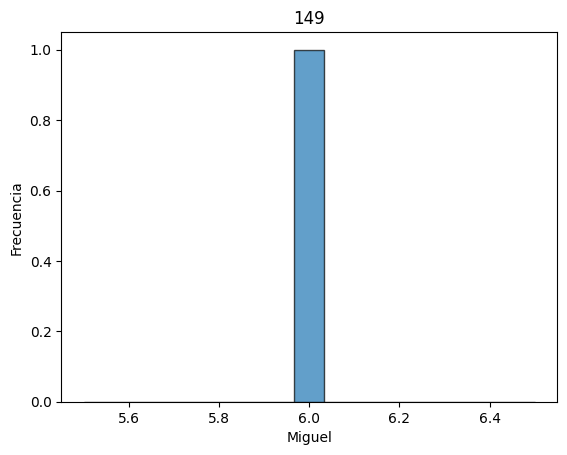

...

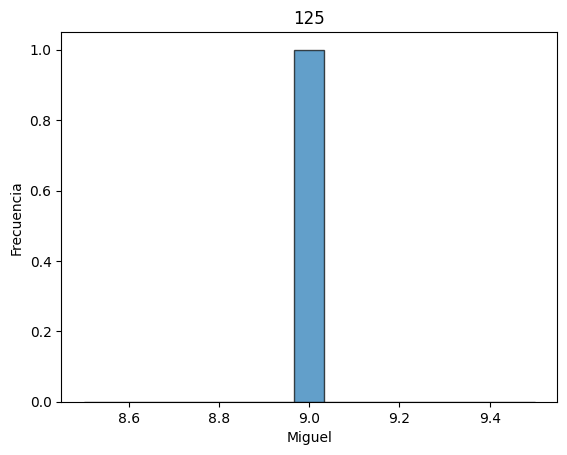

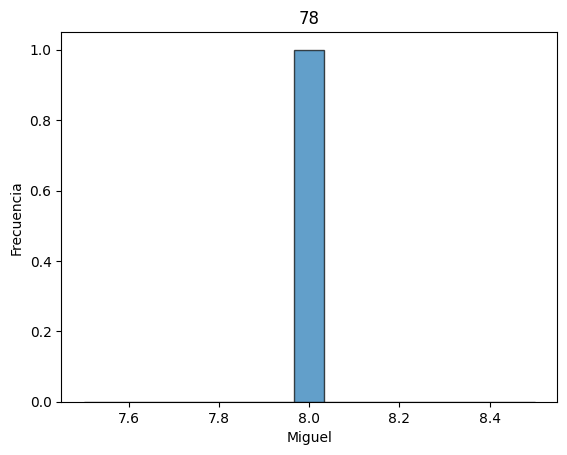

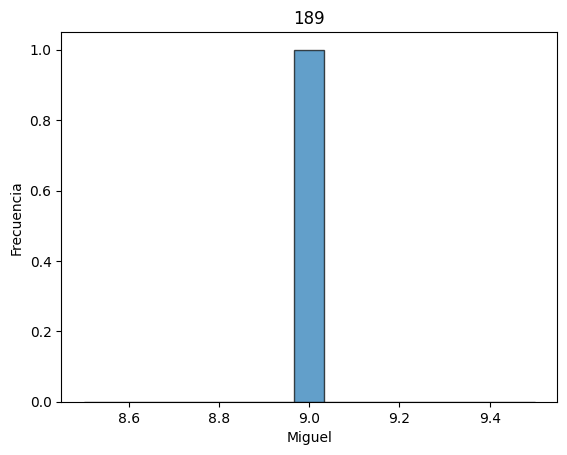

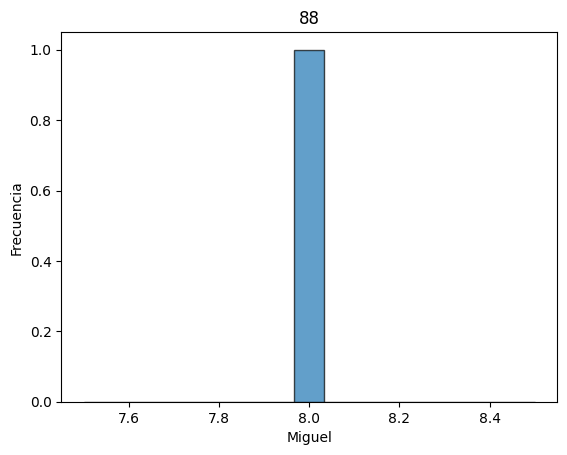

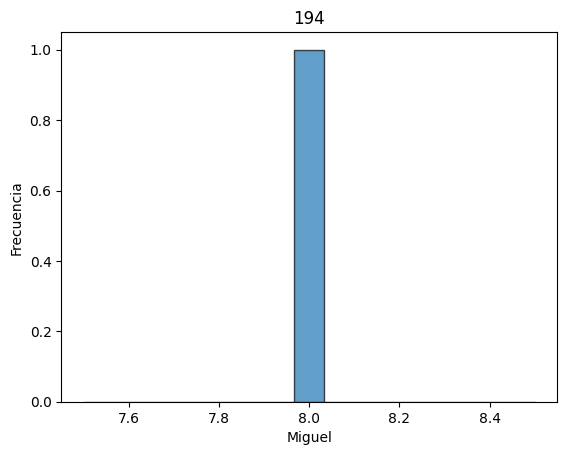

In [ ]:
#3
variable_categorica='Duracion'
variable_numerica='Miguel'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

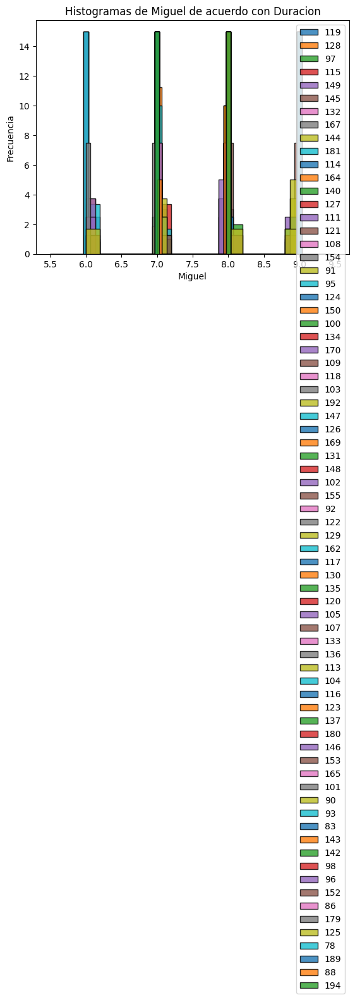

In [ ]:
#4
variable_categorica='Duracion'
variable_numerica='Miguel'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

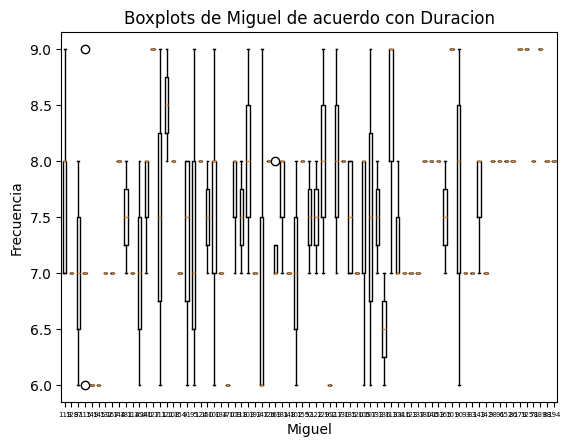

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Duracion'
variable_numerica = 'Miguel'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

El histograma que relaciona la duración de las películas con las calificaciones otorgadas por Miguel revela una complejidad visual debido a la gran cantidad de duraciones diferentes. Sin embargo, se puede apreciar una tendencia general: las calificaciones más altas se distribuyen a lo largo de un amplio rango de duraciones, sugiriendo que Miguel disfruta de películas de diversas longitudes. A pesar de esto, la gran cantidad de variables involucradas dificulta establecer conclusiones definitivas. Haciendo que el análisis sea complicado de ejecutar.


### **Criticos**

In [ ]:
#1
df.groupby("Criticos")['Miguel'].mean()

,Miguel
Criticos,
5.3,8.000000
5.5,8.000000
5.6,6.500000
5.7,6.000000
6.0,7.000000
6.2,7.000000
6.4,7.000000
6.5,6.000000
6.6,7.333333


In [ ]:
#2
df.groupby("Criticos")['Miguel'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Criticos,,,,,,,,
5.3,8.000000,8,8,NaN,1,8.0,8.00,8.00
5.5,8.000000,8,8,NaN,1,8.0,8.00,8.00
5.6,6.500000,6,7,0.707107,2,6.5,6.25,6.75
5.7,6.000000,6,6,NaN,1,6.0,6.00,6.00
6.0,7.000000,7,7,0.000000,2,7.0,7.00,7.00
6.2,7.000000,7,7,NaN,1,7.0,7.00,7.00
6.4,7.000000,7,7,NaN,1,7.0,7.00,7.00
6.5,6.000000,6,6,NaN,1,6.0,6.00,6.00
6.6,7.333333,6,9,1.527525,3,7.0,6.50,8.00


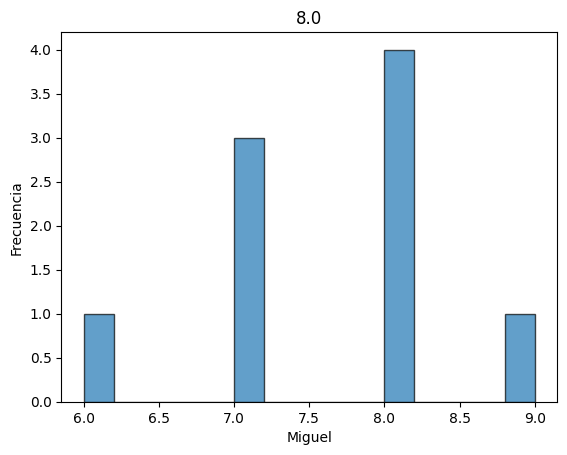

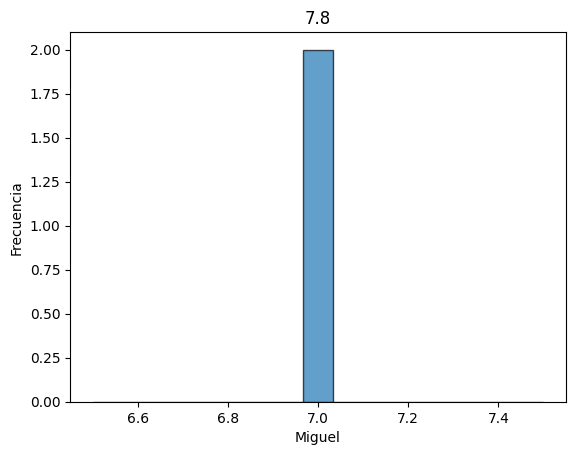

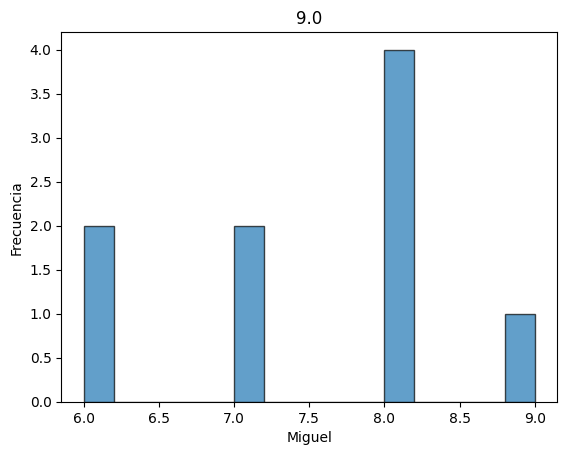

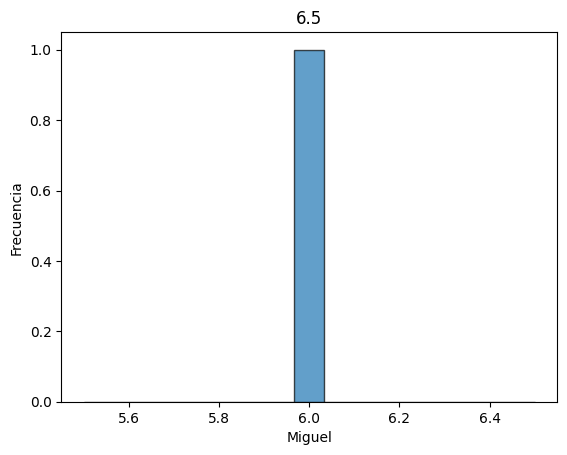

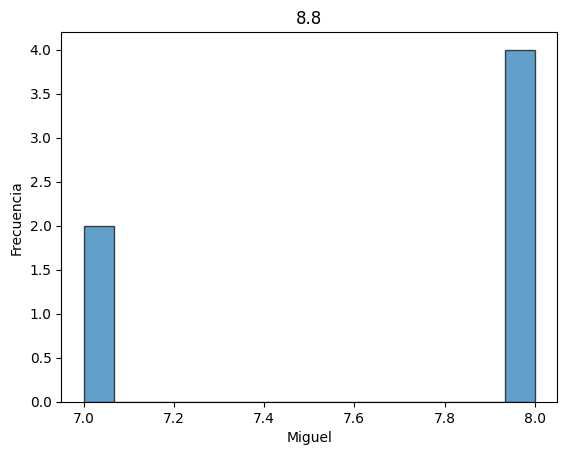

...

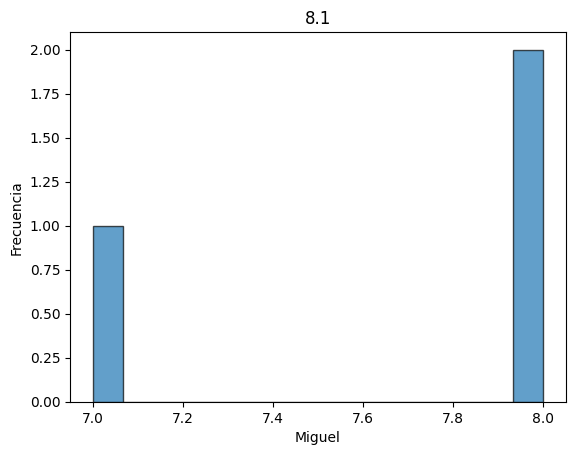

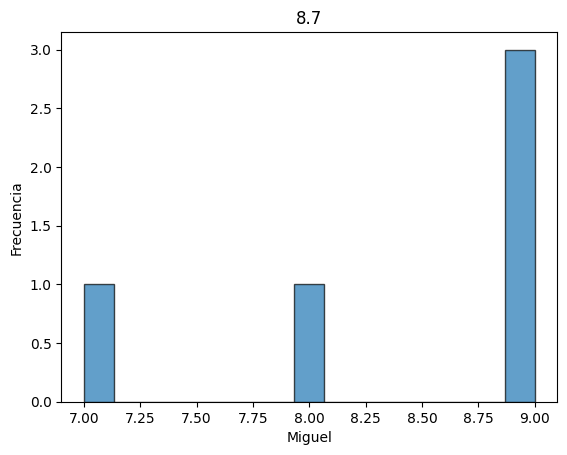

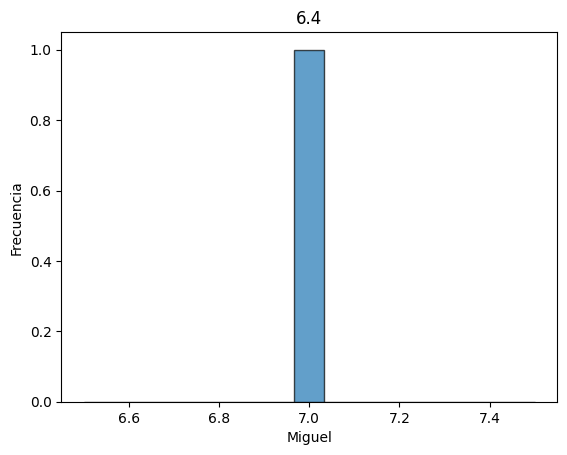

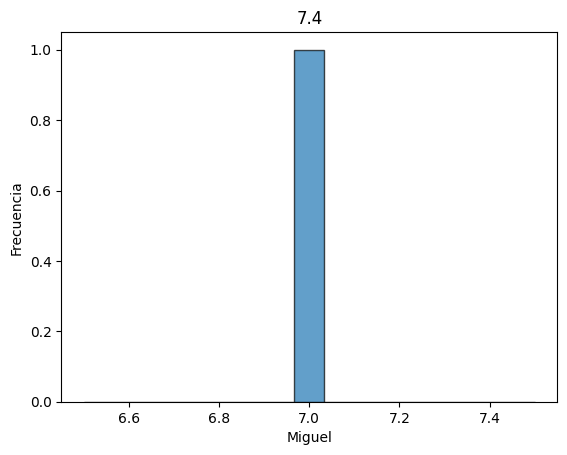

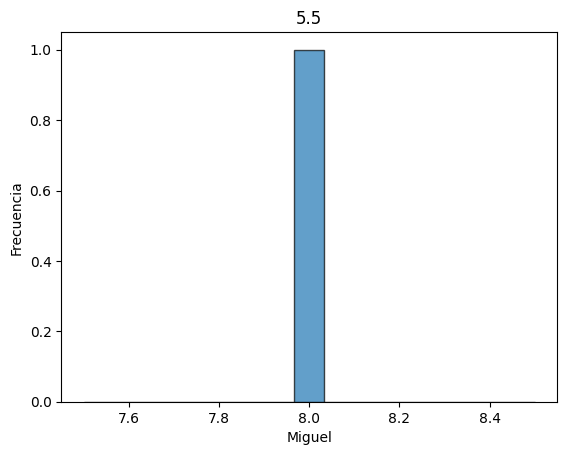

In [ ]:
#3
variable_categorica='Criticos'
variable_numerica='Miguel'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

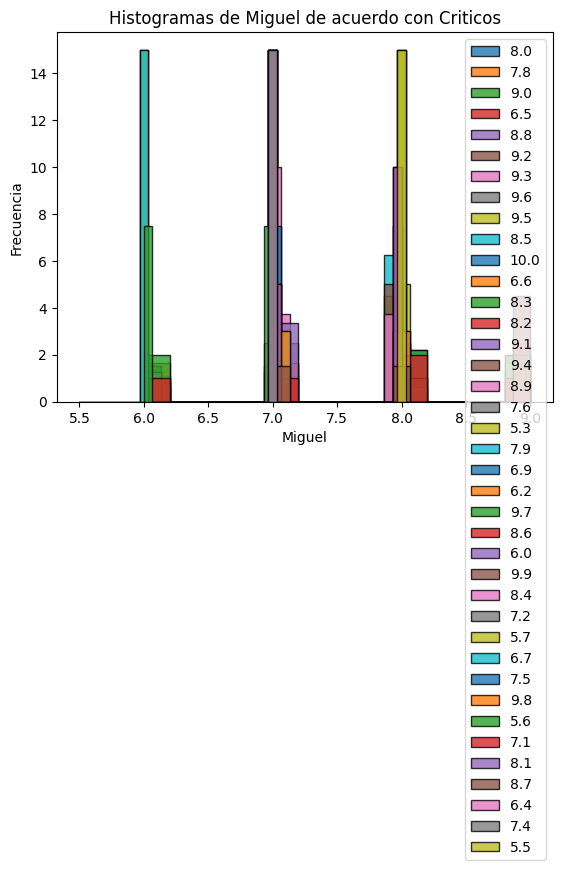

In [ ]:
#4
variable_categorica='Criticos'
variable_numerica='Miguel'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

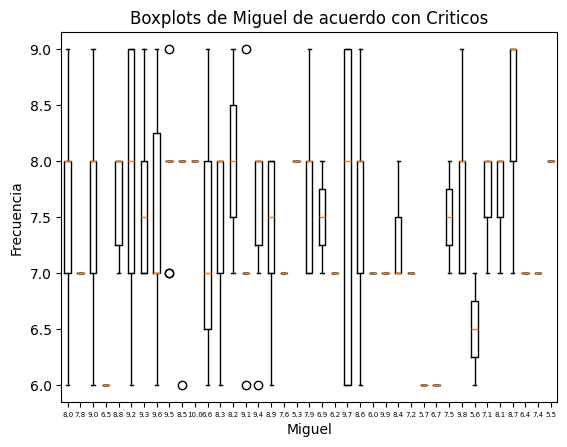

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Criticos'
variable_numerica = 'Miguel'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

A través de la interpretación del boxplot podemos ver que las calificaciones de Miguel presentan una dispersión significativa, lo cual nos indica que en algunas ocasiones puede coincidir o diferir la tendencia de los críticos. En general, en la gráfica podemos evidenciar que existen valores atípicos que sobresalen por ser mucho más alto o mucho más bajo de los críticos, por lo que podemos definir que algunas categorías Miguel suele alinearse con la opinión general de los críticos, mientras que en otras podemos ver que el criterio a valor de las películas no son el mismo.


### Audiencia



In [ ]:
#1
df.groupby("Audiencia")['Miguel'].mean()

,Miguel
Audiencia,
5.4,6.000000
5.6,6.000000
5.8,6.666667
6.0,7.000000
6.2,7.000000
6.4,6.000000
6.6,7.000000
6.8,6.875000
7.0,7.363636


In [ ]:
#2
df.groupby("Audiencia")['Miguel'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Audiencia,,,,,,,,
5.4,6.000000,6,6,NaN,1,6.0,6.00,6.00
5.6,6.000000,6,6,NaN,1,6.0,6.00,6.00
5.8,6.666667,6,7,0.577350,3,7.0,6.50,7.00
6.0,7.000000,6,8,0.816497,4,7.0,6.75,7.25
6.2,7.000000,7,7,0.000000,2,7.0,7.00,7.00
6.4,6.000000,6,6,NaN,1,6.0,6.00,6.00
6.6,7.000000,6,8,0.707107,5,7.0,7.00,7.00
6.8,6.875000,6,8,0.640870,8,7.0,6.75,7.00
7.0,7.363636,6,9,0.809040,11,7.0,7.00,8.00


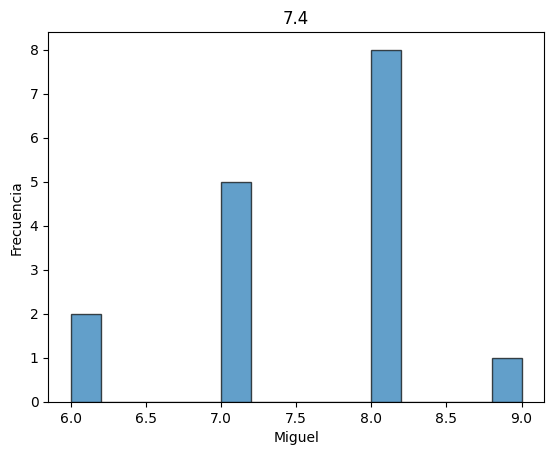

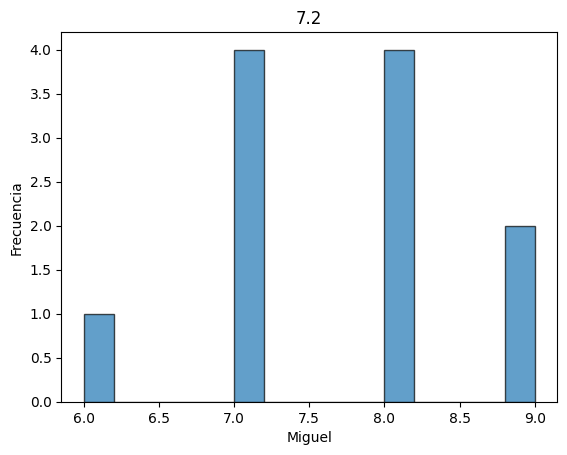

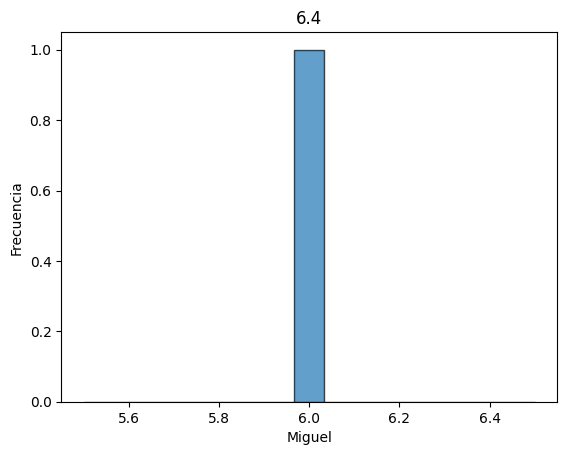

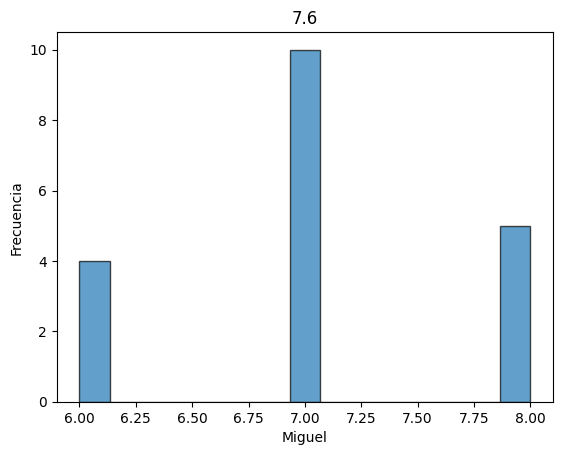

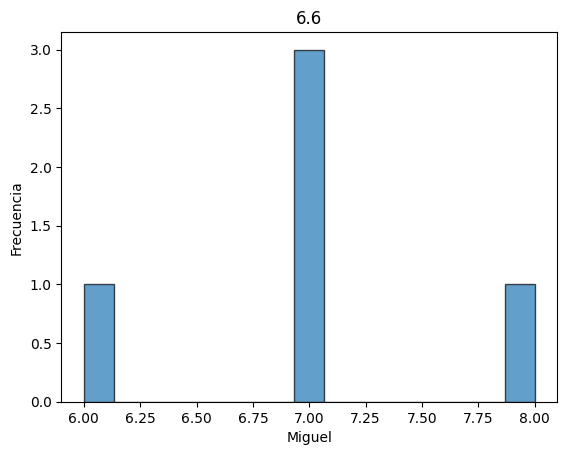

...

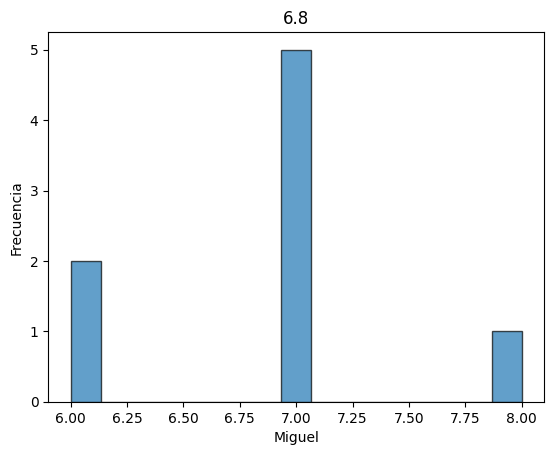

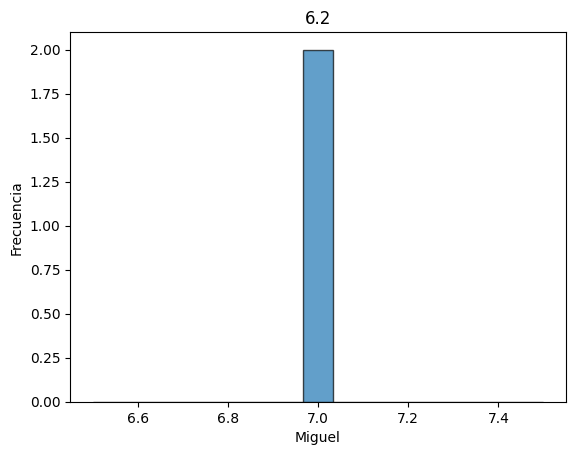

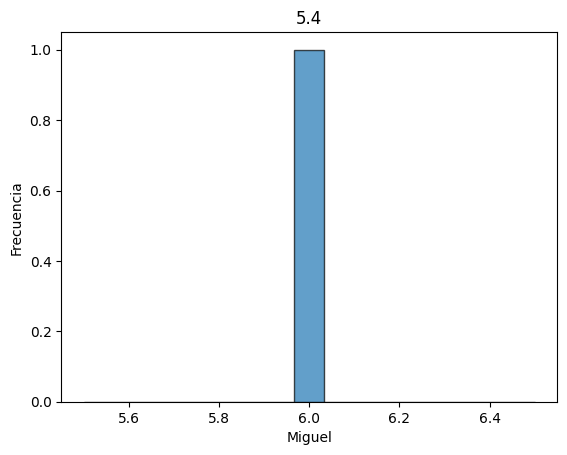

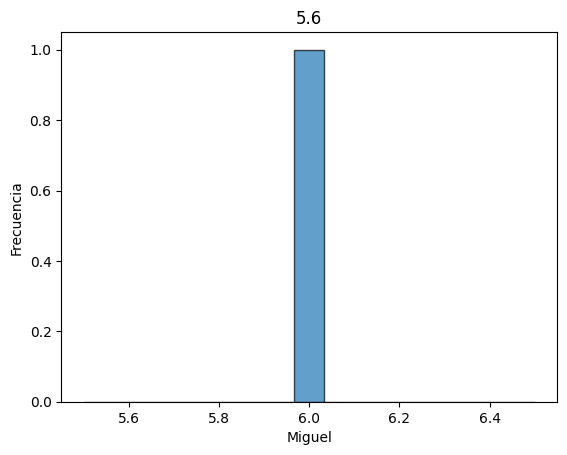

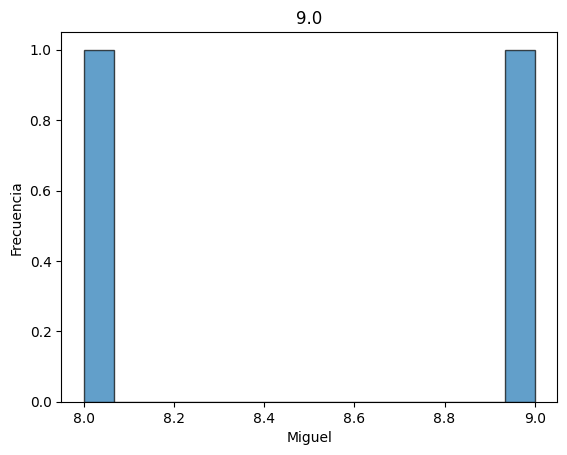

In [ ]:
#3
variable_categorica='Audiencia'
variable_numerica='Miguel'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

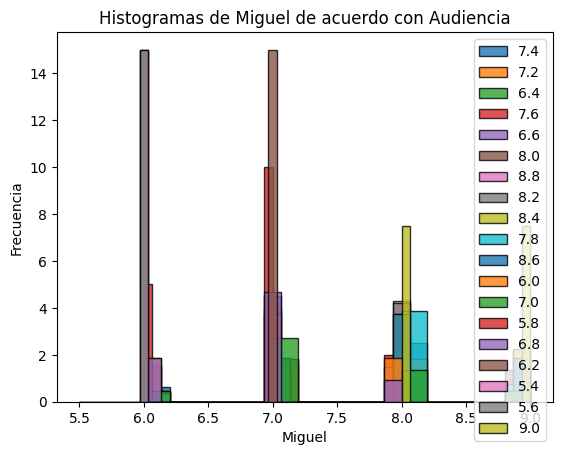

In [ ]:
#4
variable_categorica='Audiencia'
variable_numerica='Miguel'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

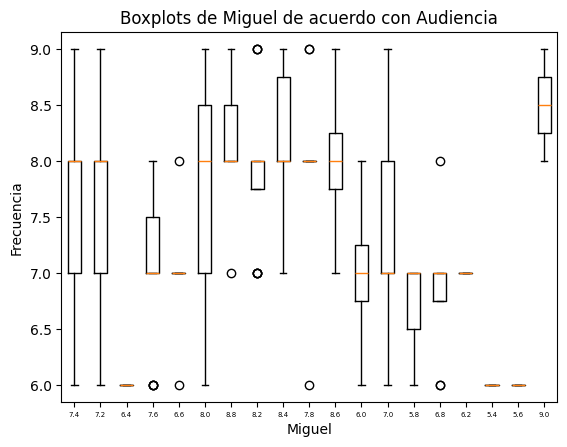

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Audiencia'
variable_numerica = 'Miguel'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Al comparar las calificaciones de Miguel con la de la audiencia podemos ver que existe una variedad en puntos significativos de la gráfica. Podemos ver que Miguel suele ser más generoso otorgando calificaciones a comparación de la audiencia. Por ejemplo, en el histograma vemos que los rangos de frecuencia más alto entre estos dos grupos es del 6.0 a 8.0; en general, Miguel suele diferir con la percepción general del público, por lo que podemos ver que tiene un criterio más personal y diverso al calificarlas.


## Emilio

### Genero

In [ ]:
#1
df.groupby("Genero")['Emilio'].mean()

,Emilio
Genero,
Acción,4.666667
Aventura,4.705882
Ciencia Ficción,5.105263
Comedia,3.333333
Crimen,5.375000
Drama,6.666667
Familia,4.266667
Fantasia,5.000000
Guerra,3.000000


In [ ]:
#2
df.groupby("Genero")['Emilio'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Genero,,,,,,,,
Acción,4.666667,3,8,1.278019,21,4.0,4.00,5.00
Aventura,4.705882,2,9,1.490164,17,4.0,4.00,5.00
Ciencia Ficción,5.105263,3,7,0.994135,19,5.0,5.00,5.50
Comedia,3.333333,2,6,1.137593,18,3.0,3.00,3.75
Crimen,5.375000,3,8,1.505941,8,5.5,4.75,6.00
Drama,6.666667,4,9,1.371989,18,6.5,6.00,7.75
Familia,4.266667,3,6,0.961150,15,4.0,4.00,5.00
Fantasia,5.000000,4,6,0.894427,6,5.0,4.25,5.75
Guerra,3.000000,3,3,NaN,1,3.0,3.00,3.00


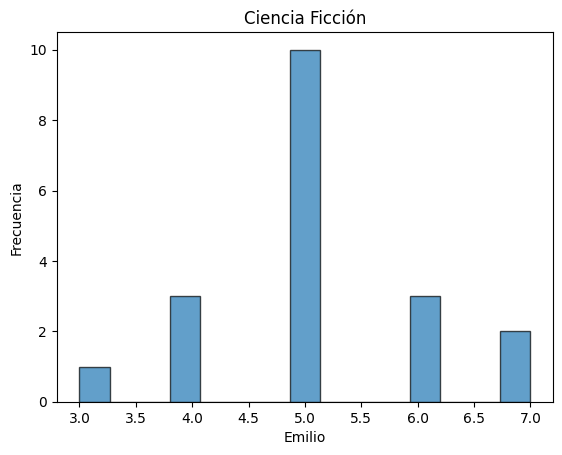

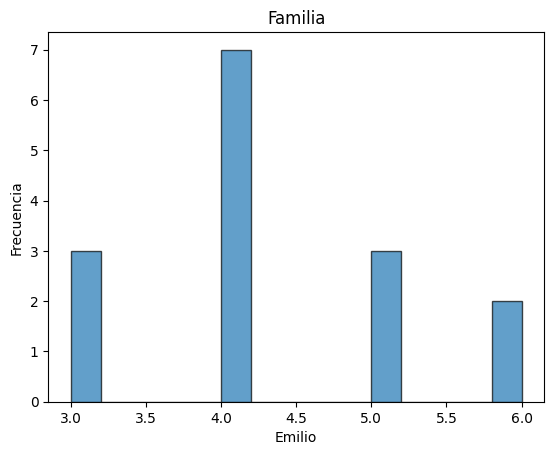

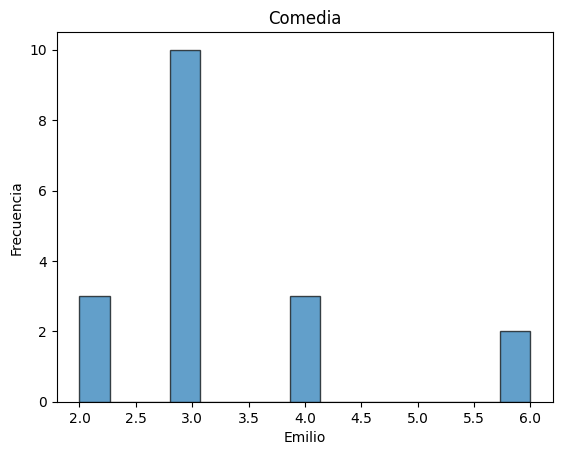

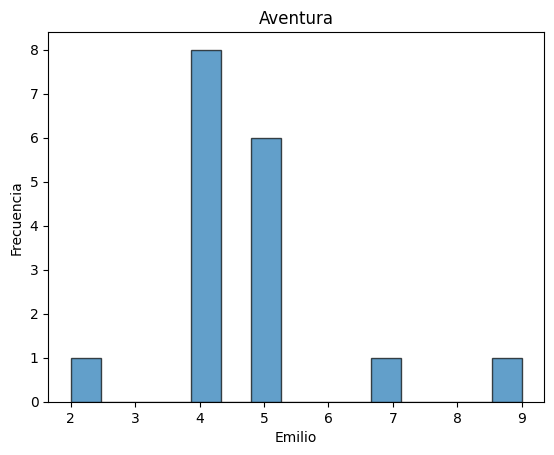

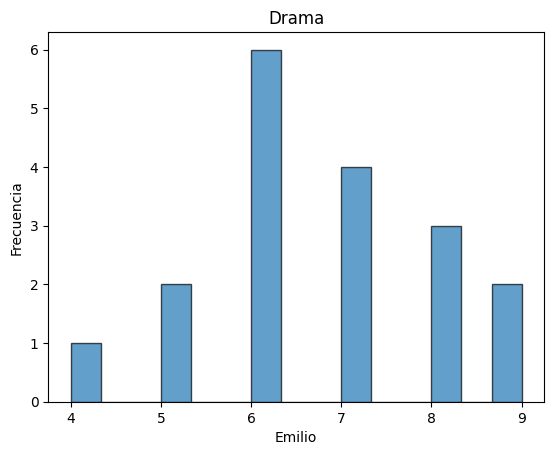

...

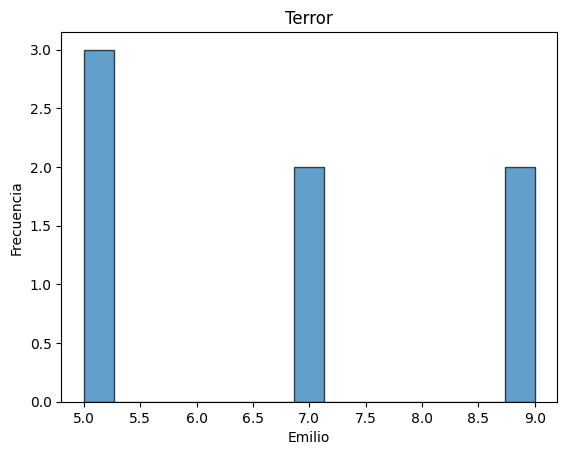

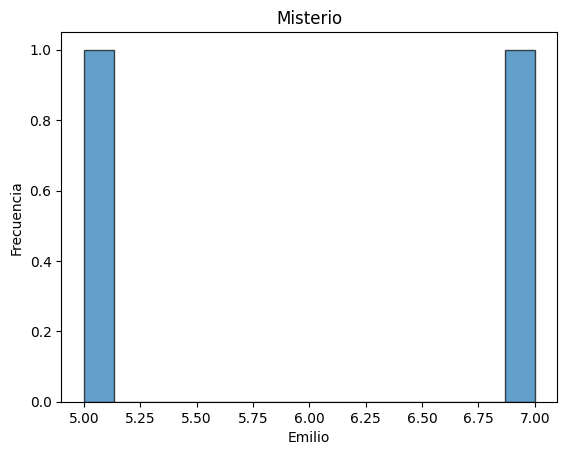

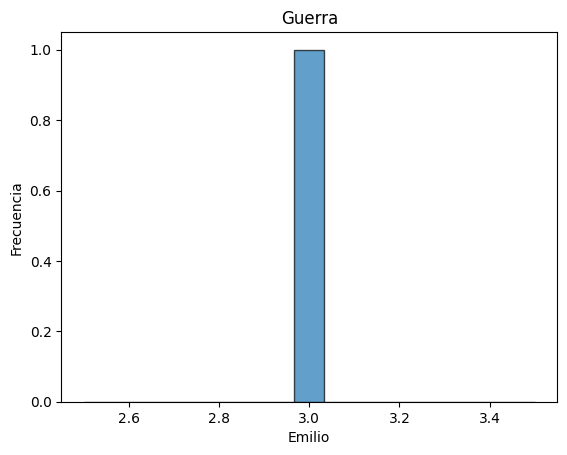

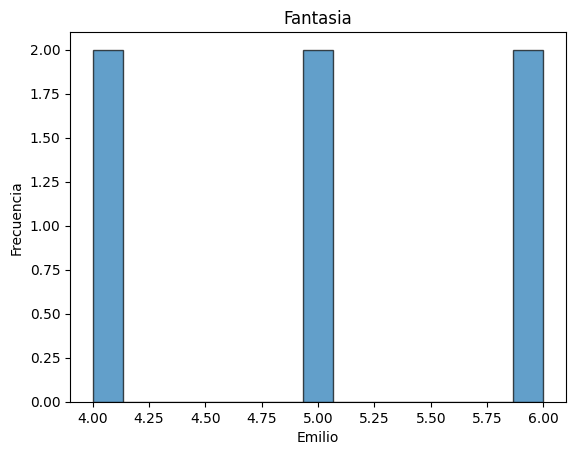

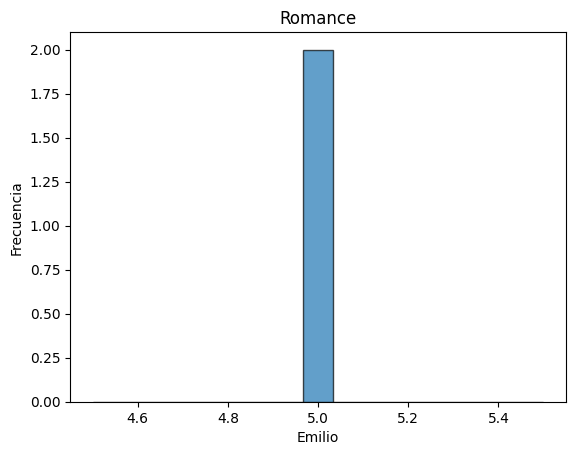

In [ ]:
#3
variable_categorica='Genero'
variable_numerica='Emilio'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

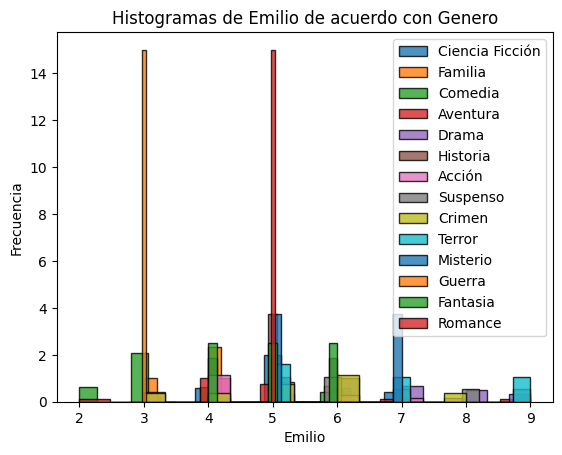

In [ ]:
#4
variable_categorica='Genero'
variable_numerica='Emilio'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

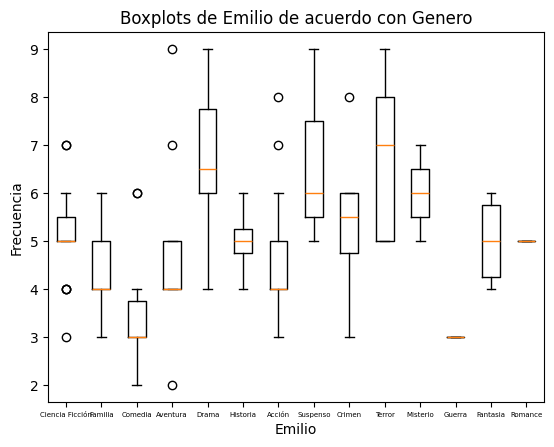

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Genero'
variable_numerica = 'Emilio'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Las calificaciones de Emilio, según el género, se exhiben en la tabla y el boxplot. En general, el boxplot parece mostrar que Emilio tiende a calificar los géneros de drama, terror y suspenso más rápido que los de comedia y guerra. Asimismo, el boxplot también presenta una cantidad significativa de variabilidad en las puntuaciones evaluadas de drama y terror con algunos valores atípicos, que sugieren que algunas calificaciones son inusuales. Por otro lado, el romance y la guerra exhiben menos dispersión en el boxplot, lo que es sugerente de un criterio de evaluación más constante.


### Sub genero

In [ ]:
#1
df.groupby("Subgenero")['Emilio'].mean()

,Emilio
Subgenero,
Acción,5.000000
Aventura,4.680000
Ciencia Ficción,5.533333
Comedia,3.181818
Crimen,5.625000
Drama,6.153846
Familia,3.875000
Fantasia,4.333333
Guerra,5.400000


In [ ]:
#2
df.groupby("Subgenero")['Emilio'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Subgenero,,,,,,,,
Acción,5.000000,3,7,0.966092,16,5.0,4.75,5.25
Aventura,4.680000,2,7,1.215182,25,5.0,4.00,5.00
Ciencia Ficción,5.533333,4,9,1.767430,15,5.0,4.00,7.00
Comedia,3.181818,2,5,0.873863,11,3.0,3.00,3.50
Crimen,5.625000,2,9,2.199838,8,5.5,4.75,6.50
Drama,6.153846,5,9,1.214232,13,6.0,5.00,6.00
Familia,3.875000,3,5,0.806226,16,4.0,3.00,4.25
Fantasia,4.333333,3,7,1.414214,9,4.0,3.00,5.00
Guerra,5.400000,4,7,1.140175,5,5.0,5.00,6.00


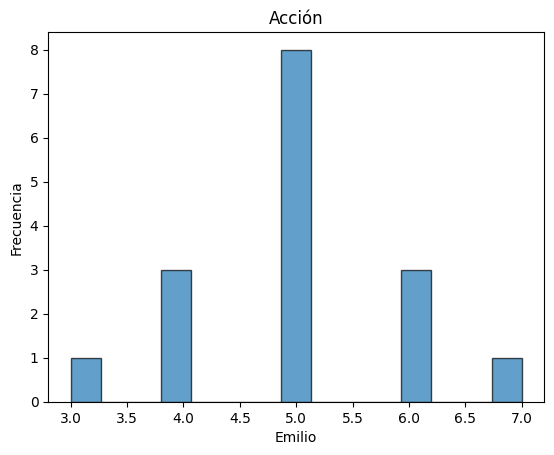

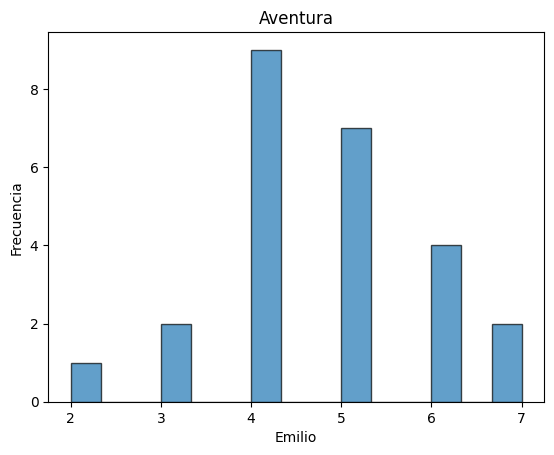

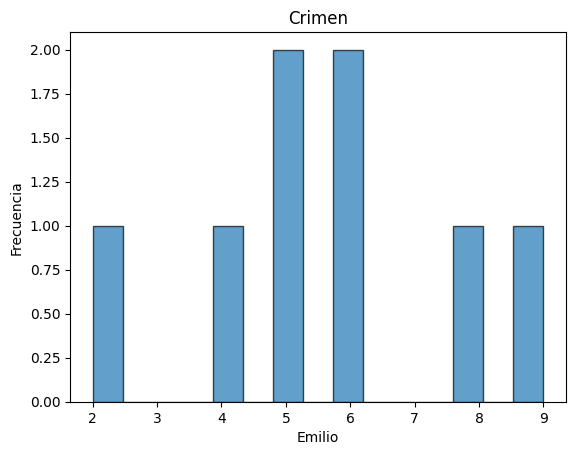

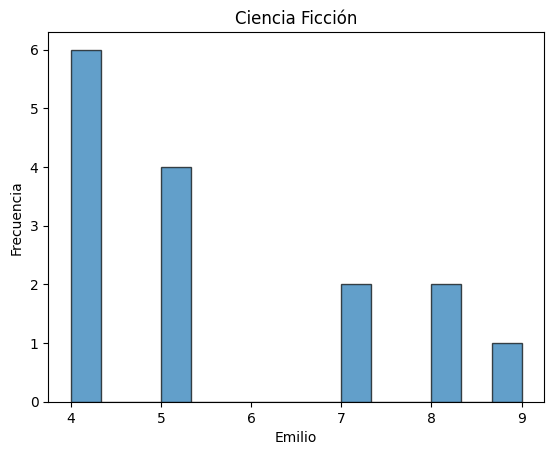

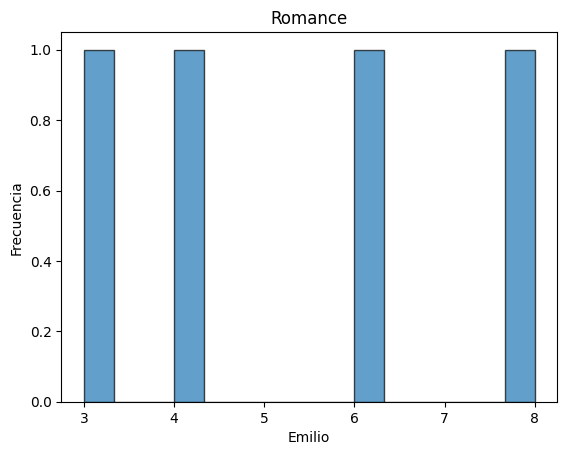

...

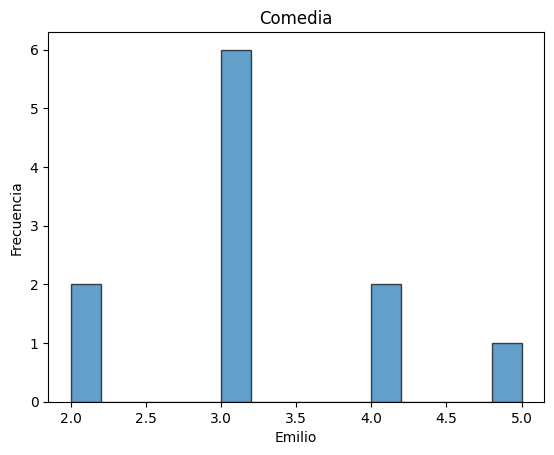

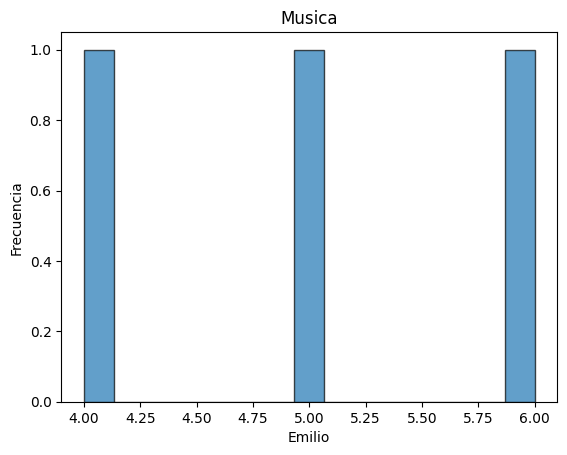

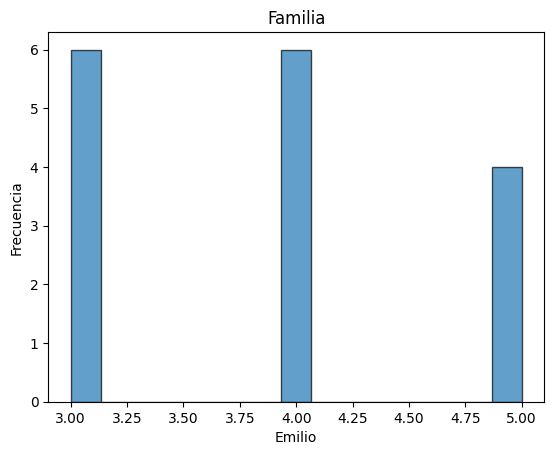

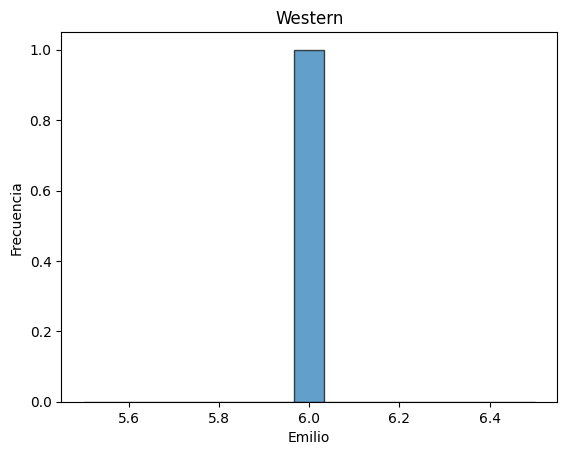

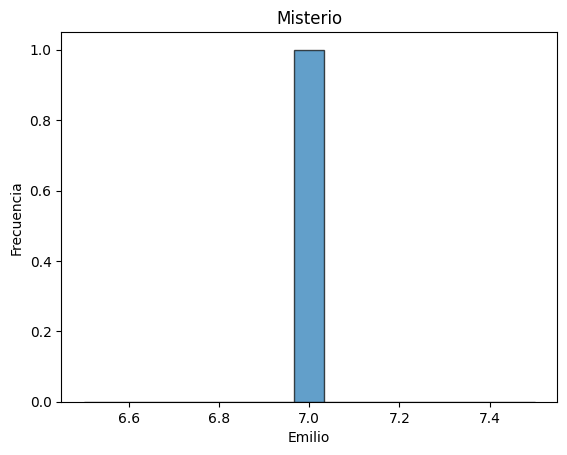

In [ ]:
#3
variable_categorica='Subgenero'
variable_numerica='Emilio'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

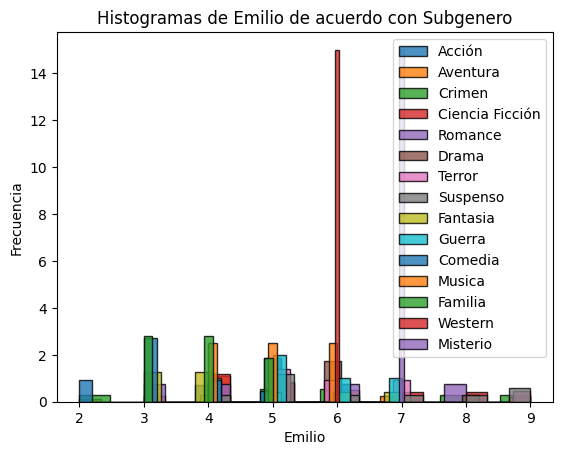

In [ ]:
#4
variable_categorica='Subgenero'
variable_numerica='Emilio'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

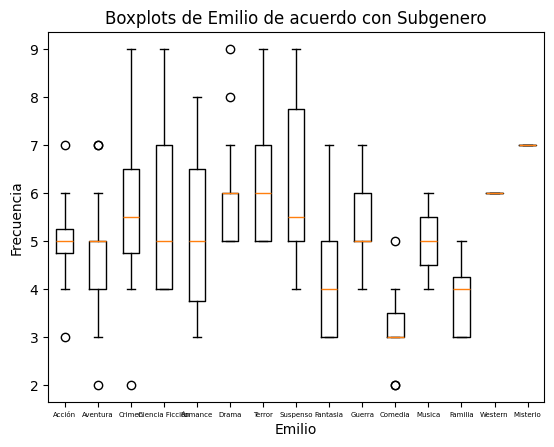

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Subgenero'
variable_numerica = 'Emilio'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

En pocas palabras, las gráficas muestran que subgéneros como acción y música son más constantes para la calificación de Emilio, en comparación con drama y terror, donde existe más variabilidad y valores atípicos. La mayoría de sus respectivas de los plot estarán alrededor de 6, pero todos los que pertenecen a crimen y aventura serían más dispersos. En general, parece que tiene un criterio general más estable y más variable en ciertos subgéneros.


### Año

In [ ]:
#1
df.groupby("Año")['Emilio'].mean()

,Emilio
Año,
1976,9.000000
1977,9.000000
1978,9.000000
1980,8.000000
1981,7.000000
1982,7.750000
1983,9.000000
1984,7.000000
1993,7.000000


In [ ]:
#2
df.groupby("Año")['Emilio'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Año,,,,,,,,
1976,9.000000,9,9,NaN,1,9.0,9.00,9.00
1977,9.000000,9,9,NaN,1,9.0,9.00,9.00
1978,9.000000,9,9,NaN,1,9.0,9.00,9.00
1980,8.000000,7,9,1.000000,3,8.0,7.50,8.50
1981,7.000000,7,7,NaN,1,7.0,7.00,7.00
1982,7.750000,7,9,0.957427,4,7.5,7.00,8.25
1983,9.000000,9,9,NaN,1,9.0,9.00,9.00
1984,7.000000,7,7,0.000000,2,7.0,7.00,7.00
1993,7.000000,7,7,NaN,1,7.0,7.00,7.00


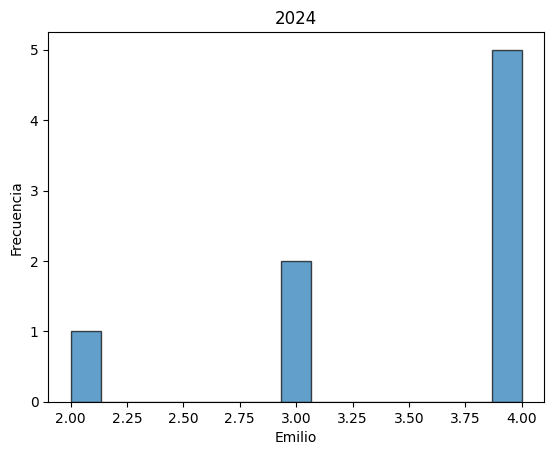

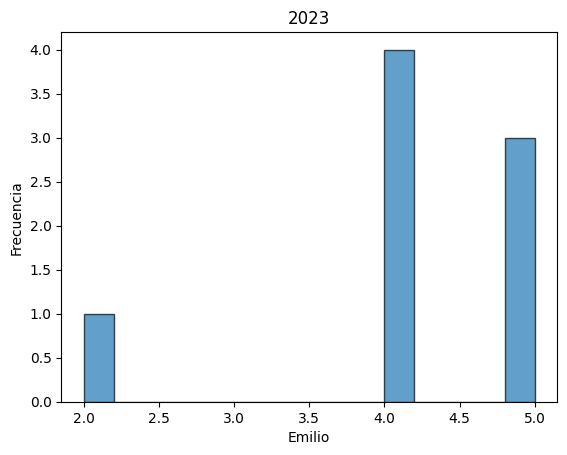

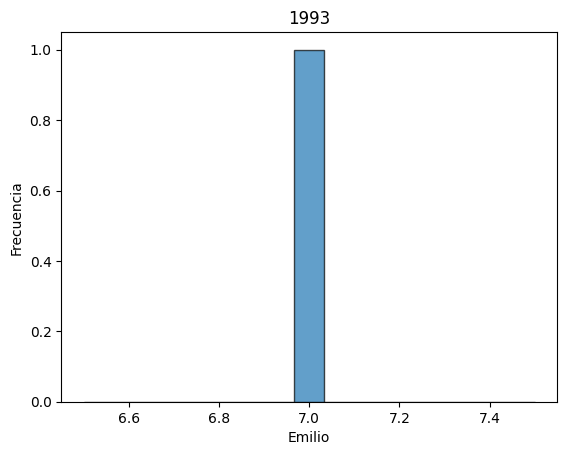

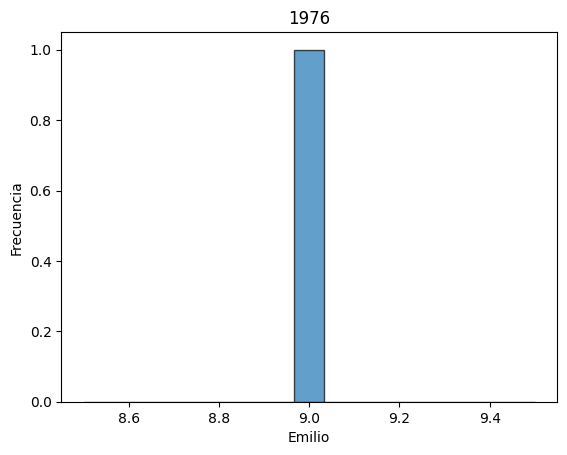

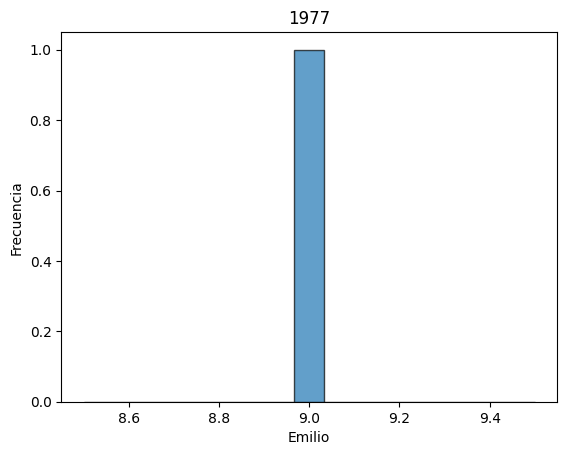

...

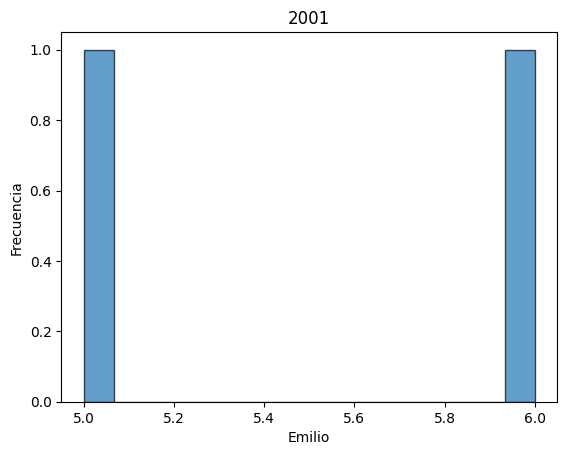

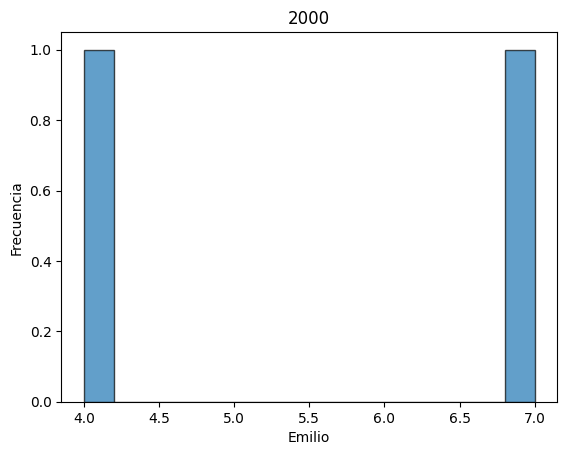

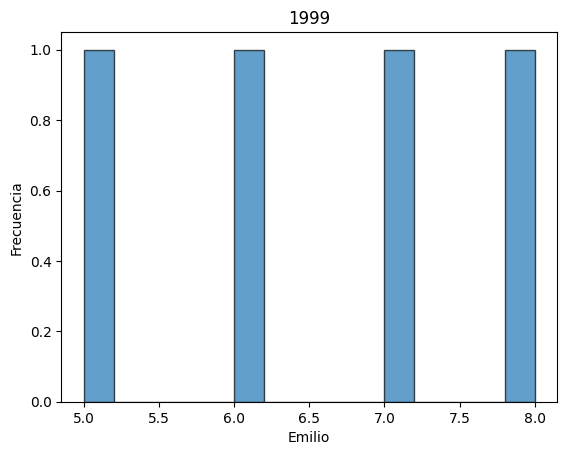

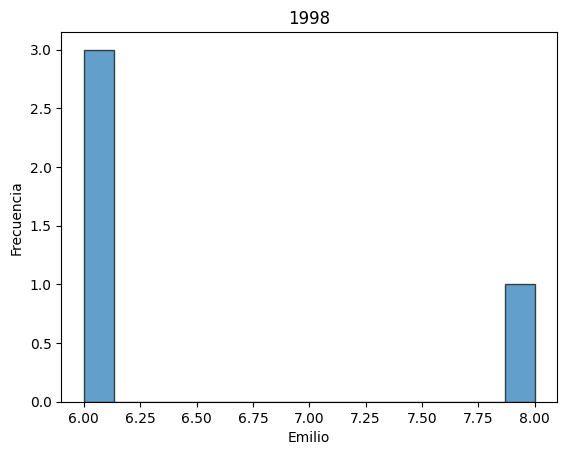

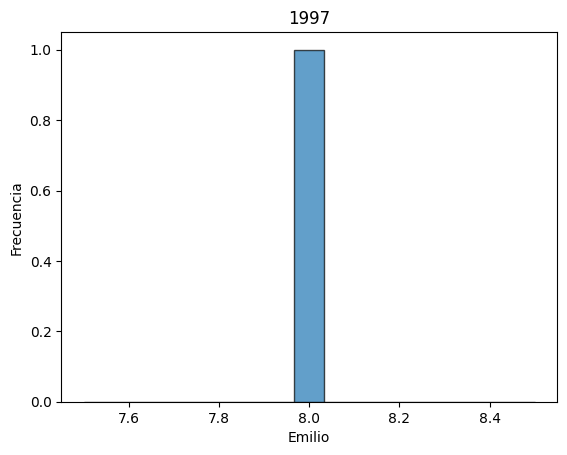

In [ ]:
#3
variable_categorica='Año'
variable_numerica='Emilio'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

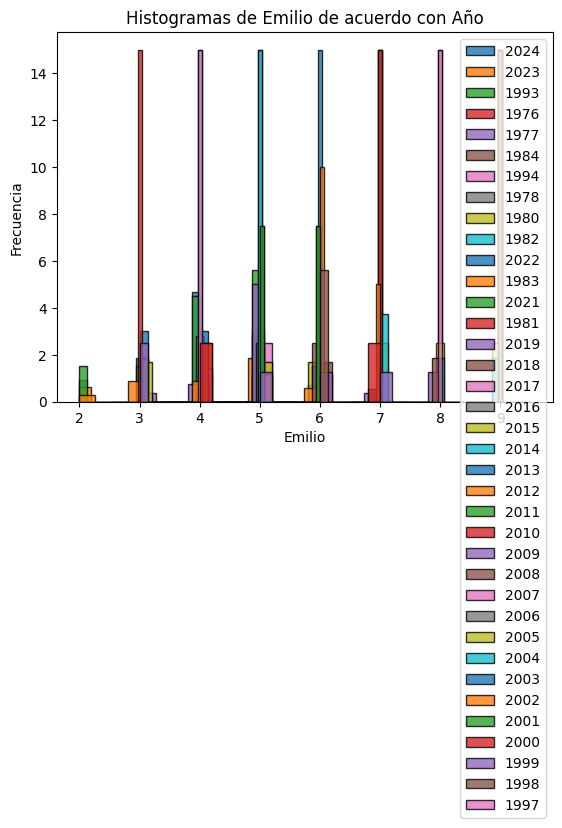

In [ ]:
#4
variable_categorica='Año'
variable_numerica='Emilio'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

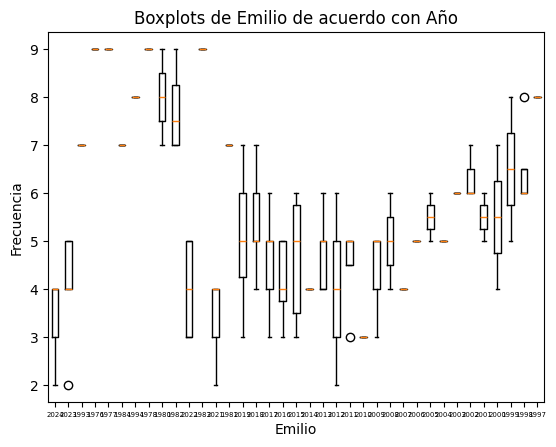

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Año'
variable_numerica = 'Emilio'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Emilio muestra una preferencia por las películas de los años 70 y 80, ya que aquí es donde calificó más alto, especialmente en los años de 1976, 1977, 1978 y 1983. Por otra parte, si analizamos los años donde calificó más bajo fue en los años 2010 y 2021, lo que nos sugiere que tener un menor entusiasmo por las películas más viejas y ser más duro y crítico por recientes producciones.


### Clasificacion

In [ ]:
#1
df.groupby("Clasificacion")['Emilio'].mean()

,Emilio
Clasificacion,
G,4.250000
PG,5.019231
PG-13,4.809524
R,5.418605


In [ ]:
#2
df.groupby("Clasificacion")['Emilio'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Clasificacion,,,,,,,,
G,4.250000,3,5,0.707107,8,4.0,4.0,5.0
PG,5.019231,3,9,1.614765,52,5.0,4.0,6.0
PG-13,4.809524,2,8,1.194256,42,5.0,4.0,5.0
R,5.418605,2,9,1.942416,43,5.0,4.0,7.0


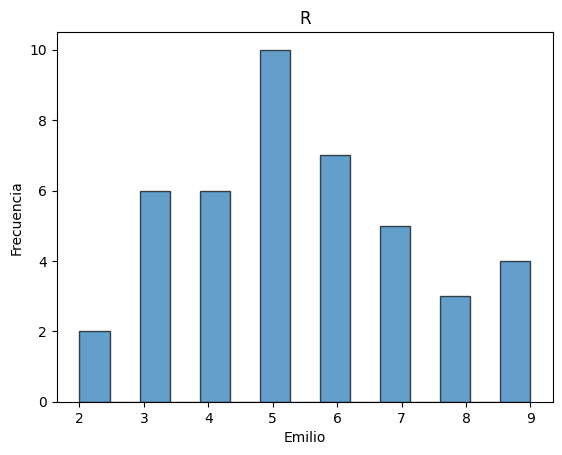

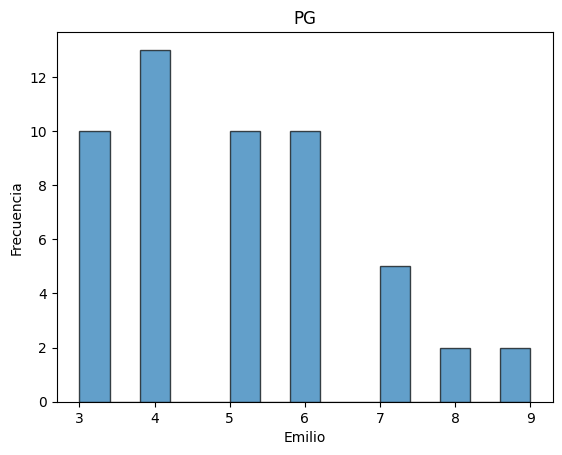

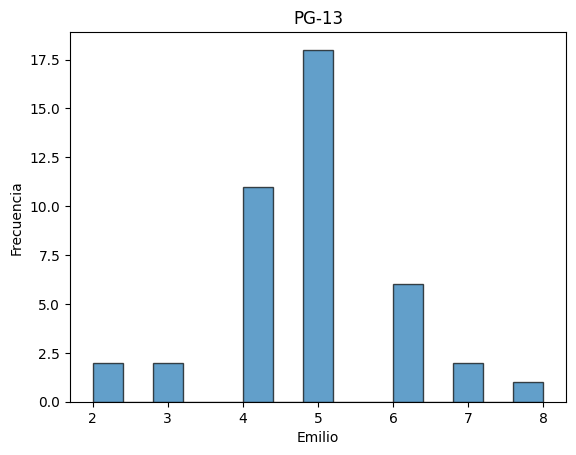

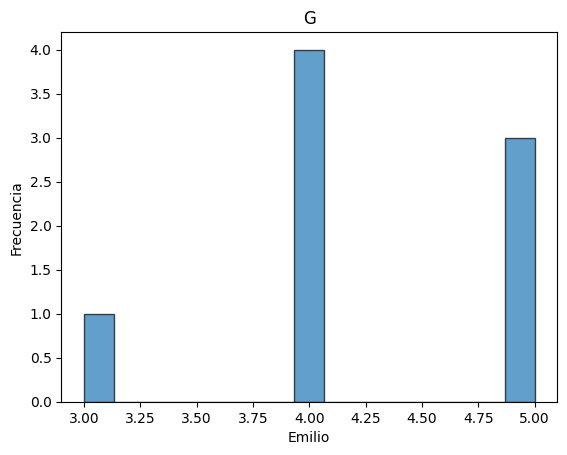

In [ ]:
#3
variable_categorica='Clasificacion'
variable_numerica='Emilio'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

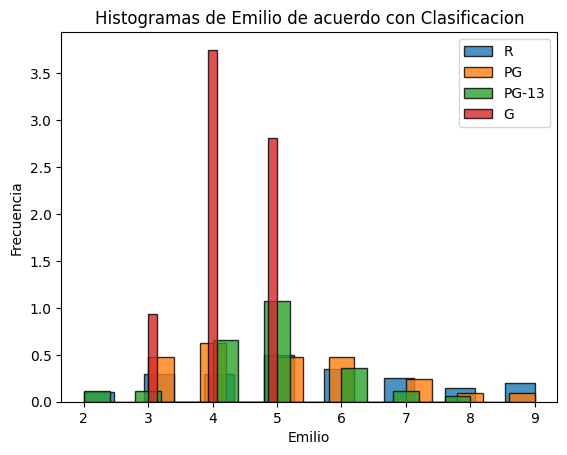

In [ ]:
#4
variable_categorica='Clasificacion'
variable_numerica='Emilio'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

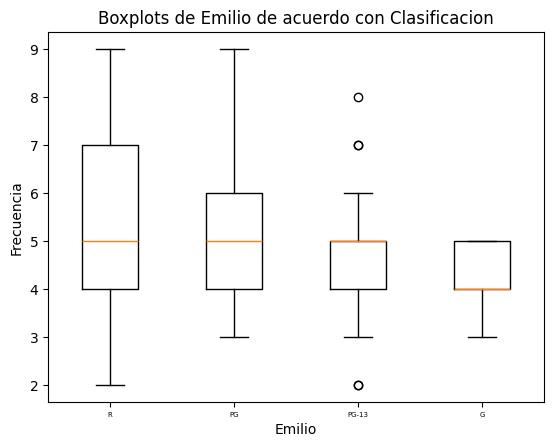

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Clasificacion'
variable_numerica = 'Emilio'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Emilio otorga las calificaciones más altas a las películas clasificadas como “R”, con una media de 5.42. Las películas clasificadas como “G” reciben las calificaciones más bajas, con una calificación media de 4.25. Como se puede ver en el boxplot, las películas clasificadas como “R” tienen una mayor variabilidad, mientras que las “G” se mantienen bajas pero consistentes. Esto se confirma en el histograma, ya que Emilio clasifica la mayoría de las clasificaciones entre 4 y 5 con frecuencia.


### Animación

In [ ]:
#1
df.groupby("Animacion")['Emilio'].mean()

,Emilio
Animacion,
no,5.327273
si,4.114286


In [ ]:
#2
df.groupby("Animacion")['Emilio'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Animacion,,,,,,,,
no,5.327273,2,9,1.665126,110,5.0,4.0,6.0
si,4.114286,3,6,0.866753,35,4.0,3.5,5.0


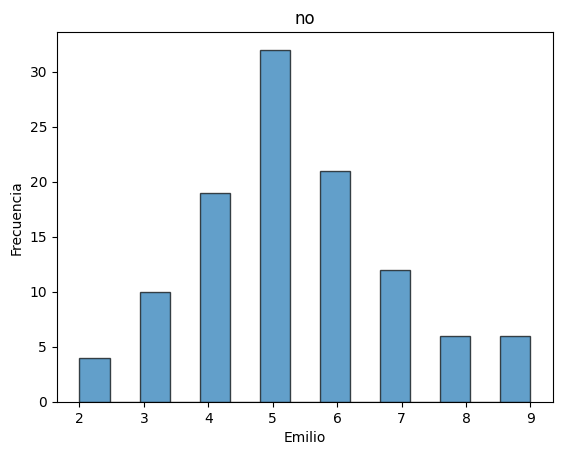

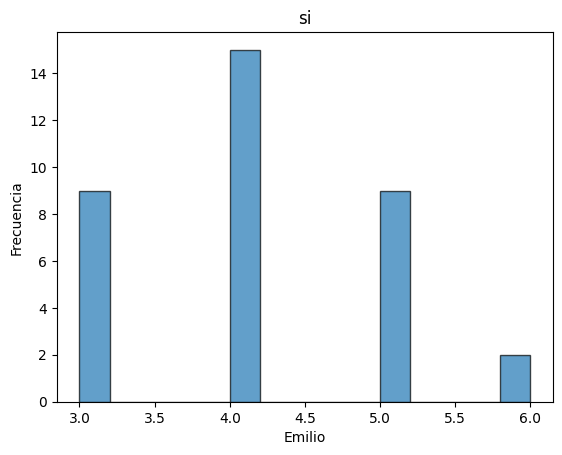

In [ ]:
#3
variable_categorica='Animacion'
variable_numerica='Emilio'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

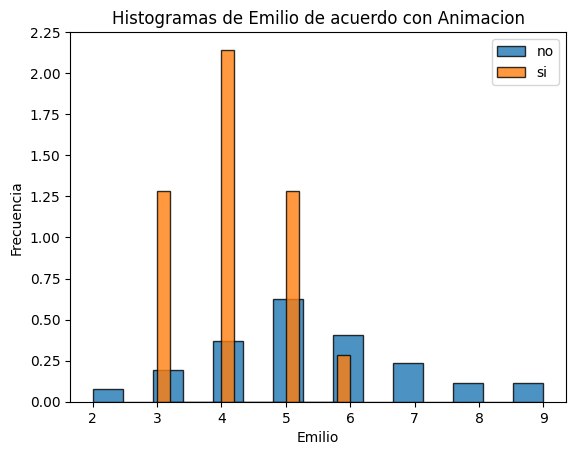

In [ ]:
#4
variable_categorica='Animacion'
variable_numerica='Emilio'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

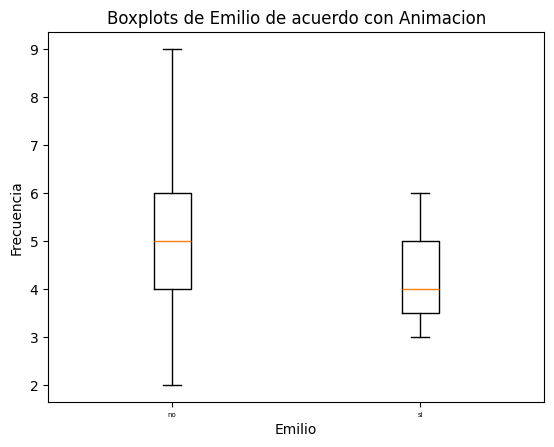

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Animacion'
variable_numerica = 'Emilio'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

En general, Emilio tiende a calificar las películas no animadas más alto, con una media de 5.33, que las animadas, con una media de 4.11. El hecho se ve reflejado por el histograma y los boxplots, que demuestran que las películas no animadas tienen mayor dispersión y calificaciones que varían entre sí, llegando en ocasiones a 9. Contrariamente, las animadas tienen la calificación más concentrada y nunca superan los 6 puntos, lo que indica un menor entusiasmo hacia este tipo de película por parte de Emilio.


### Duración

In [ ]:
#1
df.groupby("Duracion")['Emilio'].mean()

,Emilio
Duracion,
78,4.000000
83,2.000000
86,5.000000
88,6.000000
90,4.333333
...,...
180,4.000000
181,5.000000
189,8.000000


In [ ]:
#2
df.groupby("Duracion")['Emilio'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Duracion,,,,,,,,
78,4.000000,4,4,NaN,1,4.0,4.0,4.0
83,2.000000,2,2,NaN,1,2.0,2.0,2.0
86,5.000000,5,5,NaN,1,5.0,5.0,5.0
88,6.000000,6,6,NaN,1,6.0,6.0,6.0
90,4.333333,4,5,0.57735,3,4.0,4.0,4.5
...,...,...,...,...,...,...,...,...
180,4.000000,4,4,NaN,1,4.0,4.0,4.0
181,5.000000,5,5,0.00000,2,5.0,5.0,5.0
189,8.000000,8,8,NaN,1,8.0,8.0,8.0


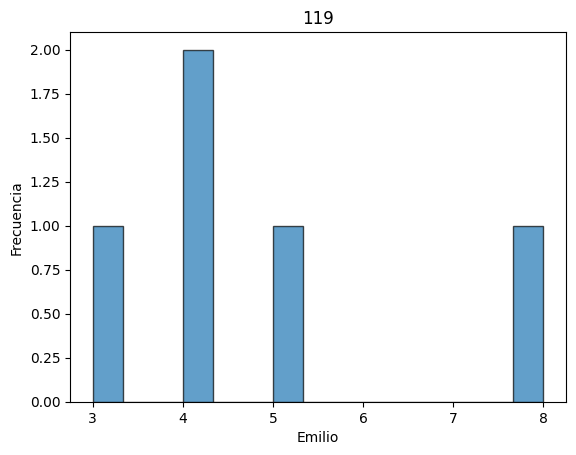

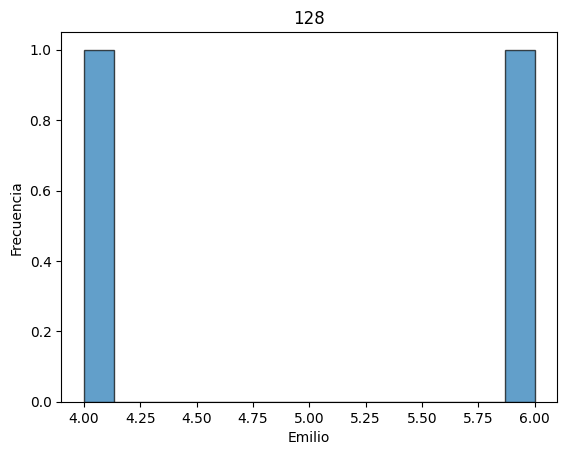

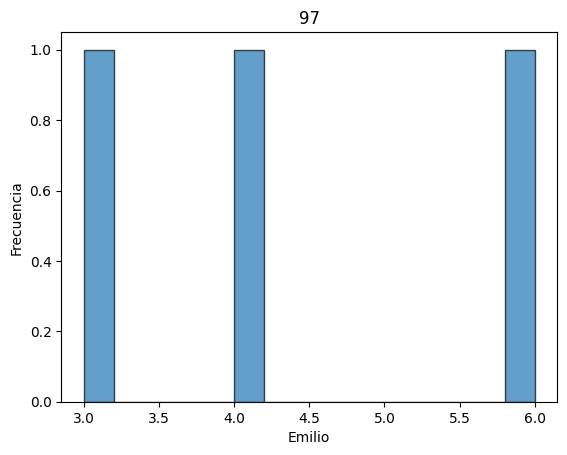

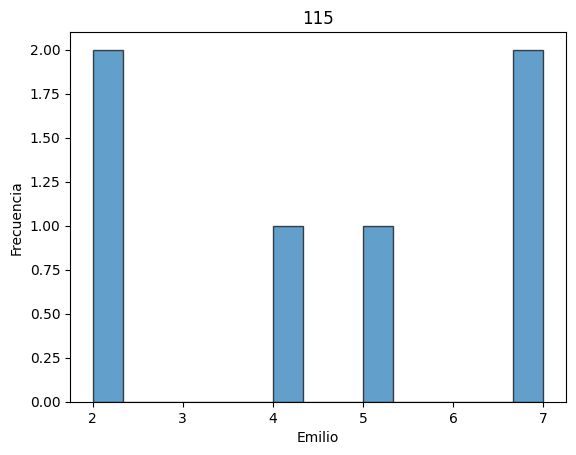

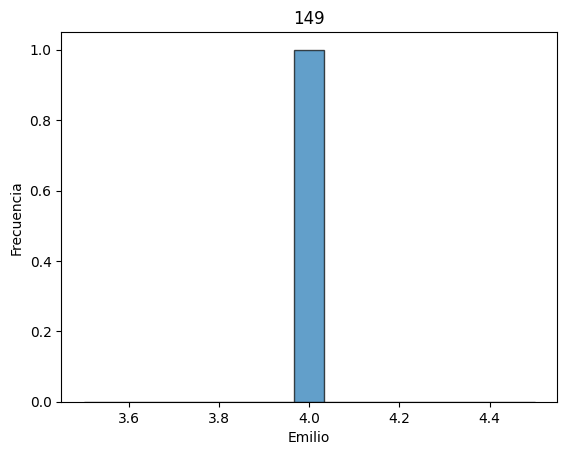

...

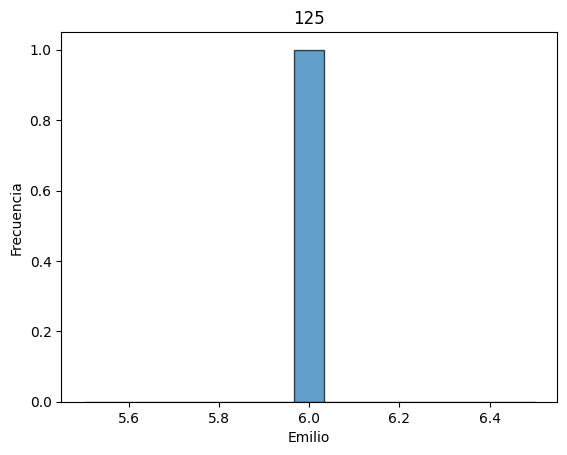

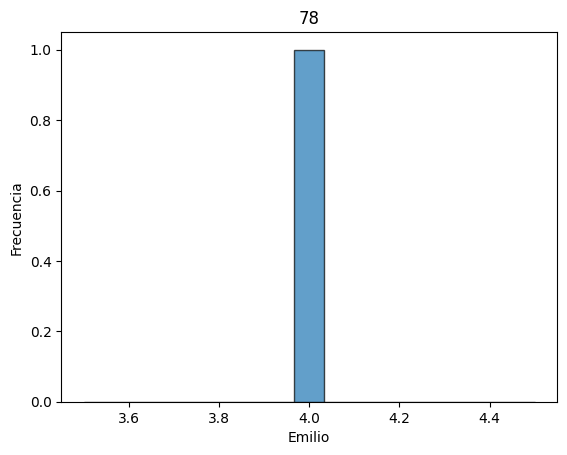

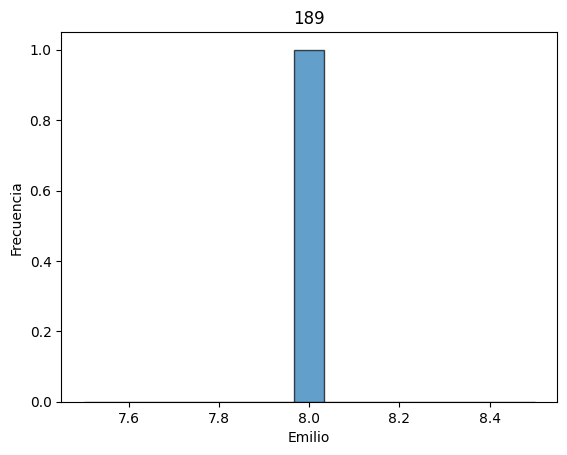

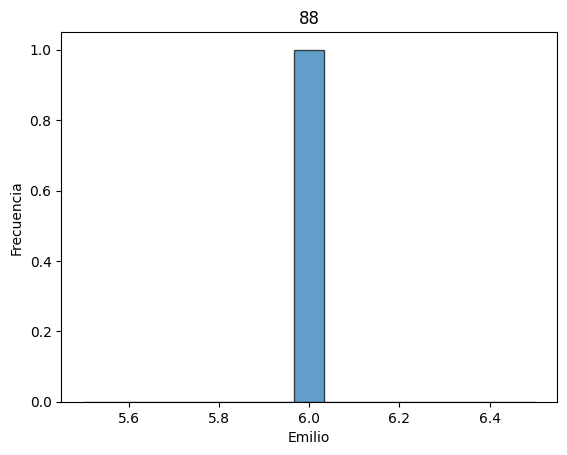

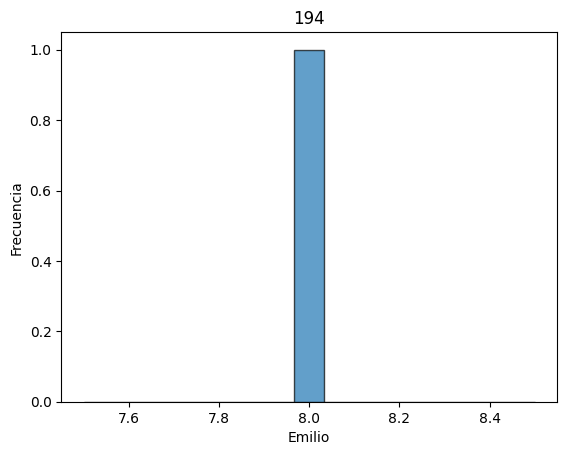

In [ ]:
#3
variable_categorica='Duracion'
variable_numerica='Emilio'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

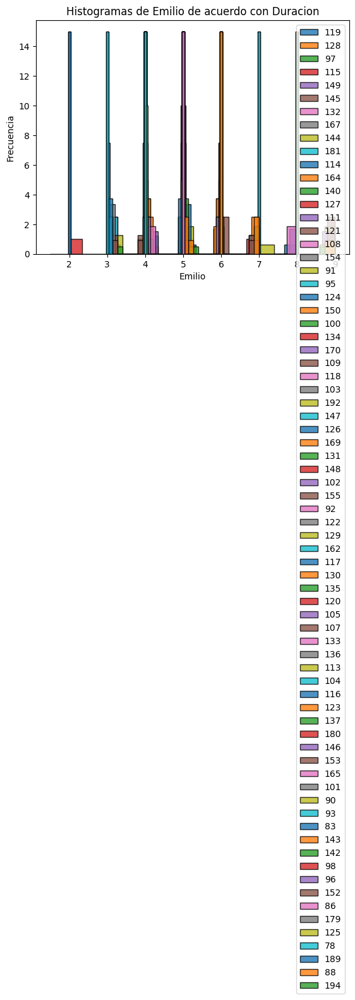

In [ ]:
#4
variable_categorica='Duracion'
variable_numerica='Emilio'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

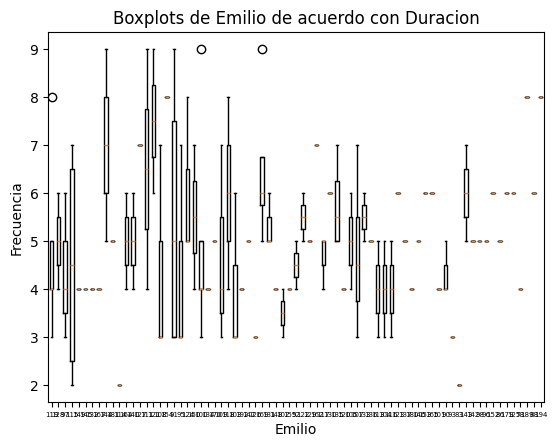

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Duracion'
variable_numerica = 'Emilio'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Las calificaciones varían bastante, con algunas películas cortas de alrededor de 83 minutos teniendo puntuaciones bajas de 2.0 y otras más largas de 189 y 194 minutos teniendo puntuaciones altas de 8.0: el boxplot refleja una mayor dispersión en las calificaciones de las películas de duración intermedia, mientras que las más cortas y más largas tienden a recibir puntuaciones más consistentes. Esto sugiere que la duración puede influir en cómo Emilio evalúa las películas, pero no lo hace de una manera uniforme.


### Criticos

In [ ]:
#1
df.groupby("Criticos")['Emilio'].mean()

,Emilio
Criticos,
5.3,3.000000
5.5,5.000000
5.6,2.500000
5.7,6.000000
6.0,6.000000
6.2,6.000000
6.4,5.000000
6.5,2.000000
6.6,8.000000


In [ ]:
#2
df.groupby("Criticos")['Emilio'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Criticos,,,,,,,,
5.3,3.000000,3,3,NaN,1,3.0,3.00,3.00
5.5,5.000000,5,5,NaN,1,5.0,5.00,5.00
5.6,2.500000,2,3,0.707107,2,2.5,2.25,2.75
5.7,6.000000,6,6,NaN,1,6.0,6.00,6.00
6.0,6.000000,6,6,0.000000,2,6.0,6.00,6.00
6.2,6.000000,6,6,NaN,1,6.0,6.00,6.00
6.4,5.000000,5,5,NaN,1,5.0,5.00,5.00
6.5,2.000000,2,2,NaN,1,2.0,2.00,2.00
6.6,8.000000,7,9,1.000000,3,8.0,7.50,8.50


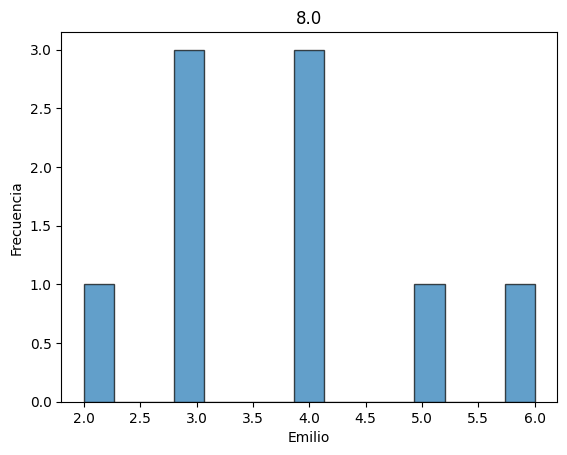

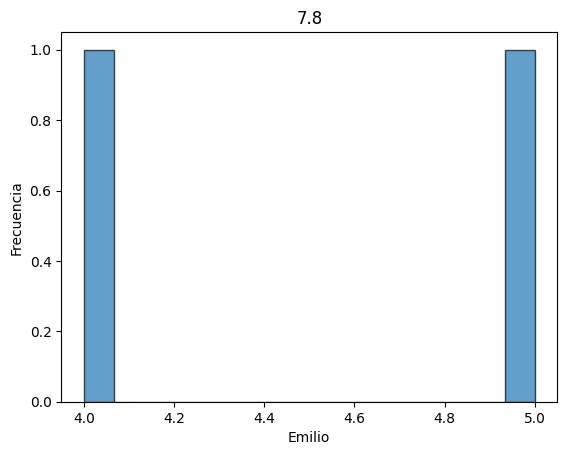

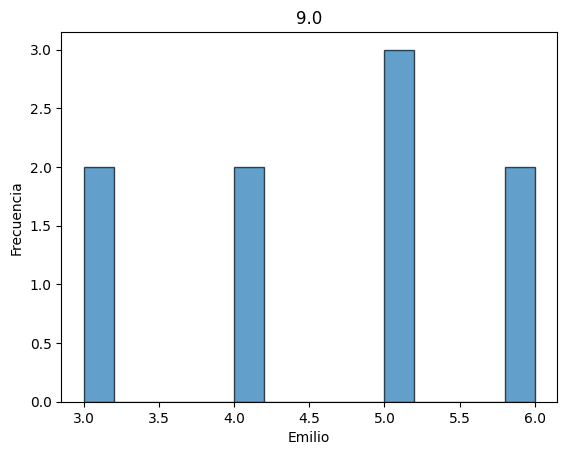

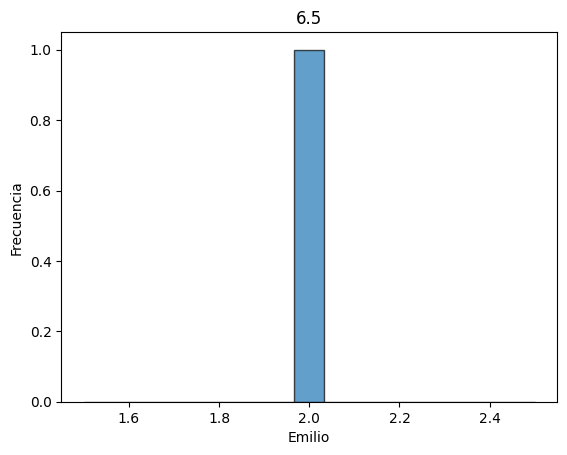

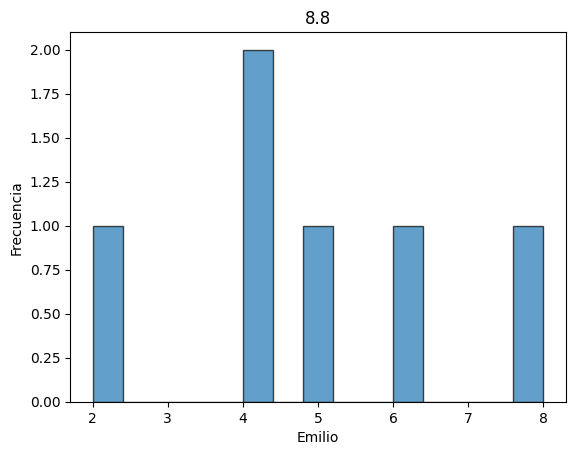

...

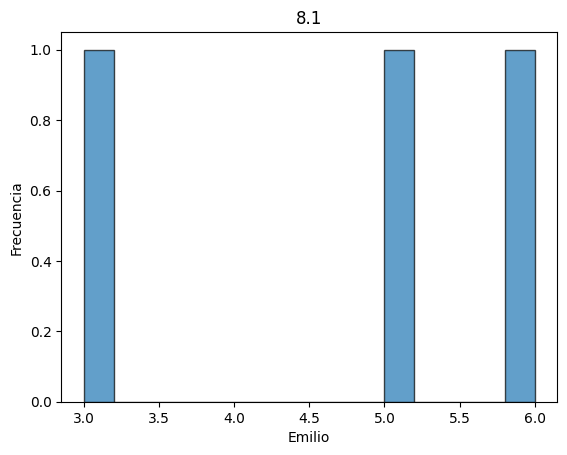

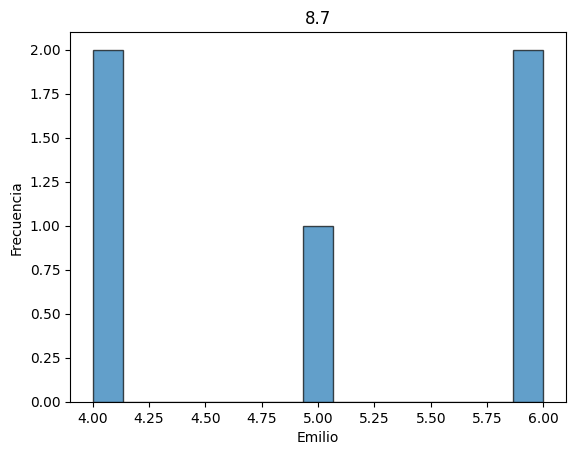

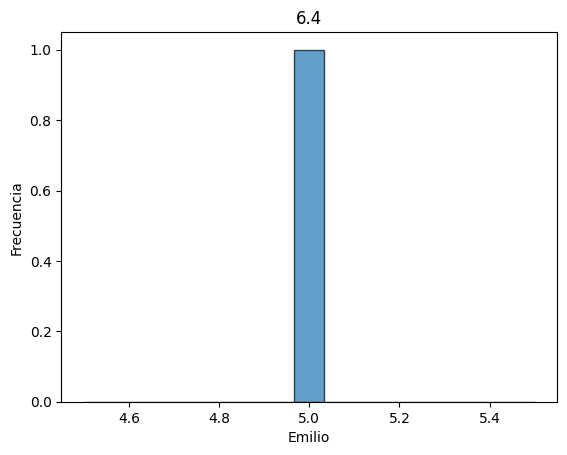

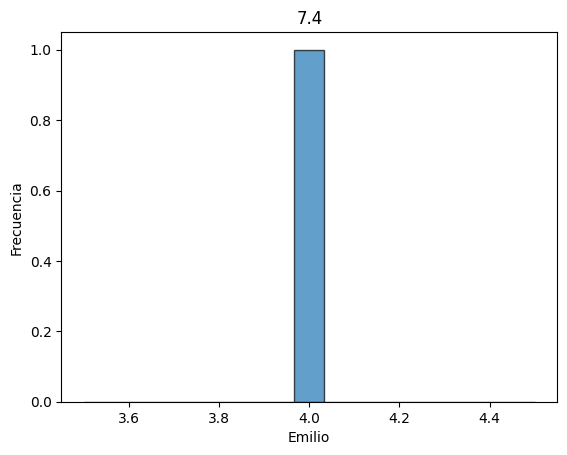

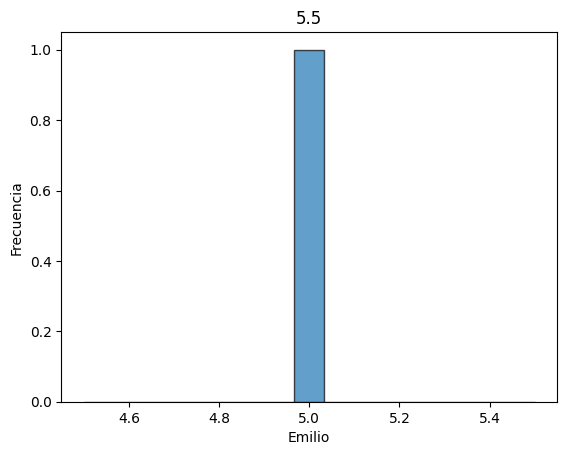

In [ ]:
#3
variable_categorica='Criticos'
variable_numerica='Emilio'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

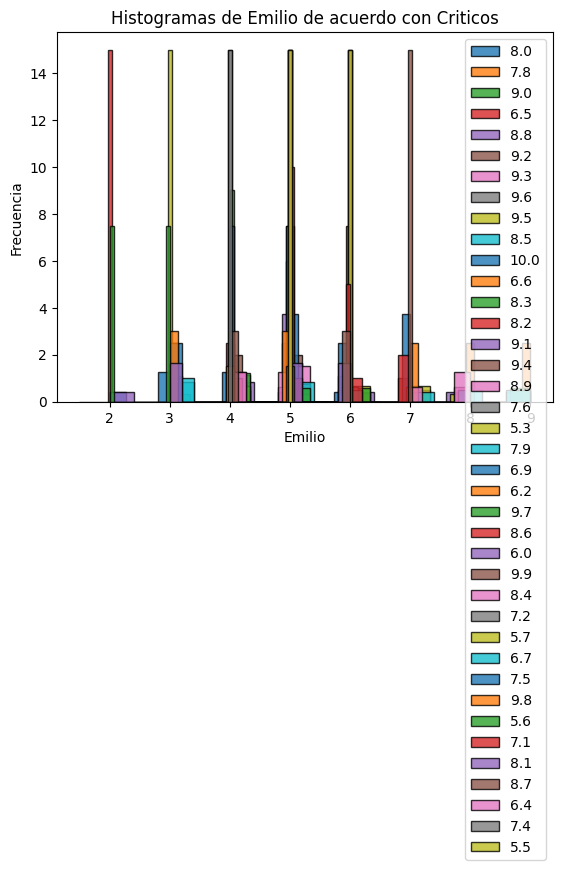

In [ ]:
#4
variable_categorica='Criticos'
variable_numerica='Emilio'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

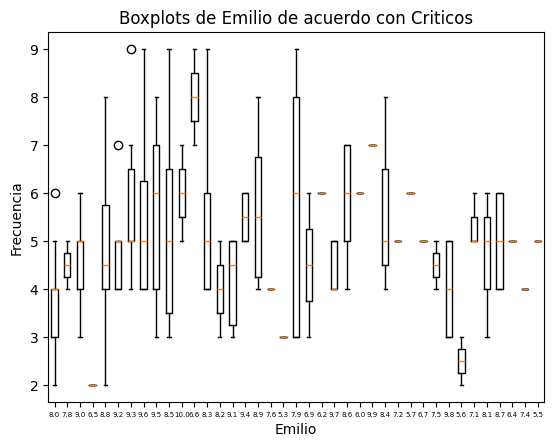

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Criticos'
variable_numerica = 'Emilio'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Con respecto a su línea en línea con las calificaciones de los críticos, que difiere mucho, especialmente en ciertas críticas moderadas. Esto se evidencia cuando los críticos son muy generosos. Emilio califica de manera consistente, pero aún ligeramente más bajo. Esto puede parecer una tendencia general, pero, a menudo, él cree que exageran o subestiman, ya que podemos ver como tiene un criterio propio en las películas de calidad media, es decir con calificación no mayor a 8.0.


### Audiencia

In [ ]:
#1
df.groupby("Audiencia")['Emilio'].mean()

,Emilio
Audiencia,
5.4,5.000000
5.6,3.000000
5.8,4.000000
6.0,4.250000
6.2,4.000000
6.4,2.000000
6.6,4.800000
6.8,4.625000
7.0,4.909091


In [ ]:
#2
df.groupby("Audiencia")['Emilio'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Audiencia,,,,,,,,
5.4,5.000000,5,5,NaN,1,5.0,5.00,5.00
5.6,3.000000,3,3,NaN,1,3.0,3.00,3.00
5.8,4.000000,2,6,2.000000,3,4.0,3.00,5.00
6.0,4.250000,2,7,2.217356,4,4.0,2.75,5.50
6.2,4.000000,4,4,0.000000,2,4.0,4.00,4.00
6.4,2.000000,2,2,NaN,1,2.0,2.00,2.00
6.6,4.800000,4,5,0.447214,5,5.0,5.00,5.00
6.8,4.625000,3,6,1.060660,8,4.5,4.00,5.25
7.0,4.909091,3,9,1.578261,11,5.0,4.00,5.00


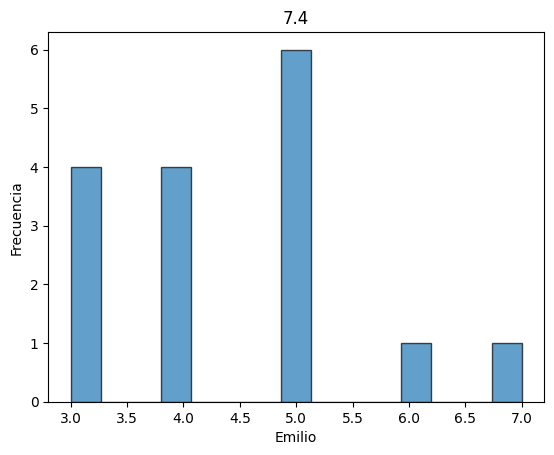

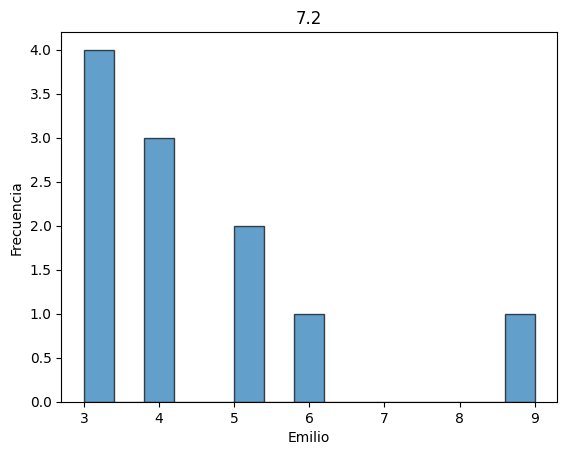

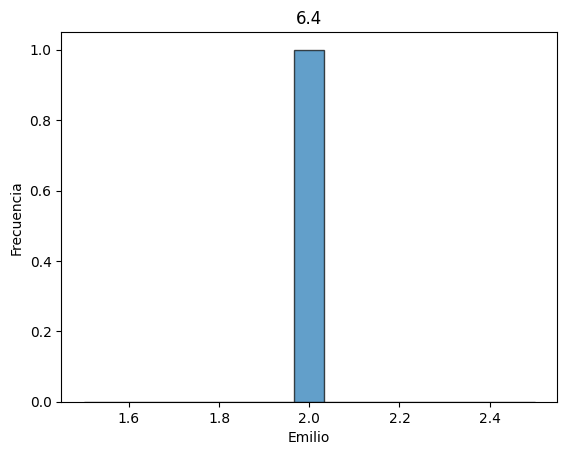

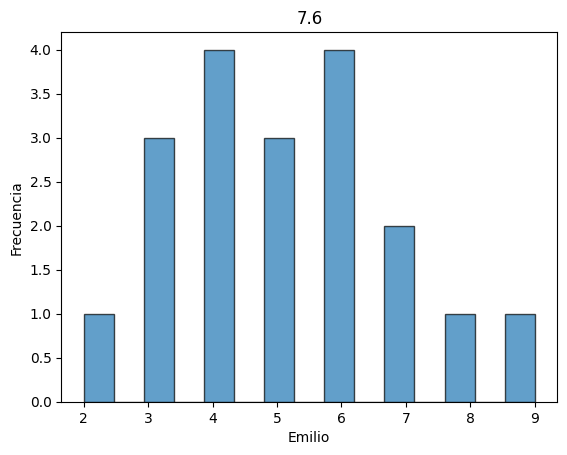

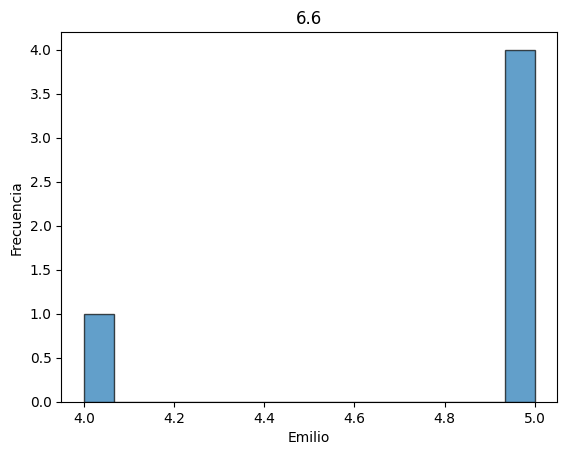

...

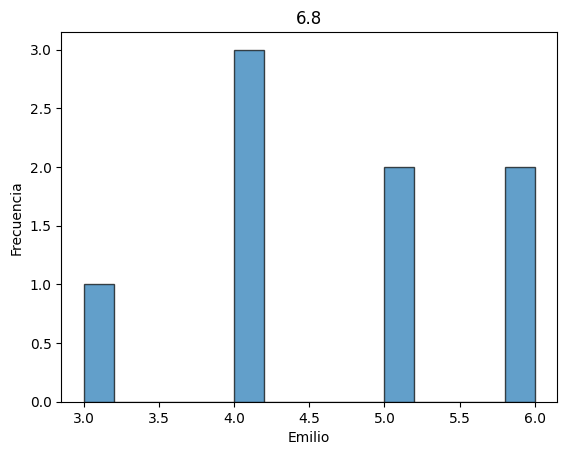

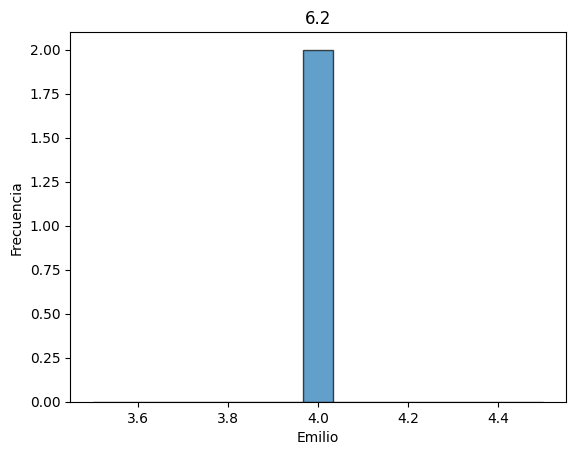

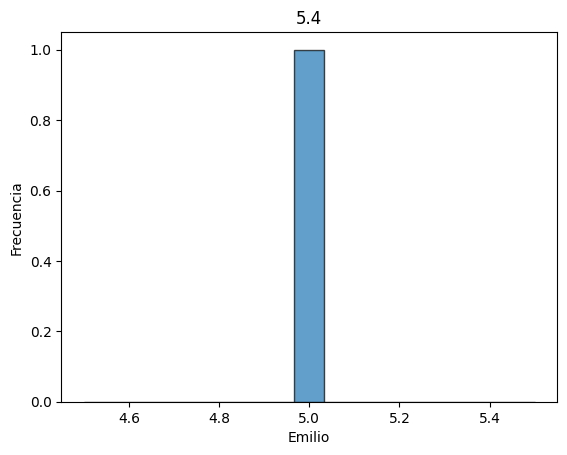

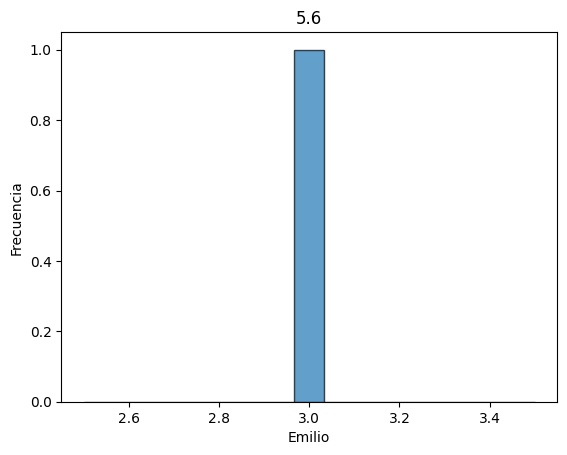

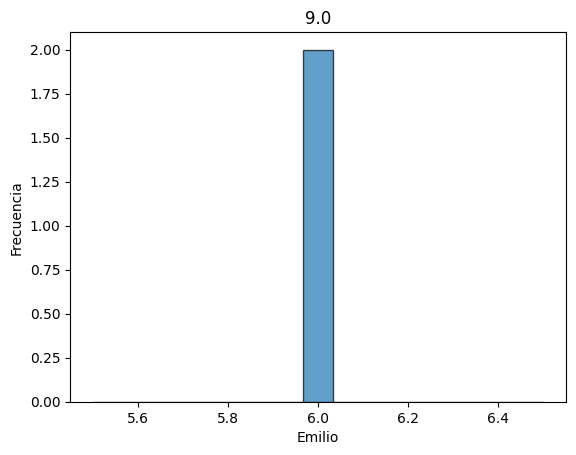

In [ ]:
#3
variable_categorica='Audiencia'
variable_numerica='Emilio'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

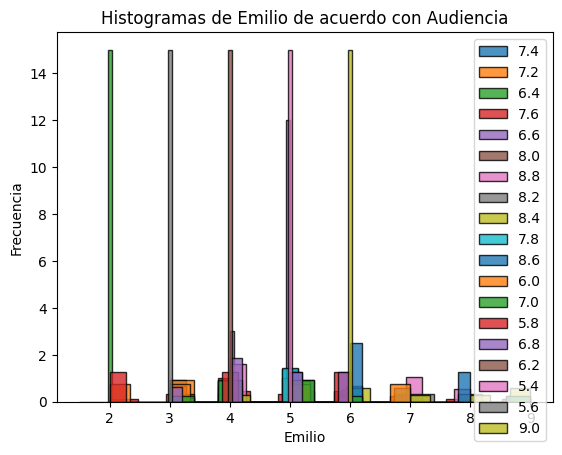

In [ ]:
#4
variable_categorica='Audiencia'
variable_numerica='Emilio'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

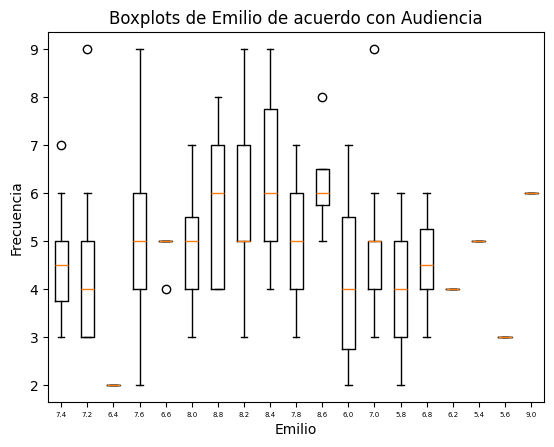

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Audiencia'
variable_numerica = 'Emilio'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

En resumen, las gráficas y tablas muestran marcadas diferencias y similitudes en el enfoque de Emilio en sus calificaciones en comparación con la audiencia. Las diferencias más notables incluyen un enfoque más variable y moderado. Para películas con calificaciones entre 7.0 y 8.4, la puntuación de Emilio oscila entre 3 y 9, lo que se considera un enfoque moderado y diverso. Sin embargo, cuando se trata de películas altamente valoradas y mal valoradas, Emilio graba las calificaciones altas y se mantienen bajas. En películas con calificaciones bajas de 5.4 a 6.4, las calificaciones de Emilio pueden incluso ser más críticas, llegando al punto de puntuar 2.0. Por lo tanto, el enfoque independiente es obvio y variable, lo que revela tanto similitudes como diferencias con la audiencia.

## Jesus

### Genero

In [ ]:
#1
df.groupby("Genero")['Jesus'].mean()

,Jesus
Genero,
Acción,7.952381
Aventura,7.117647
Ciencia Ficción,8.842105
Comedia,4.166667
Crimen,7.875000
Drama,6.000000
Familia,3.866667
Fantasia,4.000000
Guerra,7.000000


In [ ]:
#2
df.groupby("Genero")['Jesus'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Genero,,,,,,,,
Acción,7.952381,6,10,1.244033,21,8.0,7.00,9.00
Aventura,7.117647,3,10,2.232777,17,8.0,5.00,9.00
Ciencia Ficción,8.842105,5,10,1.258887,19,9.0,8.00,10.00
Comedia,4.166667,2,8,1.823055,18,4.0,3.00,4.75
Crimen,7.875000,6,9,0.991031,8,8.0,7.75,8.25
Drama,6.000000,1,8,1.644957,18,6.0,5.25,7.00
Familia,3.866667,2,7,1.457330,15,3.0,3.00,5.00
Fantasia,4.000000,2,6,1.264911,6,4.0,4.00,4.00
Guerra,7.000000,7,7,NaN,1,7.0,7.00,7.00


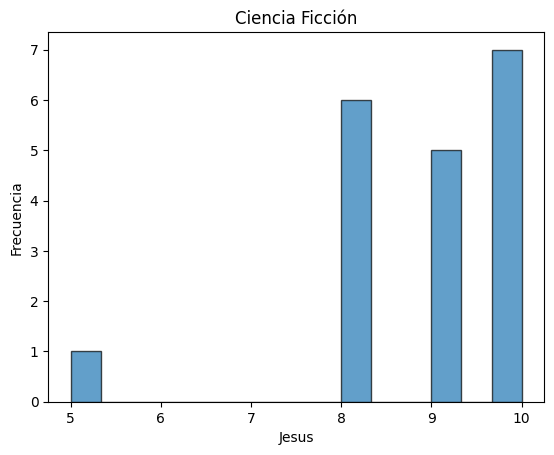

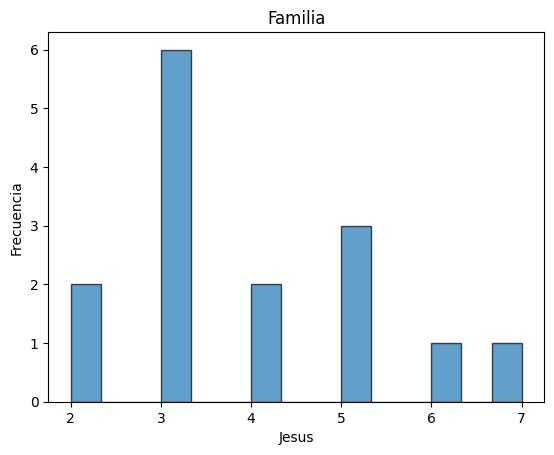

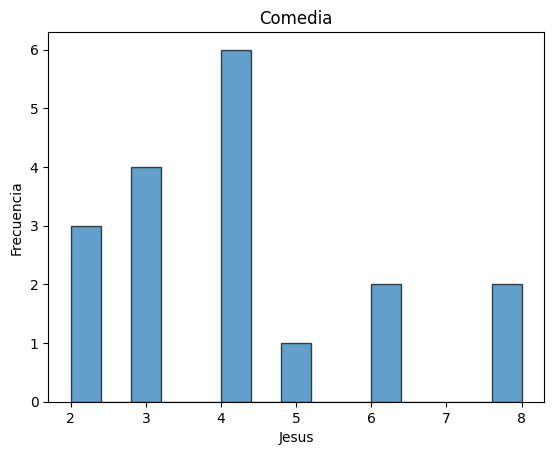

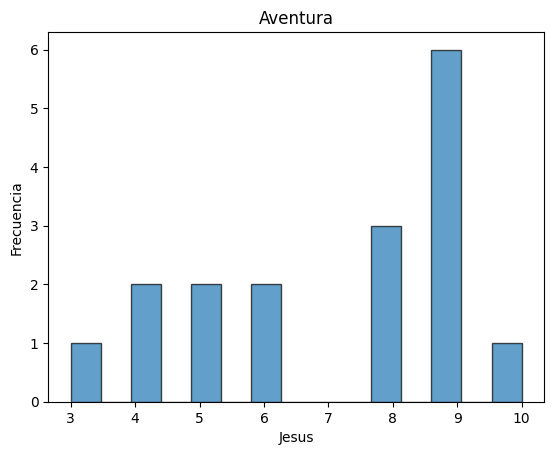

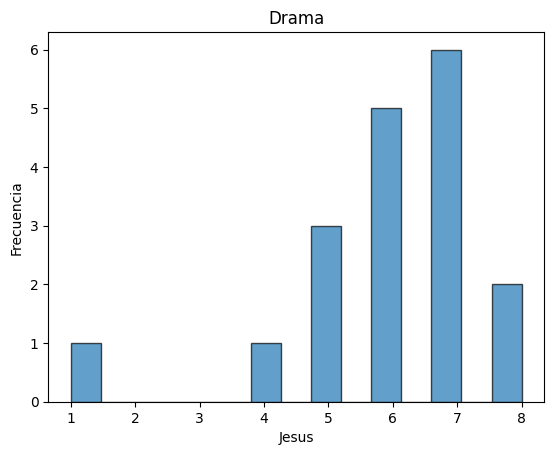

...

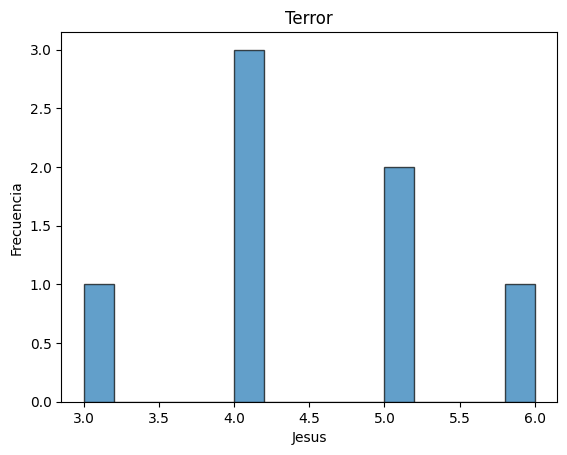

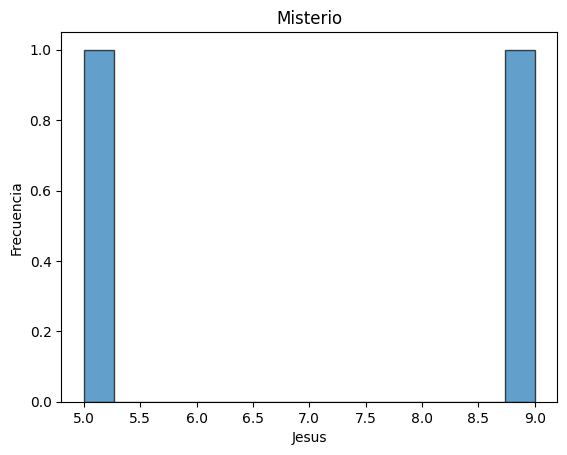

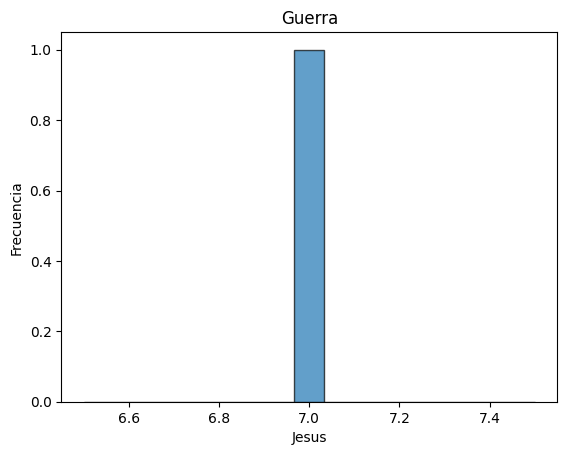

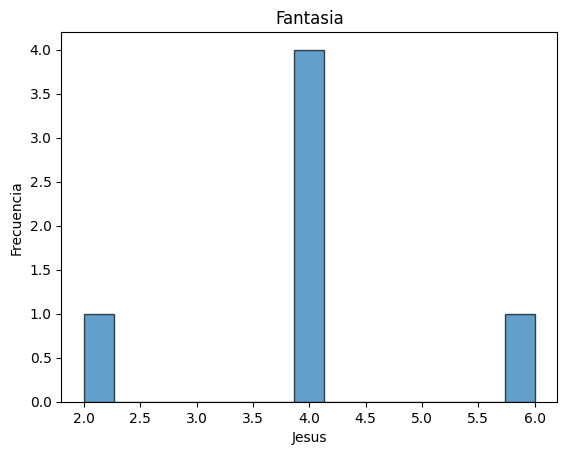

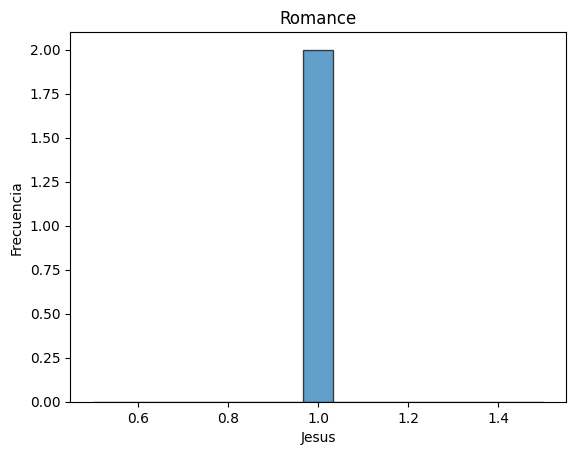

In [ ]:
#3
variable_categorica='Genero'
variable_numerica='Jesus'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

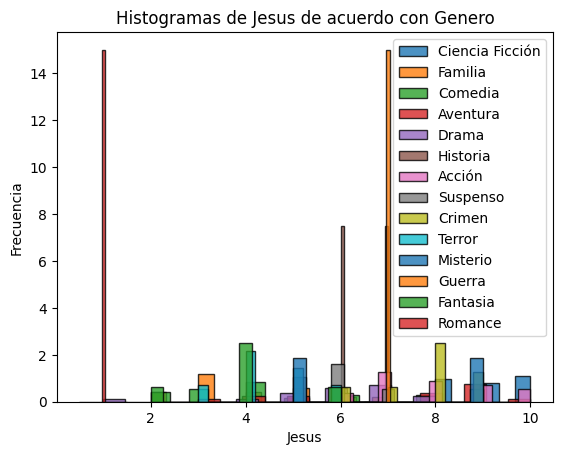

In [ ]:
#4
variable_categorica='Genero'
variable_numerica='Jesus'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

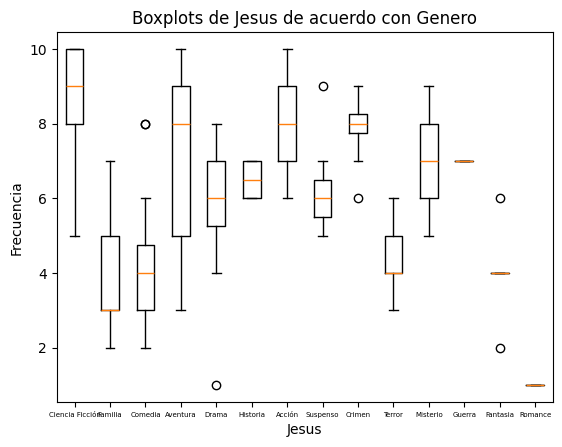

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Genero'
variable_numerica = 'Jesus'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

El análisis de calificación de Jesús por género, el histograma y el boxplot destacan diferentes géneros, siendo el de calificaciones más altas las películas de “Ciencia Ficción” y “Acción”. Esto sucede ya que reciben calificaciones altas y constantes, reflejando una clara preferencia por estos géneros. Por otro lado, “Familia”, “Terror” y “Comedia” reciben una calificación más baja a comparación a los otros, teniendo una menor dispersión y peores calificaciones sugiriendo un interés menor. En conjunto, las gráficas reflejan una inclinación marcada hacia ciertos géneros, mientras que otros muestran una apreciación más variable y menos favorable.


### Subgenero

In [ ]:
#1
df.groupby("Subgenero")['Jesus'].mean()

,Jesus
Subgenero,
Acción,9.062500
Aventura,6.160000
Ciencia Ficción,9.000000
Comedia,6.000000
Crimen,6.875000
Drama,6.692308
Familia,3.625000
Fantasia,4.666667
Guerra,6.400000


In [ ]:
#2
df.groupby("Subgenero")['Jesus'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Subgenero,,,,,,,,
Acción,9.062500,8,10,0.853913,16,9.0,8.00,10.00
Aventura,6.160000,3,10,2.321637,25,6.0,4.00,9.00
Ciencia Ficción,9.000000,8,10,0.755929,15,9.0,8.50,9.50
Comedia,6.000000,3,8,1.843909,11,7.0,4.00,7.00
Crimen,6.875000,6,8,0.834523,8,7.0,6.00,7.25
Drama,6.692308,4,8,1.250641,13,7.0,6.00,8.00
Familia,3.625000,1,6,1.360147,16,3.5,3.00,5.00
Fantasia,4.666667,2,8,2.061553,9,5.0,3.00,6.00
Guerra,6.400000,6,7,0.547723,5,6.0,6.00,7.00


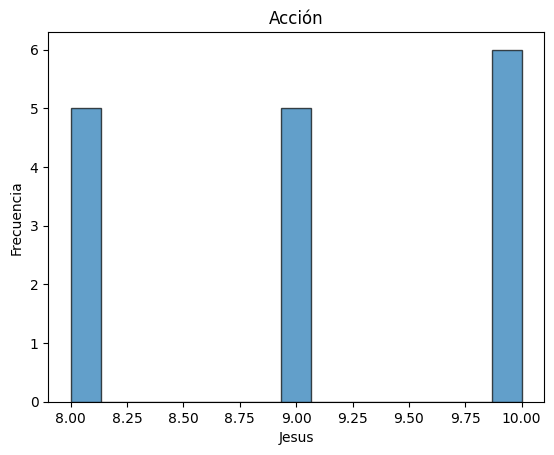

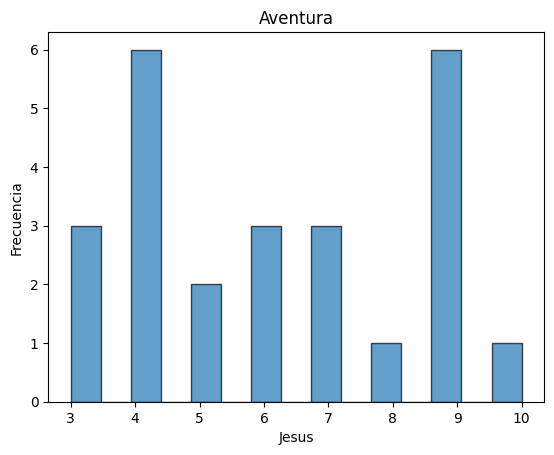

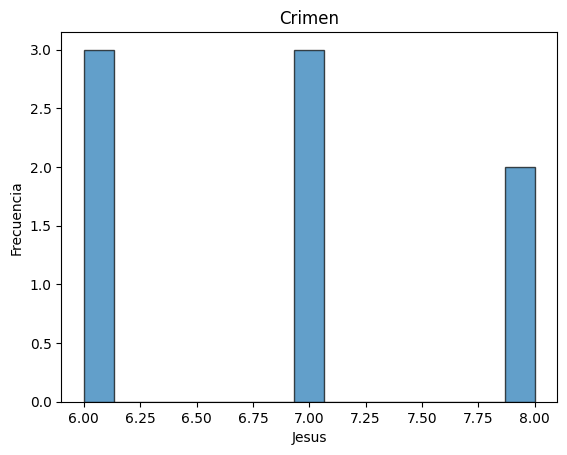

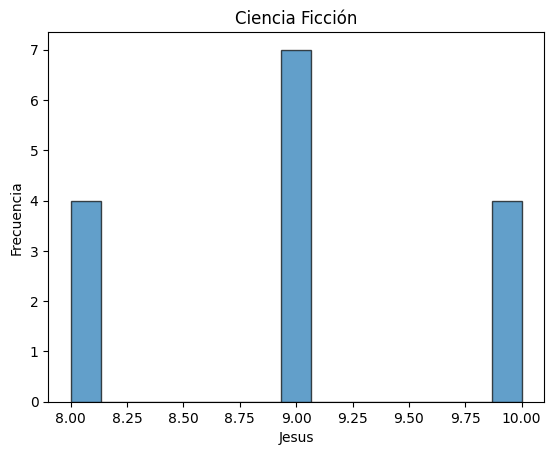

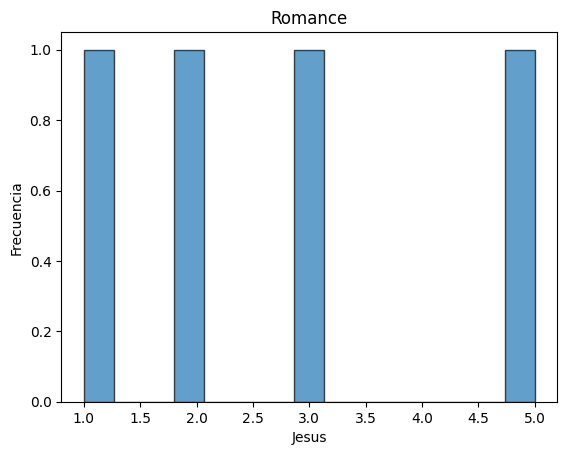

...

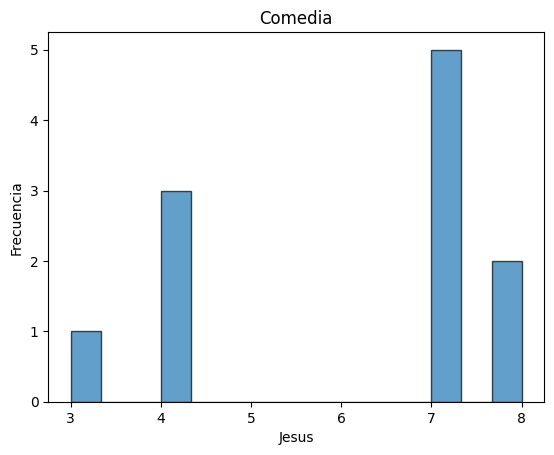

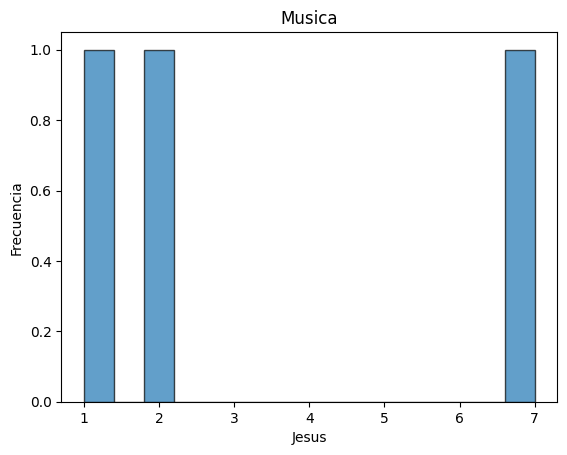

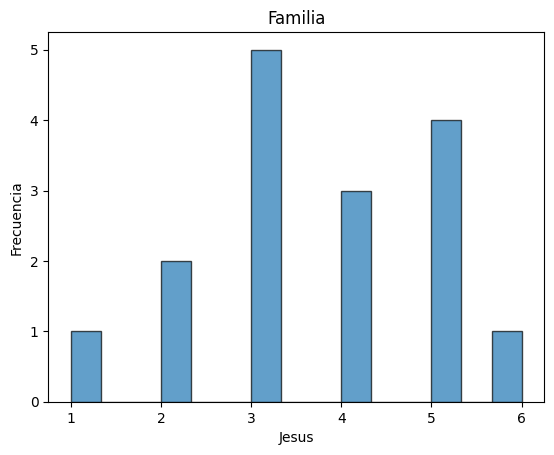

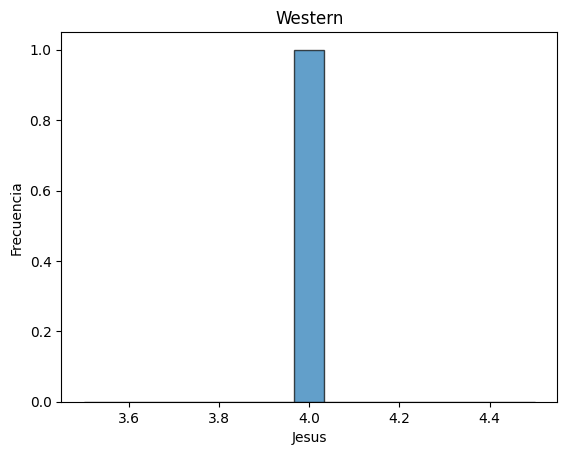

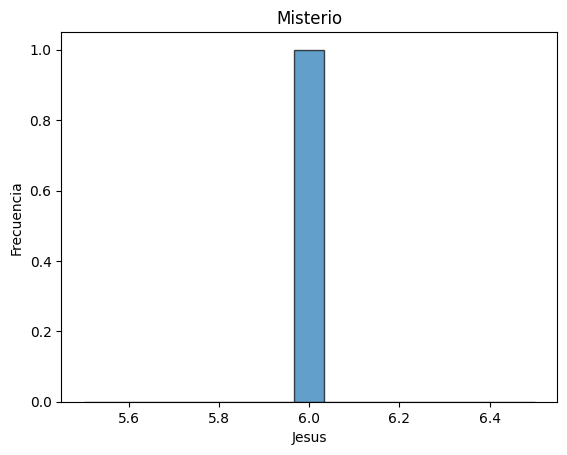

In [ ]:
#3
variable_categorica='Subgenero'
variable_numerica='Jesus'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

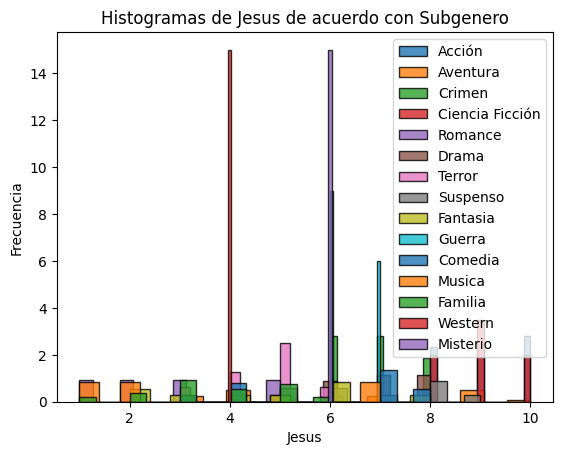

In [ ]:
#4
variable_categorica='Subgenero'
variable_numerica='Jesus'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

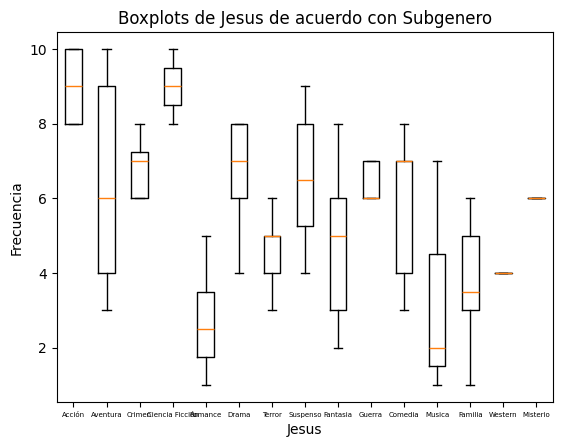

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Subgenero'
variable_numerica = 'Jesus'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Para Jesus, mediante un análisis de los histogramas y boxplots, identificamos que Jesus tiene una preferencia hacia los subgéneros de tipo “Acción” y “Ciencia Ficción”. Estos son los datos que presentan una media más alta a grandes porcentajes y poca variación. Los tipos de subgéneros de “Romance” y “Música” son los más bajos calificados para Jesus. Son los subgéneros con las medidas más bajas, indicando una baja preferencia a estos subgéneros. En conjunto las dos gráficas reflejan la clara preferencia de Jesús sobre los subgéneros y cómo estos afectan a  la elección de sus películas.


### Año

In [ ]:
#1
df.groupby("Año")['Jesus'].mean()

,Jesus
Año,
1976,5.000000
1977,9.000000
1978,6.000000
1980,5.666667
1981,9.000000
1982,8.250000
1983,7.000000
1984,7.000000
1993,10.000000


In [ ]:
#2
df.groupby("Año")['Jesus'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Año,,,,,,,,
1976,5.000000,5,5,NaN,1,5.0,5.00,5.00
1977,9.000000,9,9,NaN,1,9.0,9.00,9.00
1978,6.000000,6,6,NaN,1,6.0,6.00,6.00
1980,5.666667,4,8,2.081666,3,5.0,4.50,6.50
1981,9.000000,9,9,NaN,1,9.0,9.00,9.00
1982,8.250000,7,9,0.957427,4,8.5,7.75,9.00
1983,7.000000,7,7,NaN,1,7.0,7.00,7.00
1984,7.000000,4,10,4.242641,2,7.0,5.50,8.50
1993,10.000000,10,10,NaN,1,10.0,10.00,10.00


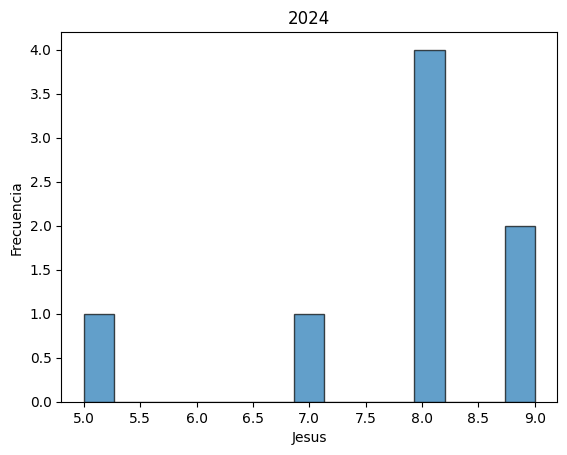

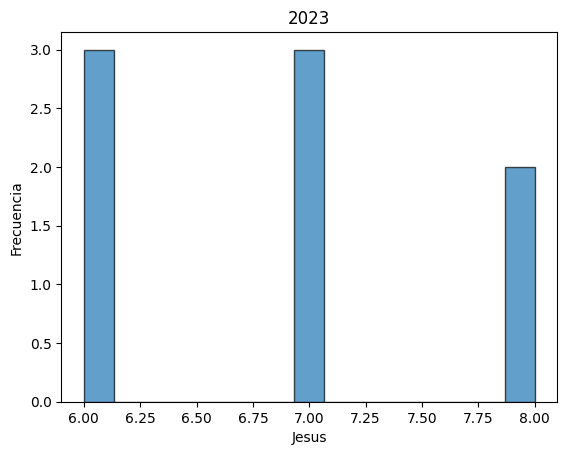

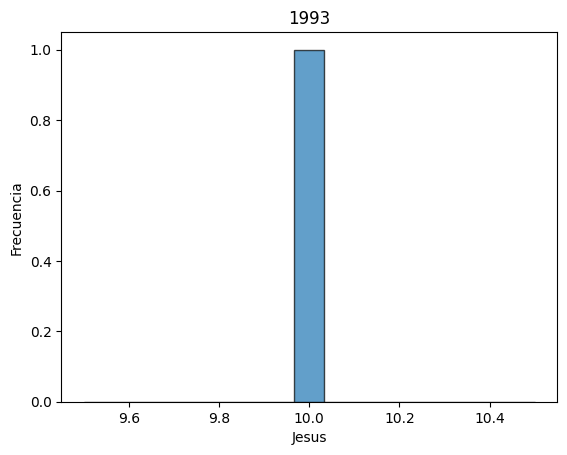

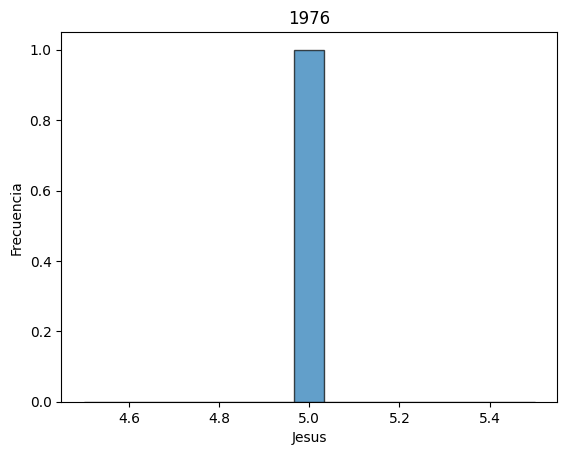

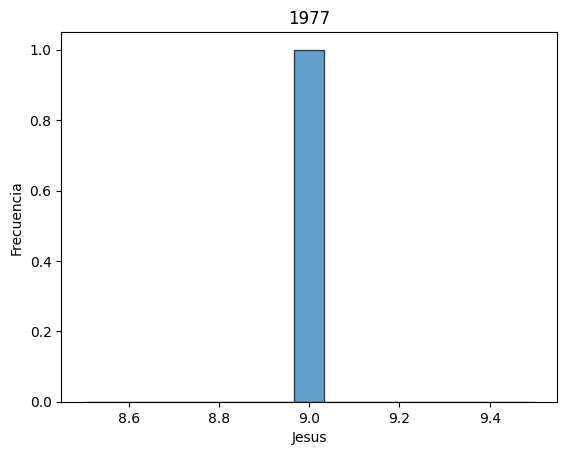

...

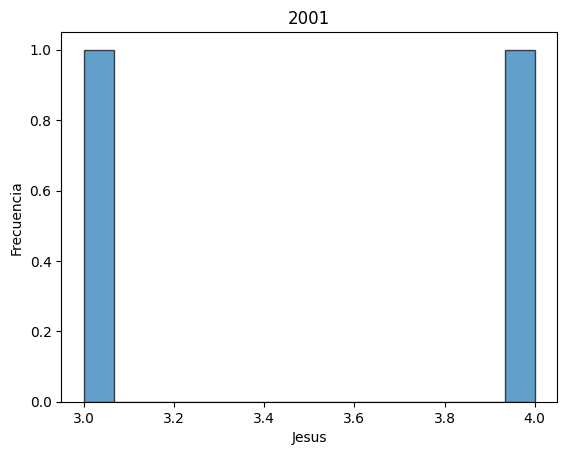

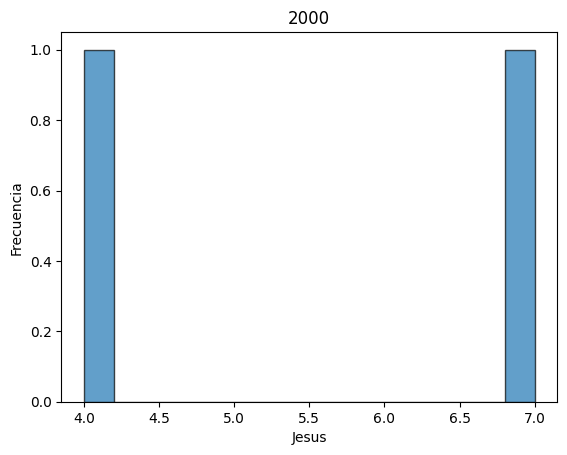

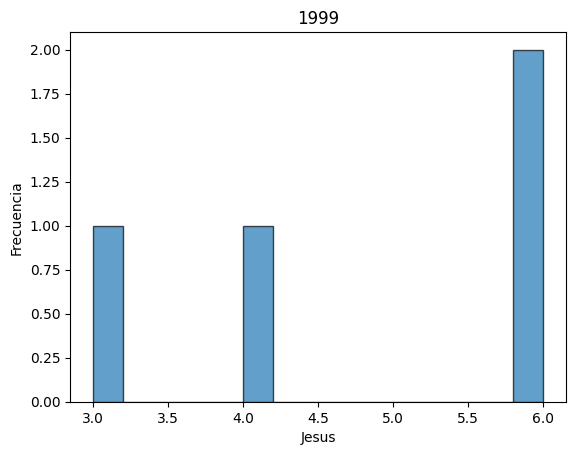

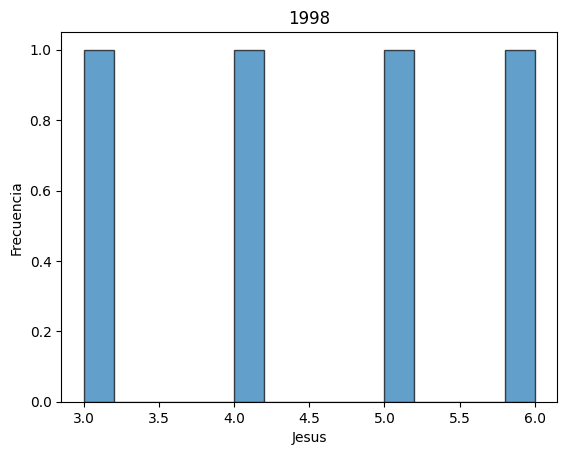

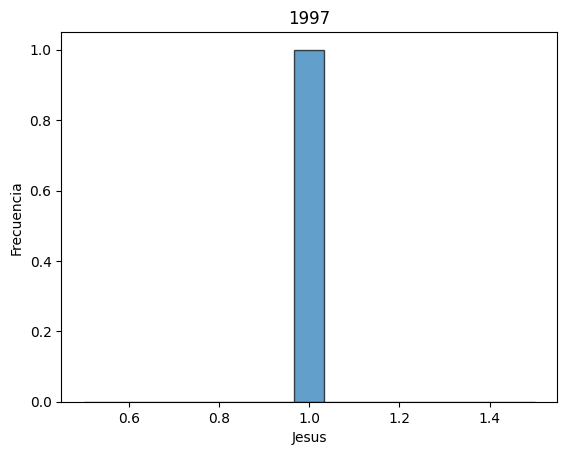

In [ ]:
#3
variable_categorica='Año'
variable_numerica='Jesus'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

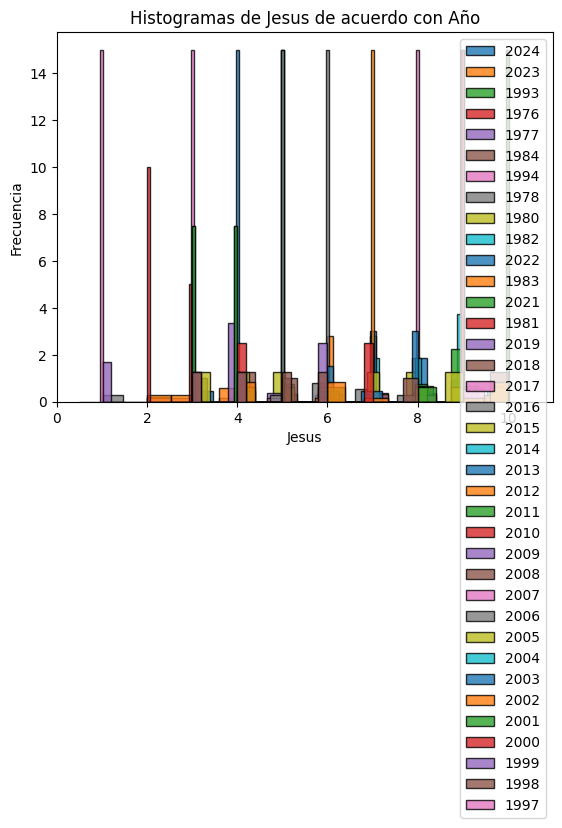

In [ ]:
#4
variable_categorica='Año'
variable_numerica='Jesus'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

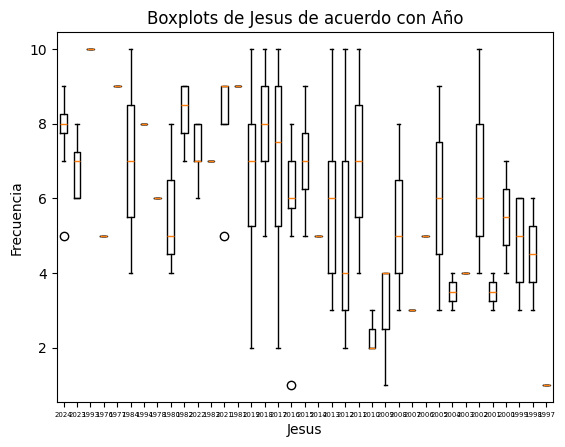

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Año'
variable_numerica = 'Jesus'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

El boxplot que presenta las calificaciones de Jesús a lo largo de los años revela una interesante variabilidad en sus gustos cinematográficos. Cada caja representa un año y nos muestra la distribución de sus calificaciones. La ausencia de una tendencia clara sugiere que sus preferencias no siguen un patrón definido a lo largo del tiempo. Observamos una gran dispersión en las calificaciones, lo que indica que sus opiniones sobre las películas fluctúan considerablemente de un año a otro. La presencia de valores atípicos sugiere que ha habido películas que lo han impresionado de manera particular, tanto positiva como negativamente. Sin embargo, este tipo de gráfico no nos permite identificar las razones detrás de estas variaciones.


### Clasificación

In [ ]:
#1
df.groupby("Clasificacion")['Jesus'].mean()

,Jesus
Clasificacion,
G,3.000000
PG,5.403846
PG-13,7.833333
R,6.372093


In [ ]:
#2
df.groupby("Clasificacion")['Jesus'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Clasificacion,,,,,,,,
G,3.000000,1,5,1.414214,8,3.0,2.0,3.5
PG,5.403846,1,10,2.320071,52,5.0,4.0,7.0
PG-13,7.833333,1,10,1.998983,42,8.0,7.0,9.0
R,6.372093,2,10,1.759644,43,7.0,5.0,8.0


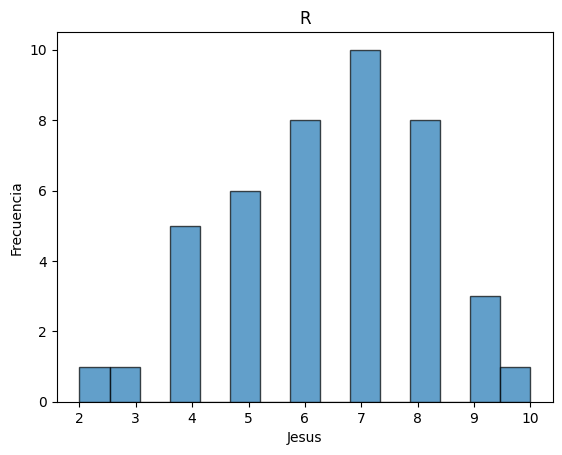

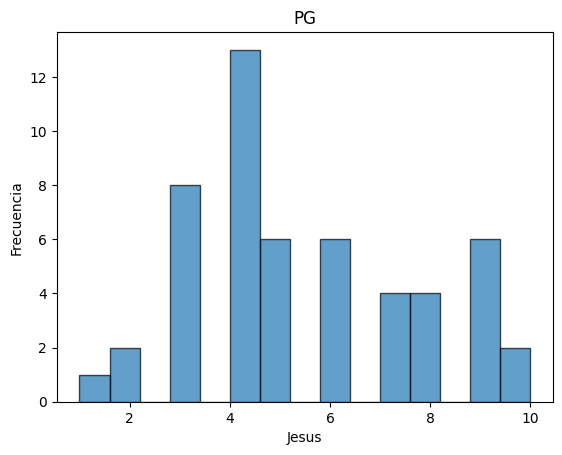

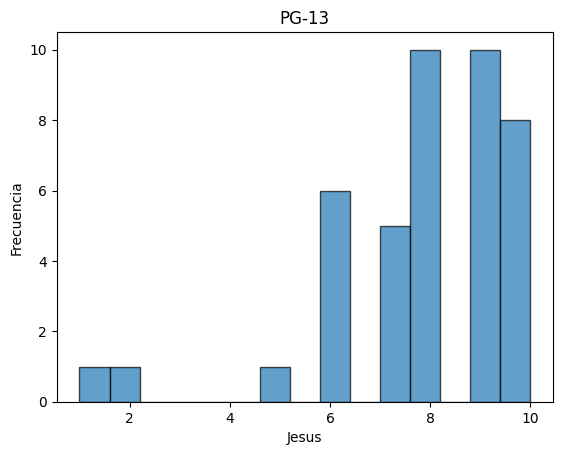

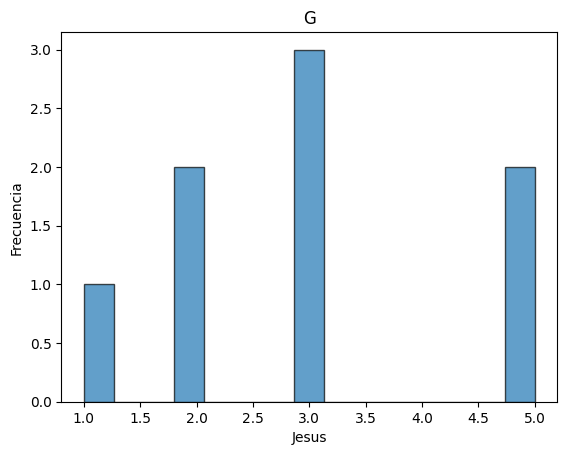

In [ ]:
#3
variable_categorica='Clasificacion'
variable_numerica='Jesus'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

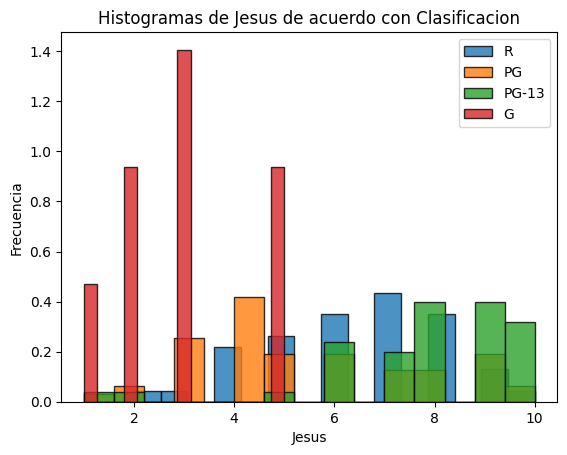

In [ ]:
#4
variable_categorica='Clasificacion'
variable_numerica='Jesus'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

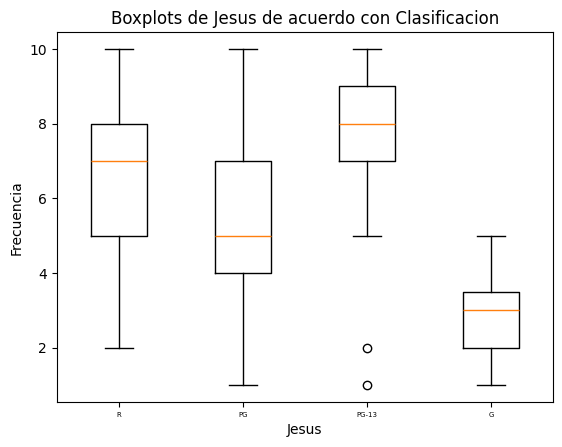

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Clasificacion'
variable_numerica = 'Jesus'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Tanto el histograma como el boxplot nos ofrecen una visión complementaria sobre cómo Jesús califica las películas según su clasificación por edades. El histograma revela que Jesús tiende a otorgar calificaciones altas de manera consistente en todas las clasificaciones, sin mostrar una preferencia marcada por una categoría en particular. Por su parte, el boxplot nos permite visualizar la distribución de las calificaciones dentro de cada clasificación, evidenciando una mayor variabilidad en las categorías R y G, mientras que las categorías PG y PG-13 presentan una distribución más concentrada alrededor de la mediana. Al combinar ambos gráficos, podemos inferir que Jesús es un espectador bastante abierto que disfruta de una amplia variedad de películas.


### Animacion

In [ ]:
#1
df.groupby("Animacion")['Jesus'].mean()

,Jesus
Animacion,
no,6.936364
si,4.142857


In [ ]:
#2
df.groupby("Animacion")['Jesus'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Animacion,,,,,,,,
no,6.936364,1,10,2.117109,110,7.0,6.0,9.0
si,4.142857,1,10,1.833397,35,4.0,3.0,5.0


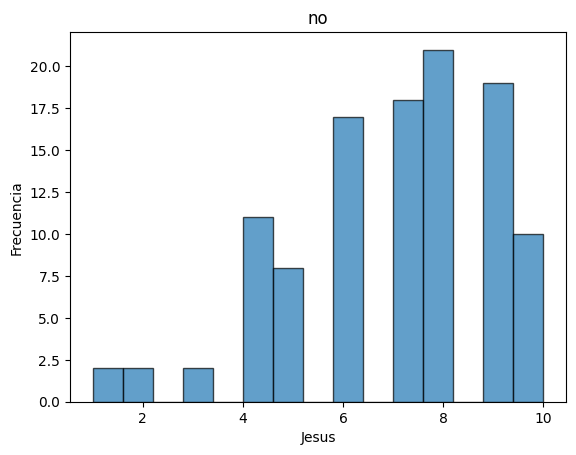

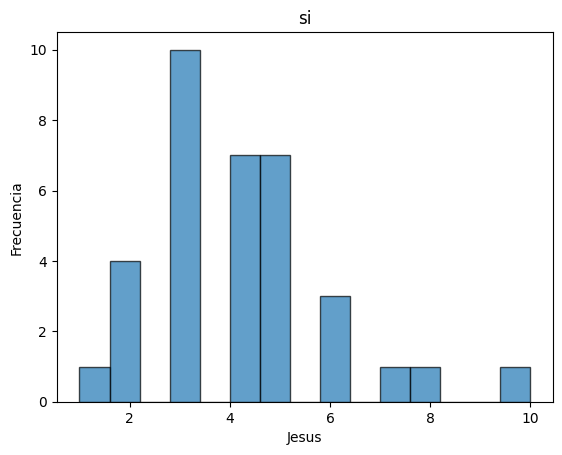

In [ ]:
#3
variable_categorica='Animacion'
variable_numerica='Jesus'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

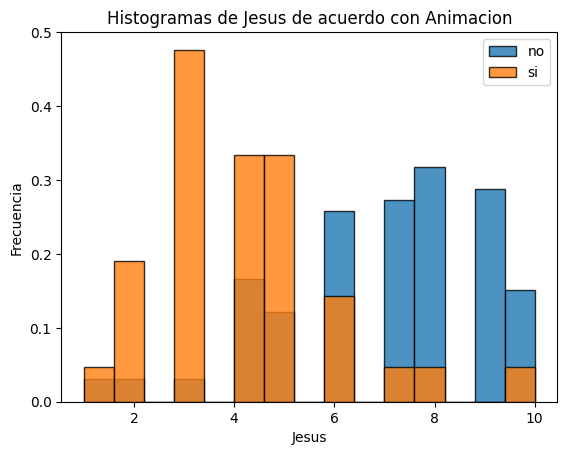

In [ ]:
#4
variable_categorica='Animacion'
variable_numerica='Jesus'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

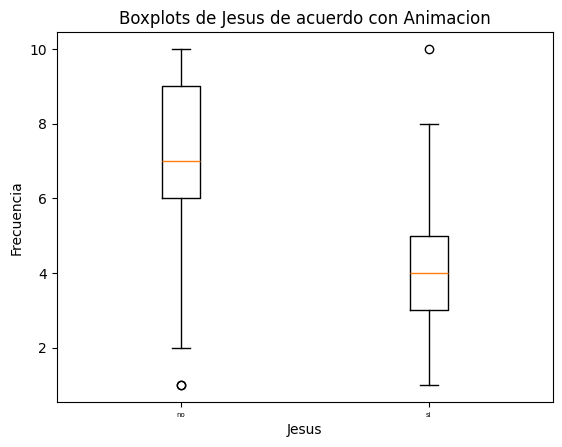

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Animacion'
variable_numerica = 'Jesus'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Tanto el histograma como el boxplot nos proporcionan una visión complementaria sobre cómo Jesús califica las películas según tengan o no animación. El histograma revela una ligera tendencia a otorgar calificaciones ligeramente más altas a las películas sin animación, aunque la diferencia no es muy marcada. Por su parte, el boxplot confirma esta tendencia al mostrar una mediana ligeramente superior para las películas sin animación. Sin embargo, también revela una mayor variabilidad en las calificaciones de las películas animadas, lo que sugiere una mayor diversidad de opiniones por parte de Jesús al respecto.


### Duración

In [ ]:
#1
df.groupby("Duracion")['Jesus'].mean()

,Jesus
Duracion,
78,4.000000
83,4.000000
86,3.000000
88,3.000000
90,3.666667
...,...
180,6.000000
181,8.000000
189,6.000000


In [ ]:
#2
df.groupby("Duracion")['Jesus'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Duracion,,,,,,,,
78,4.000000,4,4,NaN,1,4.0,4.0,4.0
83,4.000000,4,4,NaN,1,4.0,4.0,4.0
86,3.000000,3,3,NaN,1,3.0,3.0,3.0
88,3.000000,3,3,NaN,1,3.0,3.0,3.0
90,3.666667,3,4,0.577350,3,4.0,3.5,4.0
...,...,...,...,...,...,...,...,...
180,6.000000,6,6,NaN,1,6.0,6.0,6.0
181,8.000000,6,10,2.828427,2,8.0,7.0,9.0
189,6.000000,6,6,NaN,1,6.0,6.0,6.0


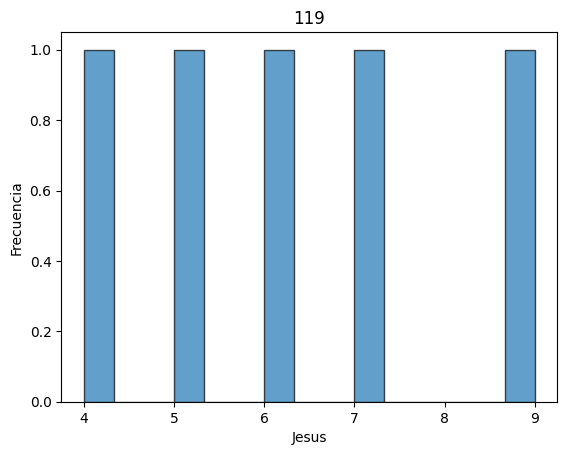

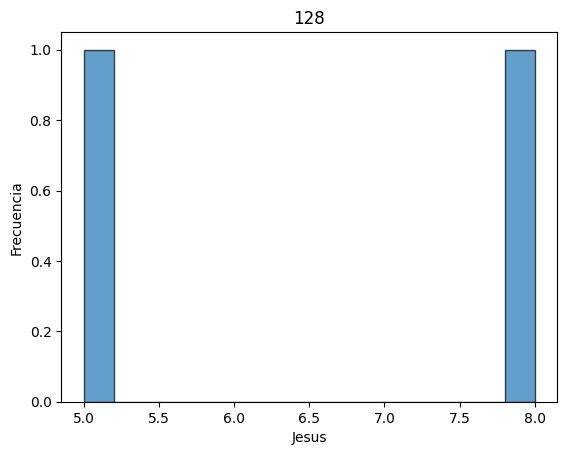

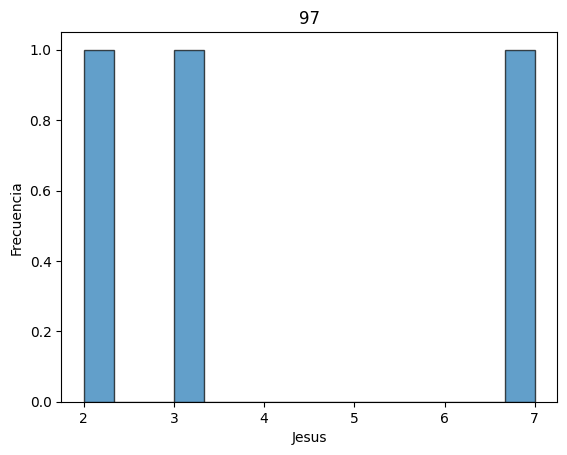

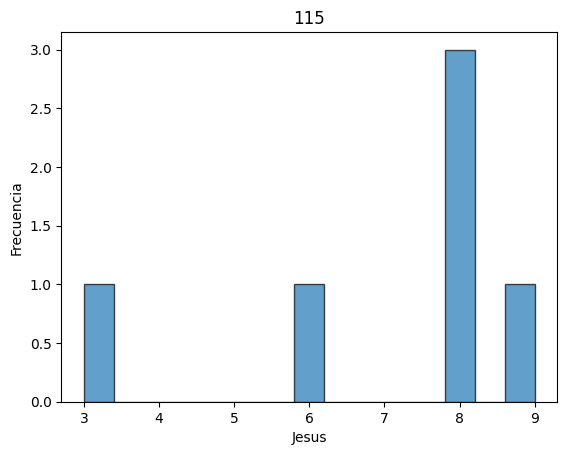

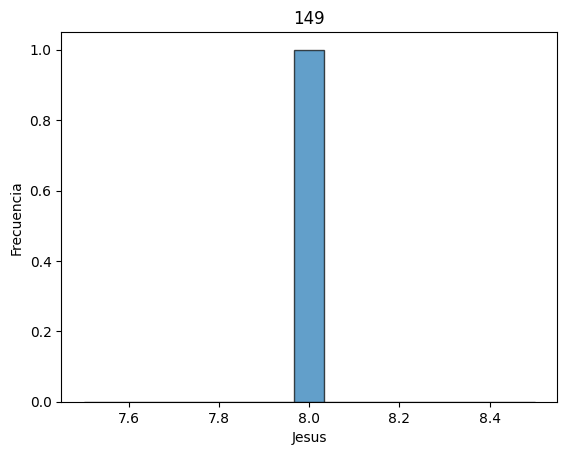

...

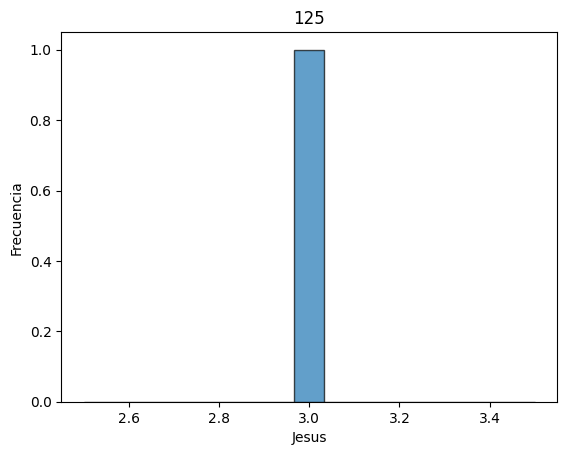

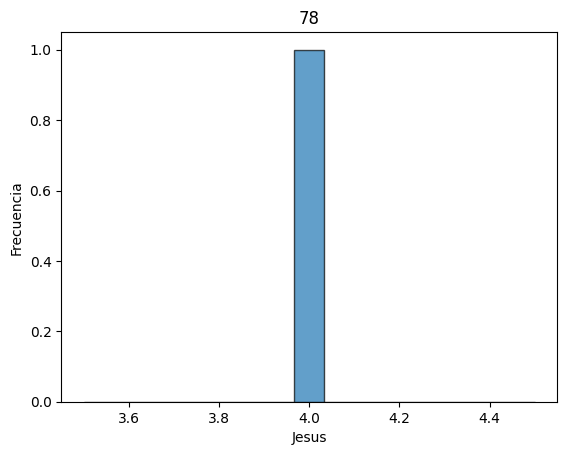

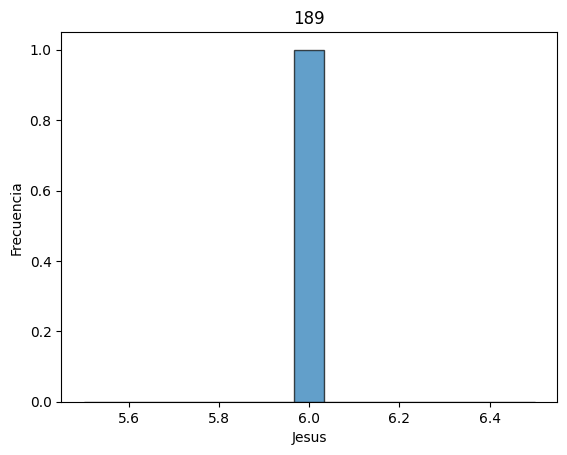

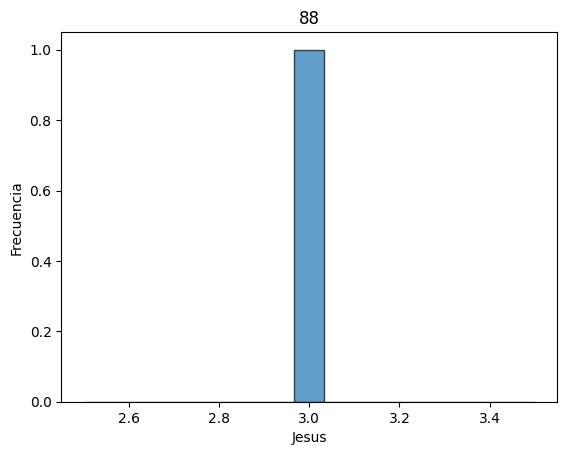

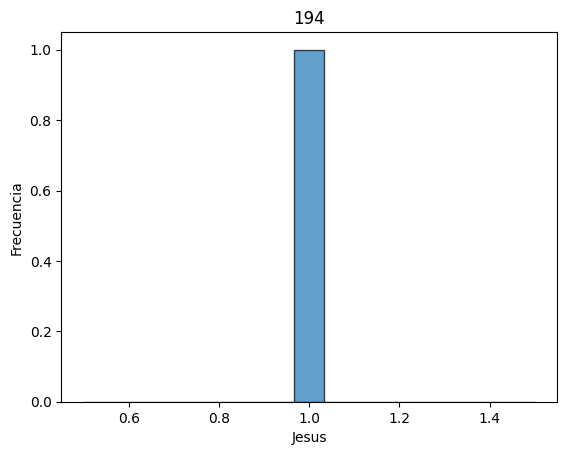

In [ ]:
#3
variable_categorica='Duracion'
variable_numerica='Jesus'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

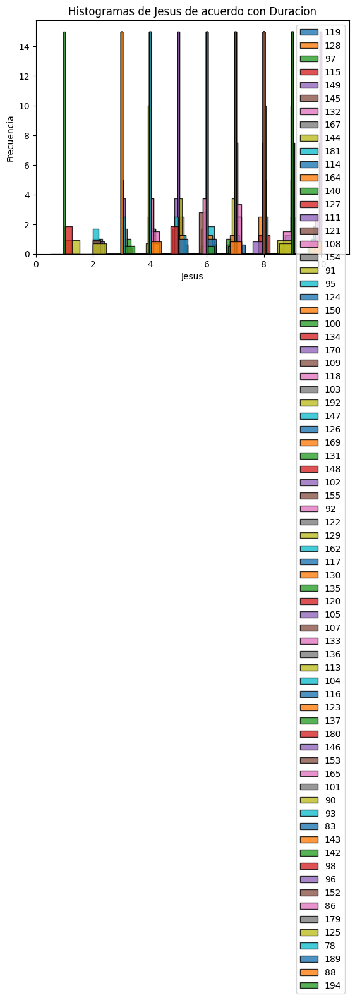

In [ ]:
#4
variable_categorica='Duracion'
variable_numerica='Jesus'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

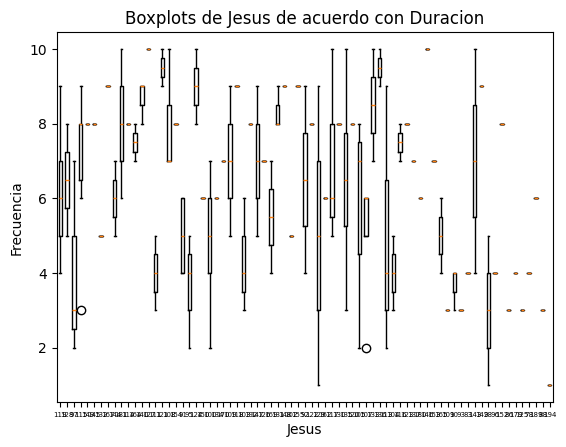

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Duracion'
variable_numerica = 'Jesus'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Tanto en el histograma como en el boxplot es complicado  hacer un análisis claro de lo que se puede llegar a apreciar. Las calificaciones que Jesús le da a las películas respecto a la duración no tiene un patrón claro teniendo poca congruencia en realizar un análisis. Pero lo que si se llega a apreciar es que Jesus llega a presentar una media mayor a 6 en la mayoría de las puntuaciones, teniendo un alto de 9 de media, ayudándonos a comprender la mínima tendencia que se podría presentar en estos datos. En el histograma existen picos muy altos y datos sumamente variados, reflejando nuevamente la poca congruencia de las calificaciones.


### Criticos

In [ ]:
#1
df.groupby("Criticos")['Jesus'].mean()

,Jesus
Criticos,
5.3,7.000000
5.5,3.000000
5.6,5.000000
5.7,7.000000
6.0,7.500000
6.2,5.000000
6.4,4.000000
6.5,8.000000
6.6,6.333333


In [ ]:
#2
df.groupby("Criticos")['Jesus'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Criticos,,,,,,,,
5.3,7.000000,7,7,NaN,1,7.0,7.00,7.00
5.5,3.000000,3,3,NaN,1,3.0,3.00,3.00
5.6,5.000000,4,6,1.414214,2,5.0,4.50,5.50
5.7,7.000000,7,7,NaN,1,7.0,7.00,7.00
6.0,7.500000,7,8,0.707107,2,7.5,7.25,7.75
6.2,5.000000,5,5,NaN,1,5.0,5.00,5.00
6.4,4.000000,4,4,NaN,1,4.0,4.00,4.00
6.5,8.000000,8,8,NaN,1,8.0,8.00,8.00
6.6,6.333333,4,8,2.081666,3,7.0,5.50,7.50


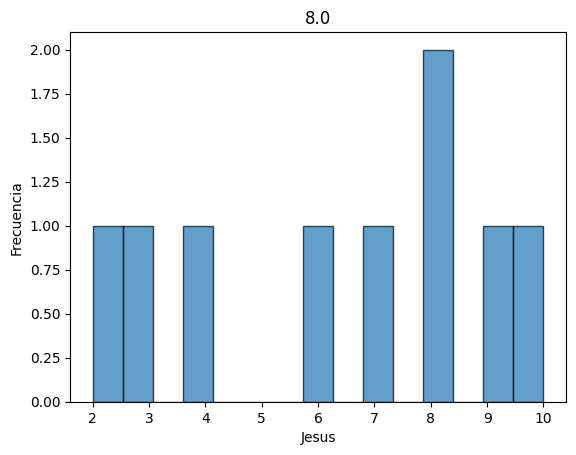

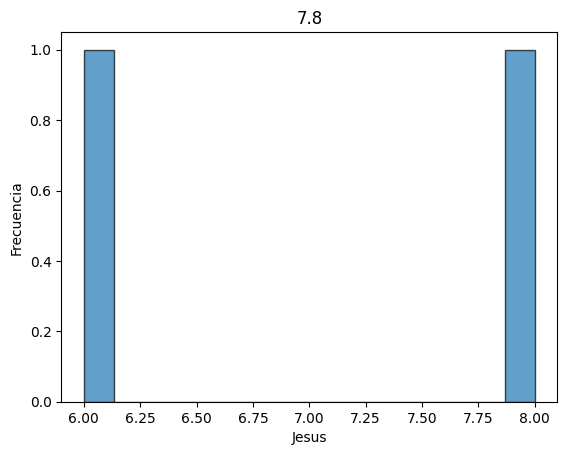

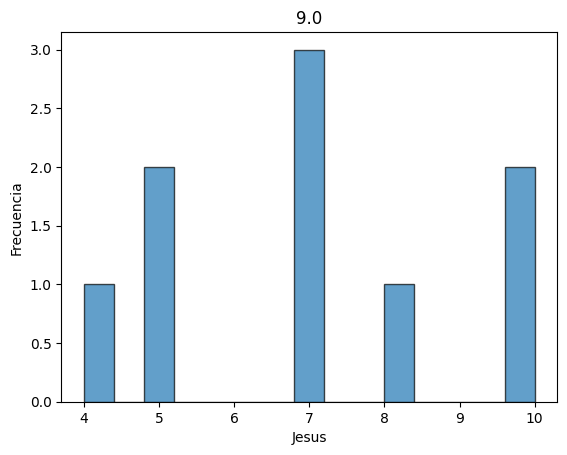

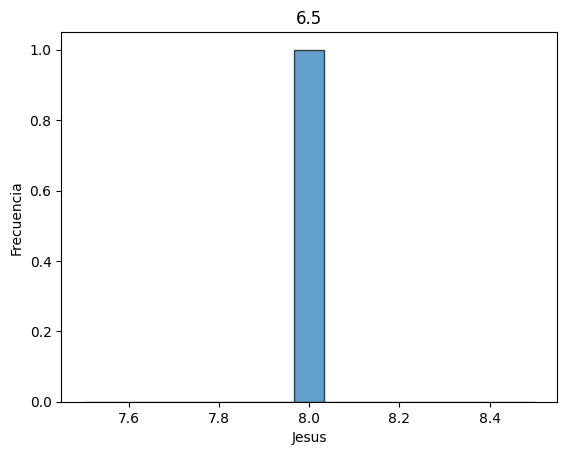

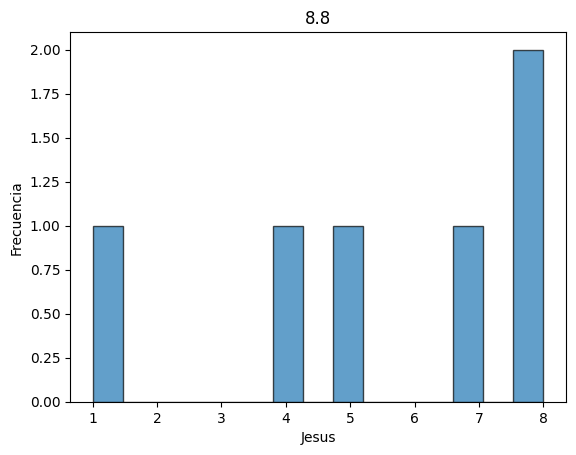

...

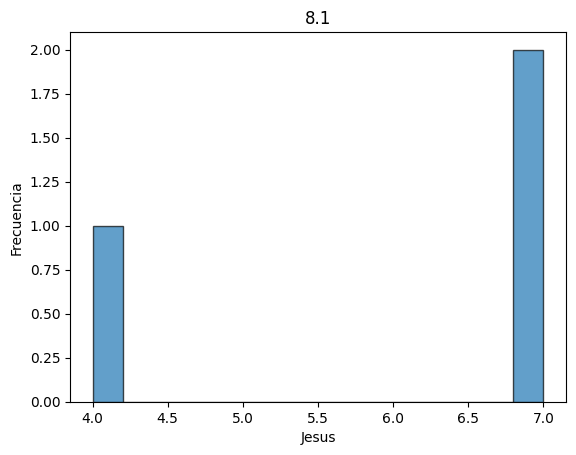

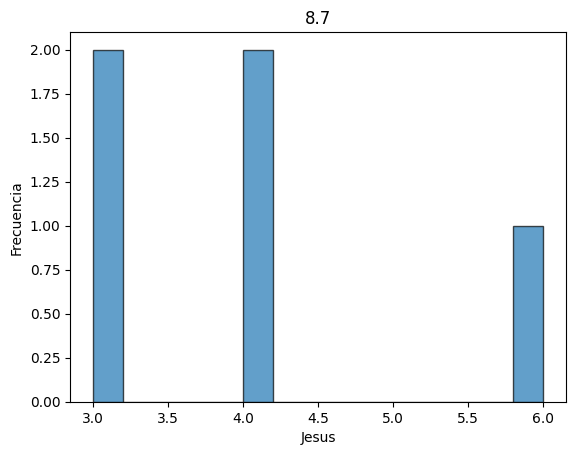

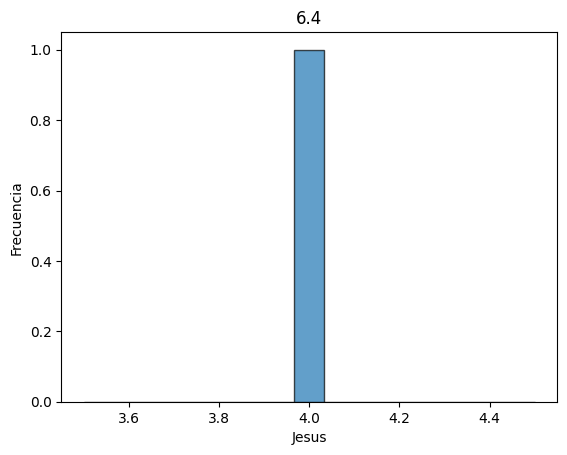

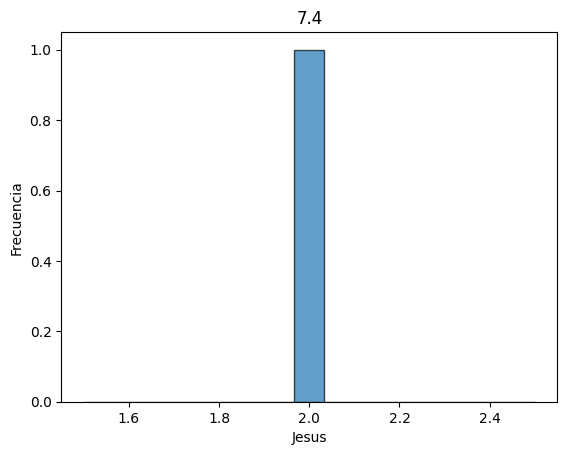

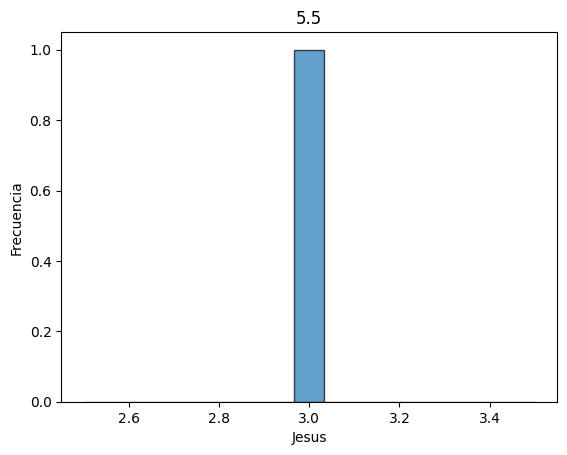

In [ ]:
#3
variable_categorica='Criticos'
variable_numerica='Jesus'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

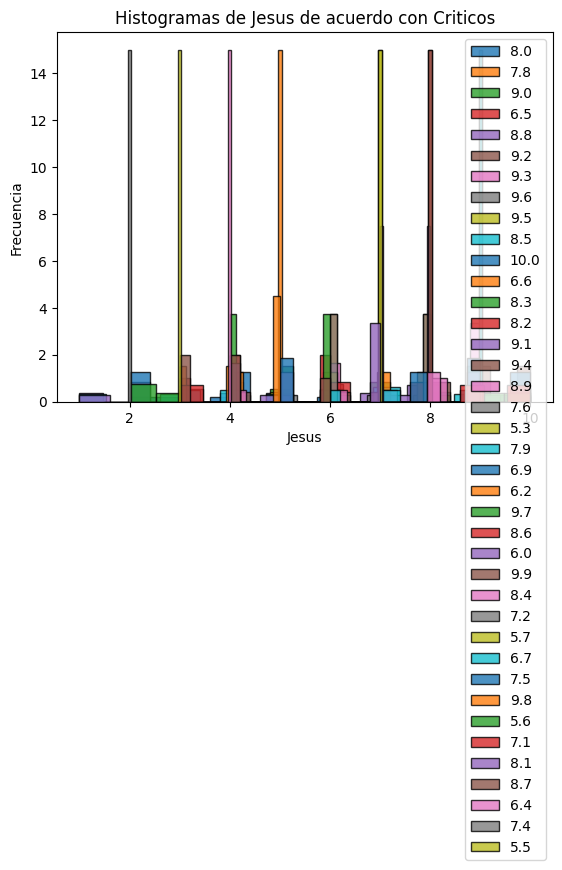

In [ ]:
#4
variable_categorica='Criticos'
variable_numerica='Jesus'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

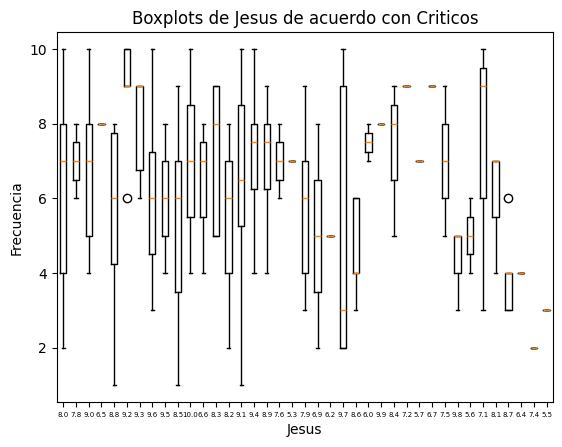

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Criticos'
variable_numerica = 'Jesus'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

El boxplot que nos presentas ofrece una visión interesante sobre la relación entre las calificaciones que Jesús asigna a las películas y las valoraciones otorgadas por los críticos. En general, se observa una correlación positiva entre ambas, lo que indica que cuando los críticos consideran una película como buena, Jesús tiende a coincidir con esta opinión. Sin embargo, esta correlación no es perfecta y existen ciertas variaciones que merecen ser analizadas. Existe una cierta diferencia positiva y negativa la cual indica que existe una relación cercana. Esto se parecía mediante el boxplot y el histograma.


### Audiencia

In [ ]:
#1
df.groupby("Audiencia")['Jesus'].mean()

,Jesus
Audiencia,
5.4,9.000000
5.6,6.000000
5.8,4.333333
6.0,5.750000
6.2,7.500000
6.4,8.000000
6.6,8.800000
6.8,5.000000
7.0,6.181818


In [ ]:
#2
df.groupby("Audiencia")['Jesus'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Audiencia,,,,,,,,
5.4,9.000000,9,9,NaN,1,9.0,9.00,9.00
5.6,6.000000,6,6,NaN,1,6.0,6.00,6.00
5.8,4.333333,4,5,0.577350,3,4.0,4.00,4.50
6.0,5.750000,2,9,3.304038,4,6.0,3.50,8.25
6.2,7.500000,6,9,2.121320,2,7.5,6.75,8.25
6.4,8.000000,8,8,NaN,1,8.0,8.00,8.00
6.6,8.800000,7,10,1.303840,5,9.0,8.00,10.00
6.8,5.000000,2,9,2.563480,8,4.5,3.00,7.00
7.0,6.181818,2,10,2.522625,11,6.0,4.50,8.00


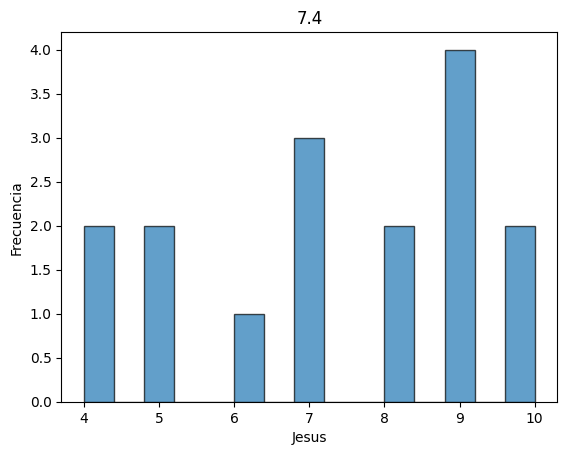

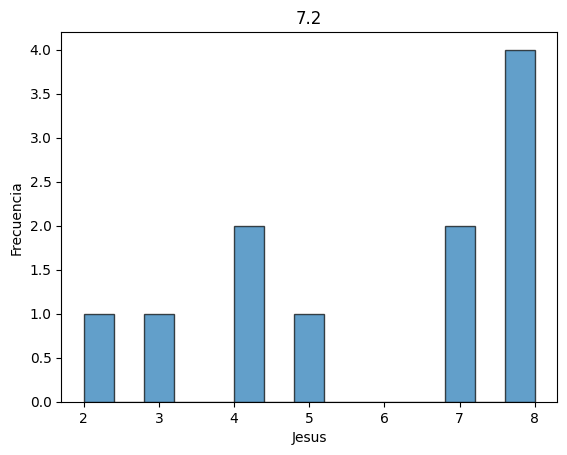

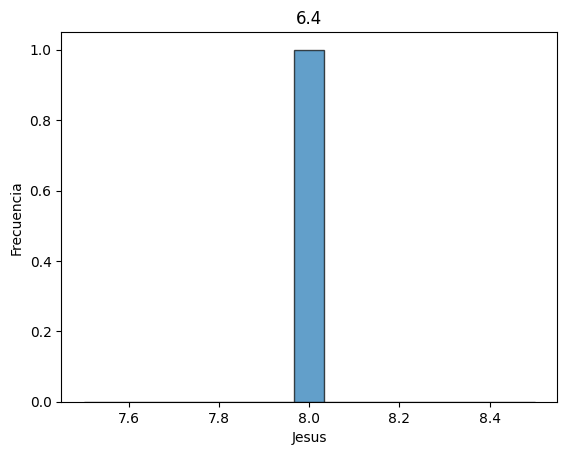

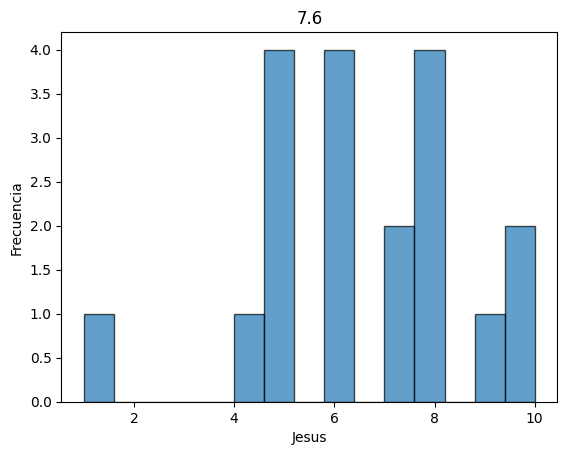

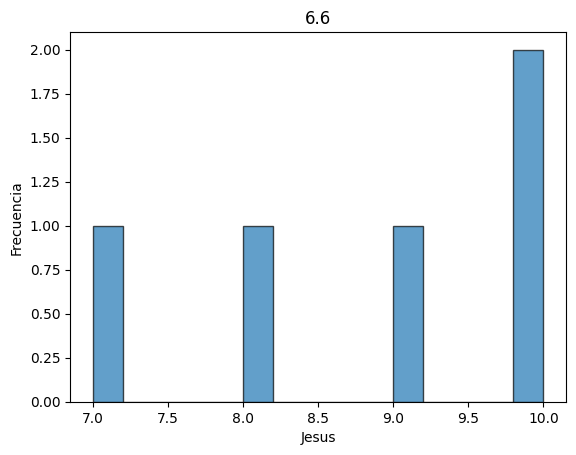

...

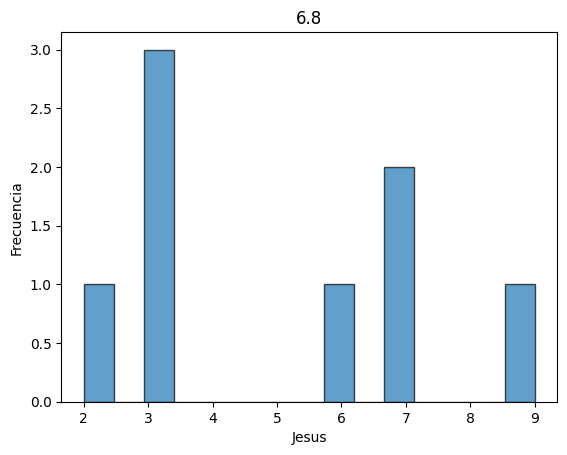

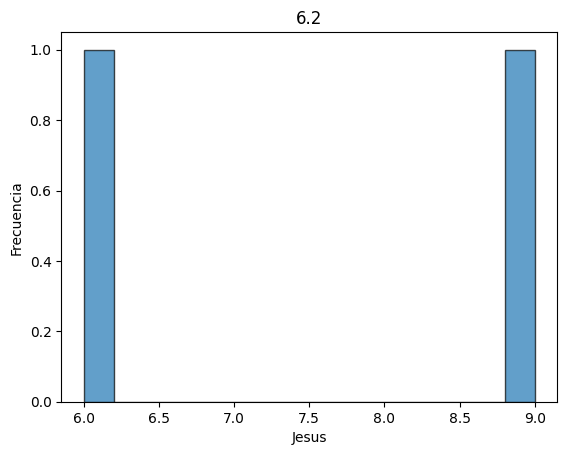

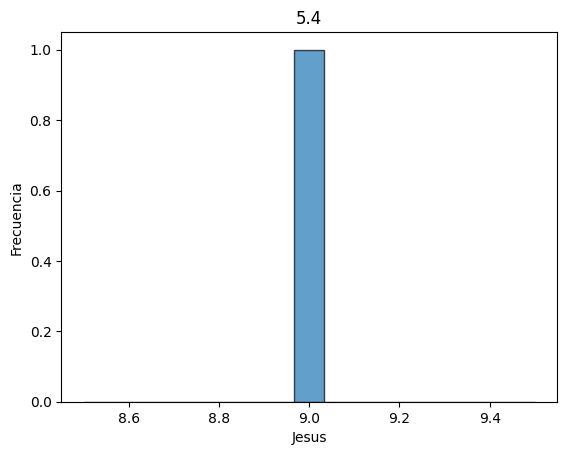

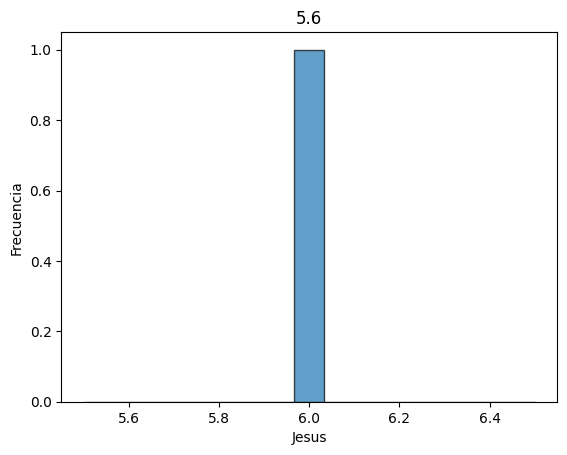

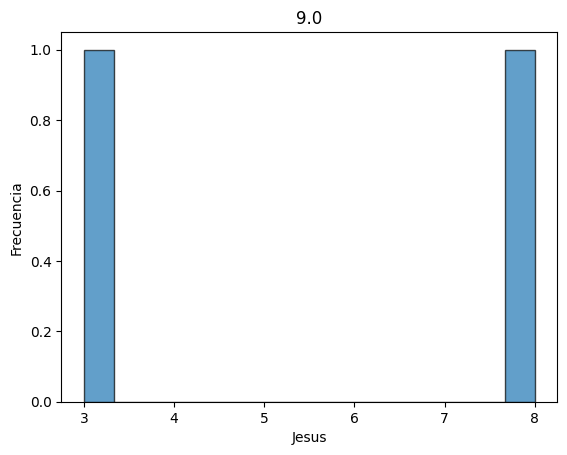

In [ ]:
#3
variable_categorica='Audiencia'
variable_numerica='Jesus'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

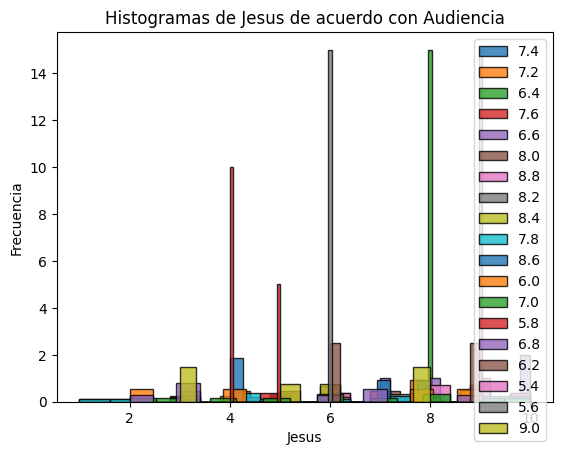

In [ ]:
#4
variable_categorica='Audiencia'
variable_numerica='Jesus'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

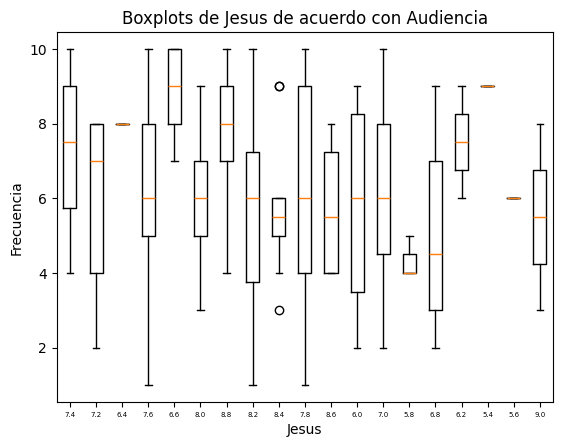

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Audiencia'
variable_numerica = 'Jesus'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

El boxplot que compara las calificaciones de Jesús con las de la audiencia revela una interesante correlación. En general, Jesús tiende a coincidir con la opinión mayoritaria de la audiencia, lo que sugiere que sus gustos cinematográficos se alinean con los del público en general. Sin embargo, el gráfico también muestra cierta variabilidad, especialmente cuando las películas reciben calificaciones intermedias de la audiencia. Esto indica que, aunque Jesús se ve influenciado por la opinión popular, sus preferencias personales y otros factores, como el género o la trama, también juegan un papel importante en su valoración final.


## Leo

### Genero

In [ ]:
#1
df.groupby("Genero")['Leo'].mean()

,Leo
Genero,
Acción,7.428571
Aventura,4.941176
Ciencia Ficción,6.842105
Comedia,4.500000
Crimen,8.500000
Drama,7.055556
Familia,2.933333
Fantasia,3.833333
Guerra,6.000000


In [ ]:
#2
df.groupby("Genero")['Leo'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Genero,,,,,,,,
Acción,7.428571,5,10,1.028175,21,7.0,7.00,8.00
Aventura,4.941176,1,7,1.477777,17,5.0,4.00,6.00
Ciencia Ficción,6.842105,2,9,1.803181,19,7.0,7.00,7.50
Comedia,4.500000,1,9,2.229482,18,4.0,3.00,5.75
Crimen,8.500000,6,10,1.309307,8,8.5,8.00,9.25
Drama,7.055556,5,10,2.099642,18,6.5,5.00,9.00
Familia,2.933333,1,4,1.279881,15,3.0,2.00,4.00
Fantasia,3.833333,3,4,0.408248,6,4.0,4.00,4.00
Guerra,6.000000,6,6,NaN,1,6.0,6.00,6.00


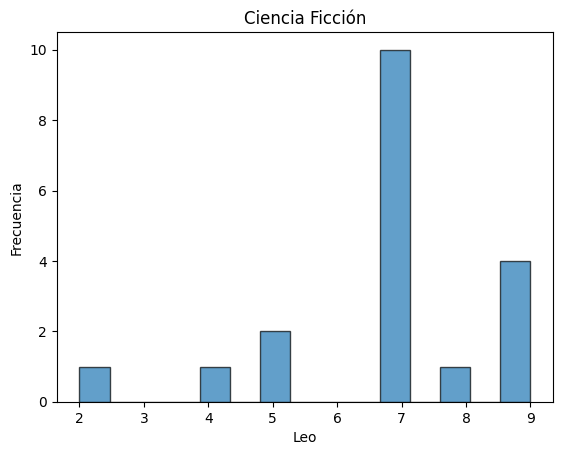

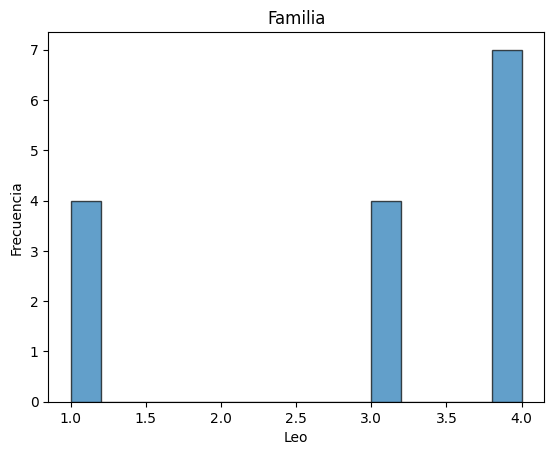

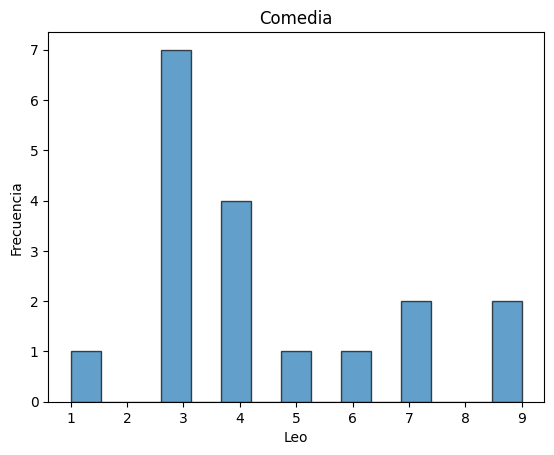

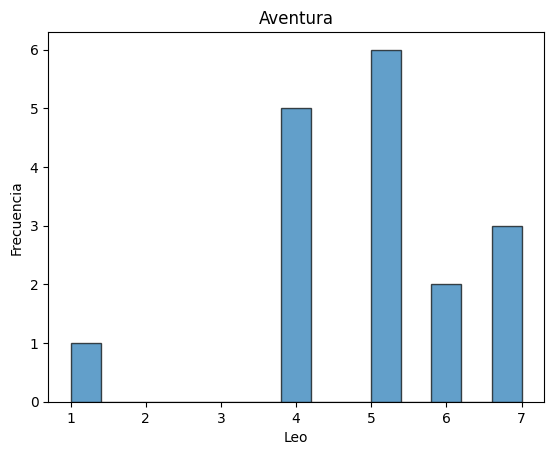

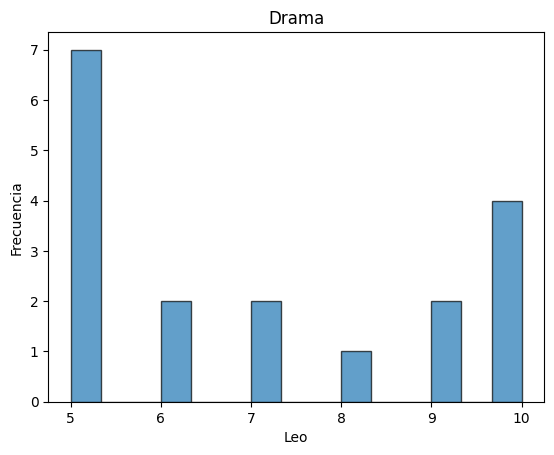

...

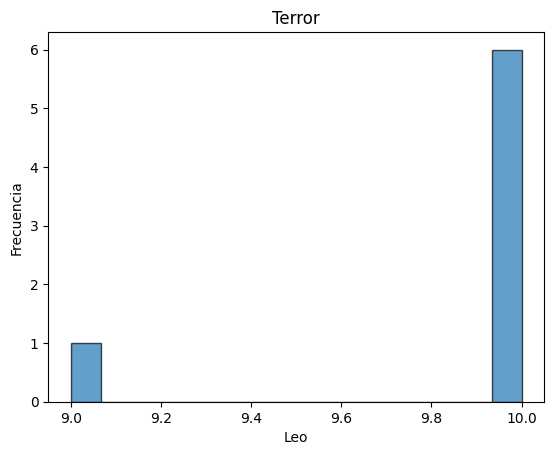

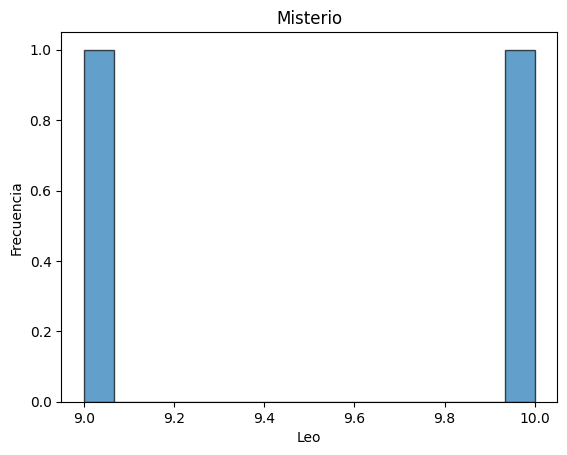

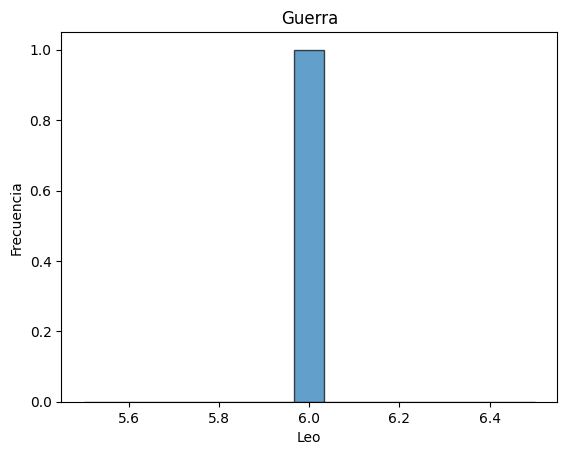

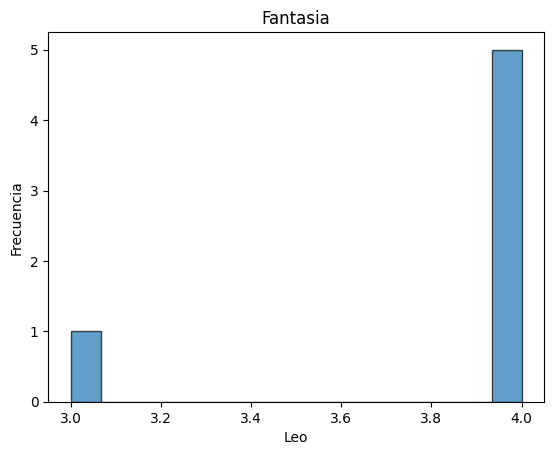

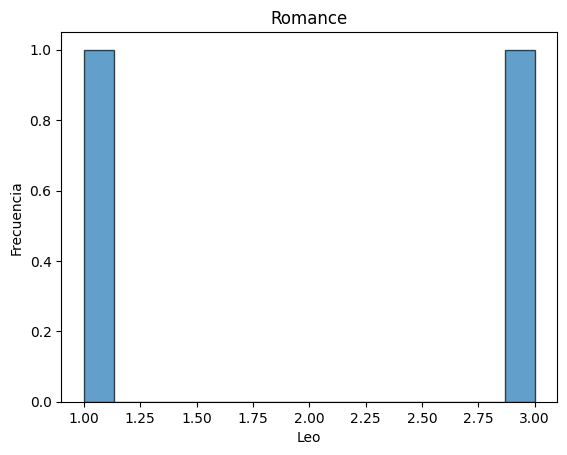

In [ ]:
#3
variable_categorica='Genero'
variable_numerica='Leo'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

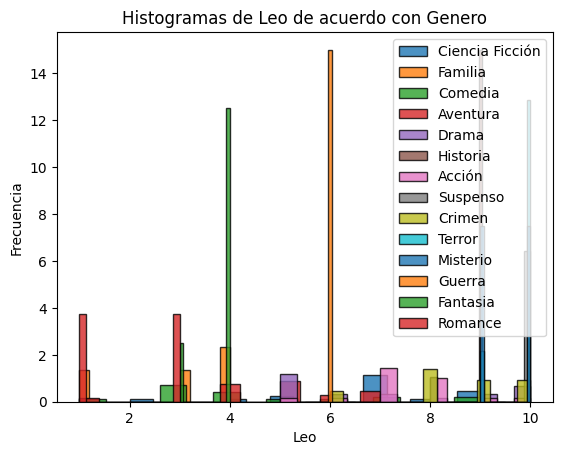

In [ ]:
#4
variable_categorica='Genero'
variable_numerica='Leo'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

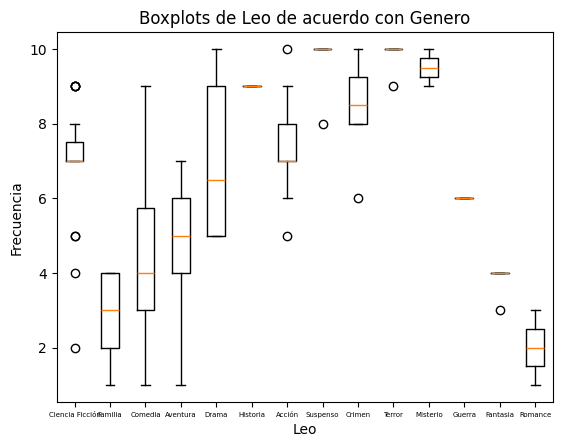

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Genero'
variable_numerica = 'Leo'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Como se puede observar en las gráficas, Leo tiene fuertes preferencias por películas de Suspenso, Misterio, Historia y Terror, con calificaciones promedio iguales o superiores a 9, lo que indica que disfruta de contenido intenso y emocionante. Por otro lado, las calificaciones de los géneros familiares, comedias, aventuras y románticos oscilan entre 2.75 y 4.71, lo que indica que este tipo de películas no parecen ser de su interés. Las imágenes visuales también apoyan estas conclusiones, ya que los géneros con baja preferencia tienen una calificación ampliamente distribuida, mientras que sus géneros favoritos tienden a ser muy altos y menos dispersos.


### Subgenero

In [ ]:
#1
df.groupby("Subgenero")['Leo'].mean()

,Leo
Subgenero,
Acción,6.937500
Aventura,5.120000
Ciencia Ficción,6.800000
Comedia,6.090909
Crimen,9.250000
Drama,6.923077
Familia,2.750000
Fantasia,4.111111
Guerra,7.800000


In [ ]:
#2
df.groupby("Subgenero")['Leo'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Subgenero,,,,,,,,
Acción,6.937500,5,9,1.436141,16,7.0,5.75,8.0
Aventura,5.120000,4,7,1.394035,25,4.0,4.00,7.0
Ciencia Ficción,6.800000,5,10,1.612452,15,7.0,5.00,7.0
Comedia,6.090909,1,9,2.625054,11,7.0,4.50,8.0
Crimen,9.250000,8,10,0.886405,8,9.5,8.75,10.0
Drama,6.923077,4,10,1.977437,13,7.0,5.00,9.0
Familia,2.750000,1,4,1.183216,16,3.0,1.75,4.0
Fantasia,4.111111,1,7,1.900292,9,4.0,3.00,6.0
Guerra,7.800000,5,9,1.788854,5,9.0,7.00,9.0


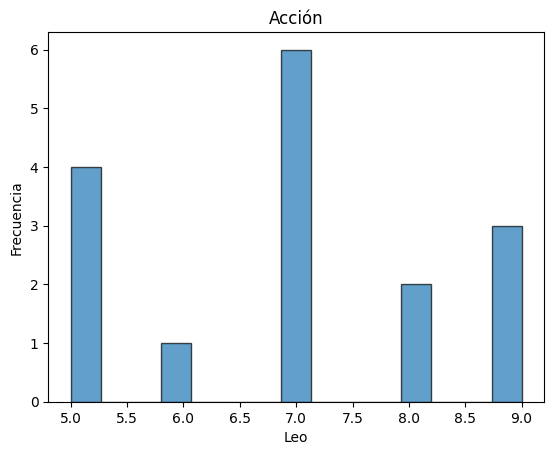

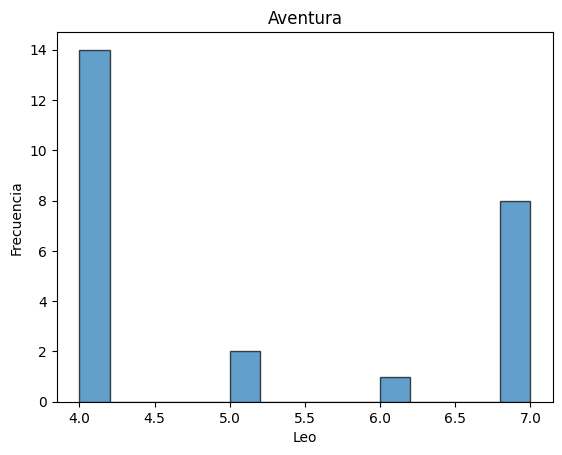

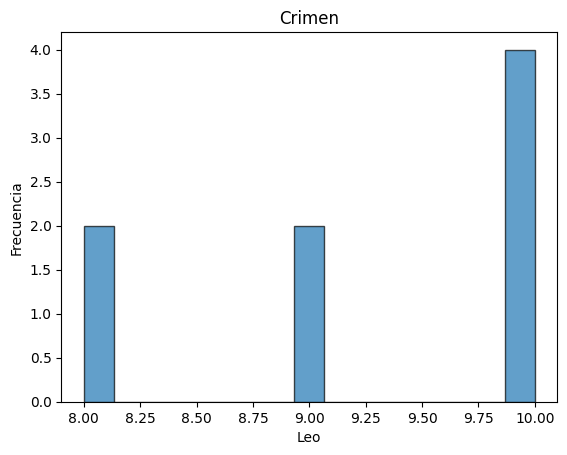

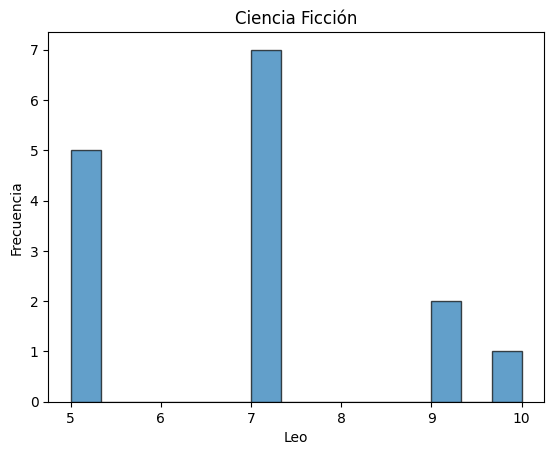

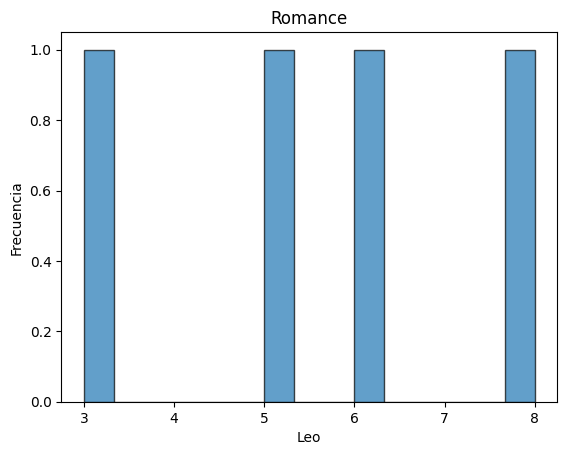

...

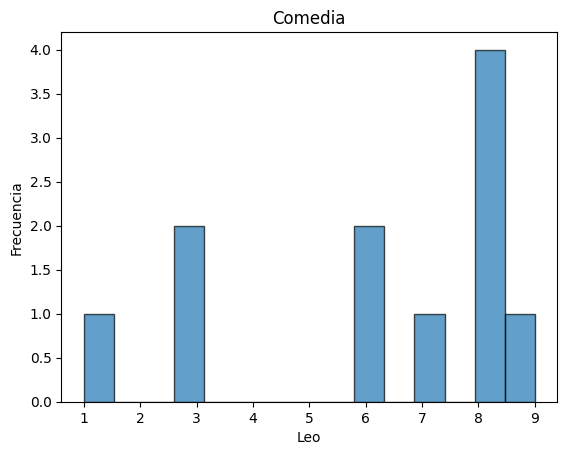

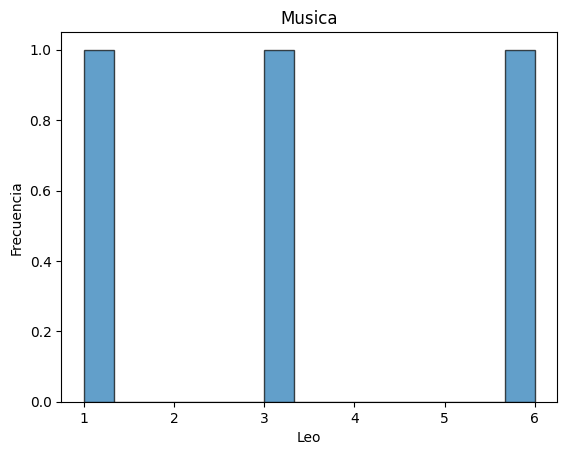

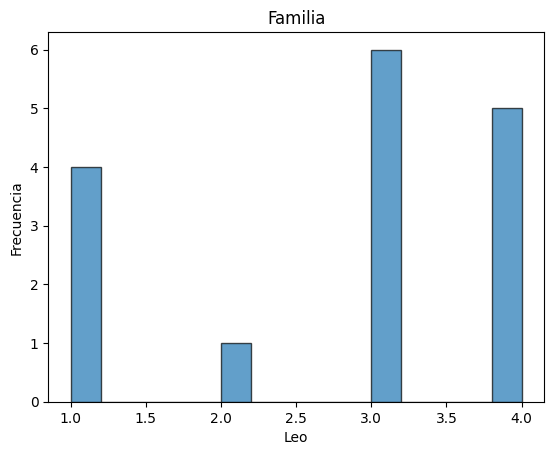

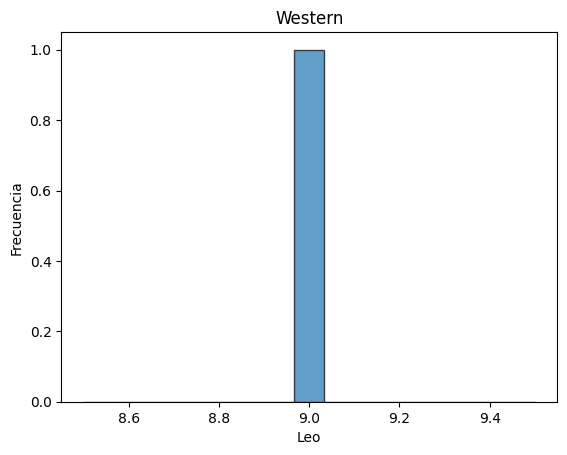

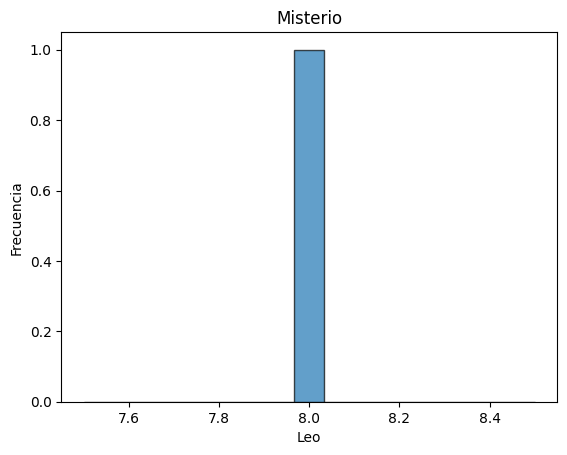

In [ ]:
#3
variable_categorica='Subgenero'
variable_numerica='Leo'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

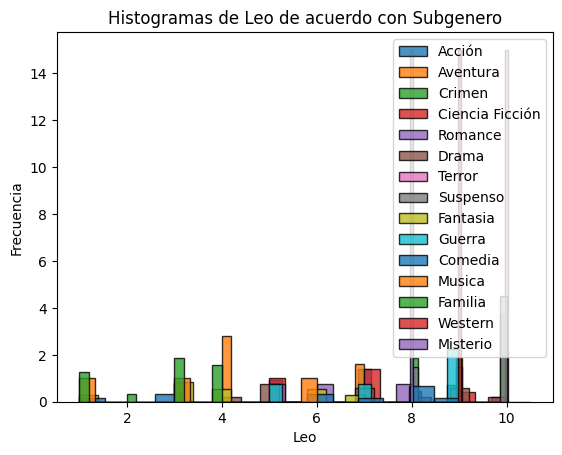

In [ ]:
#4
variable_categorica='Subgenero'
variable_numerica='Leo'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

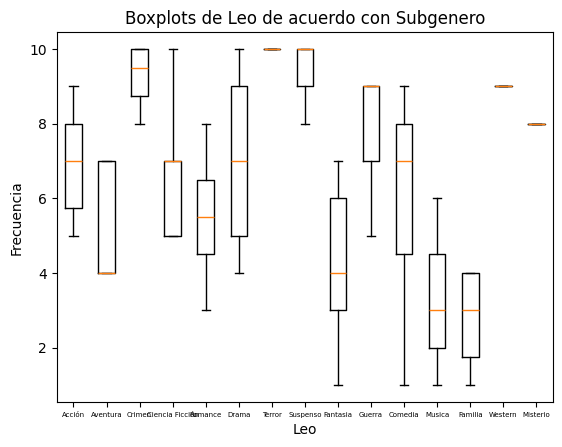

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Subgenero'
variable_numerica = 'Leo'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Leo parece tener gustos en subgéneros muy variados, ya que en favoritos como terror y suspenso, logra calificaciones ultra altas, llegando hasta el 10. Crimen y western, por su parte, también mantiene un promedio avanzado, aunque los promedios de familia y música son varios escalones más bajos. Los boxplots indican su consistencia en las evaluaciones de terror y suspenso, y para otros subgéneros como comedia y drama, la dispersión es más grande, lo que puede indicar opiniones más de polarización. En general, parece ser fanático de los subgéneros más emocionantes e intensos, ya que los ligeros, como familia y fantasía, obtienen menos puntuaciones y atención.


### Año

In [ ]:
#1
df.groupby("Año")['Leo'].mean()

,Leo
Año,
1976,10.000000
1977,5.000000
1978,10.000000
1980,8.333333
1981,5.000000
1982,7.000000
1983,10.000000
1984,9.500000
1993,7.000000


In [ ]:
#2
df.groupby("Año")['Leo'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Año,,,,,,,,
1976,10.000000,10,10,NaN,1,10.0,10.00,10.00
1977,5.000000,5,5,NaN,1,5.0,5.00,5.00
1978,10.000000,10,10,NaN,1,10.0,10.00,10.00
1980,8.333333,5,10,2.886751,3,10.0,7.50,10.00
1981,5.000000,5,5,NaN,1,5.0,5.00,5.00
1982,7.000000,4,10,2.943920,4,7.0,4.75,9.25
1983,10.000000,10,10,NaN,1,10.0,10.00,10.00
1984,9.500000,9,10,0.707107,2,9.5,9.25,9.75
1993,7.000000,7,7,NaN,1,7.0,7.00,7.00


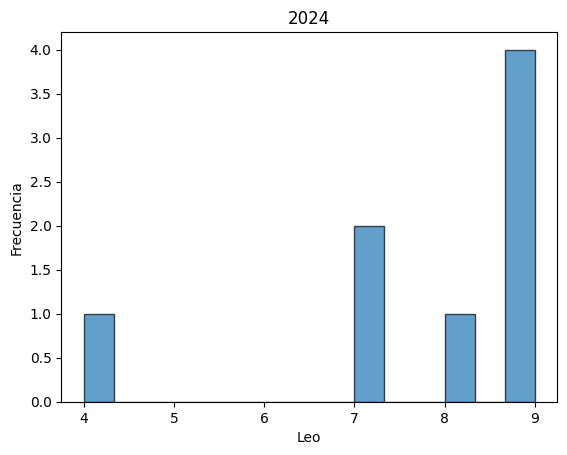

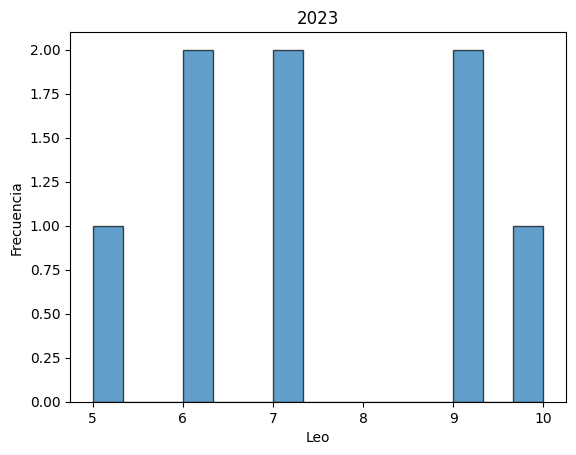

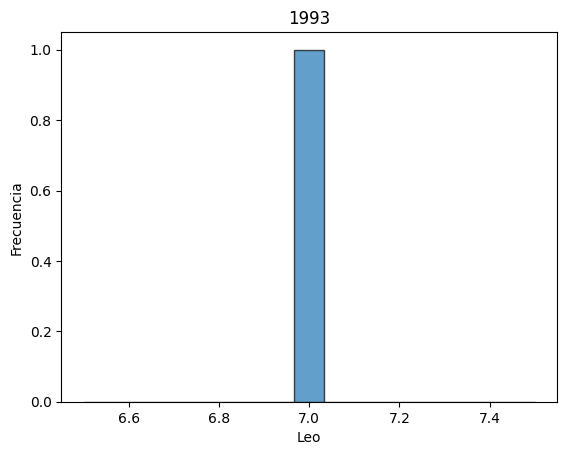

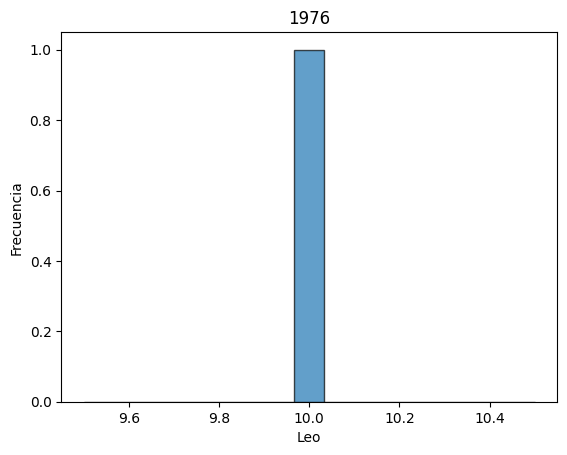

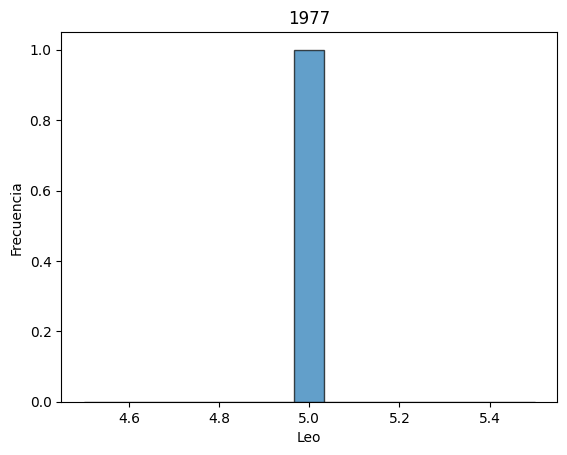

...

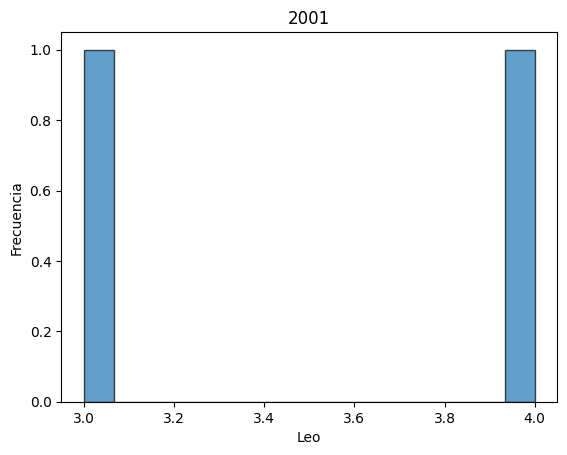

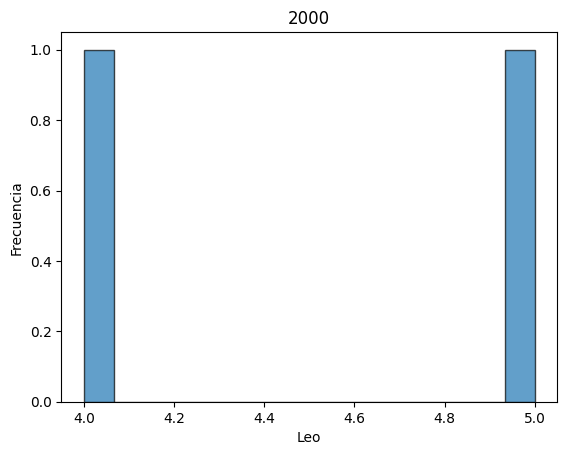

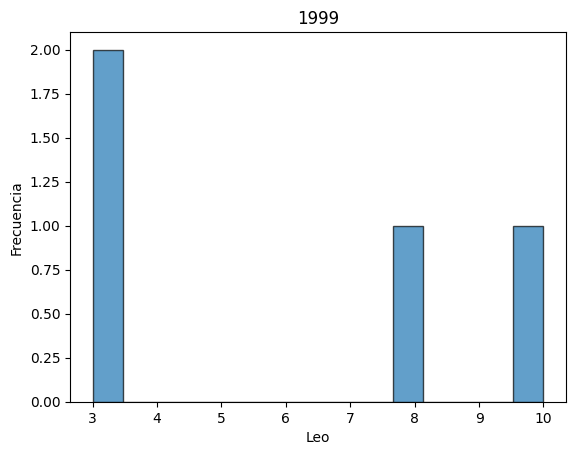

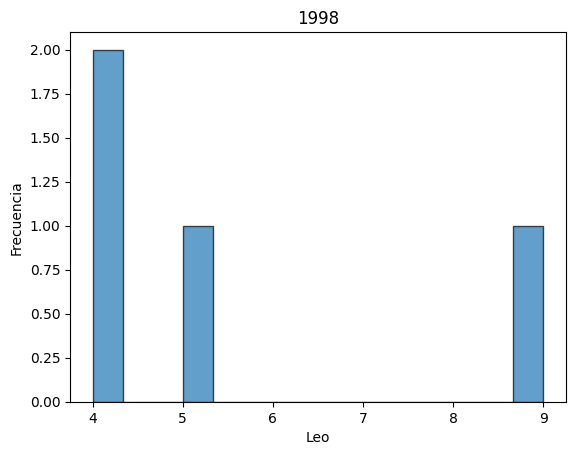

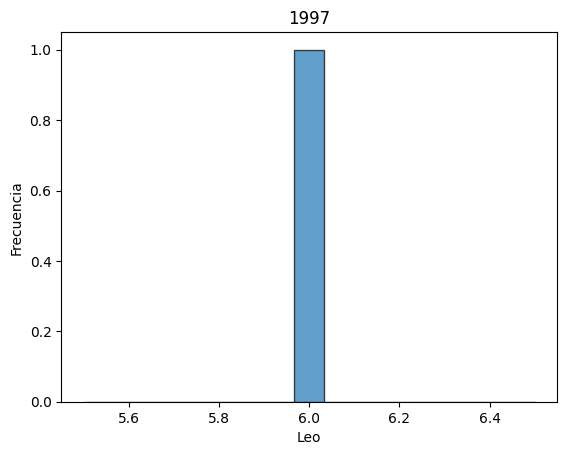

In [ ]:
#3
variable_categorica='Año'
variable_numerica='Leo'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

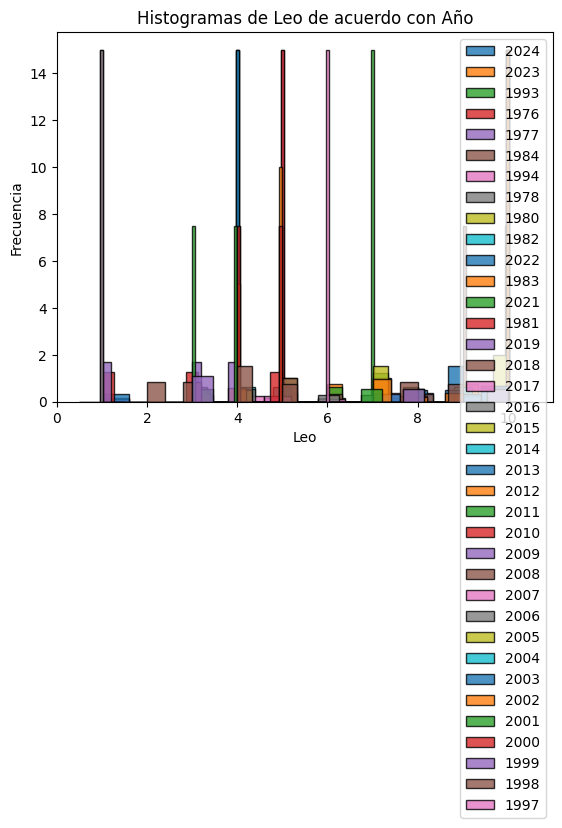

In [ ]:
#4
variable_categorica='Año'
variable_numerica='Leo'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

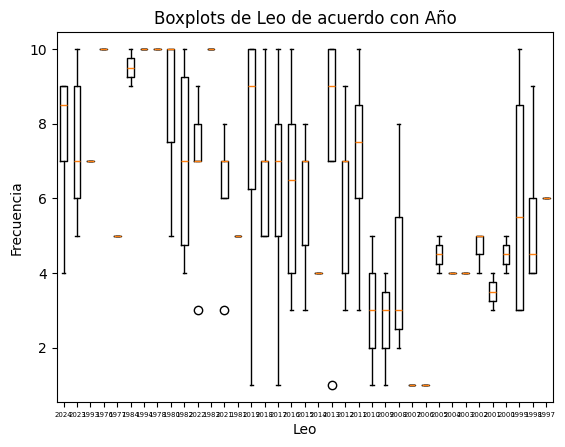

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Año'
variable_numerica = 'Leo'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Mirando las gráficas de los datos de Leo, se puede observar que tiene una alta valoración para crimen, misterio y suspenso, así como para el terror, ya que esa media supera los 9. Por otro lado, familia, romance y comedia parecen menos valorados por Leo ya que sus medias son más bajas. La variabilidad se refleja con la longitud del boxplot, ya que comedia y drama tienen muchos comentarios dispersos mientras que historia y terror son consistentes. Los histogramas muestran que Leo valora significativamente mejor una película si tiene elementos de suspenso que cuando no los tiene, pero en otras categorías tienden a estar más repartidos.


### Clasificación

In [ ]:
#1
df.groupby("Clasificacion")['Leo'].mean()

,Leo
Clasificacion,
G,1.125000
PG,4.096154
PG-13,7.047619
R,9.232558


In [ ]:
#2
df.groupby("Clasificacion")['Leo'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Clasificacion,,,,,,,,
G,1.125000,1,2,0.353553,8,1.0,1.00,1.0
PG,4.096154,3,6,0.798519,52,4.0,3.75,5.0
PG-13,7.047619,5,9,0.794873,42,7.0,7.00,7.0
R,9.232558,7,10,0.868420,43,9.0,9.00,10.0


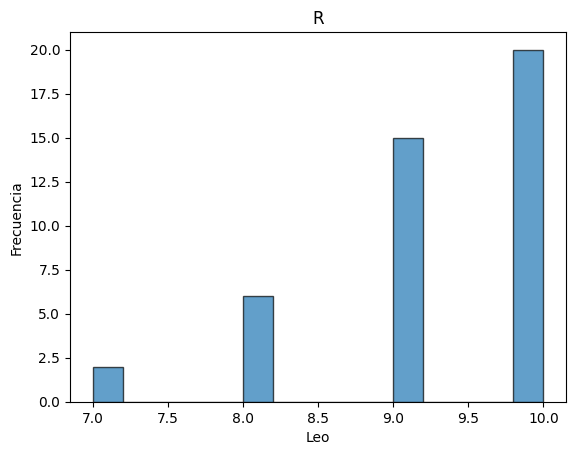

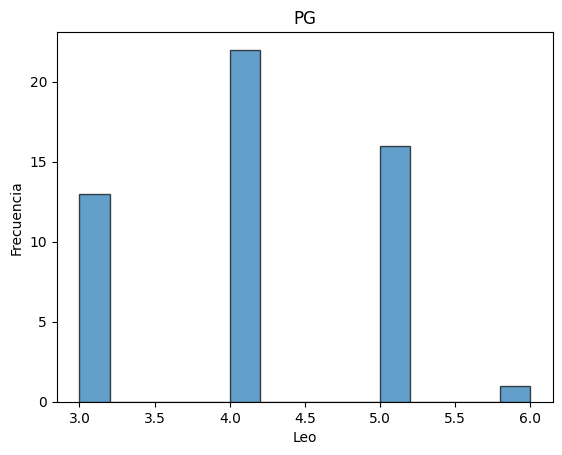

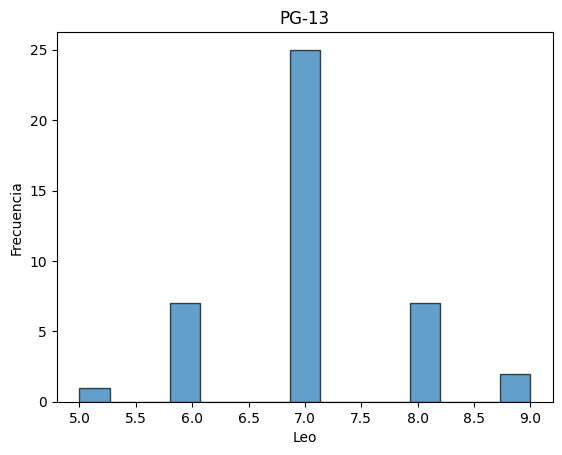

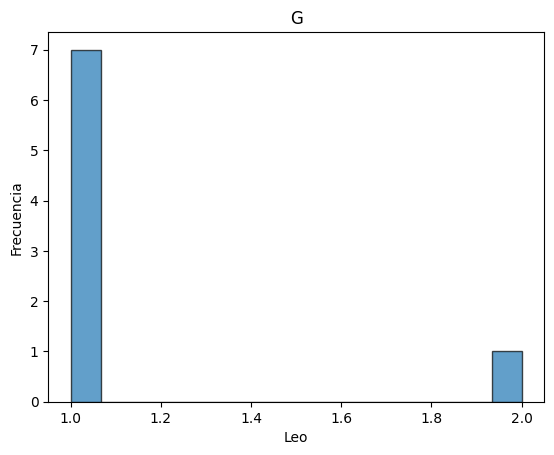

In [ ]:
#3
variable_categorica='Clasificacion'
variable_numerica='Leo'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

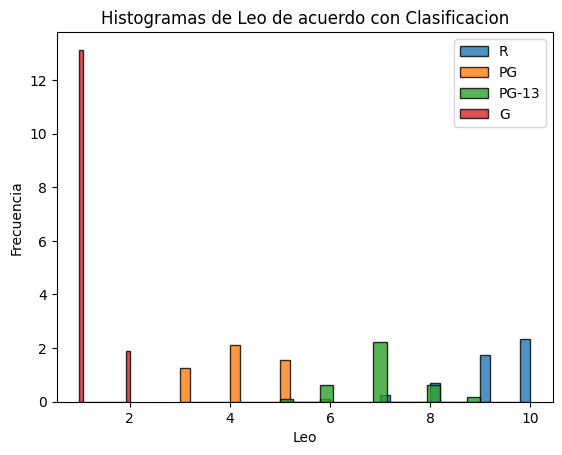

In [ ]:
#4
variable_categorica='Clasificacion'
variable_numerica='Leo'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

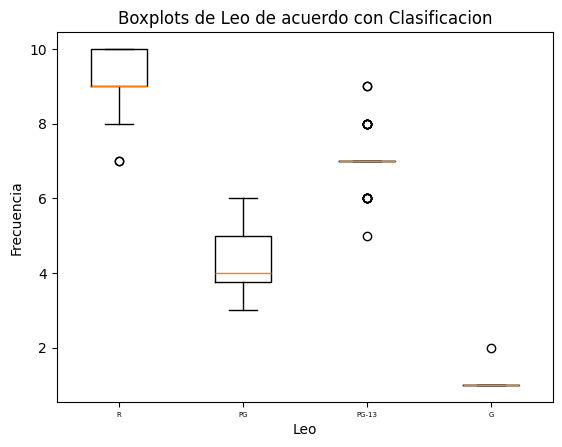

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Clasificacion'
variable_numerica = 'Leo'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Los gráficos y datos sobre la clasificación de Leo demuestran una tendencia clara en sus preferencias por las películas. Las películas clasificadas como “R” son las mejor valoradas por Leo, con una media de 9.23 y una alta consistencia en las puntuaciones; esto se refleja en la mediana de 9 en lugar de 10. Tras ellas le acompañan las clasificadas como “PG-13”, con una media de 7.05 que Schált presenta asimismo valoración positiva. Las películas “PG” y “G”, por otro lado, tienen una media 1.10, y por otra, 1.13. Esto es, Leo les otorga peores puntuaciones, reflejando que no le parecen de tan buena calidad. En resumen, Leo tiende a dar calificaciones más bajas a las películas para audiencias más jóvenes y apreciar las más adultas.


### Animación

In [ ]:
#1
df.groupby("Animacion")['Leo'].mean()

,Leo
Animacion,
no,7.327273
si,3.114286


In [ ]:
#2
df.groupby("Animacion")['Leo'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Animacion,,,,,,,,
no,7.327273,3,10,1.982071,110,7.0,6.0,9.0
si,3.114286,1,5,1.231246,35,3.0,3.0,4.0


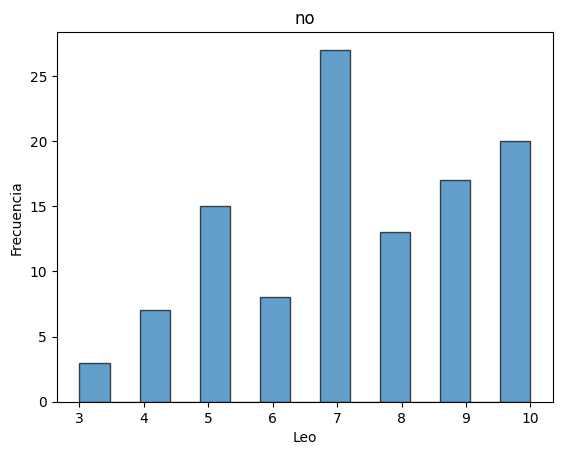

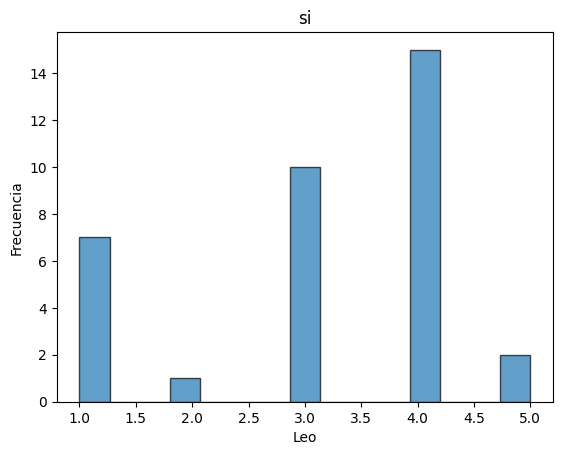

In [ ]:
#3
variable_categorica='Animacion'
variable_numerica='Leo'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

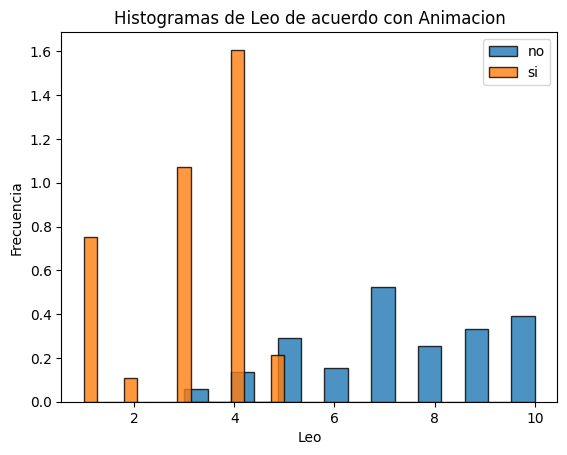

In [ ]:
#4
variable_categorica='Animacion'
variable_numerica='Leo'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

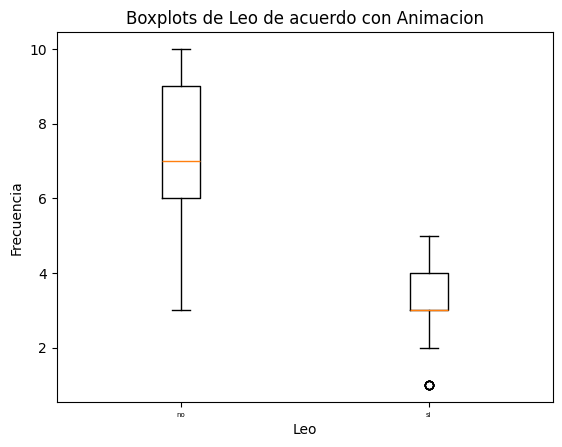

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Animacion'
variable_numerica = 'Leo'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Leo prefiere las películas no animadas, mostrando una marcada preferencia cuantitativa por películas con puntuaciones más altas en esta categoría, con un promedio de 7.33. En contraste, las películas animadas tienen una calificación promedio de 3.11, considerablemente más baja. Los diagramas de caja respaldan esta observación, mostrando que las películas no animadas tienen un rango de puntuaciones más amplio y alto en general. La preferencia de Leo se enfoca en producciones más serias o maduras, descartando en gran medida la animación.


### Duración

In [ ]:
#1
df.groupby("Duracion")['Leo'].mean()

,Leo
Duracion,
78,4.000000
83,7.000000
86,4.000000
88,4.000000
90,3.666667
...,...
180,9.000000
181,8.000000
189,10.000000


In [ ]:
#2
df.groupby("Duracion")['Leo'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Duracion,,,,,,,,
78,4.000000,4,4,NaN,1,4.0,4.0,4.0
83,7.000000,7,7,NaN,1,7.0,7.0,7.0
86,4.000000,4,4,NaN,1,4.0,4.0,4.0
88,4.000000,4,4,NaN,1,4.0,4.0,4.0
90,3.666667,3,4,0.577350,3,4.0,3.5,4.0
...,...,...,...,...,...,...,...,...
180,9.000000,9,9,NaN,1,9.0,9.0,9.0
181,8.000000,7,9,1.414214,2,8.0,7.5,8.5
189,10.000000,10,10,NaN,1,10.0,10.0,10.0


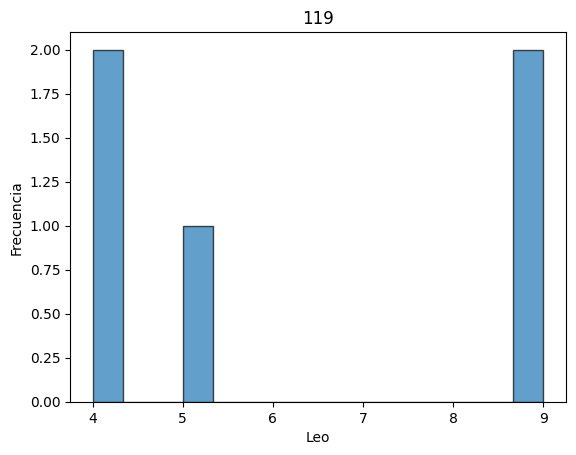

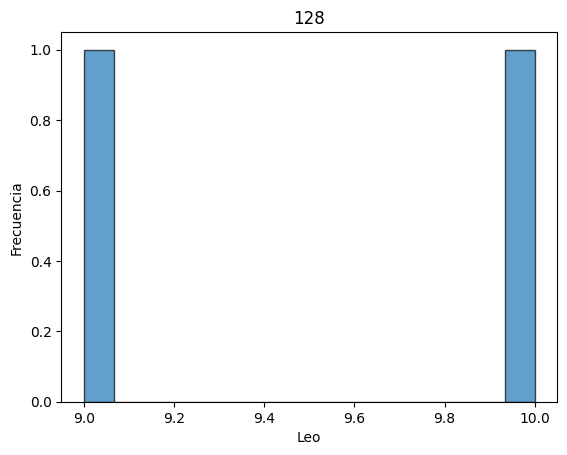

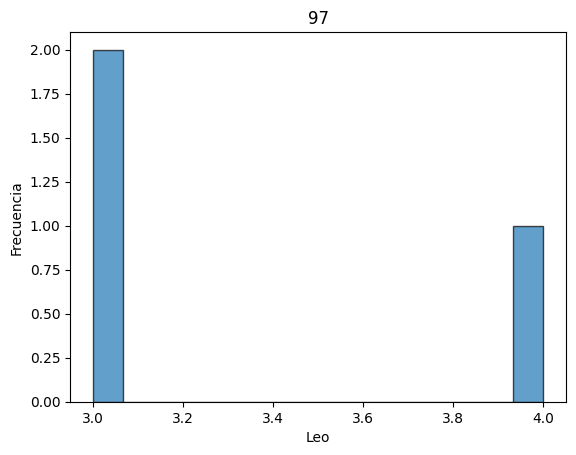

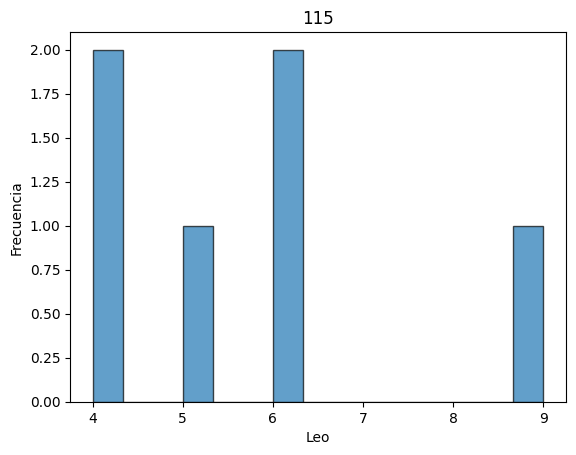

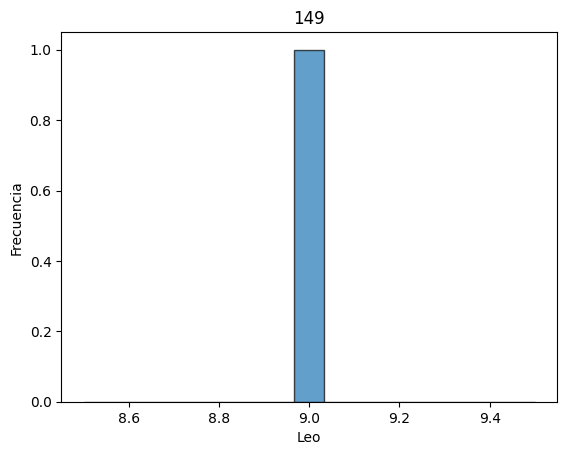

...

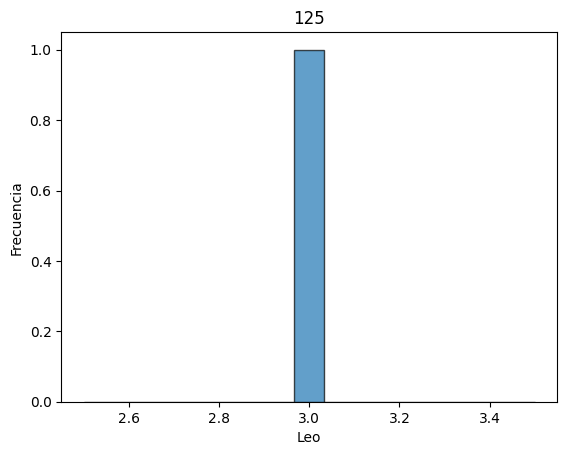

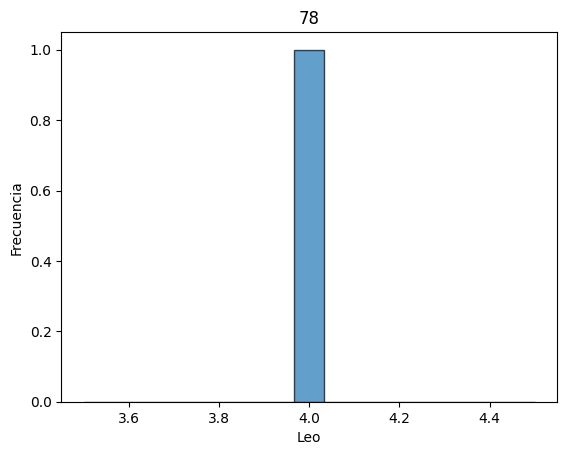

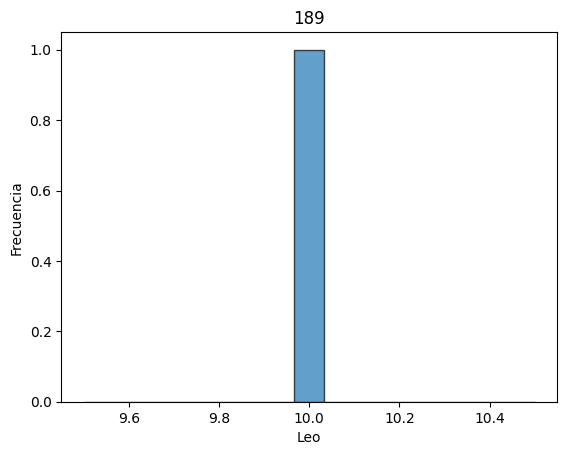

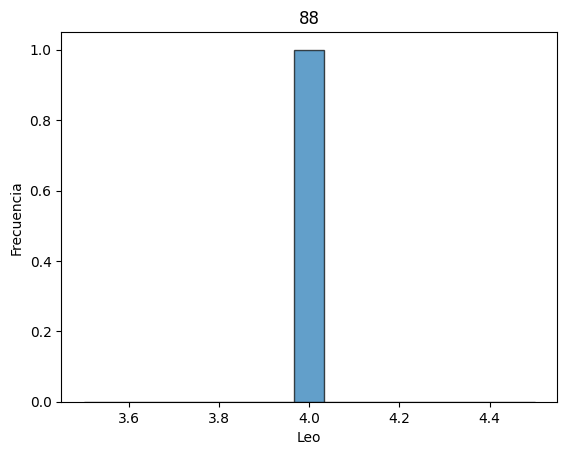

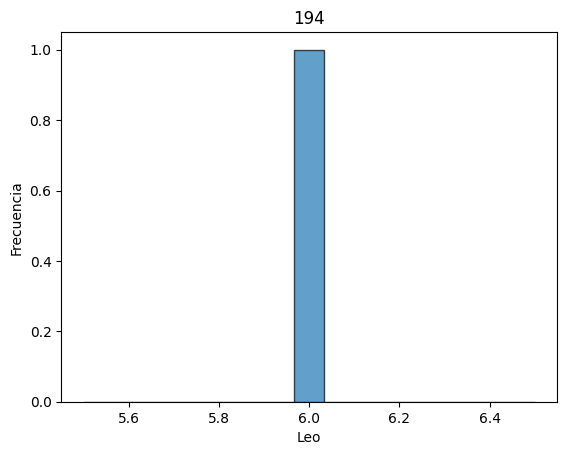

In [ ]:
#3
variable_categorica='Duracion'
variable_numerica='Leo'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

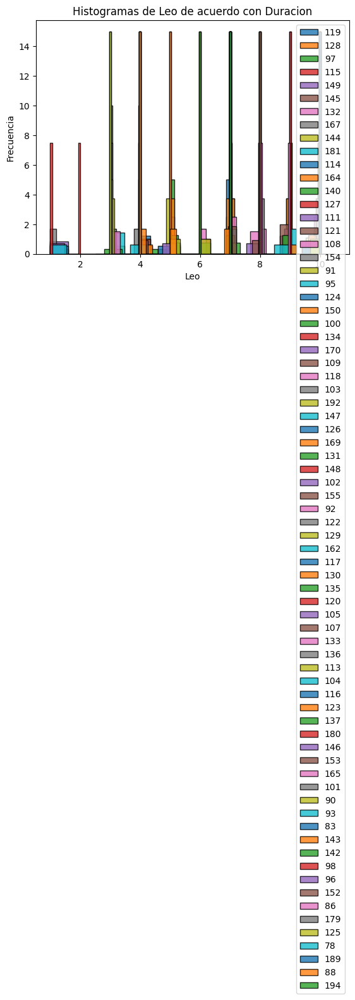

In [ ]:
#4
variable_categorica='Duracion'
variable_numerica='Leo'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

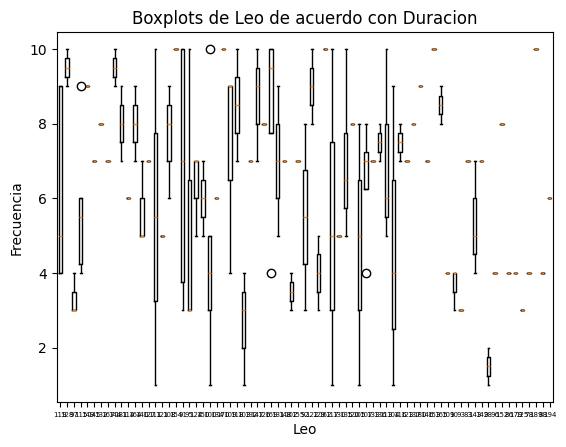

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Duracion'
variable_numerica = 'Leo'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Ahora, Leo tiende a preferir las películas de un metraje más largo, cuanto mayor es la duración de una película, mejor es la puntuación colocada. Teniendo en cuenta esta gráfica podemos observar que Leo tiende a valorar con mayor puntuación las películas que cuentan con un mayor contenido, aunque a lo largo de la gráfica se evidencia que existen algunas puntuaciones bajas para películas de mayor duración, la variabilidad en los puntos sugiere que quizá existan films cortos que les han gustado pero en general les agrada mucho las películas con un mayor duración.


### Criticos

In [ ]:
#1
df.groupby("Criticos")['Leo'].mean()

,Leo
Criticos,
5.3,8.000000
5.5,4.000000
5.6,5.500000
5.7,5.000000
6.0,6.500000
6.2,10.000000
6.4,4.000000
6.5,9.000000
6.6,8.333333


In [ ]:
#2
df.groupby("Criticos")['Leo'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Criticos,,,,,,,,
5.3,8.000000,8,8,NaN,1,8.0,8.00,8.00
5.5,4.000000,4,4,NaN,1,4.0,4.00,4.00
5.6,5.500000,4,7,2.121320,2,5.5,4.75,6.25
5.7,5.000000,5,5,NaN,1,5.0,5.00,5.00
6.0,6.500000,6,7,0.707107,2,6.5,6.25,6.75
6.2,10.000000,10,10,NaN,1,10.0,10.00,10.00
6.4,4.000000,4,4,NaN,1,4.0,4.00,4.00
6.5,9.000000,9,9,NaN,1,9.0,9.00,9.00
6.6,8.333333,5,10,2.886751,3,10.0,7.50,10.00


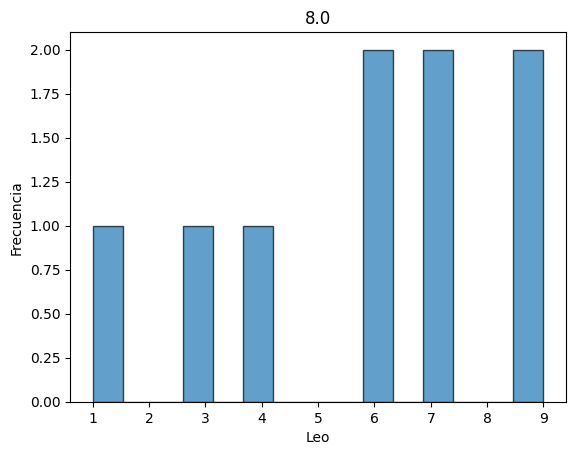

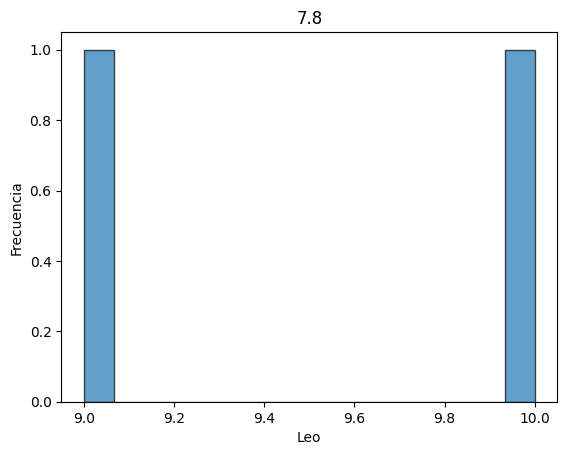

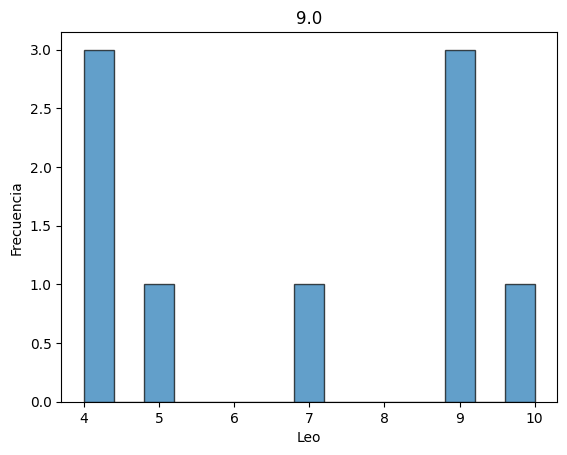

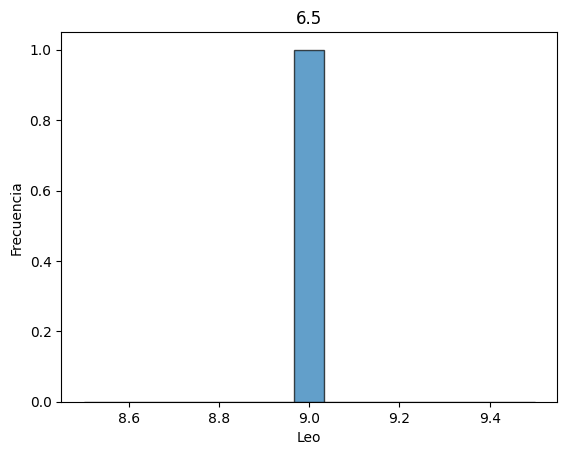

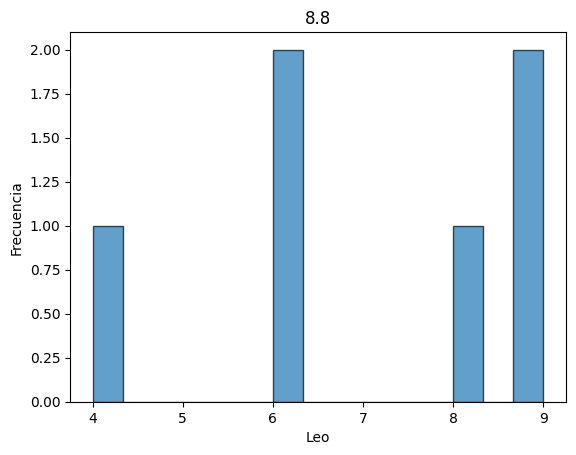

...

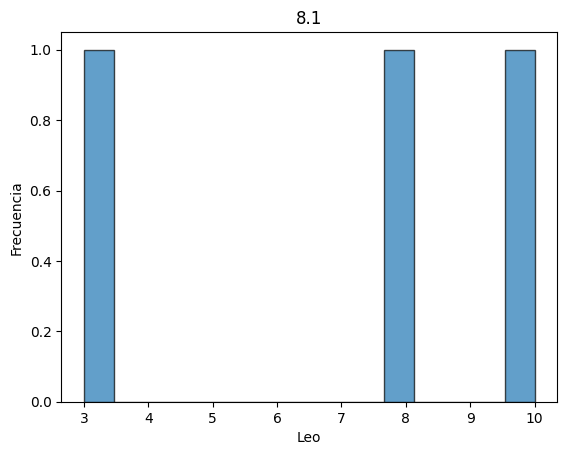

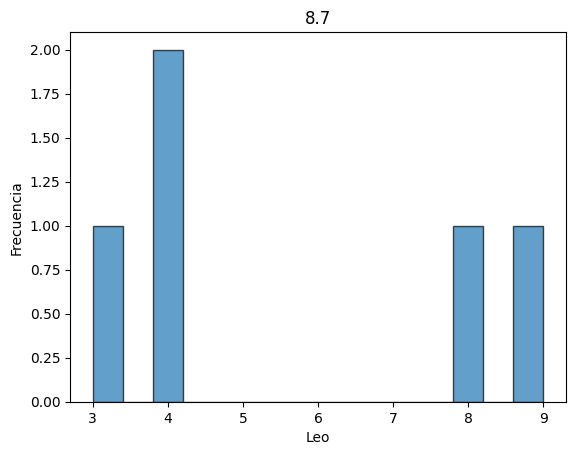

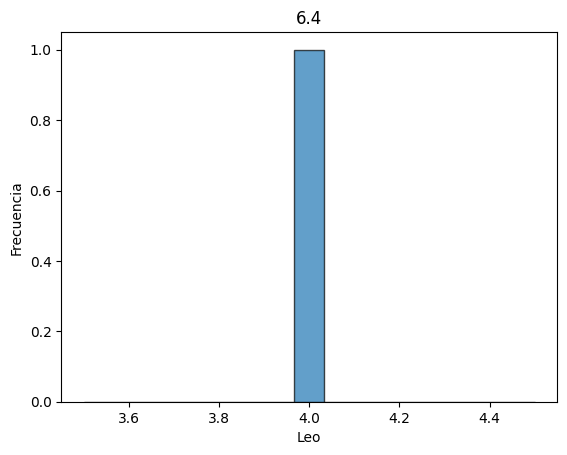

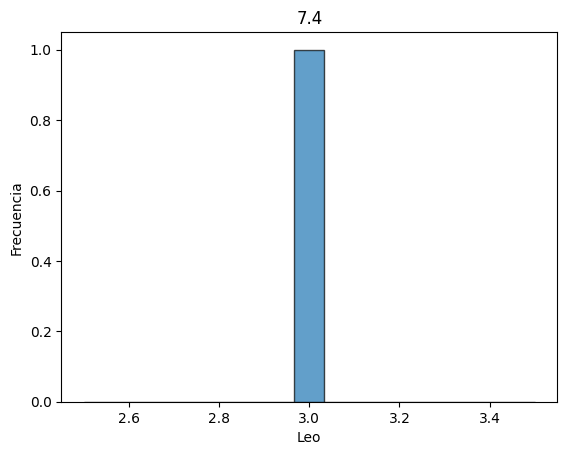

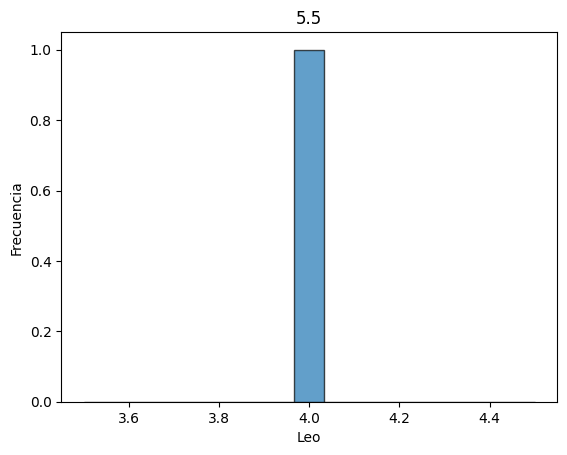

In [ ]:
#3
variable_categorica='Criticos'
variable_numerica='Leo'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

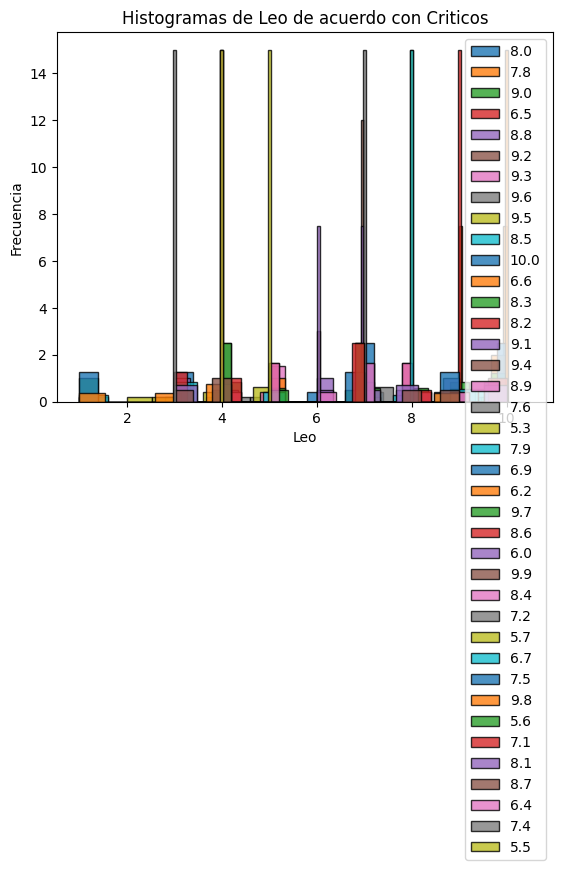

In [ ]:
#4
variable_categorica='Criticos'
variable_numerica='Leo'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

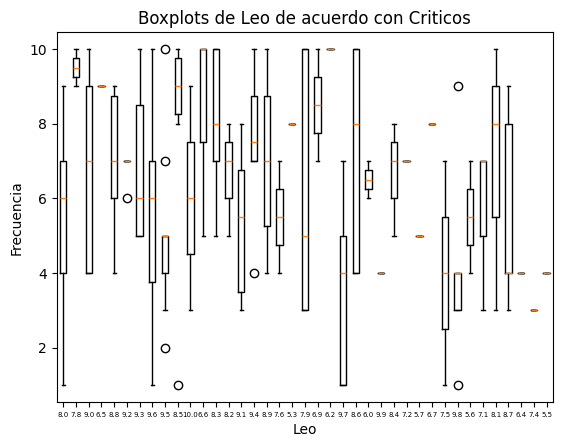

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Criticos'
variable_numerica = 'Leo'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

La clasificación comparativa entre los puntajes de Leo y los críticos se puede ver que hay desacuerdos significativos entre los profesionales y Leo en otros aspectos. Leo tiene una tendencia a puntuar las películas más altas que en general no atraen a los críticos, lo que sugiere que les gusta apreciar las películas que podrían ser diferentes por la crítica. Mientras tanto, los críticos son más uniformes en cuanto a los resultados de su análisis real; Leo es más diversos y muestra preferencias particulares en sus opiniones. Esto indica que su apreciación personal no coincide con las opiniones en general de la crítica


### Audiencia

In [ ]:
#1
df.groupby("Audiencia")['Leo'].mean()

,Leo
Audiencia,
5.4,8.000000
5.6,4.000000
5.8,7.000000
6.0,7.500000
6.2,5.500000
6.4,9.000000
6.6,7.200000
6.8,4.625000
7.0,5.727273


In [ ]:
#2
df.groupby("Audiencia")['Leo'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Audiencia,,,,,,,,
5.4,8.000000,8,8,NaN,1,8.0,8.00,8.00
5.6,4.000000,4,4,NaN,1,4.0,4.00,4.00
5.8,7.000000,4,10,3.000000,3,7.0,5.50,8.50
6.0,7.500000,6,10,1.732051,4,7.0,6.75,7.75
6.2,5.500000,4,7,2.121320,2,5.5,4.75,6.25
6.4,9.000000,9,9,NaN,1,9.0,9.00,9.00
6.6,7.200000,7,8,0.447214,5,7.0,7.00,7.00
6.8,4.625000,1,10,2.973094,8,5.0,2.50,6.00
7.0,5.727273,3,10,2.284334,11,5.0,4.00,7.50


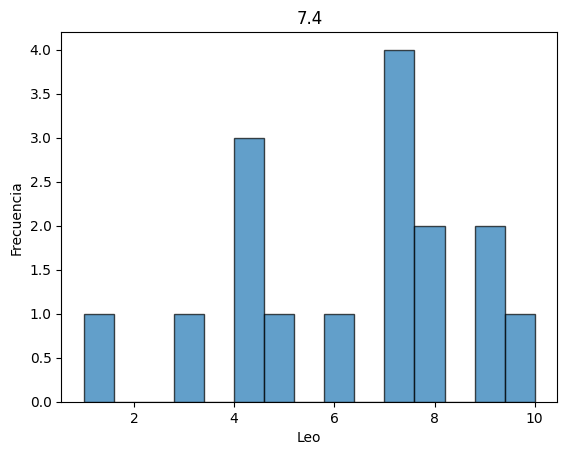

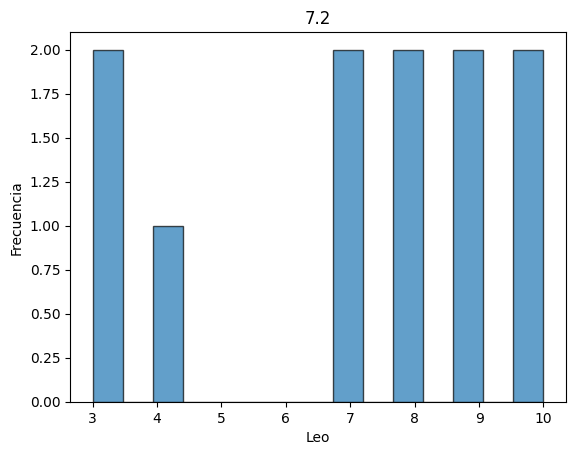

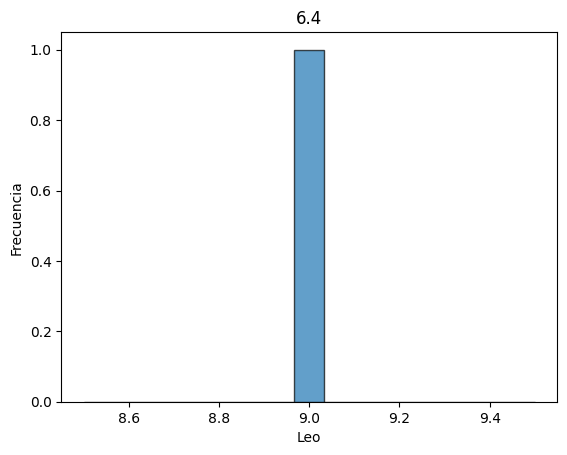

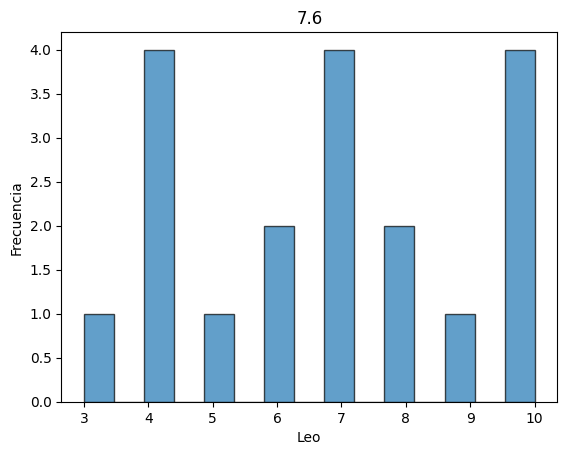

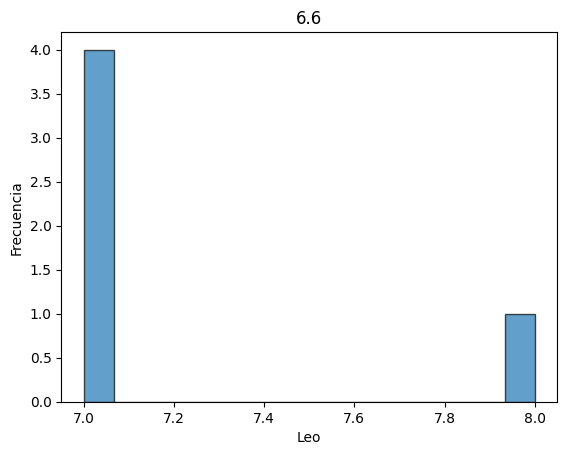

...

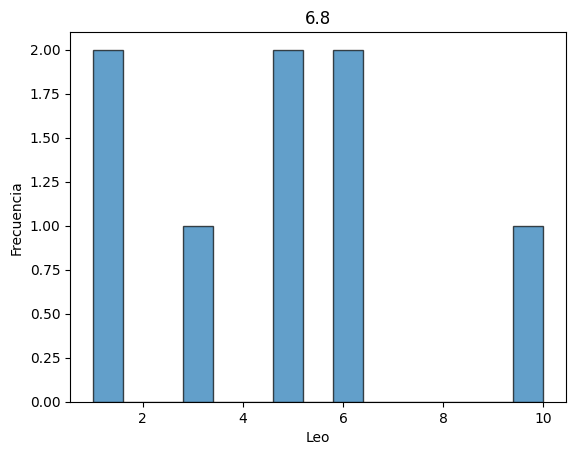

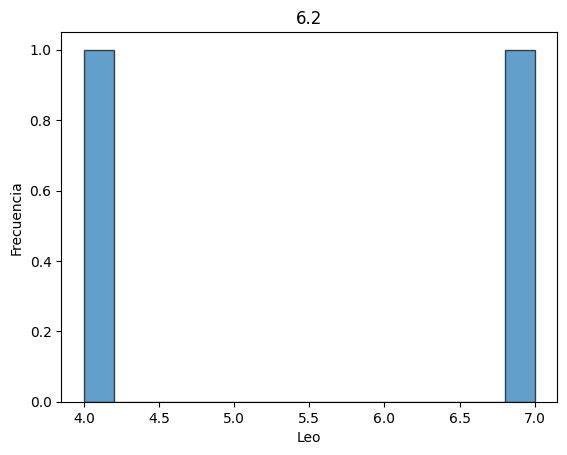

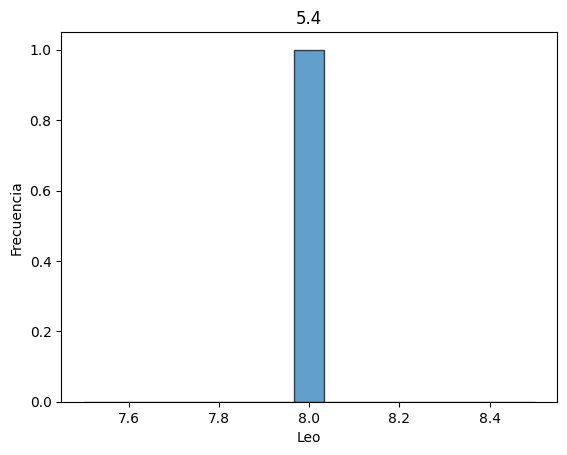

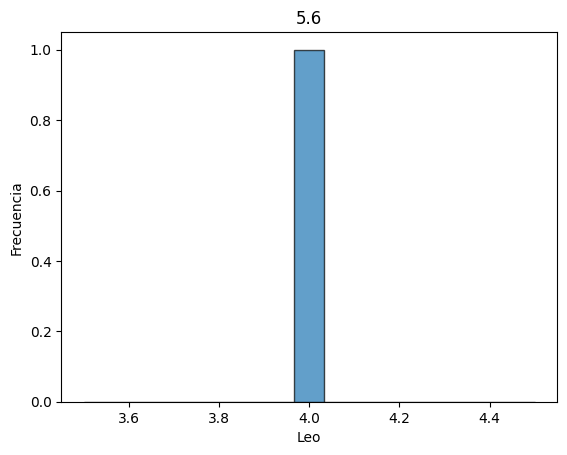

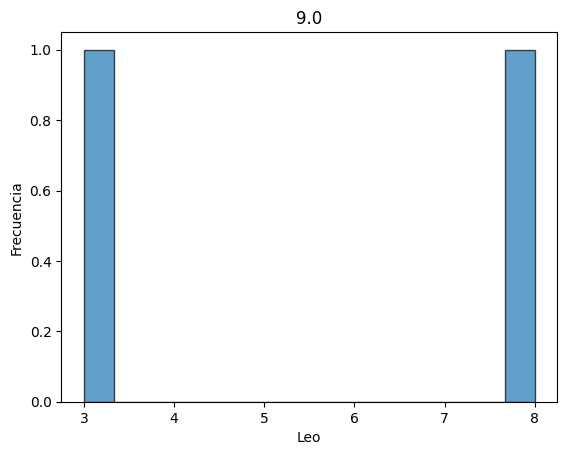

In [ ]:
#3
variable_categorica='Audiencia'
variable_numerica='Leo'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

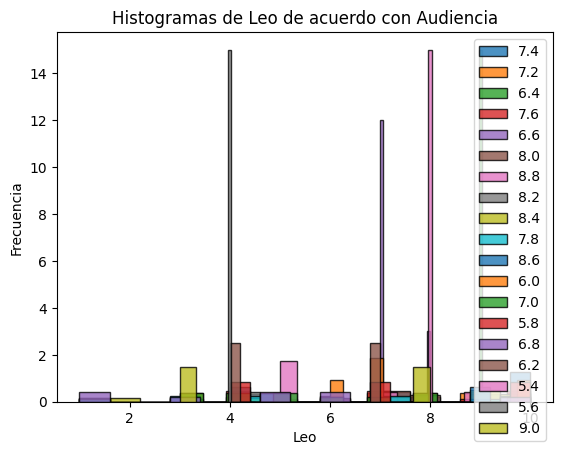

In [ ]:
#4
variable_categorica='Audiencia'
variable_numerica='Leo'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

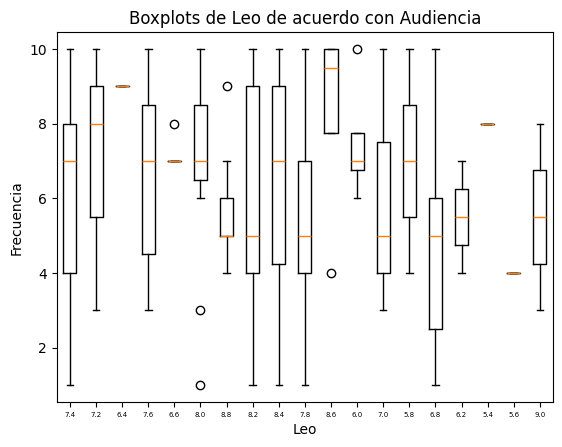

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Audiencia'
variable_numerica = 'Leo'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Lo que se puede ver a partir de los datos es que Leo presenta un patrón de calificaciones en gran parte basado en las opiniones de la audiencia, aunque algo variable. A pesar de que da calificaciones altas a muchas de las mismas películas que la audiencia, el rango de sus calificaciones es más amplio y diverso. Por lo tanto, uno puede concluir que, si bien Leo a menudo se alinea con la percepción común, su propio juicio a menudo introduce pequeños cambios, haciendo que las calificaciones sean más cambiantes y menos uniformes que las de la audiencia en su conjunto.


## Nayibe

### Genero

In [ ]:
#1
df.groupby("Genero")['Nayibe'].mean()

,Nayibe
Genero,
Acción,3.380952
Aventura,6.823529
Ciencia Ficción,4.684211
Comedia,6.333333
Crimen,2.750000
Drama,4.611111
Familia,8.733333
Fantasia,8.166667
Guerra,4.000000


In [ ]:
#2
df.groupby("Genero")['Nayibe'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Genero,,,,,,,,
Acción,3.380952,1,6,1.203170,21,4.0,2.00,4.00
Aventura,6.823529,5,10,1.424574,17,7.0,6.00,8.00
Ciencia Ficción,4.684211,2,10,2.029029,19,4.0,4.00,5.00
Comedia,6.333333,2,10,2.275186,18,7.0,5.25,8.00
Crimen,2.750000,1,5,1.488048,8,2.5,1.75,4.00
Drama,4.611111,2,7,2.145827,18,5.0,2.00,6.75
Familia,8.733333,8,10,0.883715,15,8.0,8.00,9.50
Fantasia,8.166667,8,9,0.408248,6,8.0,8.00,8.00
Guerra,4.000000,4,4,NaN,1,4.0,4.00,4.00


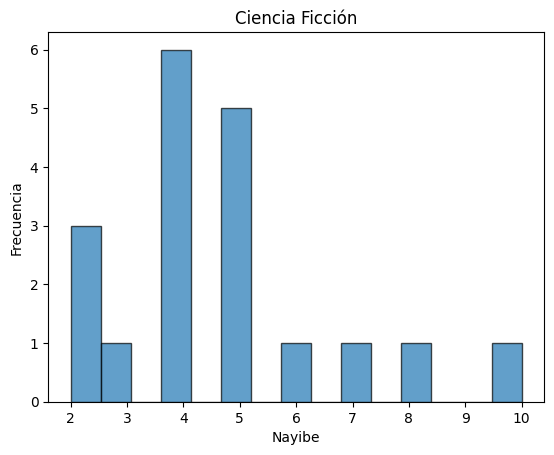

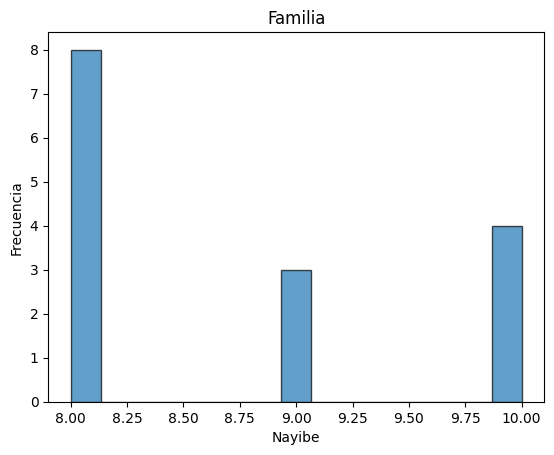

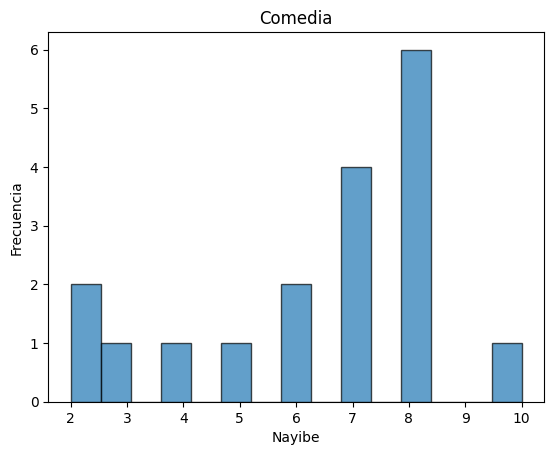

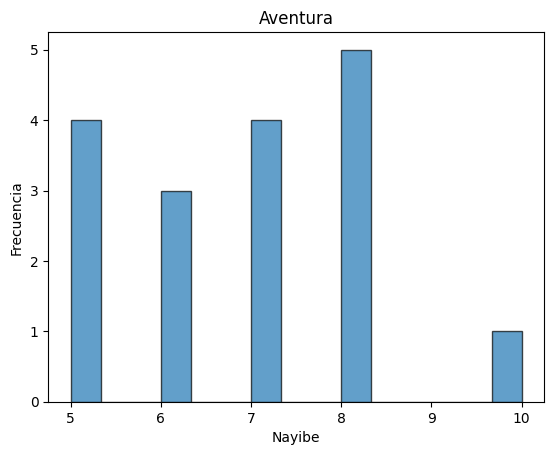

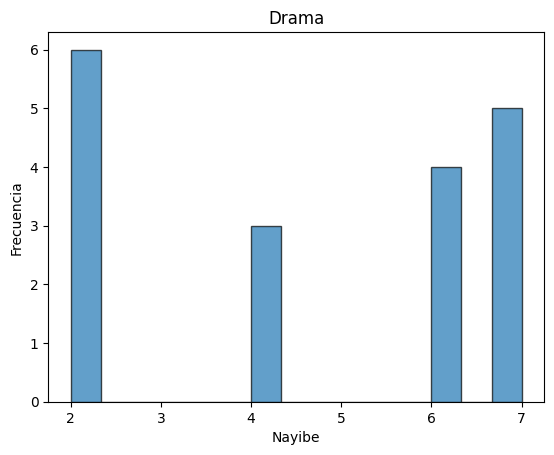

...

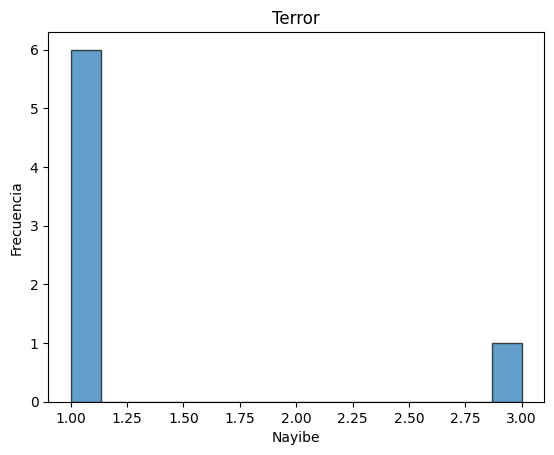

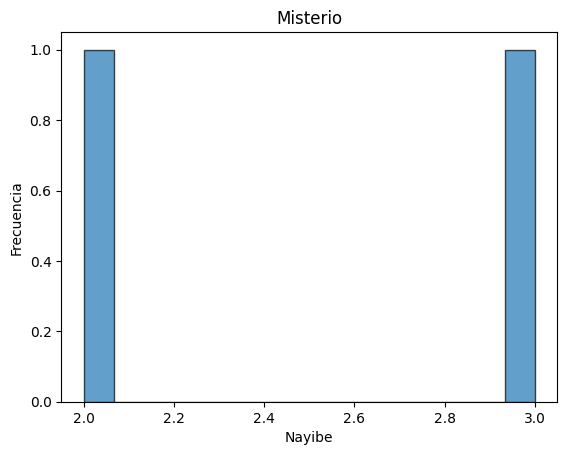

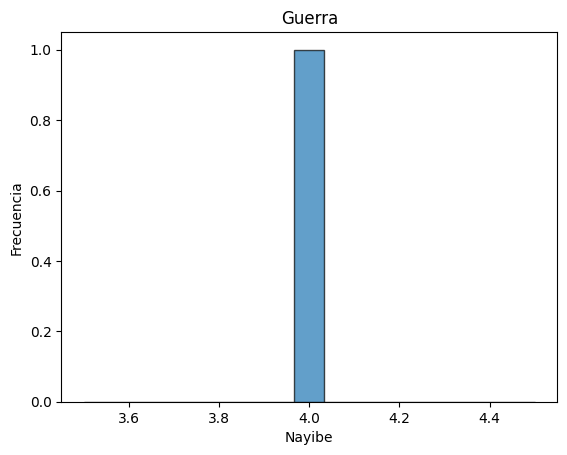

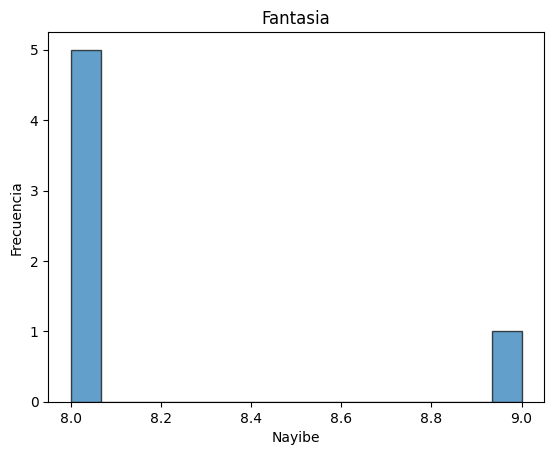

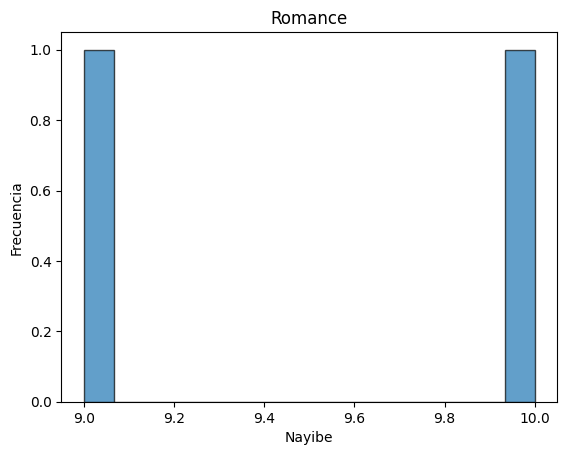

In [ ]:
#3
variable_categorica='Genero'
variable_numerica='Nayibe'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

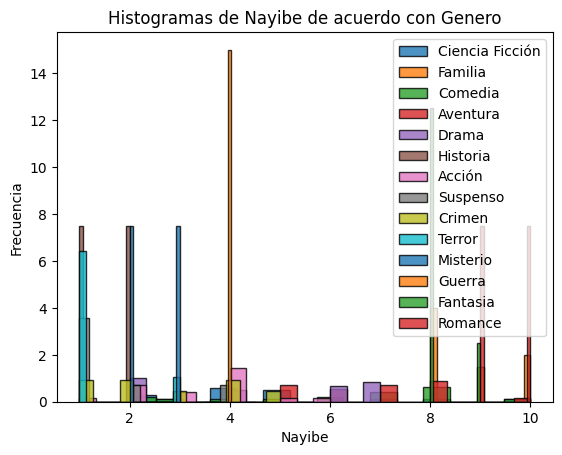

In [ ]:
#4
variable_categorica='Genero'
variable_numerica='Nayibe'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

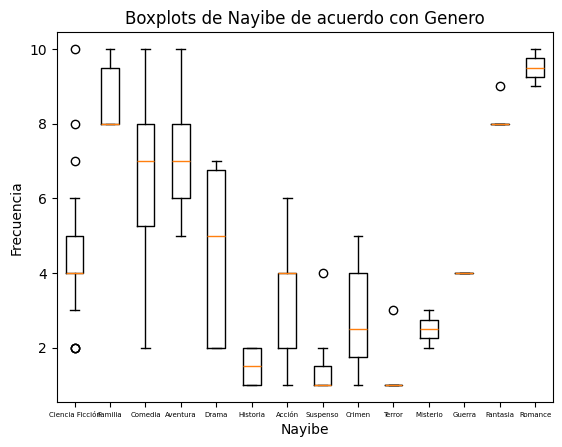

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Genero'
variable_numerica = 'Nayibe'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Despues de ver los datos podemos ver que en promedio el genero que mas le gusta a Nayibe es el romance con un promedio de 9  y despues la familia con promedio de 8.  Elgenero que menos es el de terror con un promedio de menos de 2, la pelicula calificada mas alta de terro llegó solo a una calificación de 6


### Subgenero

In [ ]:
#1
df.groupby("Subgenero")['Nayibe'].mean()

,Nayibe
Subgenero,
Acción,4.000000
Aventura,6.600000
Ciencia Ficción,4.800000
Comedia,4.272727
Crimen,2.000000
Drama,4.692308
Familia,8.562500
Fantasia,7.555556
Guerra,2.800000


In [ ]:
#2
df.groupby("Subgenero")['Nayibe'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Subgenero,,,,,,,,
Acción,4.000000,1,6,1.591645,16,4.0,3.50,5.25
Aventura,6.600000,4,8,1.632993,25,7.0,5.00,8.00
Ciencia Ficción,4.800000,2,7,1.740279,15,5.0,4.00,6.50
Comedia,4.272727,2,10,2.866737,11,3.0,2.00,6.00
Crimen,2.000000,1,3,0.755929,8,2.0,1.75,2.25
Drama,4.692308,2,7,2.097006,13,4.0,3.00,7.00
Familia,8.562500,6,10,1.152895,16,8.0,8.00,10.00
Fantasia,7.555556,4,10,2.068279,9,8.0,6.00,9.00
Guerra,2.800000,1,6,2.167948,5,2.0,1.00,4.00


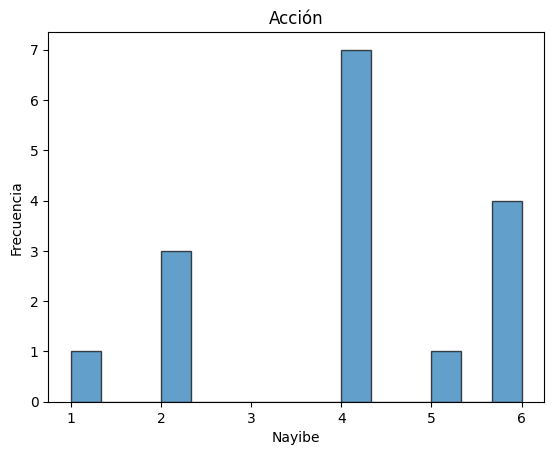

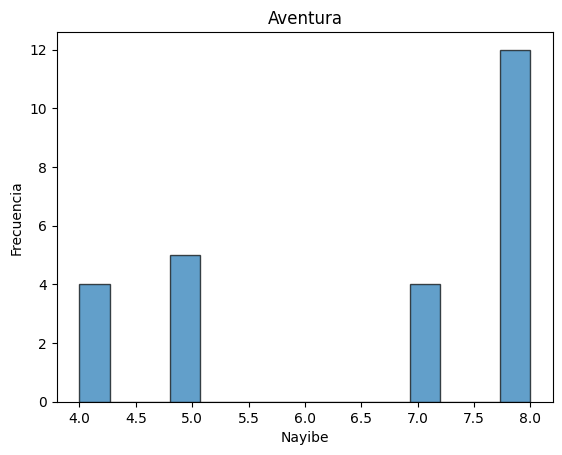

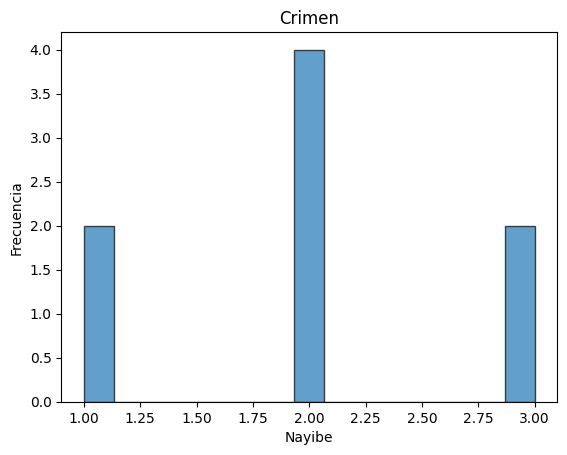

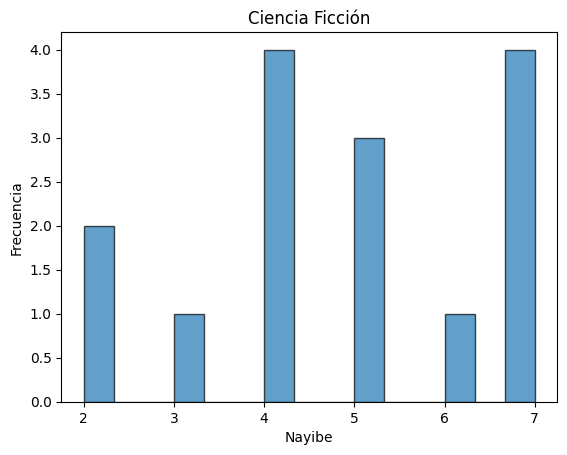

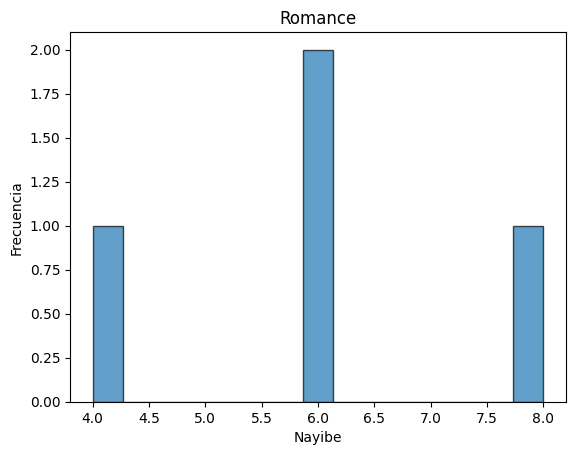

...

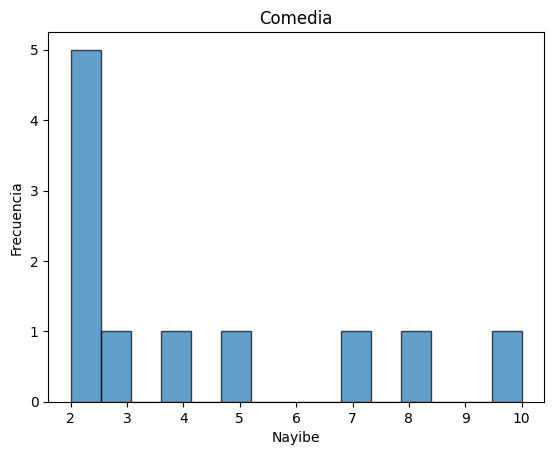

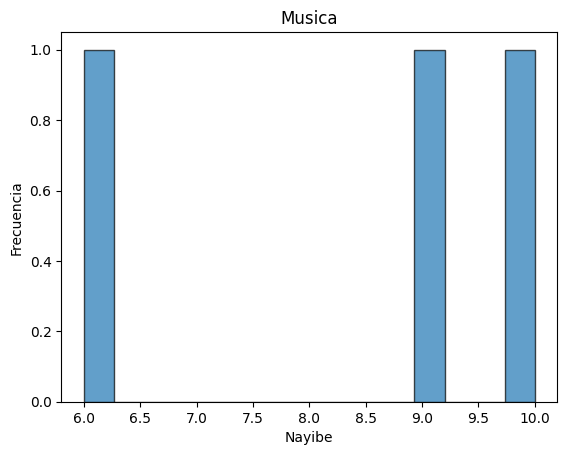

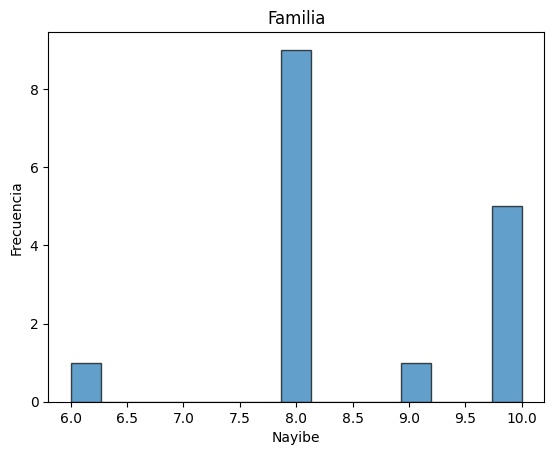

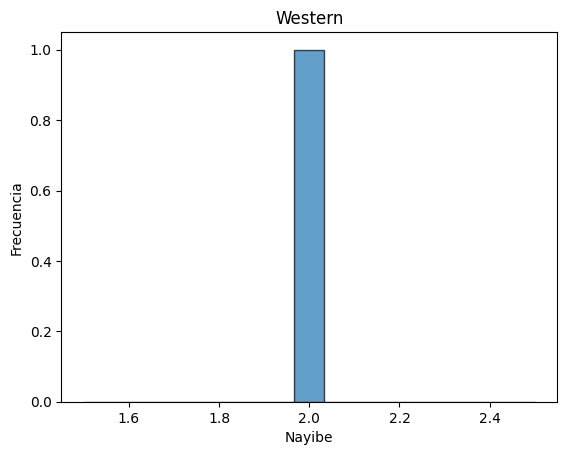

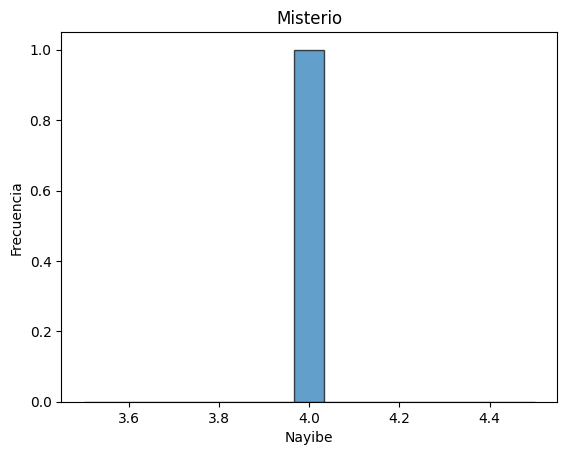

In [ ]:
#3
variable_categorica='Subgenero'
variable_numerica='Nayibe'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

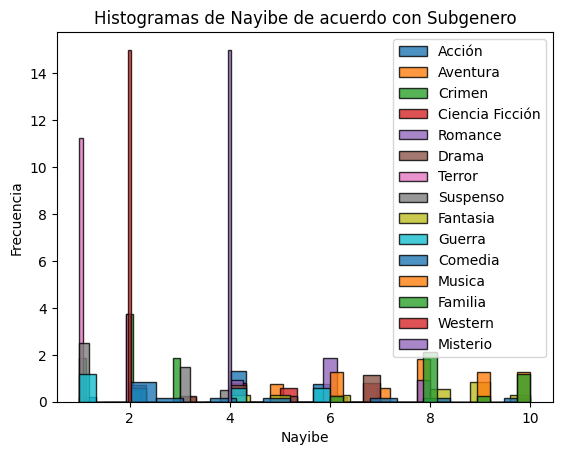

In [ ]:
#4
variable_categorica='Subgenero'
variable_numerica='Nayibe'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

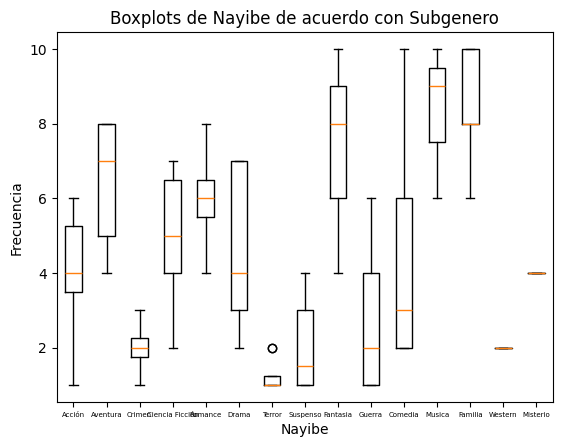

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Subgenero'
variable_numerica = 'Nayibe'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

El subgenero mas alto en calificación es musica con promedio cercano a 9 y seguido por fantasia y familia muy de cerca con un promedio cerano a 8, el subgenero que mas bajo calificó Nayibe es otra vez terror


### Año

In [ ]:
#1
df.groupby("Año")['Nayibe'].mean()

,Nayibe
Año,
1976,1.000000
1977,7.000000
1978,1.000000
1980,2.666667
1981,6.000000
1982,5.000000
1983,2.000000
1984,1.500000
1993,5.000000


In [ ]:
#2
df.groupby("Año")['Nayibe'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Año,,,,,,,,
1976,1.000000,1,1,NaN,1,1.0,1.00,1.00
1977,7.000000,7,7,NaN,1,7.0,7.00,7.00
1978,1.000000,1,1,NaN,1,1.0,1.00,1.00
1980,2.666667,1,6,2.886751,3,1.0,1.00,3.50
1981,6.000000,6,6,NaN,1,6.0,6.00,6.00
1982,5.000000,2,8,2.943920,4,5.0,2.75,7.25
1983,2.000000,2,2,NaN,1,2.0,2.00,2.00
1984,1.500000,1,2,0.707107,2,1.5,1.25,1.75
1993,5.000000,5,5,NaN,1,5.0,5.00,5.00


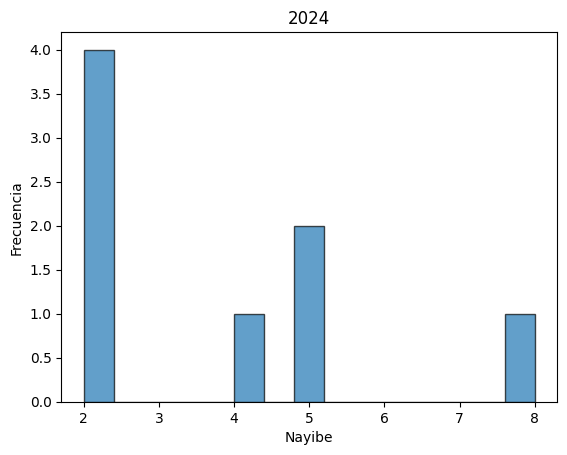

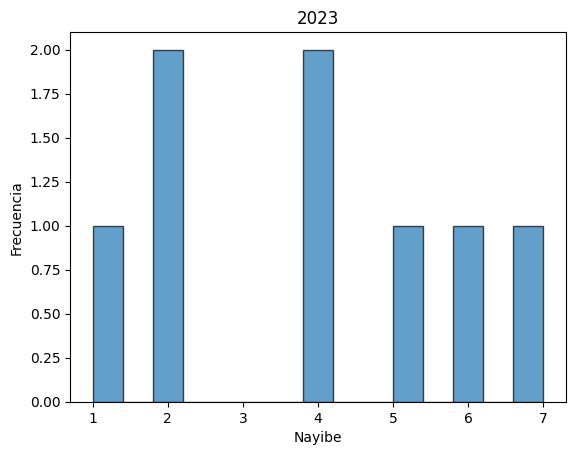

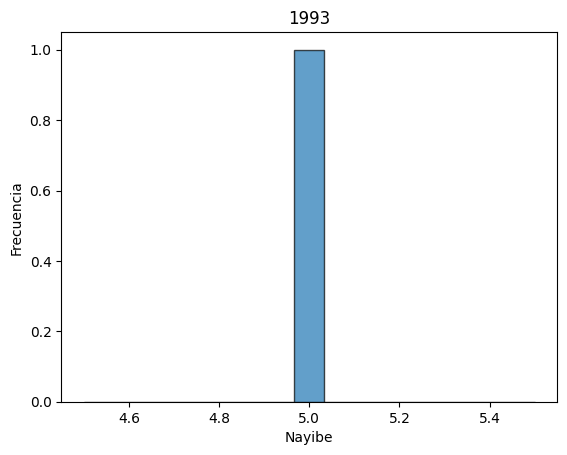

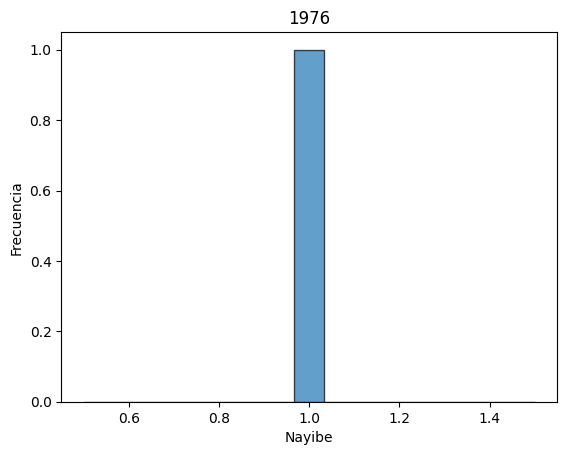

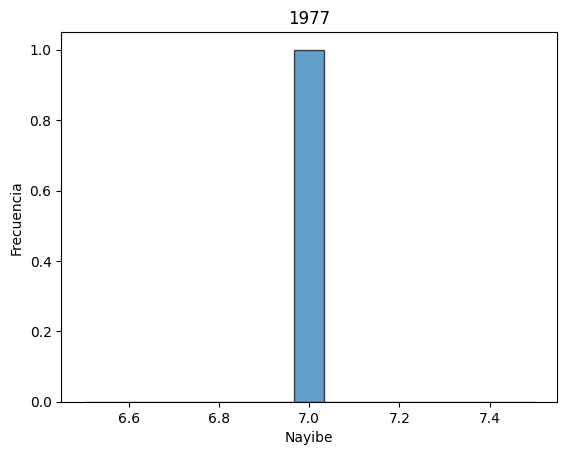

...

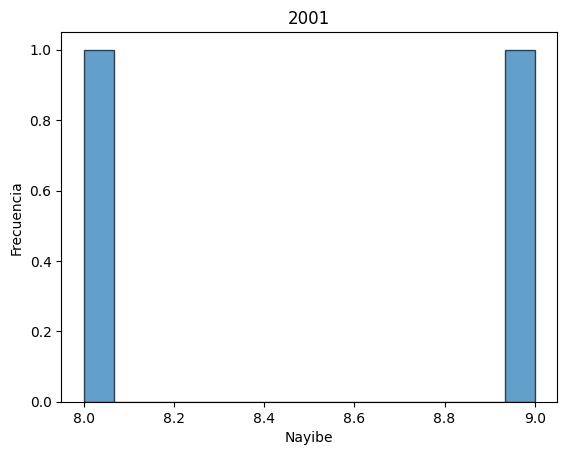

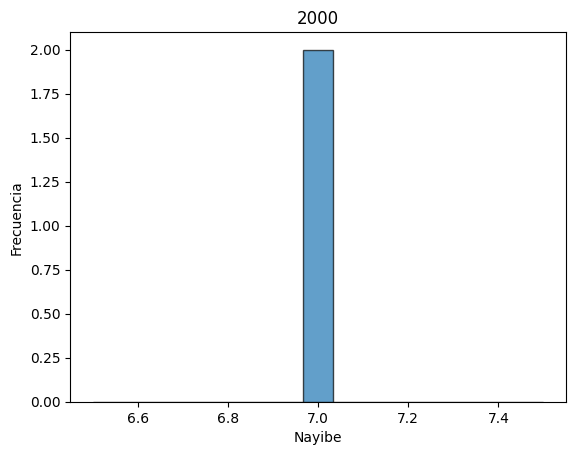

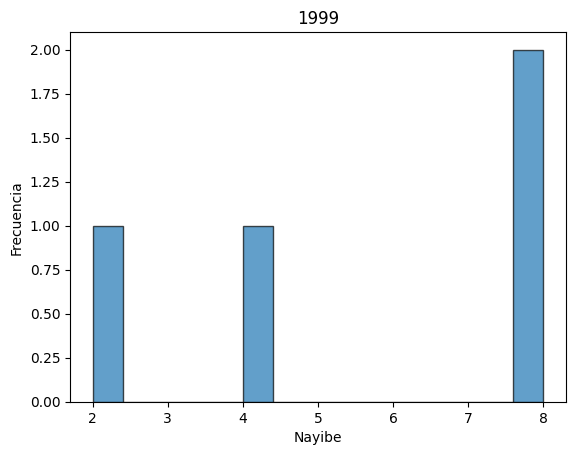

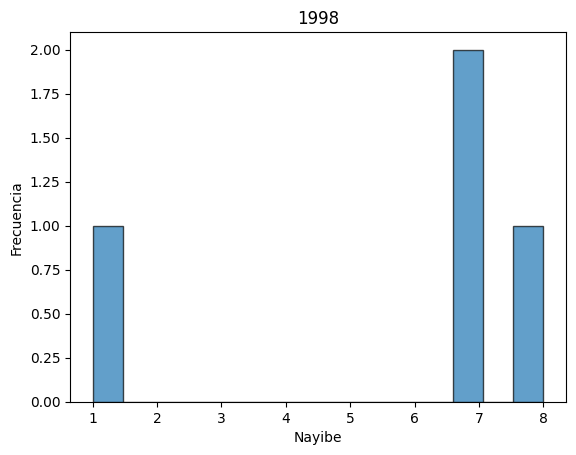

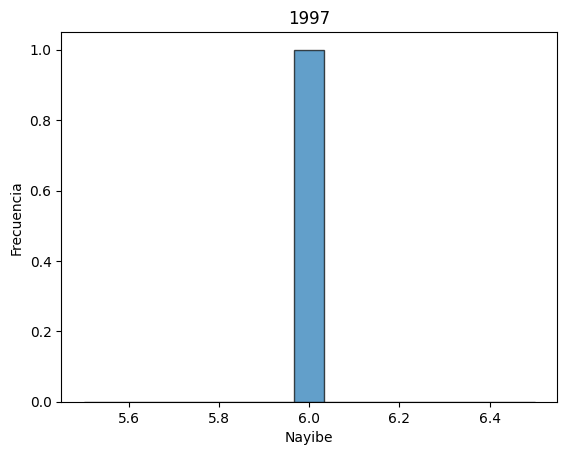

In [ ]:
#3
variable_categorica='Año'
variable_numerica='Nayibe'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

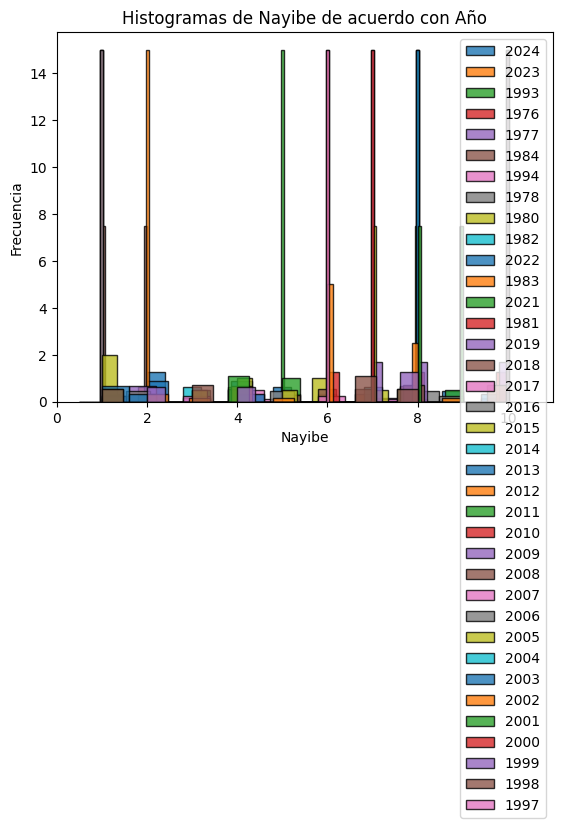

In [ ]:
#4
variable_categorica='Año'
variable_numerica='Nayibe'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

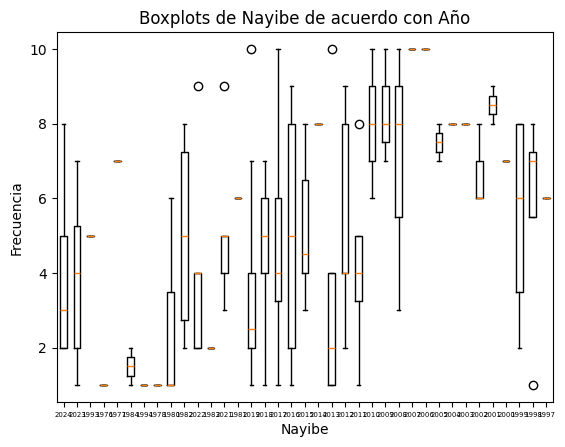

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Año'
variable_numerica = 'Nayibe'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Aqui en la variable de año podemos ver que aunque las pelliculas de antes de el año 2000 son peor calificadas realmente no son tanto por el año si que mas bien tienen que ver mas con el genero de las peliculas y da la casualidad que tambien tienen que ver con el año


### Clasificación

In [ ]:
#1
df.groupby("Clasificacion")['Nayibe'].mean()

,Nayibe
Clasificacion,
G,10.000000
PG,7.500000
PG-13,4.333333
R,1.790698


In [ ]:
#2
df.groupby("Clasificacion")['Nayibe'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Clasificacion,,,,,,,,
G,10.000000,10,10,0.000000,8,10.0,10.0,10.0
PG,7.500000,5,9,0.918225,52,8.0,7.0,8.0
PG-13,4.333333,3,6,0.816497,42,4.0,4.0,5.0
R,1.790698,1,4,0.773309,43,2.0,1.0,2.0


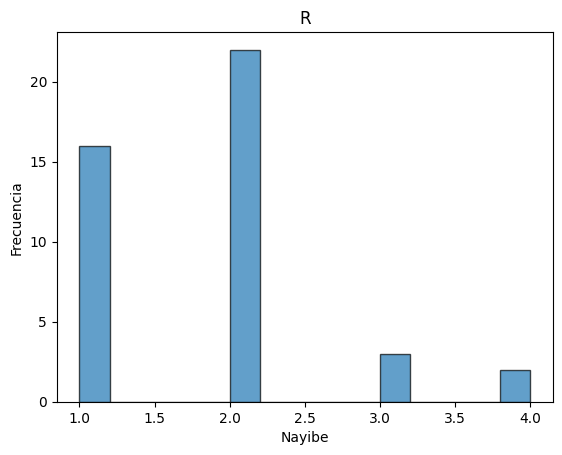

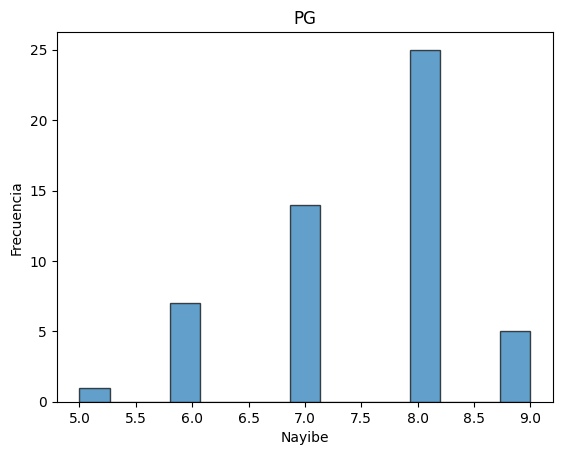

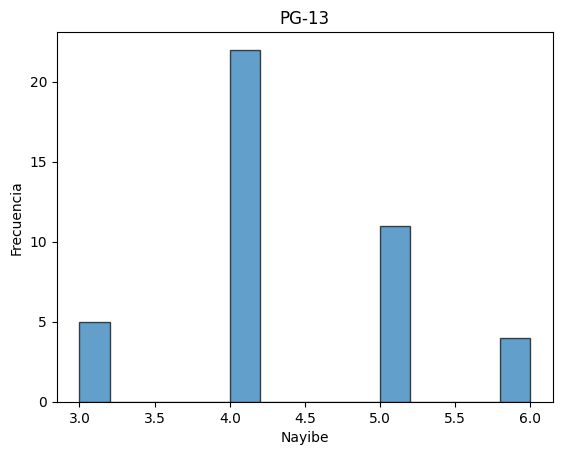

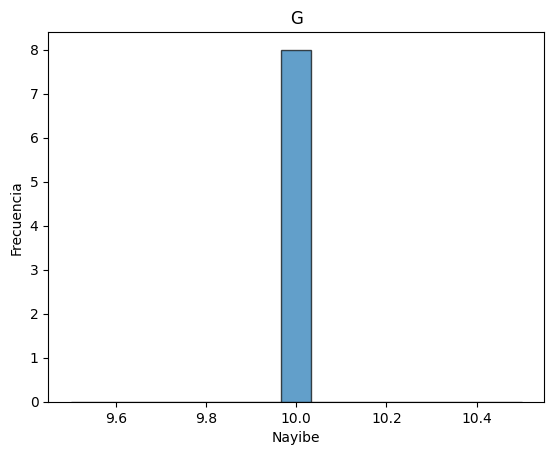

In [ ]:
#3
variable_categorica='Clasificacion'
variable_numerica='Nayibe'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

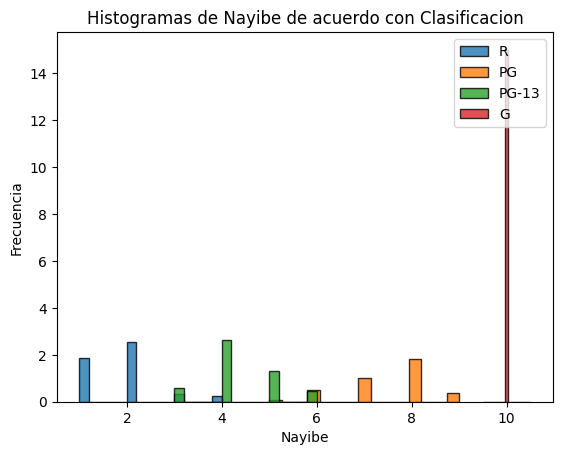

In [ ]:
#4
variable_categorica='Clasificacion'
variable_numerica='Nayibe'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

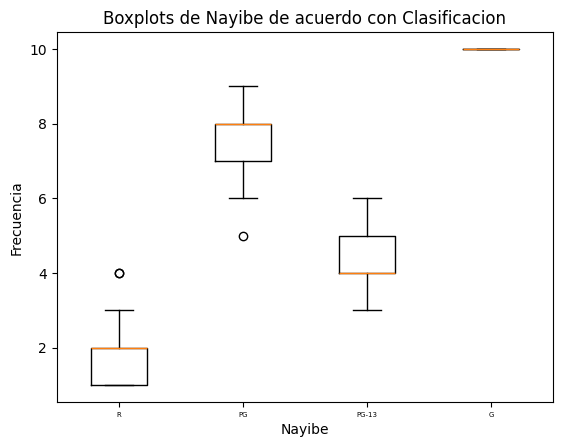

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Clasificacion'
variable_numerica = 'Nayibe'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Aqui vemos que la clasificación de las peliculas si tiene mucho que ver con las calificaciones de Nayibe, podemos ver claramente que a Nayibe no le encantas as pliculas de clasificación R que sulen ser mas subidas de tono cosa que tiene que ver con el resto de clasificaciones y que la clasificación que mas le gusta es la clasificación G que es la mas le gusta, cosa que repito concuerda con los demas analisis


### Animación

In [ ]:
#1
df.groupby("Animacion")['Nayibe'].mean()

,Nayibe
Animacion,
no,3.936364
si,8.457143


In [ ]:
#2
df.groupby("Animacion")['Nayibe'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Animacion,,,,,,,,
no,3.936364,1,9,2.155757,110,4.0,2.0,5.75
si,8.457143,7,10,0.980482,35,8.0,8.0,9.00


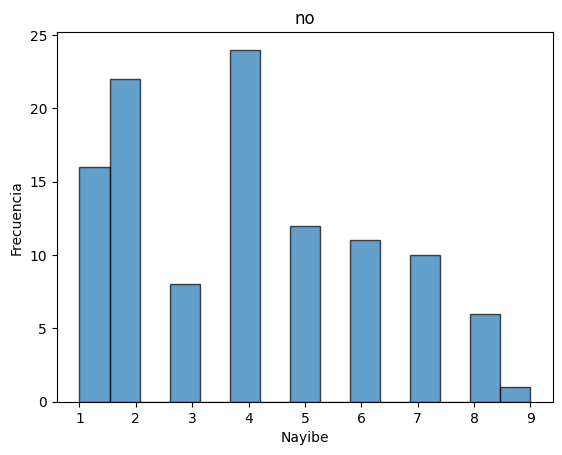

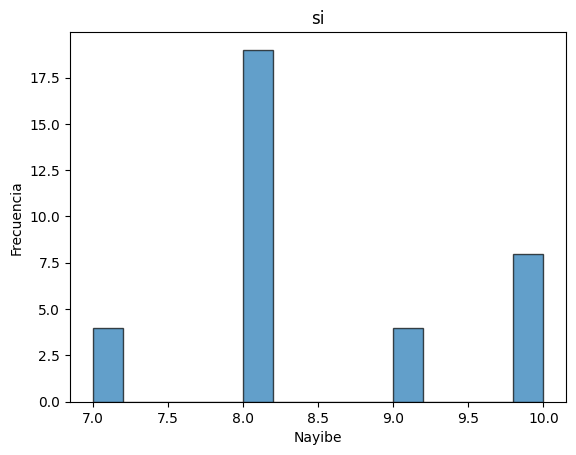

In [ ]:
#3
variable_categorica='Animacion'
variable_numerica='Nayibe'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

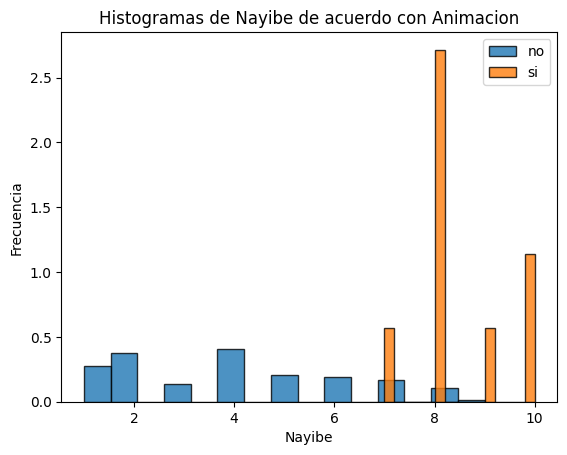

In [ ]:
#4
variable_categorica='Animacion'
variable_numerica='Nayibe'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

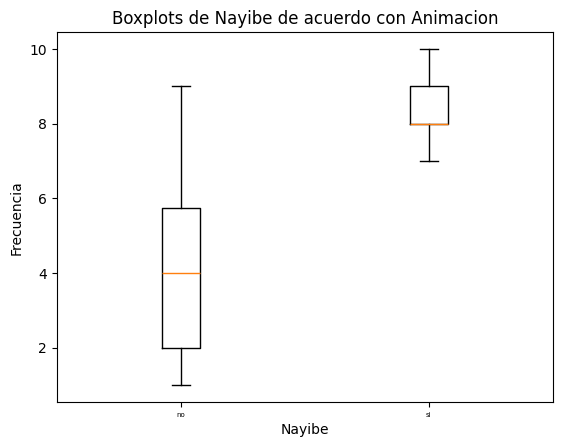

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Animacion'
variable_numerica = 'Nayibe'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Nayibe prefiere las peliuclas de animación pero no por mucho se nota que realmente son las pelliculas de terror y las de clasificación R las que hacen que baje la clasificación de las pelicuals que no son animación, por lo que realmente a Nayible no le importa mucho si las peliculas son de animación o no


### Duración

In [ ]:
#1
df.groupby("Duracion")['Nayibe'].mean()

,Nayibe
Duracion,
78,7.0
83,3.0
86,8.0
88,8.0
90,8.0
...,...
180,2.0
181,3.0
189,2.0


In [ ]:
#2
df.groupby("Duracion")['Nayibe'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Duracion,,,,,,,,
78,7.0,7,7,NaN,1,7.0,7.0,7.0
83,3.0,3,3,NaN,1,3.0,3.0,3.0
86,8.0,8,8,NaN,1,8.0,8.0,8.0
88,8.0,8,8,NaN,1,8.0,8.0,8.0
90,8.0,8,8,0.000000,3,8.0,8.0,8.0
...,...,...,...,...,...,...,...,...
180,2.0,2,2,NaN,1,2.0,2.0,2.0
181,3.0,2,4,1.414214,2,3.0,2.5,3.5
189,2.0,2,2,NaN,1,2.0,2.0,2.0


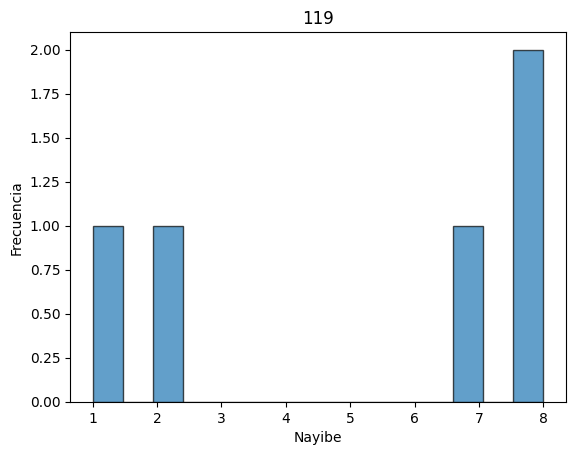

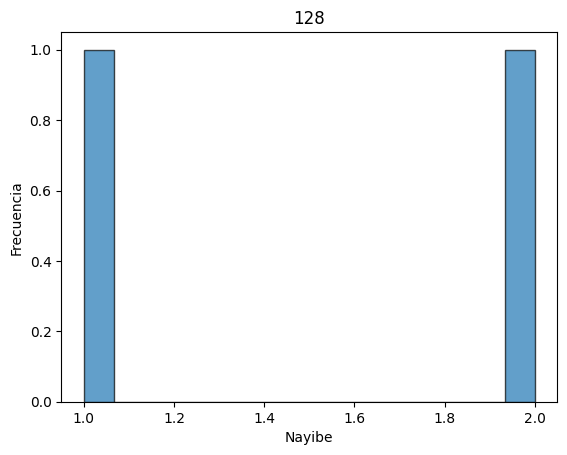

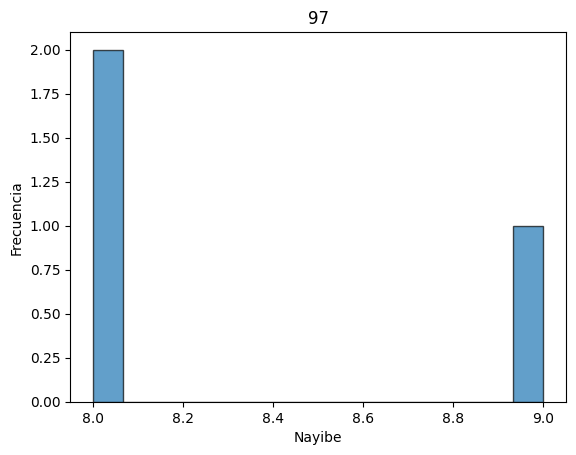

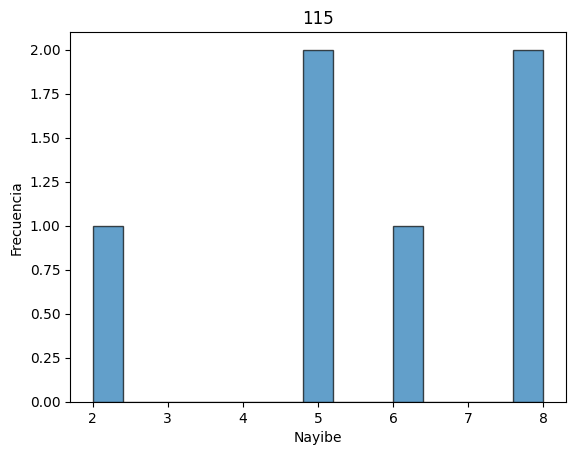

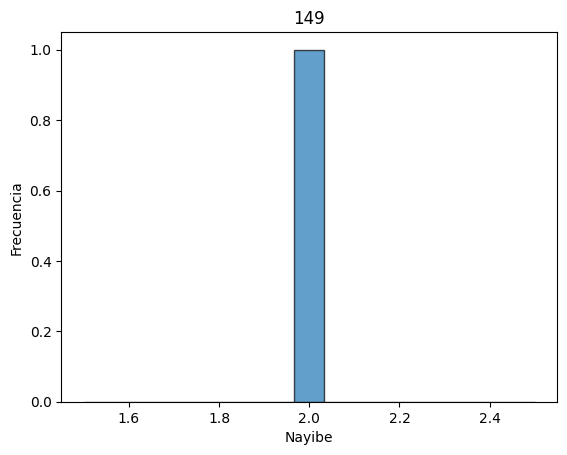

...

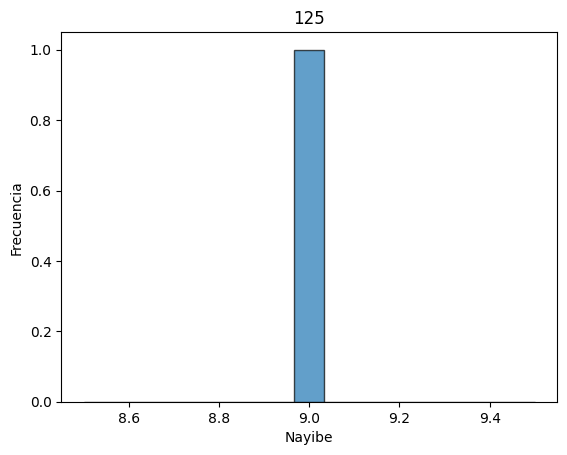

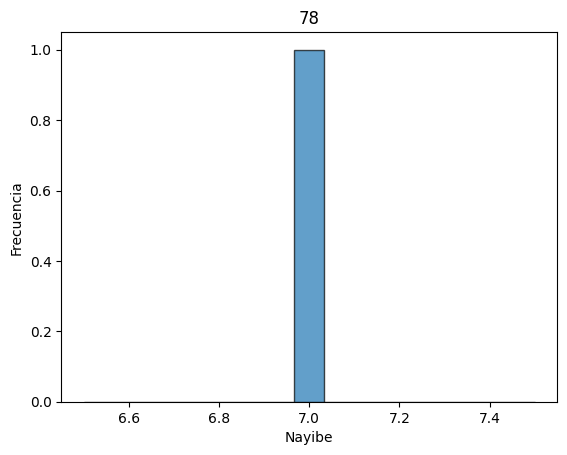

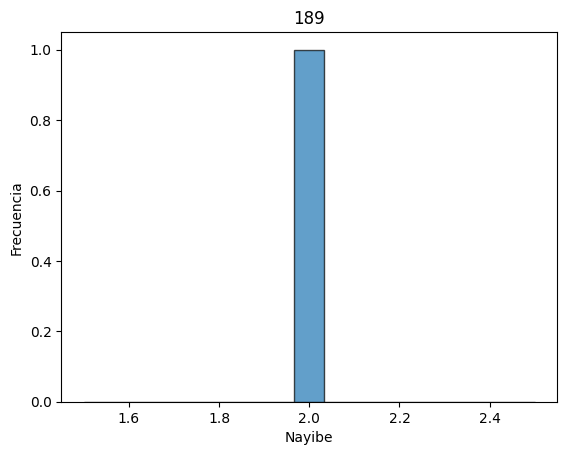

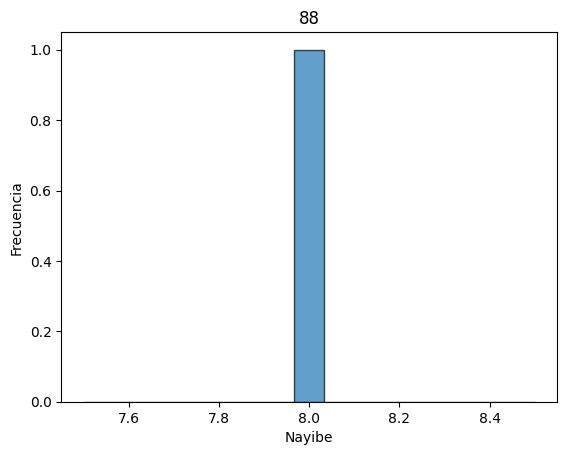

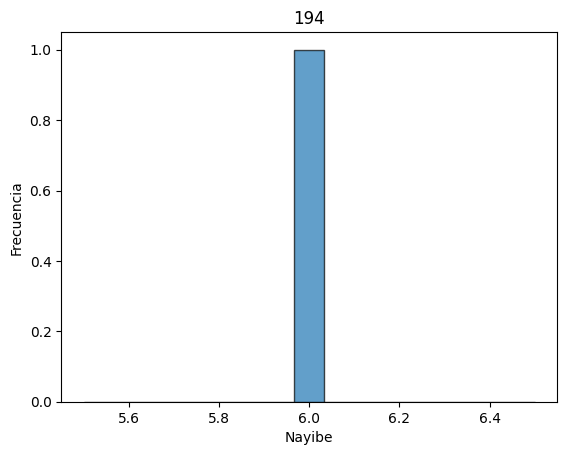

In [ ]:
#3
variable_categorica='Duracion'
variable_numerica='Nayibe'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

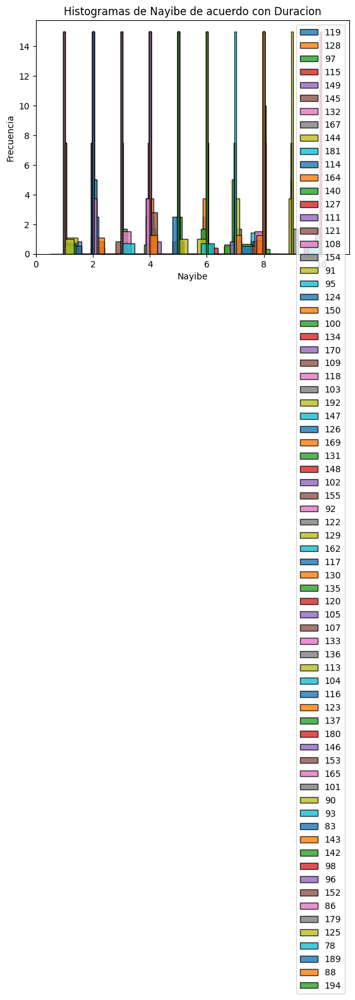

In [ ]:
#4
variable_categorica='Duracion'
variable_numerica='Nayibe'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

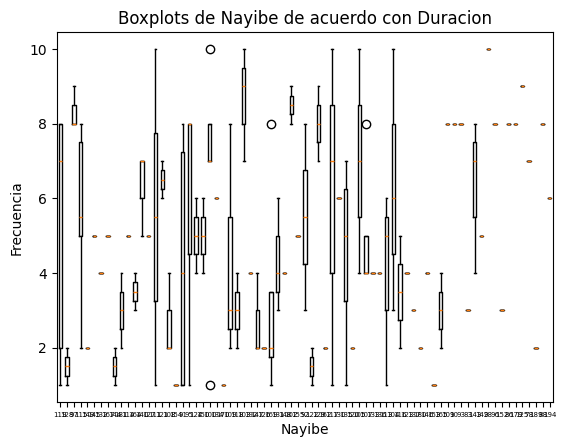

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Duracion'
variable_numerica = 'Nayibe'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Aqui debido a que en las graficas vemos todo casi aleatorio que podria parecer incluso al azar lo que significa que Nayibe tampoco le da mucha importancia a la duración de las pelicuals por loq ue le da igual si duran mucho o poco y que no va a afectar en absolutamente nada en la calificación


### Criticos

In [ ]:
#1
df.groupby("Criticos")['Nayibe'].mean()

,Nayibe
Criticos,
5.3,2.000000
5.5,8.000000
5.6,5.000000
5.7,7.000000
6.0,5.000000
6.2,2.000000
6.4,8.000000
6.5,2.000000
6.6,3.000000


In [ ]:
#2
df.groupby("Criticos")['Nayibe'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Criticos,,,,,,,,
5.3,2.000000,2,2,NaN,1,2.0,2.00,2.00
5.5,8.000000,8,8,NaN,1,8.0,8.00,8.00
5.6,5.000000,3,7,2.828427,2,5.0,4.00,6.00
5.7,7.000000,7,7,NaN,1,7.0,7.00,7.00
6.0,5.000000,4,6,1.414214,2,5.0,4.50,5.50
6.2,2.000000,2,2,NaN,1,2.0,2.00,2.00
6.4,8.000000,8,8,NaN,1,8.0,8.00,8.00
6.5,2.000000,2,2,NaN,1,2.0,2.00,2.00
6.6,3.000000,1,7,3.464102,3,1.0,1.00,4.00


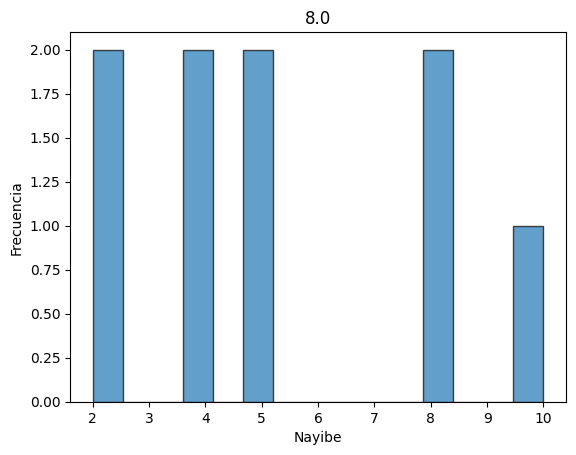

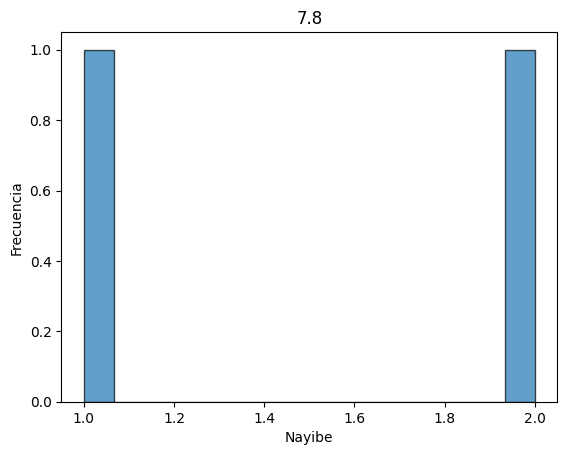

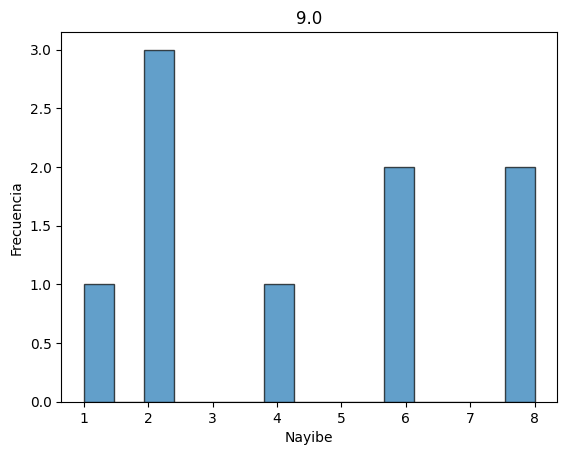

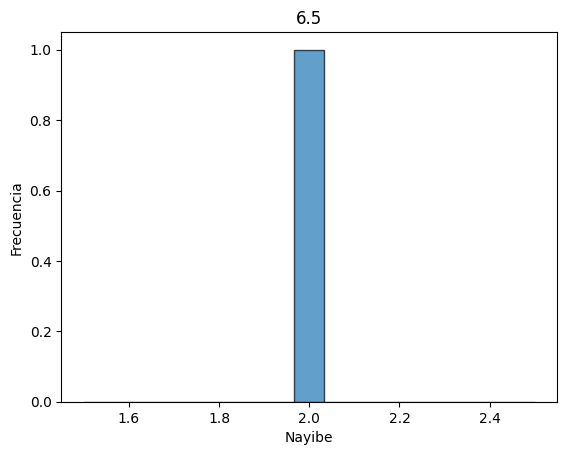

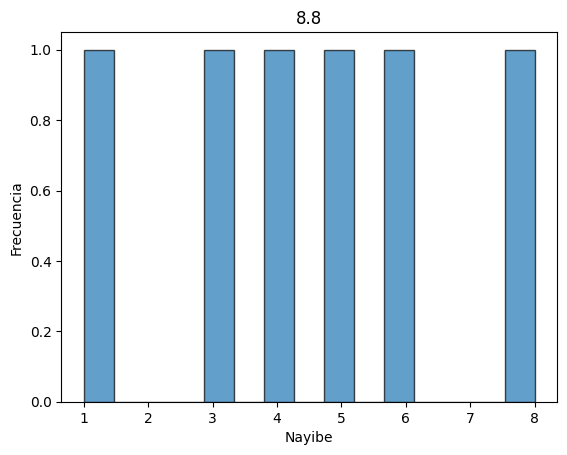

...

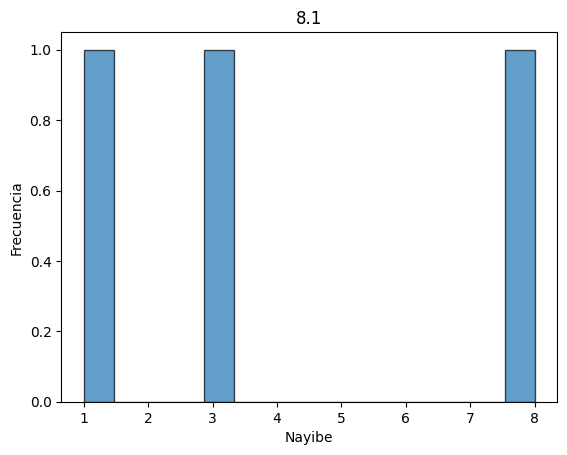

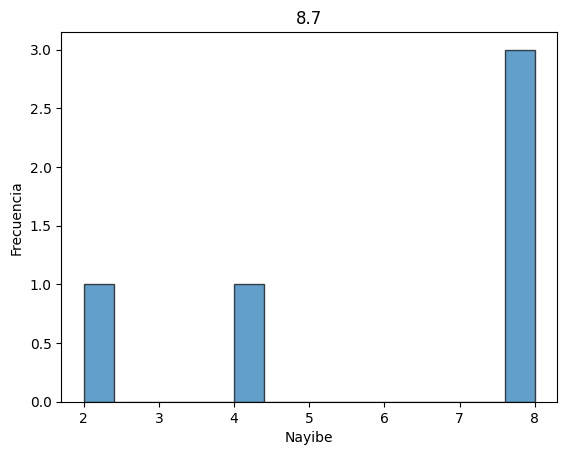

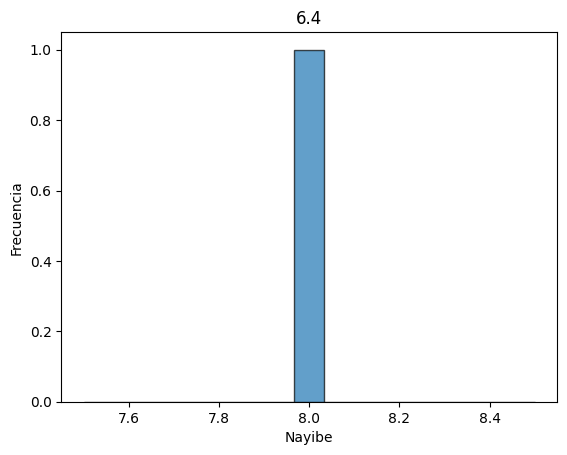

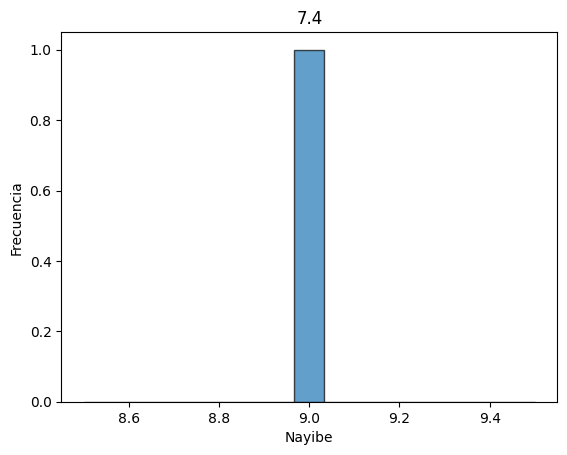

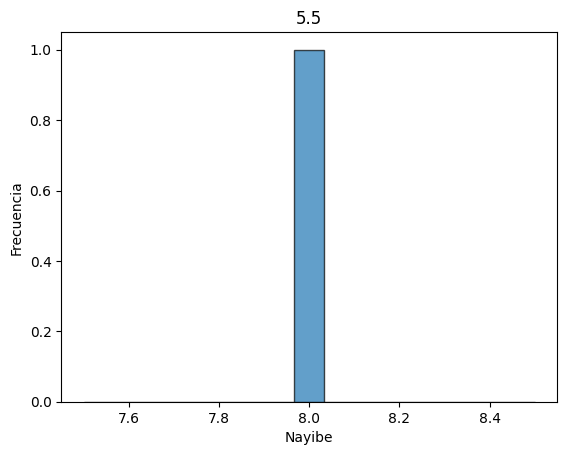

In [ ]:
#3
variable_categorica='Criticos'
variable_numerica='Nayibe'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

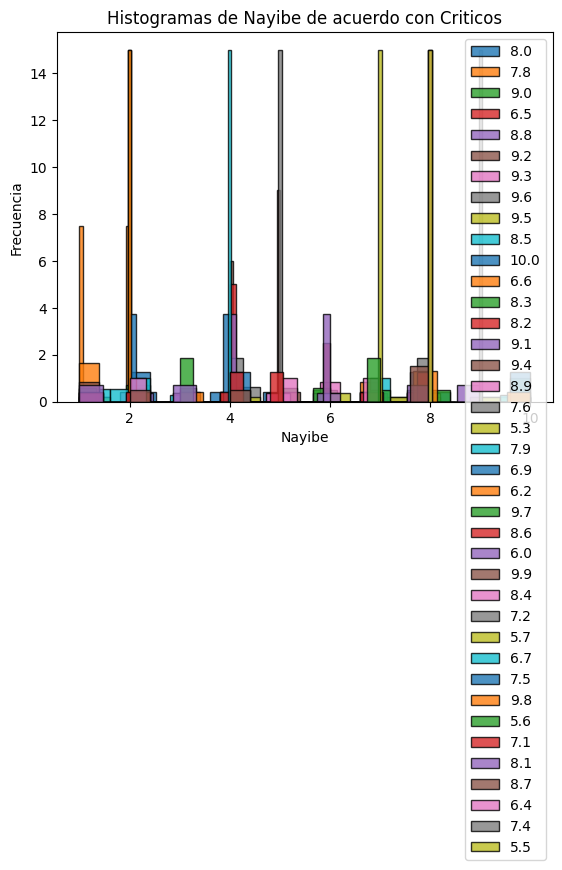

In [ ]:
#4
variable_categorica='Criticos'
variable_numerica='Nayibe'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

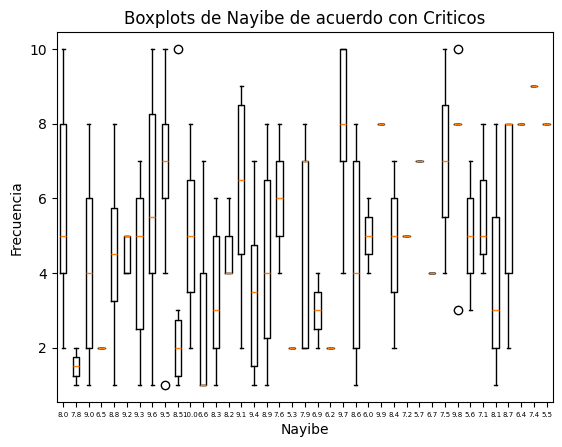

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Criticos'
variable_numerica = 'Nayibe'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

En general, las calificaciones de Nayib son altamente variables: tienen el rango desde valores extremadamente bajos hasta casi los 10, y también salpicados de muchos valores atípicos. A partir de la gráfica, hay una diferencia entre las calificaciones de algunos de los críticos y las de Nayib dependiendo de la película en cuestión. Por ejemplo, para muchas películas que tienen valoraciones críticas medias en torno a 6.5 Nayib asigna calificaciones mucho más bajas. Al mismo tiempo, para algunas películas, los dos son bastante precisos, ya que los críticos evalúan estos. Por lo tanto, de acuerdo con las calificaciones de Nayib,


### Audiencia

In [ ]:
#1
df.groupby("Audiencia")['Nayibe'].mean()

,Nayibe
Audiencia,
5.4,4.000000
5.6,7.000000
5.8,4.333333
6.0,3.750000
6.2,6.000000
6.4,2.000000
6.6,4.200000
6.8,6.750000
7.0,5.727273


In [ ]:
#2
df.groupby("Audiencia")['Nayibe'].agg(
    mean='mean',
    min='min',
    max='max',
    std='std',
    count='count',
    median='median',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75))

,mean,min,max,std,count,median,q25,q75
Audiencia,,,,,,,,
5.4,4.000000,4,4,NaN,1,4.0,4.00,4.0
5.6,7.000000,7,7,NaN,1,7.0,7.00,7.0
5.8,4.333333,2,8,3.214550,3,3.0,2.50,5.5
6.0,3.750000,1,5,1.892969,4,4.5,3.25,5.0
6.2,6.000000,4,8,2.828427,2,6.0,5.00,7.0
6.4,2.000000,2,2,NaN,1,2.0,2.00,2.0
6.6,4.200000,3,5,0.836660,5,4.0,4.00,5.0
6.8,6.750000,1,10,2.915476,8,7.0,5.75,8.5
7.0,5.727273,1,9,2.831639,11,6.0,3.50,8.0


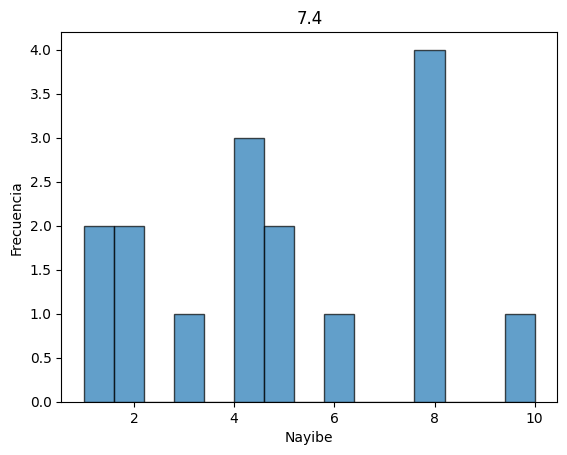

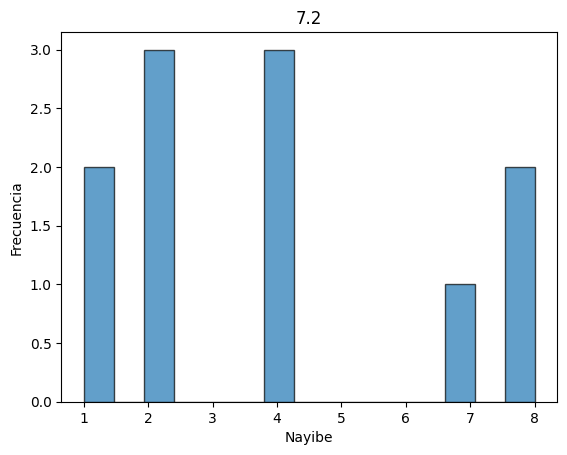

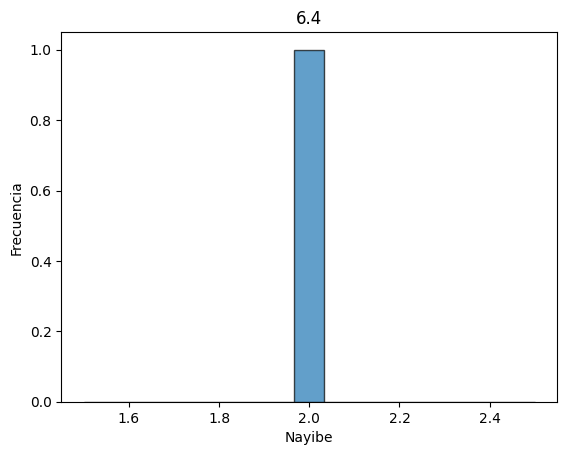

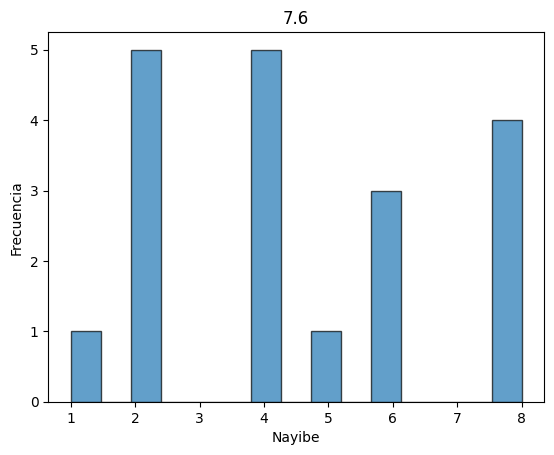

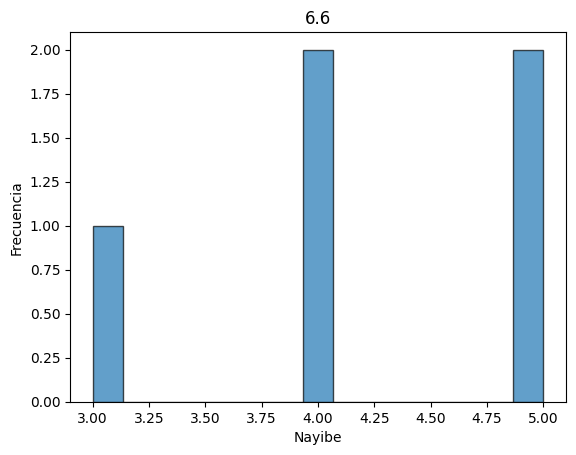

...

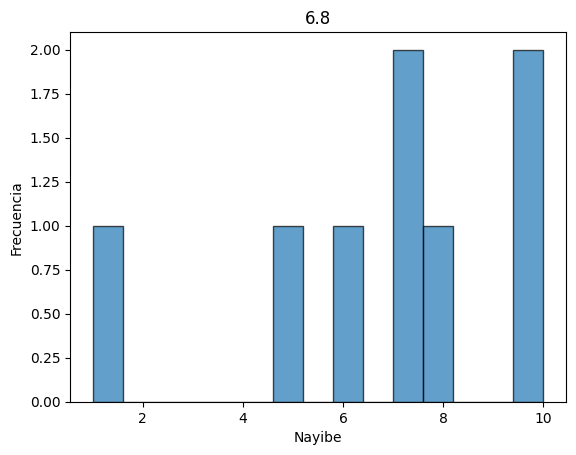

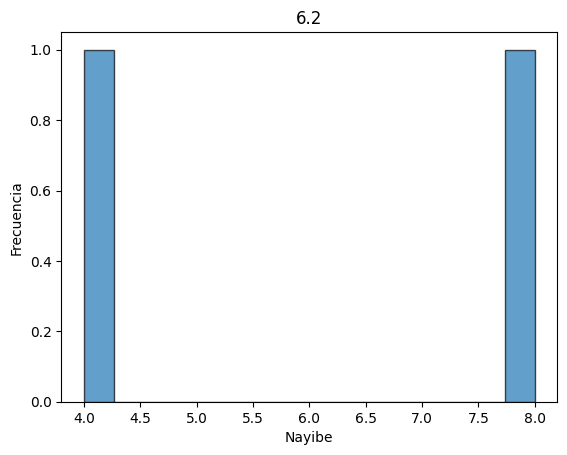

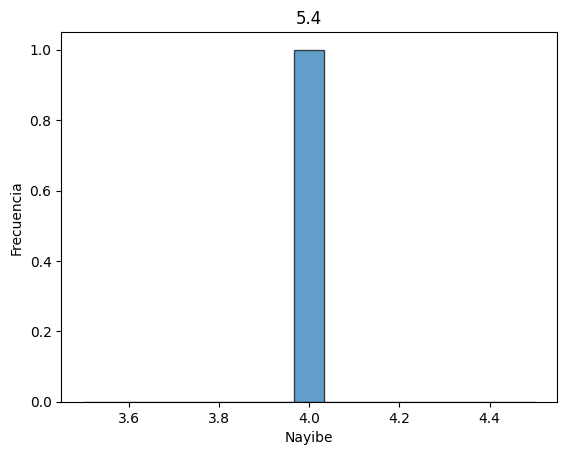

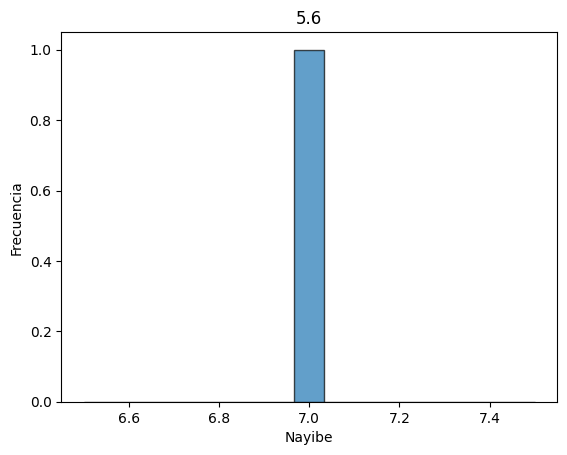

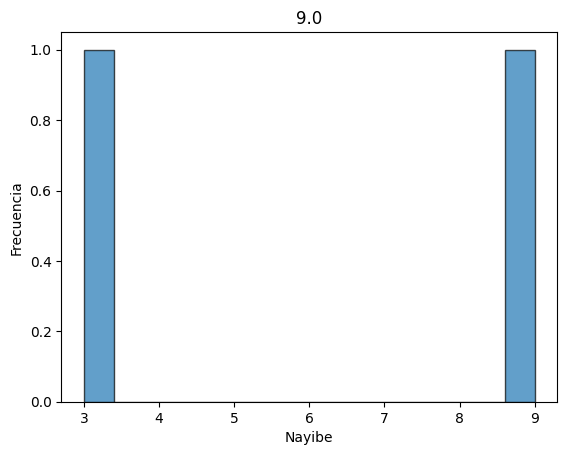

In [ ]:
#3
variable_categorica='Audiencia'
variable_numerica='Nayibe'

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.7,
                edgecolor='black',
                label=cat,
                )

  plt.xlabel(variable_numerica)
  plt.ylabel('Frecuencia')
  plt.title(cat)
  plt.show()

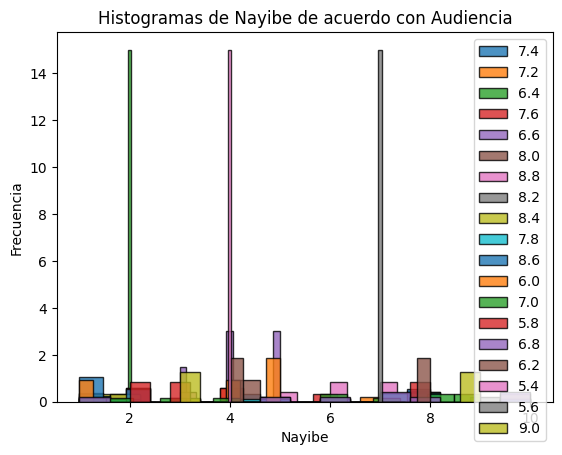

In [ ]:
#4
variable_categorica='Audiencia'
variable_numerica='Nayibe'
norm=True

for cat in df[variable_categorica].unique():
  hist = plt.hist(df[df[variable_categorica]==cat][variable_numerica] ,
                bins=15,
                alpha = 0.8,
                edgecolor='black',
                label=cat,
                density=norm
                )

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Histogramas de {variable_numerica} de acuerdo con {variable_categorica}')
plt.legend(loc='upper right')
plt.show()

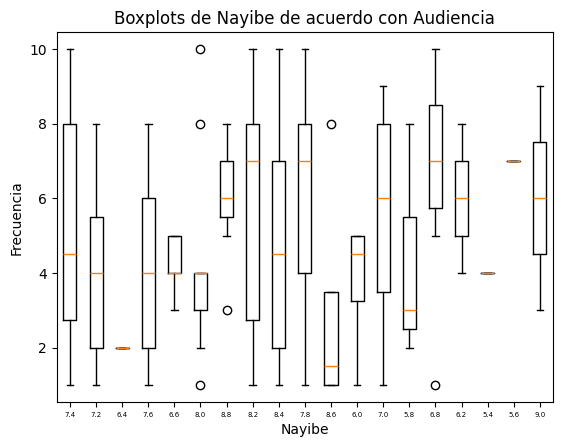

<Figure size 1000x1000 with 0 Axes>

In [ ]:
#5
variable_categorica = 'Audiencia'
variable_numerica = 'Nayibe'

data = []
labels = []
for cat in df[variable_categorica].unique():
    data.append(df[df[variable_categorica] == cat][variable_numerica])
    labels.append(cat)

plt.boxplot(data, positions=np.arange(len(data)), labels=labels)

# Cambia el tamaño y la familia de la fuente de las etiquetas del eje X
plt.xticks(fontsize=5)  # Ajusta 'fontsize' y 'fontfamily' según tus preferencias

plt.xlabel(variable_numerica)
plt.ylabel('Frecuencia')
plt.title(f'Boxplots de {variable_numerica} de acuerdo con {variable_categorica}')
plt.figure(figsize=(10, 10))  # Tamaño en pulgadas, en lugar de píxeles
plt.show()

Al analizar las gráficas, se observó que Nayib tiene un promedio de calificación más bajo en algunas puntuaciones en la audiencia. Por ejemplo, en la audiencia con una calificación promedio de 5.4, Nayib otorgó 4.0. En la gama de 6.0, Nayib promedió calificaciones de 3.75 en comparación con la audiencia que promedió de manera similar pero con una mayor dispersión y algunos promedios más altos. Para los más altos como 8.8 y 9.0, Nayib también promedia de manera similar, 6.0. Podemos ver que en los boxplots, Nayib muestra una mediana más baja y una mayor dispersión en los cuartiles inferiores en comparación con la audiencia que destaca el enfoque más crítico de calificaciones para Nayib en muchos de los rangos.


# Conclusion

Mediante el analisis multivariado y univariado de las variables independiente y estas afectan a nuestra variable depediente, pudimos concluir que la cantidad de datos es la correcta. Al utilizar mas de 100 datos, nosotros creemos posible el acercar de la forma mas cercana y posible un modelo el cual nos ayude a hacer predicciones conforme gustos y preferencias. Por otra parte tambien descrubirmos que exsiten datos muy variados que a la hora de analizar las peliculas dejan de tener tanta importancia por la suma volatilidad en las califiaciones. Estas variables independientes son la duración, el subgenero y el año. Para la duración , los datos son sumanete diferentes y no teien congruencia los datos, para el subgenero esta variable es muy parecida a genero entocnes y deja de tomar tanta improtancia para realizar el analisis y para el año, aunque es una varibale importante, el analisis mediante estos datos es complicado por la gran diferencia entre años en varios casos y despues la poca diferencia. Aun asi creemos posible la creación de un modelo decente con un bajo porcentaje de error para gararntizar la mejor pelicula dependeiendo tus gustos.

# Exportar PDF


In [ ]:
!jupyter nbconvert --to html /content/drive/MyDrive/MCD/Equipo2_Preprocesamiento2.ipynb

[NbConvertApp] Converting notebook /content/drive/MyDrive/MCD/Equipo2_Preprocesamiento2.ipynb to html
[NbConvertApp] WARNING | Alternative text is missing on 1110 image(s).
[NbConvertApp] Writing 21869544 bytes to /content/drive/MyDrive/MCD/Equipo2_Preprocesamiento2.html
